In [735]:
from google.colab import drive
drive.mount('/content/gdrive')


Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [736]:
import warnings
warnings.filterwarnings('ignore')


import pandas as pd
import numpy as np
import seaborn as sns
%matplotlib inline
import matplotlib.pyplot as plt


In [737]:
#Reading Files

In [738]:
###Reading Consumer Electronics sheet

In [739]:
pd.set_option('display.max_row', 500)
pd.set_option('display.max_columns', 100)

In [740]:
pd.set_option('display.float_format', '{:0.3f}'.format)

In [741]:
electronics=pd.read_csv("/content/gdrive/MyDrive/ConsumerElectronics.csv")
electronics.head()

,fsn_id,order_date,Year,Month,order_id,order_item_id,gmv,units,deliverybdays,deliverycdays,s1_fact.order_payment_type,sla,cust_id,pincode,product_analytic_super_category,product_analytic_category,product_analytic_sub_category,product_analytic_vertical,product_mrp,product_procurement_sla
0,ACCCX3S58G7B5F6P,2015-10-17 15:11:54,2015,10,3419300926147000.000,3419300926147000.000,6400,1,\N,\N,COD,5,-1.01299130778588E+018,-7.79175582905735E+018,CE,CameraAccessory,CameraAccessory,CameraTripod,7190,0
1,ACCCX3S58G7B5F6P,2015-10-19 10:07:22,2015,10,1420830839915200.000,1420830839915200.000,6900,1,\N,\N,COD,7,-8.99032457905512E+018,7.33541149097431E+018,CE,CameraAccessory,CameraAccessory,CameraTripod,7190,0
2,ACCCX3S5AHMF55FV,2015-10-20 15:45:56,2015,10,2421912925714800.000,2421912925714800.000,1990,1,\N,\N,COD,10,-1.0404429420466E+018,-7.47768776228657E+018,CE,CameraAccessory,CameraAccessory,CameraTripod,2099,3
3,ACCCX3S5AHMF55FV,2015-10-14 12:05:15,2015,10,4416592101738400.000,4416592101738400.000,1690,1,\N,\N,Prepaid,4,-7.60496084352714E+018,-5.83593163877661E+018,CE,CameraAccessory,CameraAccessory,CameraTripod,2099,3
4,ACCCX3S5AHMF55FV,2015-10-17 21:25:03,2015,10,4419525153426400.000,4419525153426400.000,1618,1,\N,\N,Prepaid,6,2.8945572083453E+018,5.34735360997242E+017,CE,CameraAccessory,CameraAccessory,CameraTripod,2099,3


In [742]:
#Checking unique values in product_analytic_sub_category

In [743]:
electronics.shape

(1648824, 20)

In [744]:
electronics['product_analytic_sub_category'].unique()

array(['CameraAccessory', 'GamingAccessory', 'Speaker', 'HomeAudio',
       'CameraStorage', 'AmplifierReceiver', 'AudioMP3Player', 'Game',
       'Camera', 'GamingConsole', 'HomeTheatre', 'AudioAccessory',
       'TVVideoSmall', 'GameMembershipCards'], dtype=object)

We need only 3 sub categories( Camera Accessory, Home Audio, and Gaming Accessory) for modelling. So, we can remove all other rows

In [745]:
electronics=electronics.loc[(electronics['product_analytic_sub_category']=='CameraAccessory')|(electronics['product_analytic_sub_category']=='HomeAudio')|(electronics['product_analytic_sub_category']=='GamingAccessory')]

Again checking for unique values in product_analytic_sub_category to verify

In [746]:
electronics['product_analytic_sub_category'].unique()

array(['CameraAccessory', 'GamingAccessory', 'HomeAudio'], dtype=object)

In [747]:
electronics.shape

(566267, 20)

Checking for Null Values

In [748]:
(electronics.isnull().sum()/len(electronics))*100

fsn_id                            0.000
order_date                        0.000
Year                              0.000
Month                             0.000
order_id                          0.000
order_item_id                     0.000
gmv                               0.000
units                             0.000
deliverybdays                     0.000
deliverycdays                     0.000
s1_fact.order_payment_type        0.000
sla                               0.000
cust_id                           0.000
pincode                           0.000
product_analytic_super_category   0.000
product_analytic_category         0.000
product_analytic_sub_category     0.000
product_analytic_vertical         0.000
product_mrp                       0.000
product_procurement_sla           0.000
dtype: float64

There are No Null values

Checking for unique values in columns

In [749]:
electronics['deliverybdays'].unique()

array(['\\N', '5', '4', '6', '8', '7', '3', '9', '2', '18', '10', '32',
       '1', '14', '13', '0', '12', '11', '15', '16', '23', '36', '35',
       '19', '26', '17', '20', '53', '-71', '22', '25', '-39', '-72',
       '-41', '21', '-14', '-45', '-56', '24', '-73', '61', '30'],
      dtype=object)

\\N doesn't make any sense.. So replacing it with null values

In [750]:
electronics['deliverybdays'].replace('\\N',np.nan,inplace=True)

Similarly checking unique values for deliverycdays column

In [751]:
electronics['deliverycdays'].unique()

array(['\\N', '6', '5', '7', '9', '4', '11', '3', '8', '20', '37', '12',
       '2', '1', '16', '17', '15', '14', '10', '13', '21', '18', '19',
       '27', '42', '41', '23', '31', '24', '0', '61', '-832', '26', '22',
       '-836', '29', '-466', '-848', '-844', '-482', '25', '-16', '-532',
       '-655', '28', '-859', '72', '35'], dtype=object)

replacing \\N by null values

In [752]:
electronics['deliverycdays'].replace('\\N',np.nan,inplace=True)

Again checking for null values %age

In [753]:
electronics.isnull().sum()/len(electronics)*100

fsn_id                             0.000
order_date                         0.000
Year                               0.000
Month                              0.000
order_id                           0.000
order_item_id                      0.000
gmv                                0.000
units                              0.000
deliverybdays                     79.293
deliverycdays                     79.293
s1_fact.order_payment_type         0.000
sla                                0.000
cust_id                            0.000
pincode                            0.000
product_analytic_super_category    0.000
product_analytic_category          0.000
product_analytic_sub_category      0.000
product_analytic_vertical          0.000
product_mrp                        0.000
product_procurement_sla            0.000
dtype: float64

Since deliverybdays and deliverycdays now contain large no. of null values. Therefore we can drop them

In [754]:
electronics.drop(['deliverybdays','deliverycdays'],axis=1,inplace=True)

Checking other columns for Innapropriate values

In [755]:
electronics['s1_fact.order_payment_type'].unique()

array(['COD', 'Prepaid'], dtype=object)

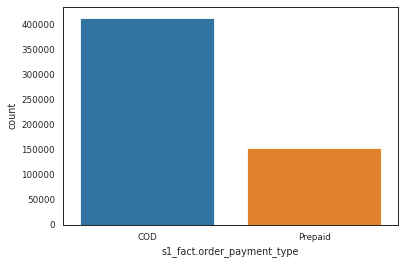

In [756]:
sns.countplot(electronics['s1_fact.order_payment_type'])

In [757]:
#Checking unique values in product_analytic_super_category

In [758]:
electronics['product_analytic_super_category'].unique()

array(['CE'], dtype=object)

Since there is only 1 value in product_analytic_super_category. Therefore we can remove the column

In [759]:
electronics.drop('product_analytic_super_category',axis=1,inplace=True)

In [760]:
#Checking unique values in product_analytic_category

In [761]:
electronics['product_analytic_category'].unique()

array(['CameraAccessory', 'GamingHardware', 'EntertainmentSmall'],
      dtype=object)

In [762]:
#Checking unique values in product_analytic_vertical

In [763]:
electronics['product_analytic_vertical'].unique()

array(['CameraTripod', 'Lens', 'CameraBag', 'Flash', 'CameraBattery',
       'CameraBatteryCharger', 'GamePad', 'GamingAccessoryKit',
       'GamingHeadset', 'GamingMemoryCard', 'MotionController',
       'GamingMouse', 'GamingAdapter', 'TVOutCableAccessory', 'GamingGun',
       'JoystickGamingWheel', 'HomeAudioSpeaker', 'CameraRemoteControl',
       'Binoculars', 'Filter', 'GamingMousePad', 'Strap',
       'GamingKeyboard', 'Dock', 'SlingBox', 'GamingSpeaker',
       'CoolingPad', 'BoomBox', 'CameraBatteryGrip', 'CameraAccessory',
       'CameraFilmRolls', 'CameraMount', 'DockingStation', 'DJController',
       'ExtensionTube', 'FMRadio', 'HiFiSystem', 'KaraokePlayer',
       'Telescope', 'VoiceRecorder', 'GamingChargingStation',
       'CameraEyeCup', 'GameControlMount', 'SoundMixer', 'CameraLEDLight',
       'CameraMicrophone', 'FlashShoeAdapter', 'Softbox',
       'ReflectorUmbrella', 'Teleconverter', 'CameraHousing'],
      dtype=object)

In [764]:
electronics['product_analytic_vertical'].isnull().sum()

0

In [765]:
product = pd.get_dummies(electronics['product_analytic_vertical'],drop_first=True)

In [766]:
electronics=pd.concat([electronics,product],axis=1)

In [767]:
electronics.head()

,fsn_id,order_date,Year,Month,order_id,order_item_id,gmv,units,s1_fact.order_payment_type,sla,cust_id,pincode,product_analytic_category,product_analytic_sub_category,product_analytic_vertical,product_mrp,product_procurement_sla,BoomBox,CameraAccessory,CameraBag,CameraBattery,CameraBatteryCharger,CameraBatteryGrip,CameraEyeCup,CameraFilmRolls,CameraHousing,CameraLEDLight,CameraMicrophone,CameraMount,CameraRemoteControl,CameraTripod,CoolingPad,DJController,Dock,DockingStation,ExtensionTube,FMRadio,Filter,Flash,FlashShoeAdapter,GameControlMount,GamePad,GamingAccessoryKit,GamingAdapter,GamingChargingStation,GamingGun,GamingHeadset,GamingKeyboard,GamingMemoryCard,GamingMouse,GamingMousePad,GamingSpeaker,HiFiSystem,HomeAudioSpeaker,JoystickGamingWheel,KaraokePlayer,Lens,MotionController,ReflectorUmbrella,SlingBox,Softbox,SoundMixer,Strap,TVOutCableAccessory,Teleconverter,Telescope,VoiceRecorder
0,ACCCX3S58G7B5F6P,2015-10-17 15:11:54,2015,10,3419300926147000.000,3419300926147000.000,6400,1,COD,5,-1.01299130778588E+018,-7.79175582905735E+018,CameraAccessory,CameraAccessory,CameraTripod,7190,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,ACCCX3S58G7B5F6P,2015-10-19 10:07:22,2015,10,1420830839915200.000,1420830839915200.000,6900,1,COD,7,-8.99032457905512E+018,7.33541149097431E+018,CameraAccessory,CameraAccessory,CameraTripod,7190,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,ACCCX3S5AHMF55FV,2015-10-20 15:45:56,2015,10,2421912925714800.000,2421912925714800.000,1990,1,COD,10,-1.0404429420466E+018,-7.47768776228657E+018,CameraAccessory,CameraAccessory,CameraTripod,2099,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,ACCCX3S5AHMF55FV,2015-10-14 12:05:15,2015,10,4416592101738400.000,4416592101738400.000,1690,1,Prepaid,4,-7.60496084352714E+018,-5.83593163877661E+018,CameraAccessory,CameraAccessory,CameraTripod,2099,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,ACCCX3S5AHMF55FV,2015-10-17 21:25:03,2015,10,4419525153426400.000,4419525153426400.000,1618,1,Prepaid,6,2.8945572083453E+018,5.34735360997242E+017,CameraAccessory,CameraAccessory,CameraTripod,2099,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [768]:
electronics['product_procurement_sla'].unique()

array([ 0,  3,  5, -1,  1,  6,  2,  7,  4, 13, 14, 10,  9, 12,  8, 15])

In [769]:
#Checking for data types

In [770]:
electronics.dtypes

fsn_id                            object
order_date                        object
Year                               int64
Month                              int64
order_id                         float64
order_item_id                    float64
gmv                               object
units                              int64
s1_fact.order_payment_type        object
sla                                int64
cust_id                           object
pincode                           object
product_analytic_category         object
product_analytic_sub_category     object
product_analytic_vertical         object
product_mrp                        int64
product_procurement_sla            int64
BoomBox                            uint8
CameraAccessory                    uint8
CameraBag                          uint8
CameraBattery                      uint8
CameraBatteryCharger               uint8
CameraBatteryGrip                  uint8
CameraEyeCup                       uint8
CameraFilmRolls 

## Changing order_date to datetime

In [771]:
electronics['order_date']=pd.to_datetime(electronics['order_date'],format="%Y-%m-%d %H:%M:%S")

In [772]:
#changing datatype of gmv

In [773]:
electronics['gmv']=pd.to_numeric(electronics['gmv'], errors='coerce')

In [774]:
electronics.dtypes

fsn_id                                   object
order_date                       datetime64[ns]
Year                                      int64
Month                                     int64
order_id                                float64
order_item_id                           float64
gmv                                     float64
units                                     int64
s1_fact.order_payment_type               object
sla                                       int64
cust_id                                  object
pincode                                  object
product_analytic_category                object
product_analytic_sub_category            object
product_analytic_vertical                object
product_mrp                               int64
product_procurement_sla                   int64
BoomBox                                   uint8
CameraAccessory                           uint8
CameraBag                                 uint8
CameraBattery                           

Changing data type for pincode

In [775]:
electronics['pincode']=pd.to_numeric(electronics['pincode'],errors='coerce')

Checking for duplicated values

In [776]:
electronics[electronics.duplicated(['fsn_id','order_date','order_id','order_item_id',
                              'gmv','cust_id','pincode',
                              'product_analytic_category','product_analytic_sub_category',
                             'product_analytic_vertical'])]

,fsn_id,order_date,Year,Month,order_id,order_item_id,gmv,units,s1_fact.order_payment_type,sla,cust_id,pincode,product_analytic_category,product_analytic_sub_category,product_analytic_vertical,product_mrp,product_procurement_sla,BoomBox,CameraAccessory,CameraBag,CameraBattery,CameraBatteryCharger,CameraBatteryGrip,CameraEyeCup,CameraFilmRolls,CameraHousing,CameraLEDLight,CameraMicrophone,CameraMount,CameraRemoteControl,CameraTripod,CoolingPad,DJController,Dock,DockingStation,ExtensionTube,FMRadio,Filter,Flash,FlashShoeAdapter,GameControlMount,GamePad,GamingAccessoryKit,GamingAdapter,GamingChargingStation,GamingGun,GamingHeadset,GamingKeyboard,GamingMemoryCard,GamingMouse,GamingMousePad,GamingSpeaker,HiFiSystem,HomeAudioSpeaker,JoystickGamingWheel,KaraokePlayer,Lens,MotionController,ReflectorUmbrella,SlingBox,Softbox,SoundMixer,Strap,TVOutCableAccessory,Teleconverter,Telescope,VoiceRecorder
76506,ACCE6YVWVHXXKCHW,2016-02-22 14:52:12,2016,2,3417290135521600.000,3417290135521600.000,350.000,1,Prepaid,8,-1.07035781735315E+018,8456408856164330496.000,GamingHardware,GamingAccessory,JoystickGamingWheel,599,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
675305,ACCE7AV9TZHHAESC,2016-04-27 07:03:09,2016,4,2532857872757300.000,2532857872757300.000,4090.000,1,Prepaid,5,233114630667481984.000,-4071447699433639936.000,GamingHardware,GamingAccessory,GamePad,4990,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
944830,ACCDH7MFZJGRWJCW,2016-04-27 00:19:25,2016,4,3575842474884000.000,300037347717633984.000,287.000,1,Prepaid,5,8788006738130379776.000,2175163142166510080.000,GamingHardware,GamingAccessory,GamePad,410,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
944903,ACCDH7MFZJGRWJCW,2016-04-27 00:19:25,2016,4,3575842474884000.000,3575842474884000.000,287.000,1,Prepaid,7,8788006738130379776.000,2175163142166510080.000,GamingHardware,GamingAccessory,GamePad,410,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
969493,ACCE94WYZR6GFDFP,2016-04-27 00:33:53,2016,4,1569690464156100.000,1569690464156100.000,190.000,1,Prepaid,6,6615160307439460352.000,-7307608120567170048.000,CameraAccessory,CameraAccessory,Filter,380,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1647201,VOREYV2HWZDUFZ9Y,2015-09-29 23:19:16,2015,9,4404040347013500.000,4404040347013500.000,5200.000,1,Prepaid,11,-8.7451731063629E+018,3111585584864399872.000,EntertainmentSmall,HomeAudio,VoiceRecorder,10500,5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1647202,VOREYV2HWZDUFZ9Y,2015-09-30 22:08:55,2015,9,2404860211262700.000,2404860211262700.000,5200.000,1,COD,10,-8.90379286900787E+018,-5601647511496970240.000,EntertainmentSmall,HomeAudio,VoiceRecorder,10500,5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1647203,VOREYV2HWZDUFZ9Y,2015-09-06 22:14:34,2015,9,3381987673542980.000,300037347712641984.000,4299.000,1,COD,7,6.09775807960118E+018,-5152522226055449600.000,EntertainmentSmall,HomeAudio,VoiceRecorder,10500,5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1647204,VOREYV2HWZDUFZ9Y,2015-09-11 16:11:52,2015,9,2388231540197500.000,300037347714801984.000,4599.000,1,COD,7,2.83122075392855E+018,3607820238384010240.000,EntertainmentSmall,HomeAudio,VoiceRecorder,10500,5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1


In [777]:
#Removing duplicate values

In [778]:
electronics = electronics[~electronics.duplicated(['fsn_id','order_date','order_id','order_item_id',
                              'gmv','cust_id','pincode',
                              'product_analytic_category','product_analytic_sub_category',
                             'product_analytic_vertical'])]

In [779]:
electronics['s1_fact.order_payment_type'] = np.where(electronics['s1_fact.order_payment_type'] == "Prepaid",1,0)

In [780]:
#electronics.head()

In [781]:
electronics['s1_fact.order_payment_type'].value_counts()

0    384649
1    143953
Name: s1_fact.order_payment_type, dtype: int64

In [782]:
electronics.shape

(528602, 67)

In [783]:
# We now need to check if the dates are not outside July 2015 and June 2016.

In [784]:
electronics.loc[(electronics.order_date < '2015-07-01') | (electronics.order_date >= '2016-07-01')]

,fsn_id,order_date,Year,Month,order_id,order_item_id,gmv,units,s1_fact.order_payment_type,sla,cust_id,pincode,product_analytic_category,product_analytic_sub_category,product_analytic_vertical,product_mrp,product_procurement_sla,BoomBox,CameraAccessory,CameraBag,CameraBattery,CameraBatteryCharger,CameraBatteryGrip,CameraEyeCup,CameraFilmRolls,CameraHousing,CameraLEDLight,CameraMicrophone,CameraMount,CameraRemoteControl,CameraTripod,CoolingPad,DJController,Dock,DockingStation,ExtensionTube,FMRadio,Filter,Flash,FlashShoeAdapter,GameControlMount,GamePad,GamingAccessoryKit,GamingAdapter,GamingChargingStation,GamingGun,GamingHeadset,GamingKeyboard,GamingMemoryCard,GamingMouse,GamingMousePad,GamingSpeaker,HiFiSystem,HomeAudioSpeaker,JoystickGamingWheel,KaraokePlayer,Lens,MotionController,ReflectorUmbrella,SlingBox,Softbox,SoundMixer,Strap,TVOutCableAccessory,Teleconverter,Telescope,VoiceRecorder
1071934,ACCCX3SGRHSRGTHZ,2016-07-01 01:07:36,2016,7,1611380362751500.000,1611380362751500.000,9999.000,1,0,6,-6062166819020010496.000,8011106654138590208.000,CameraAccessory,CameraAccessory,Lens,19500,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
1074944,ACCD6HEGVCDHXPNQ,2016-07-03 16:12:47,2016,7,2602425887006100.000,2602425887006100.000,399.000,1,0,6,2872406203167170048.000,-7543985763413010432.000,GamingHardware,GamingAccessory,GamePad,449,-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1077916,ACCDFZEJAXVJDGS7,2016-07-01 01:03:17,2016,7,4611922526101700.000,4611922526101700.000,3699.000,1,1,2,-2126839628533280000.000,-3973362991373910016.000,EntertainmentSmall,HomeAudio,HomeAudioSpeaker,5290,-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
1080123,ACCDHQ8N6DGBYGKZ,2016-07-02 07:04:29,2016,7,3612045698494600.000,3612045698494600.000,949.000,1,0,1,1164936338609760000.000,2370358404467279872.000,CameraAccessory,CameraAccessory,CameraTripod,1499,2,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1082641,ACCDPYBFTPE5PRGT,2016-07-02 06:49:00,2016,7,4609992565256700.000,4609992565256700.000,1050.000,1,1,1,-9069302869700119552.000,4705607051154690048.000,GamingHardware,GamingAccessory,GamingHeadset,1792,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1084813,ACCDTKPGAUZZAW8P,2016-07-02 07:03:53,2016,7,3612078345378800.000,3612078345378800.000,539.000,1,0,2,6590091415862979584.000,-813320379369053952.000,GamingHardware,GamingAccessory,GamePad,899,5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1085073,ACCDTREV54TU7YFE,2016-07-02 05:59:50,2016,7,3611050099412000.000,3611050099412000.000,799.000,1,0,1,-508659332183723008.000,-8102905572291919872.000,GamingHardware,GamingAccessory,GamingMouse,1370,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1087591,ACCDXU57QZHYSZNA,2016-07-02 05:34:22,2016,7,3611850198933800.000,3611850198933800.000,1210.000,1,0,10,-3662618871881310208.000,6513330541343979520.000,CameraAccessory,CameraAccessory,CameraBatteryCharger,4000,3,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1087961,ACCDY8HPXWX5DXN4,2016-07-02 04:06:18,2016,7,2610195893966200.000,2610195893966200.000,1499.000,1,1,3,-1243774602492379904.000,2175163142166510080.000,CameraAccessory,CameraAccessory,Binoculars,1750,-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1094153,ACCE4VG8A49WEZYZ,2016-07-01 00:52:19,2016,7,1610894669670000.000,1610894669670000.000,245.000,1,0,5,9025925231496659968.000,-1272045286567840000.000,CameraAccessory,CameraAccessory,CameraTripod,1261,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [785]:
electronics = electronics.loc[(electronics.order_date >= '2015-07-01')]
electronics = electronics.loc[(electronics.order_date <= '2016-06-30')]

In [786]:
electronics.shape

(527308, 67)

In [787]:
electronics['paydate'] = electronics['order_date'].apply(lambda x:1 if x.strftime('%d') in ('1','15') else 0)
electronics.head()

,fsn_id,order_date,Year,Month,order_id,order_item_id,gmv,units,s1_fact.order_payment_type,sla,cust_id,pincode,product_analytic_category,product_analytic_sub_category,product_analytic_vertical,product_mrp,product_procurement_sla,BoomBox,CameraAccessory,CameraBag,CameraBattery,CameraBatteryCharger,CameraBatteryGrip,CameraEyeCup,CameraFilmRolls,CameraHousing,CameraLEDLight,CameraMicrophone,CameraMount,CameraRemoteControl,CameraTripod,CoolingPad,DJController,Dock,DockingStation,ExtensionTube,FMRadio,Filter,Flash,FlashShoeAdapter,GameControlMount,GamePad,GamingAccessoryKit,GamingAdapter,GamingChargingStation,GamingGun,GamingHeadset,GamingKeyboard,GamingMemoryCard,GamingMouse,GamingMousePad,GamingSpeaker,HiFiSystem,HomeAudioSpeaker,JoystickGamingWheel,KaraokePlayer,Lens,MotionController,ReflectorUmbrella,SlingBox,Softbox,SoundMixer,Strap,TVOutCableAccessory,Teleconverter,Telescope,VoiceRecorder,paydate
0,ACCCX3S58G7B5F6P,2015-10-17 15:11:54,2015,10,3419300926147000.000,3419300926147000.000,6400.000,1,0,5,-1.01299130778588E+018,-7791755829057349632.000,CameraAccessory,CameraAccessory,CameraTripod,7190,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,ACCCX3S58G7B5F6P,2015-10-19 10:07:22,2015,10,1420830839915200.000,1420830839915200.000,6900.000,1,0,7,-8.99032457905512E+018,7335411490974310400.000,CameraAccessory,CameraAccessory,CameraTripod,7190,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,ACCCX3S5AHMF55FV,2015-10-20 15:45:56,2015,10,2421912925714800.000,2421912925714800.000,1990.000,1,0,10,-1.0404429420466E+018,-7477687762286570496.000,CameraAccessory,CameraAccessory,CameraTripod,2099,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,ACCCX3S5AHMF55FV,2015-10-14 12:05:15,2015,10,4416592101738400.000,4416592101738400.000,1690.000,1,1,4,-7.60496084352714E+018,-5835931638776609792.000,CameraAccessory,CameraAccessory,CameraTripod,2099,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,ACCCX3S5AHMF55FV,2015-10-17 21:25:03,2015,10,4419525153426400.000,4419525153426400.000,1618.000,1,1,6,2.8945572083453E+018,534735360997241984.000,CameraAccessory,CameraAccessory,CameraTripod,2099,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


Checking values for column

In [788]:
electronics['pincode'].value_counts()

-9031043207091489792.000    4152
-977901032130400000.000     3454
8649648456016409600.000     2192
6513330541343979520.000     2043
7346497166693510144.000     2016
                            ... 
2046517307047790080.000        1
4304110971954220032.000        1
-1043915098784889984.000       1
1706094475710000128.000        1
-2849678104359280128.000       1
Name: pincode, Length: 6623, dtype: int64

pincode values doesn't seem to be of any use. So dropping pincode column

In [789]:
electronics.drop('pincode',axis=1,inplace=True)

In [790]:
electronics.head()

,fsn_id,order_date,Year,Month,order_id,order_item_id,gmv,units,s1_fact.order_payment_type,sla,cust_id,product_analytic_category,product_analytic_sub_category,product_analytic_vertical,product_mrp,product_procurement_sla,BoomBox,CameraAccessory,CameraBag,CameraBattery,CameraBatteryCharger,CameraBatteryGrip,CameraEyeCup,CameraFilmRolls,CameraHousing,CameraLEDLight,CameraMicrophone,CameraMount,CameraRemoteControl,CameraTripod,CoolingPad,DJController,Dock,DockingStation,ExtensionTube,FMRadio,Filter,Flash,FlashShoeAdapter,GameControlMount,GamePad,GamingAccessoryKit,GamingAdapter,GamingChargingStation,GamingGun,GamingHeadset,GamingKeyboard,GamingMemoryCard,GamingMouse,GamingMousePad,GamingSpeaker,HiFiSystem,HomeAudioSpeaker,JoystickGamingWheel,KaraokePlayer,Lens,MotionController,ReflectorUmbrella,SlingBox,Softbox,SoundMixer,Strap,TVOutCableAccessory,Teleconverter,Telescope,VoiceRecorder,paydate
0,ACCCX3S58G7B5F6P,2015-10-17 15:11:54,2015,10,3419300926147000.000,3419300926147000.000,6400.000,1,0,5,-1.01299130778588E+018,CameraAccessory,CameraAccessory,CameraTripod,7190,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,ACCCX3S58G7B5F6P,2015-10-19 10:07:22,2015,10,1420830839915200.000,1420830839915200.000,6900.000,1,0,7,-8.99032457905512E+018,CameraAccessory,CameraAccessory,CameraTripod,7190,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,ACCCX3S5AHMF55FV,2015-10-20 15:45:56,2015,10,2421912925714800.000,2421912925714800.000,1990.000,1,0,10,-1.0404429420466E+018,CameraAccessory,CameraAccessory,CameraTripod,2099,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,ACCCX3S5AHMF55FV,2015-10-14 12:05:15,2015,10,4416592101738400.000,4416592101738400.000,1690.000,1,1,4,-7.60496084352714E+018,CameraAccessory,CameraAccessory,CameraTripod,2099,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,ACCCX3S5AHMF55FV,2015-10-17 21:25:03,2015,10,4419525153426400.000,4419525153426400.000,1618.000,1,1,6,2.8945572083453E+018,CameraAccessory,CameraAccessory,CameraTripod,2099,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [791]:
electronics.cust_id.value_counts()

                          1362
-2.97151680344434e+18       54
2.23947383112118e+18        52
-7.8550434145648e+18        29
-6.40520013965909e+18       29
                          ... 
6.35903286129836E+018        1
-6.04960370967376E+017       1
1.38272240820935e+18         1
-6.23563855354124e+18        1
7.16021004862706e+18         1
Name: cust_id, Length: 450745, dtype: int64

Dropping cust_id column

In [792]:
electronics.drop('cust_id',axis=1,inplace=True)

Checking for values of product_mrp

In [793]:
len(electronics[(electronics.product_mrp == 0)])

3238

In [794]:
electronics.shape

(527308, 66)

In [795]:
#Removing rows with product_mrp < = 0
electronics = electronics.loc[(electronics.product_mrp > 0),:]

In [796]:
electronics.shape

(524070, 66)

In [797]:
electronics['gmv_per_unit'] = electronics.gmv/electronics.units

In [798]:
#Replacing the values of MRP with GMV per unit where the values of GMV/unit is greater than MRP
electronics['product_mrp'].loc[electronics.gmv_per_unit>electronics.product_mrp] = electronics['gmv_per_unit']

In [799]:
electronics.drop(['gmv_per_unit'],1,inplace=True)

creating a new column  list_price = gmv/no.of units of a product

In [800]:
electronics['list_price'] = round((electronics.gmv/electronics.units),2)

### **Adding Discount %**

In [801]:
electronics['discount%'] = round(((electronics.product_mrp - electronics.list_price)/(electronics.product_mrp)),2)

Creating a new column Total order value

In [802]:
electronics['Total_Order_Value'] = electronics['product_mrp'] * electronics['units']

In [803]:
electronics.head()

,fsn_id,order_date,Year,Month,order_id,order_item_id,gmv,units,s1_fact.order_payment_type,sla,product_analytic_category,product_analytic_sub_category,product_analytic_vertical,product_mrp,product_procurement_sla,BoomBox,CameraAccessory,CameraBag,CameraBattery,CameraBatteryCharger,CameraBatteryGrip,CameraEyeCup,CameraFilmRolls,CameraHousing,CameraLEDLight,CameraMicrophone,CameraMount,CameraRemoteControl,CameraTripod,CoolingPad,DJController,Dock,DockingStation,ExtensionTube,FMRadio,Filter,Flash,FlashShoeAdapter,GameControlMount,GamePad,GamingAccessoryKit,GamingAdapter,GamingChargingStation,GamingGun,GamingHeadset,GamingKeyboard,GamingMemoryCard,GamingMouse,GamingMousePad,GamingSpeaker,HiFiSystem,HomeAudioSpeaker,JoystickGamingWheel,KaraokePlayer,Lens,MotionController,ReflectorUmbrella,SlingBox,Softbox,SoundMixer,Strap,TVOutCableAccessory,Teleconverter,Telescope,VoiceRecorder,paydate,list_price,discount%,Total_Order_Value
0,ACCCX3S58G7B5F6P,2015-10-17 15:11:54,2015,10,3419300926147000.000,3419300926147000.000,6400.000,1,0,5,CameraAccessory,CameraAccessory,CameraTripod,7190.000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6400.000,0.110,7190.000
1,ACCCX3S58G7B5F6P,2015-10-19 10:07:22,2015,10,1420830839915200.000,1420830839915200.000,6900.000,1,0,7,CameraAccessory,CameraAccessory,CameraTripod,7190.000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6900.000,0.040,7190.000
2,ACCCX3S5AHMF55FV,2015-10-20 15:45:56,2015,10,2421912925714800.000,2421912925714800.000,1990.000,1,0,10,CameraAccessory,CameraAccessory,CameraTripod,2099.000,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1990.000,0.050,2099.000
3,ACCCX3S5AHMF55FV,2015-10-14 12:05:15,2015,10,4416592101738400.000,4416592101738400.000,1690.000,1,1,4,CameraAccessory,CameraAccessory,CameraTripod,2099.000,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1690.000,0.190,2099.000
4,ACCCX3S5AHMF55FV,2015-10-17 21:25:03,2015,10,4419525153426400.000,4419525153426400.000,1618.000,1,1,6,CameraAccessory,CameraAccessory,CameraTripod,2099.000,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1618.000,0.230,2099.000


Now, the gmv or gross merchandise value cannot be greater than the product of units and mrp of product. So checking for instances where that is the case

In [804]:
electronics.loc[electronics['product_mrp'] * electronics['units'] < electronics['gmv']].shape[0]

0

sla and product_procurement_sla

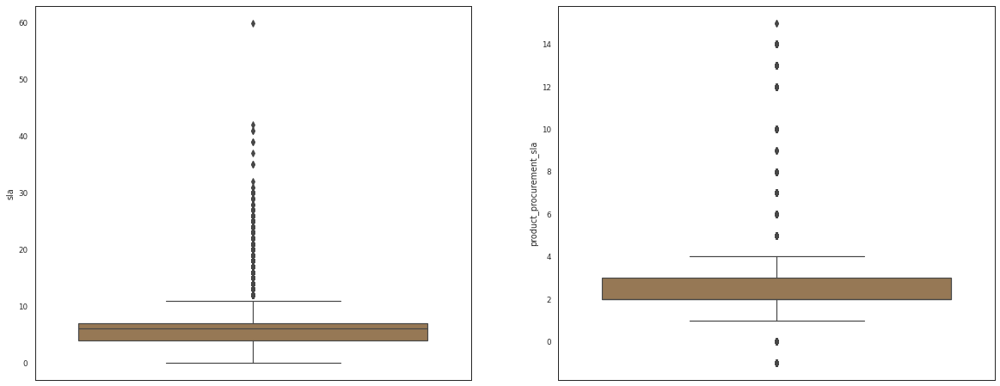

In [805]:
plt.figure(figsize=(20,8))

plt.subplot(1,2,1)
sns.boxplot(y=electronics.sla, palette=("cubehelix"))

plt.subplot(1,2,2)
sns.boxplot(y=electronics.product_procurement_sla, palette=("cubehelix"))

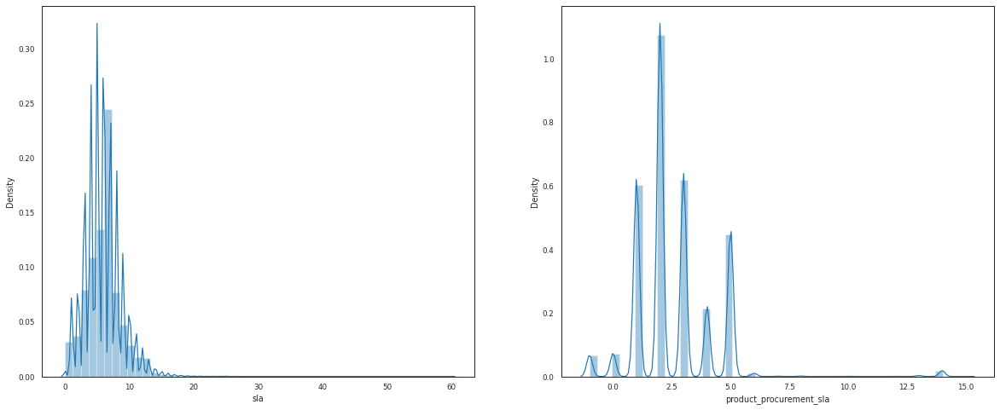

In [806]:
plt.figure(figsize=(20,8))

plt.subplot(1,2,1)
sns.distplot(electronics.sla)

plt.subplot(1,2,2)
sns.distplot(electronics.product_procurement_sla)

In [807]:
electronics.sla.describe(percentiles=[0.0,0.25,0.5,0.75,0.9,0.95,0.99,1.0])

count   524070.000
mean         5.885
std          2.697
min          0.000
0%           0.000
25%          4.000
50%          6.000
75%          7.000
90%          9.000
95%         11.000
99%         14.000
100%        60.000
max         60.000
Name: sla, dtype: float64

In [808]:
electronics.product_procurement_sla.describe(percentiles=[0.0,0.25,0.5,0.75,0.9,0.95,0.99,1.0])

count   524070.000
mean         2.561
std          1.716
min         -1.000
0%          -1.000
25%          2.000
50%          2.000
75%          3.000
90%          5.000
95%          5.000
99%          6.000
100%        15.000
max         15.000
Name: product_procurement_sla, dtype: float64

In [809]:
#Converting negative values to the positive
len(electronics.loc[electronics.product_procurement_sla<0])

10934

In [810]:
electronics.product_procurement_sla = abs(electronics.product_procurement_sla)

In [811]:
#Taking three sigma values for outliers treatment
print(electronics.sla.mean()+(3*(electronics.sla.std())))
print(electronics.sla.mean()-(3*(electronics.sla.std())))

13.976327406531453
-2.2053502469916983


In [812]:
electronics.product_procurement_sla.std()

1.6525151855564293

In [813]:
#Taking three sigma values for outliers treatment
print(electronics.product_procurement_sla.mean()+(3*(electronics.product_procurement_sla.std())))
print(electronics.product_procurement_sla.mean()-(3*(electronics.product_procurement_sla.std())))

7.559938366790074
-2.3551527465485025


In [814]:
# Capping the values at three sigma value
len(electronics[electronics.sla > 14])

3384

In [815]:
# Let's cap the SLAs.
electronics.loc[electronics.sla > 14,'sla'] = 14

In [816]:
# Similarly, the min value of product procurement sla is 0 and the max value is 15. However, three sigma value is 7. 
print(len(electronics[electronics.product_procurement_sla > 7]))

3831


In [817]:
# Let's cap the product procuremtn SLAs.
electronics.loc[electronics.product_procurement_sla > 7,'product_procurement_sla'] = 7

Checking for duplicates in order_id and order_item_id

In [818]:
len(electronics[electronics.duplicated(['order_id','order_item_id'])])

12605

In [819]:
electronics = electronics[~electronics.duplicated(['order_id','order_item_id'])]

In [820]:
len(electronics[electronics.duplicated(['order_id','order_item_id'])])

0

***creating a column Week***

In [821]:
electronics['week'] = np.where(electronics.Year == 2015, (electronics.order_date.dt.week - pd.to_datetime('2015-07-01').week + 1), electronics.order_date.dt.week+27)

# Dates like 2016-01-01 will be 53rd week as per ISO standard, hence the week value would be 53+27=80.
# We can make those values as week 27
electronics.week.values[(electronics.Year == 2016) & (electronics.week == 80)] = 27

In [822]:
electronics.head()

,fsn_id,order_date,Year,Month,order_id,order_item_id,gmv,units,s1_fact.order_payment_type,sla,product_analytic_category,product_analytic_sub_category,product_analytic_vertical,product_mrp,product_procurement_sla,BoomBox,CameraAccessory,CameraBag,CameraBattery,CameraBatteryCharger,CameraBatteryGrip,CameraEyeCup,CameraFilmRolls,CameraHousing,CameraLEDLight,CameraMicrophone,CameraMount,CameraRemoteControl,CameraTripod,CoolingPad,DJController,Dock,DockingStation,ExtensionTube,FMRadio,Filter,Flash,FlashShoeAdapter,GameControlMount,GamePad,GamingAccessoryKit,GamingAdapter,GamingChargingStation,GamingGun,GamingHeadset,GamingKeyboard,GamingMemoryCard,GamingMouse,GamingMousePad,GamingSpeaker,HiFiSystem,HomeAudioSpeaker,JoystickGamingWheel,KaraokePlayer,Lens,MotionController,ReflectorUmbrella,SlingBox,Softbox,SoundMixer,Strap,TVOutCableAccessory,Teleconverter,Telescope,VoiceRecorder,paydate,list_price,discount%,Total_Order_Value,week
0,ACCCX3S58G7B5F6P,2015-10-17 15:11:54,2015,10,3419300926147000.000,3419300926147000.000,6400.000,1,0,5,CameraAccessory,CameraAccessory,CameraTripod,7190.000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6400.000,0.110,7190.000,16
1,ACCCX3S58G7B5F6P,2015-10-19 10:07:22,2015,10,1420830839915200.000,1420830839915200.000,6900.000,1,0,7,CameraAccessory,CameraAccessory,CameraTripod,7190.000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6900.000,0.040,7190.000,17
2,ACCCX3S5AHMF55FV,2015-10-20 15:45:56,2015,10,2421912925714800.000,2421912925714800.000,1990.000,1,0,10,CameraAccessory,CameraAccessory,CameraTripod,2099.000,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1990.000,0.050,2099.000,17
3,ACCCX3S5AHMF55FV,2015-10-14 12:05:15,2015,10,4416592101738400.000,4416592101738400.000,1690.000,1,1,4,CameraAccessory,CameraAccessory,CameraTripod,2099.000,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1690.000,0.190,2099.000,16
4,ACCCX3S5AHMF55FV,2015-10-17 21:25:03,2015,10,4419525153426400.000,4419525153426400.000,1618.000,1,1,6,CameraAccessory,CameraAccessory,CameraTripod,2099.000,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1618.000,0.230,2099.000,16


In [823]:
### Creating Calendar for the period
calendor = pd.DataFrame(pd.date_range('2015-07-01','2016-06-30').tolist(), columns = ['Date'])
### Mapping week in the calendar
calendor['Week'] = calendor.Date.dt.week
### Jan 2016 should be week 54 ,not week 1.
calendor['Week'] = np.where((calendor['Week'] <= 26) & (calendor.Date.dt.year == 2016), calendor['Week']+53, calendor['Week'])


In [824]:
calendor.tail()

,Date,Week
361,2016-06-26,78
362,2016-06-27,79
363,2016-06-28,79
364,2016-06-29,79
365,2016-06-30,79


In [825]:
Sale_days = ["2015-07-18","2015-07-19","2015-08-15","2015-08-16","2015-08-17","2015-08-28","2015-08-29",
                      "2015-08-30","2015-10-15","2015-10-16","2015-10-17","2015-11-07","2015-11-08","2015-11-09",
                      "2015-11-10","2015-11-11","2015-11-12","2015-11-13","2015-11-14","2015-12-25","2015-12-26",
                      "2015-12-27","2015-12-28","2015-12-29","2015-12-30","2015-12-31","2016-01-01","2016-01-02",
                      "2016-01-03","2016-01-20","2016-01-21","2016-01-22","2016-02-01","2016-02-02","2016-02-14",
                      "2016-02-15","2016-02-20","2016-02-21","2016-03-07","2016-03-08","2016-03-09","2016-05-25",
                      "2016-05-26","2016-05-27"]

ss_list = pd.DataFrame(Sale_days,columns = ['Date'])
ss_list['Date'] = pd.to_datetime(ss_list['Date'])
ss_list['Sale_days'] = True

In [826]:
calendor = calendor.merge(ss_list, 'left')
calendor.fillna(False, inplace = True)

In [827]:
calendor.head()

,Date,Week,Sale_days
0,2015-07-01,27,False
1,2015-07-02,27,False
2,2015-07-03,27,False
3,2015-07-04,27,False
4,2015-07-05,27,False


In [828]:
calendor['Sale_days'] = calendor['Sale_days'].astype(int)

In [829]:
calendor.head()

,Date,Week,Sale_days
0,2015-07-01,27,0
1,2015-07-02,27,0
2,2015-07-03,27,0
3,2015-07-04,27,0
4,2015-07-05,27,0


In [830]:
calendor['Payday'] = ((calendor['Date'].dt.day == 1) | (calendor['Date'].dt.day == 15)).astype(int)

## Climate Data

In [831]:
### Ontario Climate data of year 2015-2016 
ontario_climate_2015 = pd.DataFrame(pd.read_excel('/content/gdrive/MyDrive/ONTARIO-2015.xlsx',skiprows=24))
ontario_climate_2016 = pd.DataFrame(pd.read_excel('/content/gdrive/MyDrive/ONTARIO-2016.xlsx',skiprows=24))

In [832]:
### Merge Calendar with dataset on week

ontario_climate = ontario_climate_2015.append(ontario_climate_2016)
ontario_climate = ontario_climate.reset_index()
ontario_climate.head()

,index,Date/Time,Year,Month,Day,Data Quality,Max Temp (°C),Max Temp Flag,Min Temp (°C),Min Temp Flag,Mean Temp (°C),Mean Temp Flag,Heat Deg Days (°C),Heat Deg Days Flag,Cool Deg Days (°C),Cool Deg Days Flag,Total Rain (mm),Total Rain Flag,Total Snow (cm),Total Snow Flag,Total Precip (mm),Total Precip Flag,Snow on Grnd (cm),Snow on Grnd Flag,Dir of Max Gust (10s deg),Dir of Max Gust Flag,Spd of Max Gust (km/h),Spd of Max Gust Flag
0,0,2015-01-01,2015,1,1,†,0.000,NaN,-8.500,NaN,-4.300,NaN,22.300,NaN,0.000,NaN,0.000,NaN,0.000,NaN,0.000,NaN,0.000,NaN,nan,nan,nan,nan
1,1,2015-01-02,2015,1,2,†,3.000,NaN,-3.000,NaN,0.000,NaN,18.000,NaN,0.000,NaN,0.000,NaN,0.000,NaN,0.000,NaN,0.000,NaN,nan,nan,nan,nan
2,2,2015-01-03,2015,1,3,†,2.500,NaN,-4.000,NaN,-0.800,NaN,18.800,NaN,0.000,NaN,24.000,NaN,0.000,NaN,24.000,NaN,0.000,NaN,nan,nan,nan,nan
3,3,2015-01-04,2015,1,4,†,2.500,NaN,0.000,NaN,1.300,NaN,16.700,NaN,0.000,NaN,0.000,NaN,1.000,NaN,1.000,NaN,0.000,NaN,nan,nan,nan,nan
4,4,2015-01-05,2015,1,5,†,-10.000,NaN,-13.500,NaN,-11.800,NaN,29.800,NaN,0.000,NaN,0.000,NaN,3.000,NaN,3.000,NaN,1.000,NaN,nan,nan,nan,nan


In [833]:
#Checking for null values
round((ontario_climate.isnull().sum()/len(ontario_climate.index))*100,2)

index                         0.000
Date/Time                     0.000
Year                          0.000
Month                         0.000
Day                           0.000
Data Quality                 37.620
Max Temp (°C)                39.530
Max Temp Flag                98.080
Min Temp (°C)                44.050
Min Temp Flag                93.570
Mean Temp (°C)               44.050
Mean Temp Flag               93.570
Heat Deg Days (°C)           44.050
Heat Deg Days Flag           93.570
Cool Deg Days (°C)           44.050
Cool Deg Days Flag           93.570
Total Rain (mm)              37.620
Total Rain Flag              98.630
Total Snow (cm)              37.620
Total Snow Flag              97.810
Total Precip (mm)            37.620
Total Precip Flag            97.400
Snow on Grnd (cm)            37.620
Snow on Grnd Flag            98.910
Dir of Max Gust (10s deg)   100.000
Dir of Max Gust Flag        100.000
Spd of Max Gust (km/h)      100.000
Spd of Max Gust Flag        

In [834]:
### Dropping columns we do not require in the analysis.
ontario_climate.drop(['index','Data Quality','Max Temp Flag','Min Temp Flag','Mean Temp Flag',
                      'Heat Deg Days Flag','Cool Deg Days Flag','Total Rain Flag','Total Snow Flag',
                      'Total Precip Flag','Snow on Grnd Flag','Dir of Max Gust (10s deg)','Dir of Max Gust Flag',
                      'Spd of Max Gust (km/h)','Spd of Max Gust Flag'], axis = 1, inplace = True)

Changing the names of columns

In [835]:
ontario_climate.columns = ['Date','Year','Month','Day','max_temp_C','min_temp_C','mean_temp_C','heat_deg_days','cool_deg_days','total_rain_mm','total_snow_cm','total_precip_mm','snow_on_grnd_cm']

In [836]:
ontario_climate['Date'] = ontario_climate['Date'].apply(pd.to_datetime)

In [837]:
### Keeping Climate data from July 15 to June 16

ontario_climate=ontario_climate[(ontario_climate['Month'] >= 7) & (ontario_climate['Year'] == 2015) 
                               |(ontario_climate['Month'] <= 6) & (ontario_climate['Year'] == 2016)]

In [838]:
### Mapping week in the Climate data
ontario_climate['week'] = ontario_climate.Date.dt.week

### Jan 2016 should be week 54 ,not week 1.
ontario_climate['week'] = np.where((ontario_climate['week'] <= 26) & (ontario_climate['Year'] == 2016), ontario_climate['week']+53, ontario_climate['week'])

ontario_climate = ontario_climate.reset_index()
ontario_climate.drop('index',axis=1,inplace=True)
ontario_climate.head()

,Date,Year,Month,Day,max_temp_C,min_temp_C,mean_temp_C,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,total_precip_mm,snow_on_grnd_cm,week
0,2015-07-01,2015,7,1,24.500,17.000,20.800,0.000,2.800,0.000,0.000,0.000,0.000,27
1,2015-07-02,2015,7,2,24.000,14.000,19.000,0.000,1.000,0.000,0.000,0.000,0.000,27
2,2015-07-03,2015,7,3,25.000,10.000,17.500,0.500,0.000,0.000,0.000,0.000,0.000,27
3,2015-07-04,2015,7,4,26.000,11.000,18.500,0.000,0.500,0.000,0.000,0.000,0.000,27
4,2015-07-05,2015,7,5,28.000,14.000,21.000,0.000,3.000,0.000,0.000,0.000,0.000,27


In [839]:
### Checking for any nan values

round((ontario_climate.isnull().sum()/len(ontario_climate.index))*100,2)

Date               0.000
Year               0.000
Month              0.000
Day                0.000
max_temp_C        43.170
min_temp_C        47.810
mean_temp_C       47.810
heat_deg_days     47.810
cool_deg_days     47.810
total_rain_mm     41.260
total_snow_cm     41.260
total_precip_mm   41.260
snow_on_grnd_cm   41.260
week               0.000
dtype: float64

In [840]:
### Replacing Nan with mean value
ontario_climate['max_temp_C'] = ontario_climate['max_temp_C'].fillna(ontario_climate['max_temp_C'].mean())
ontario_climate['min_temp_C'] = ontario_climate['min_temp_C'].fillna(ontario_climate['min_temp_C'].mean())
ontario_climate['mean_temp_C'] = ontario_climate['mean_temp_C'].fillna(ontario_climate['mean_temp_C'].mean())
ontario_climate['heat_deg_days'] = ontario_climate['heat_deg_days'].fillna(ontario_climate['heat_deg_days'].mean())
ontario_climate['cool_deg_days'] = ontario_climate['cool_deg_days'].fillna(ontario_climate['cool_deg_days'].mean())
ontario_climate['total_rain_mm'] = ontario_climate['total_rain_mm'].fillna(ontario_climate['total_rain_mm'].mean())
ontario_climate['total_snow_cm'] = ontario_climate['total_snow_cm'].fillna(ontario_climate['total_snow_cm'].mean())
ontario_climate['total_precip_mm'] = ontario_climate['total_precip_mm'].fillna(ontario_climate['total_precip_mm'].mean())
ontario_climate['snow_on_grnd_cm'] = ontario_climate['snow_on_grnd_cm'].fillna(ontario_climate['snow_on_grnd_cm'].mean())


In [841]:
ontario_climate.head()

,Date,Year,Month,Day,max_temp_C,min_temp_C,mean_temp_C,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,total_precip_mm,snow_on_grnd_cm,week
0,2015-07-01,2015,7,1,24.500,17.000,20.800,0.000,2.800,0.000,0.000,0.000,0.000,27
1,2015-07-02,2015,7,2,24.000,14.000,19.000,0.000,1.000,0.000,0.000,0.000,0.000,27
2,2015-07-03,2015,7,3,25.000,10.000,17.500,0.500,0.000,0.000,0.000,0.000,0.000,27
3,2015-07-04,2015,7,4,26.000,11.000,18.500,0.000,0.500,0.000,0.000,0.000,0.000,27
4,2015-07-05,2015,7,5,28.000,14.000,21.000,0.000,3.000,0.000,0.000,0.000,0.000,27


## NPS

In [842]:
nps_score = pd.read_excel("/content/gdrive/MyDrive/Media data and other information.xlsx", sheet_name='Monthly NPS Score')

In [843]:
nps_score.head()

,Unnamed: 0,July'15,Aug'15,Sept'15,Oct'15,Nov'15,Dec'15,Jan'16,Feb'16,Mar'16,Apr'16,May'16,June'16
0,NPS,54.600,59.987,46.925,44.398,47.000,45.800,47.093,50.327,49.021,51.828,47.307,50.517
1,Stock Index,1177.000,1206.000,1101.000,1210.000,1233.000,1038.000,1052.000,1222.000,1015.000,1242.000,1228.000,1194.000


In [844]:
nps_score = nps_score.T.reset_index(drop=True)
nps_score

,0,1
0,NPS,Stock Index
1,54.600,1177.000
2,59.987,1206.000
3,46.925,1101.000
4,44.398,1210.000
5,47.000,1233.000
6,45.800,1038.000
7,47.093,1052.000
8,50.327,1222.000
9,49.021,1015.000


In [845]:
### Transforming NPS and Stock_index
nps_score.columns = ['NPS','Stock_Index']
nps_score = nps_score.drop(nps_score.index[[0]]).reset_index(drop=True)

In [846]:
nps_score['Month'] = pd.Series([7,8,9,10,11,12,1,2,3,4,5,6])
nps_score['Year'] = pd.Series([2015,2015,2015,2015,2015,2015,2016,2016,2016,2016,2016,2016])

In [847]:
nps_score['NPS'] = nps_score['NPS'].astype(float)
nps_score['Stock_Index'] = nps_score['Stock_Index'].astype(float)

In [848]:
nps_score

,NPS,Stock_Index,Month,Year
0,54.600,1177.000,7,2015
1,59.987,1206.000,8,2015
2,46.925,1101.000,9,2015
3,44.398,1210.000,10,2015
4,47.000,1233.000,11,2015
5,45.800,1038.000,12,2015
6,47.093,1052.000,1,2016
7,50.327,1222.000,2,2016
8,49.021,1015.000,3,2016
9,51.828,1242.000,4,2016


Merging ontario climate and nps_score to calendar dataframe

In [849]:
calendor = calendor.merge(ontario_climate, 'left')

In [850]:
calendor = calendor.merge(nps_score, 'left')

In [851]:
calendor.head()

,Date,Week,Sale_days,Payday,Year,Month,Day,max_temp_C,min_temp_C,mean_temp_C,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,total_precip_mm,snow_on_grnd_cm,week,NPS,Stock_Index
0,2015-07-01,27,0,1,2015,7,1,24.500,17.000,20.800,0.000,2.800,0.000,0.000,0.000,0.000,27,54.600,1177.000
1,2015-07-02,27,0,0,2015,7,2,24.000,14.000,19.000,0.000,1.000,0.000,0.000,0.000,0.000,27,54.600,1177.000
2,2015-07-03,27,0,0,2015,7,3,25.000,10.000,17.500,0.500,0.000,0.000,0.000,0.000,0.000,27,54.600,1177.000
3,2015-07-04,27,0,0,2015,7,4,26.000,11.000,18.500,0.000,0.500,0.000,0.000,0.000,0.000,27,54.600,1177.000
4,2015-07-05,27,0,0,2015,7,5,28.000,14.000,21.000,0.000,3.000,0.000,0.000,0.000,0.000,27,54.600,1177.000


In [852]:
# We can create the week number
calendor['Week'] = np.where(calendor.Date.dt.year == 2015, (calendor.Date.dt.week - pd.to_datetime('2015-07-01').week + 1), calendor.Date.dt.week+27)

# Dates like 2016-01-01 will be 53rd week as per ISO standard, hence the week value would be 53+27=80.
# We can make those values as week 27
calendor.Week.values[(calendor.Date.dt.year == 2016) & (calendor.Week == 80)] = 27

In [853]:
calendor.head()

,Date,Week,Sale_days,Payday,Year,Month,Day,max_temp_C,min_temp_C,mean_temp_C,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,total_precip_mm,snow_on_grnd_cm,week,NPS,Stock_Index
0,2015-07-01,1,0,1,2015,7,1,24.500,17.000,20.800,0.000,2.800,0.000,0.000,0.000,0.000,27,54.600,1177.000
1,2015-07-02,1,0,0,2015,7,2,24.000,14.000,19.000,0.000,1.000,0.000,0.000,0.000,0.000,27,54.600,1177.000
2,2015-07-03,1,0,0,2015,7,3,25.000,10.000,17.500,0.500,0.000,0.000,0.000,0.000,0.000,27,54.600,1177.000
3,2015-07-04,1,0,0,2015,7,4,26.000,11.000,18.500,0.000,0.500,0.000,0.000,0.000,0.000,27,54.600,1177.000
4,2015-07-05,1,0,0,2015,7,5,28.000,14.000,21.000,0.000,3.000,0.000,0.000,0.000,0.000,27,54.600,1177.000


In [854]:
calendor = pd.DataFrame(calendor.groupby('Week').agg({'NPS':'mean','Stock_Index':'mean',
                                                             'Sale_days':'mean','Payday':'mean',
                                                             'max_temp_C':'mean','min_temp_C':'mean',
                                                             'mean_temp_C':'mean','heat_deg_days':'mean',
                                                             'cool_deg_days':'mean','total_rain_mm':'mean',
                                                             'total_snow_cm':'mean','total_precip_mm':'mean',
                                                             'snow_on_grnd_cm':'mean'}))

In [855]:
calendor.reset_index(inplace = True)

In [856]:
calendor.head()

,Week,NPS,Stock_Index,Sale_days,Payday,max_temp_C,min_temp_C,mean_temp_C,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,total_precip_mm,snow_on_grnd_cm
0,1,54.600,1177.000,0.000,0.200,25.500,13.200,19.360,0.100,1.460,0.000,0.000,0.000,0.000
1,2,54.600,1177.000,0.000,0.000,24.025,14.385,19.263,1.059,2.322,4.155,0.029,4.184,0.041
2,3,54.600,1177.000,0.286,0.143,27.383,16.314,21.906,0.816,4.722,1.569,0.029,1.598,0.041
3,4,54.600,1177.000,0.000,0.000,28.240,14.342,20.540,1.632,4.172,1.141,0.029,1.170,0.041
4,5,56.139,1185.286,0.000,0.143,29.811,16.242,23.092,0.816,5.908,4.341,0.029,4.370,0.041


## *Media Invest*

In [857]:
### Marketing Investment Data
media = pd.read_excel("/content/gdrive/MyDrive/Media data and other information.xlsx", sheet_name='Media Investment', skipfooter = 4, skiprows=2)

In [858]:
media.head()

,Unnamed: 0,Year,Month,Total Investment,TV,Digital,Sponsorship,Content Marketing,Online marketing,Affiliates,SEM,Radio,Other
0,nan,2015,7,17.062,0.215,2.533,7.414,0.001,1.327,0.547,5.024,nan,nan
1,nan,2015,8,5.064,0.006,1.278,1.063,0.000,0.129,0.074,2.514,nan,nan
2,nan,2015,9,96.254,3.880,1.357,62.788,0.610,16.380,5.038,6.202,nan,nan
3,nan,2015,10,170.156,6.145,12.622,84.673,3.444,24.372,6.974,31.927,nan,nan
4,nan,2015,11,51.216,4.221,1.275,14.172,0.169,19.562,6.596,5.222,nan,nan


In [859]:
media['Unnamed: 0'].unique()

array([nan])

In [860]:
#Dropping the column

In [861]:
media.drop('Unnamed: 0', axis = 1, inplace = True)


In [862]:
#Checking for null values
media.isnull().sum()

Year                 0
Month                0
Total Investment     0
TV                   0
Digital              0
Sponsorship          0
Content Marketing    0
Online marketing     0
 Affiliates          0
SEM                  0
Radio                9
Other                9
dtype: int64

In [863]:
media['Radio'].fillna(value=0, inplace=True)
media['Other'].fillna(value=0, inplace=True)

media.head()

,Year,Month,Total Investment,TV,Digital,Sponsorship,Content Marketing,Online marketing,Affiliates,SEM,Radio,Other
0,2015,7,17.062,0.215,2.533,7.414,0.001,1.327,0.547,5.024,0.000,0.000
1,2015,8,5.064,0.006,1.278,1.063,0.000,0.129,0.074,2.514,0.000,0.000
2,2015,9,96.254,3.880,1.357,62.788,0.610,16.380,5.038,6.202,0.000,0.000
3,2015,10,170.156,6.145,12.622,84.673,3.444,24.372,6.974,31.927,0.000,0.000
4,2015,11,51.216,4.221,1.275,14.172,0.169,19.562,6.596,5.222,0.000,0.000


In [864]:
media.columns = ['Year','Month','Total_Investment','TV','Digital','Sponsorship','Content_marketing',
                     'Online_marketing','Affiliates','SEM','Radio','Other']

In [865]:
temp_media = pd.DataFrame(index=range(52), columns=['Year', 'Month', 'Week', 'Total Investment', 'TV', 'Digital', 'Sponsorship', 'Content Marketing', 'Online marketing', 'Affiliates', 'SEM', 'Radio', 'Other'])

temp_media.head()

,Year,Month,Week,Total Investment,TV,Digital,Sponsorship,Content Marketing,Online marketing,Affiliates,SEM,Radio,Other
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [866]:
import calendar

def WeekFinderFromYear(year):
        """ will return all the week from selected year """

        import datetime

        WEEK = {'MONDAY':0,'TUESDAY':1,'WEDNESDAY':2,'THURSDAY':3,'FRIDAY':4,'SATURDAY':5,'SUNDAY':6}
        MONTH = {'JANUARY':1,'FEBRUARY':2,'MARCH':3,'APRIL':4,'MAY':5,'JUNE':6,'JULY':7,'AUGUST':8,'SEPTEMBER':9,'OCTOBER':10,'NOVEMBER':11,'DECEMBER':12}

        year = int(year)
        month = MONTH['JANUARY']
        day = WEEK['MONDAY']

        dt = datetime.date(year, month, 1)
        dow_lst = []

        while dt.weekday() != day:
            dt = dt + datetime.timedelta(days = 1)

        lst_month = MONTH.values()

        for mont in lst_month:
         while dt.month == mont:
            dow_lst.append(dt)
            dt = dt + datetime.timedelta(days=7)
            
        month_number_week = {1:[], 2:[], 3:[], 4:[], 5:[], 6:[], 7:[], 8:[], 9:[], 10:[], 11:[], 12:[]}
        month_name_week = {'Jan':[], 'Feb':[], 'Mar':[], 'Apr':[], 'May':[], 'Jun':[], 'Jul':[], 'Aug':[], 'Sep':[], 'Oct':[], 'Nov':[], 'Dec':[]}

        for each in dow_lst:
            month_number_week[each.month].append(each.isocalendar()[1])
            month_name_week[calendar.month_abbr[each.month]].append(each.isocalendar()[1])

        return month_number_week, month_name_week

In [867]:
dict_number_2015, dict_name_2015 = WeekFinderFromYear(2015)
dict_number_2016, dict_name_2016 = WeekFinderFromYear(2016)


In [868]:
i = 0

for index, row in media.iterrows():

    if row.Year == 2015:

        num_weeks = len(dict_number_2015[row.Month])

        for week in dict_number_2015[row.Month]:
            
            temp_media.iloc[i].Year = row.Year
            temp_media.iloc[i].Month = row.Month
            temp_media.iloc[i]['Week'] = week
            temp_media.iloc[i]['Total Investment'] = round(row['Total_Investment'] / num_weeks, 3)
            temp_media.iloc[i]['TV'] = round(row['TV'] / num_weeks, 3)
            temp_media.iloc[i]['Digital'] = round(row['Digital'] / num_weeks, 3)
            temp_media.iloc[i]['Sponsorship'] = round(row['Sponsorship'] / num_weeks, 3)
            temp_media.iloc[i]['Content Marketing'] = round(row['Content_marketing'] / num_weeks, 3)
            temp_media.iloc[i]['Online marketing'] = round(row['Online_marketing'] / num_weeks, 3)
            temp_media.iloc[i]['Affiliates'] = round(row['Affiliates'] / num_weeks, 3)
            temp_media.iloc[i]['SEM'] = round(row['SEM'] / num_weeks, 3)
            temp_media.iloc[i]['Radio'] = round(row['Radio'] / num_weeks, 3)
            temp_media.iloc[i]['Other'] = round(row['Other'] / num_weeks, 3)
            
            i+=1

    elif row.Year == 2016:
        
        num_weeks = len(dict_number_2016[row.Month])

        for week in dict_number_2016[row.Month]:
            
            temp_media.iloc[i].Year = row.Year
            temp_media.iloc[i].Month = row.Month
            temp_media.iloc[i]['Week'] = week
            temp_media.iloc[i]['Total Investment'] = round(row['Total_Investment'] / num_weeks, 3)
            temp_media.iloc[i]['TV'] = round(row['TV'] / num_weeks, 3)
            temp_media.iloc[i]['Digital'] = round(row['Digital'] / num_weeks, 3)
            temp_media.iloc[i]['Sponsorship'] = round(row['Sponsorship'] / num_weeks, 3)
            temp_media.iloc[i]['Content Marketing'] = round(row['Content_marketing'] / num_weeks, 3)
            temp_media.iloc[i]['Online marketing'] = round(row['Online_marketing'] / num_weeks, 3)
            temp_media.iloc[i]['Affiliates'] = round(row['Affiliates'] / num_weeks, 3)
            temp_media.iloc[i]['SEM'] = round(row['SEM'] / num_weeks, 3)
            temp_media.iloc[i]['Radio'] = round(row['Radio'] / num_weeks, 3)
            temp_media.iloc[i]['Other'] = round(row['Other'] / num_weeks, 3)
            
            i+=1

temp_media.head()

,Year,Month,Week,Total Investment,TV,Digital,Sponsorship,Content Marketing,Online marketing,Affiliates,SEM,Radio,Other
0,2015.000,7.000,28,4.265,0.054,0.633,1.854,0.000,0.332,0.137,1.256,0.000,0.000
1,2015.000,7.000,29,4.265,0.054,0.633,1.854,0.000,0.332,0.137,1.256,0.000,0.000
2,2015.000,7.000,30,4.265,0.054,0.633,1.854,0.000,0.332,0.137,1.256,0.000,0.000
3,2015.000,7.000,31,4.265,0.054,0.633,1.854,0.000,0.332,0.137,1.256,0.000,0.000
4,2015.000,8.000,32,1.013,0.001,0.256,0.213,0.000,0.026,0.015,0.503,0.000,0.000


In [869]:
temp_media['Week'] = temp_media['Week'].astype('str')

In [870]:
media = temp_media

In [871]:
media.head()

,Year,Month,Week,Total Investment,TV,Digital,Sponsorship,Content Marketing,Online marketing,Affiliates,SEM,Radio,Other
0,2015.000,7.000,28,4.265,0.054,0.633,1.854,0.000,0.332,0.137,1.256,0.000,0.000
1,2015.000,7.000,29,4.265,0.054,0.633,1.854,0.000,0.332,0.137,1.256,0.000,0.000
2,2015.000,7.000,30,4.265,0.054,0.633,1.854,0.000,0.332,0.137,1.256,0.000,0.000
3,2015.000,7.000,31,4.265,0.054,0.633,1.854,0.000,0.332,0.137,1.256,0.000,0.000
4,2015.000,8.000,32,1.013,0.001,0.256,0.213,0.000,0.026,0.015,0.503,0.000,0.000


In [872]:
media['Week'].nunique()

52

In [873]:
original_col = media.columns[1:]
original_col

Index(['Month', 'Week', 'Total Investment', 'TV', 'Digital', 'Sponsorship',
       'Content Marketing', 'Online marketing', 'Affiliates', 'SEM', 'Radio',
       'Other'],
      dtype='object')

## Calculating 8-weeks Exponential Moving Average for all Advertising media channels

In [874]:
def EMA_variables(df,var,n):
    for i in var:
        loc_index = df.columns.get_loc(i) + 1
        df.insert(loc=loc_index,column= i+'_EMA_'+np.str(n),value=df[i].ewm(span=n, adjust=False).mean())
    return df

In [875]:
media = EMA_variables(media,original_col,8) 
media.head()

,Year,Month,Month_EMA_8,Week,Week_EMA_8,Total Investment,Total Investment_EMA_8,TV,TV_EMA_8,Digital,Digital_EMA_8,Sponsorship,Sponsorship_EMA_8,Content Marketing,Content Marketing_EMA_8,Online marketing,Online marketing_EMA_8,Affiliates,Affiliates_EMA_8,SEM,SEM_EMA_8,Radio,Radio_EMA_8,Other,Other_EMA_8
0,2015.000,7.000,7.000,28,28.000,4.265,4.265,0.054,0.054,0.633,0.633,1.854,1.854,0.000,0.000,0.332,0.332,0.137,0.137,1.256,1.256,0.000,0.000,0.000,0.000
1,2015.000,7.000,7.000,29,28.222,4.265,4.265,0.054,0.054,0.633,0.633,1.854,1.854,0.000,0.000,0.332,0.332,0.137,0.137,1.256,1.256,0.000,0.000,0.000,0.000
2,2015.000,7.000,7.000,30,28.617,4.265,4.265,0.054,0.054,0.633,0.633,1.854,1.854,0.000,0.000,0.332,0.332,0.137,0.137,1.256,1.256,0.000,0.000,0.000,0.000
3,2015.000,7.000,7.000,31,29.147,4.265,4.265,0.054,0.054,0.633,0.633,1.854,1.854,0.000,0.000,0.332,0.332,0.137,0.137,1.256,1.256,0.000,0.000,0.000,0.000
4,2015.000,8.000,7.222,32,29.781,1.013,3.542,0.001,0.042,0.256,0.549,0.213,1.489,0.000,0.000,0.026,0.264,0.015,0.110,0.503,1.089,0.000,0.000,0.000,0.000


## Calculating 5-weeks Simple Moving Average for all Advertising media channels

In [876]:
def SMA_variables(df,var,n):
    for i in var:
        loc_index = df.columns.get_loc(i) + 1
        df.insert(loc=loc_index,column= i+'_SMA_'+np.str(n),value=df[i].rolling(window=n).mean())
    return df

In [877]:
media = SMA_variables(media,original_col,5) 
media.head()

,Year,Month,Month_SMA_5,Month_EMA_8,Week,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_5,Total Investment_EMA_8,TV,TV_SMA_5,TV_EMA_8,Digital,Digital_SMA_5,Digital_EMA_8,Sponsorship,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates,Affiliates_SMA_5,Affiliates_EMA_8,SEM,SEM_SMA_5,SEM_EMA_8,Radio,Radio_SMA_5,Radio_EMA_8,Other,Other_SMA_5,Other_EMA_8
0,2015.000,7.000,nan,7.000,28,nan,28.000,4.265,nan,4.265,0.054,nan,0.054,0.633,nan,0.633,1.854,nan,1.854,0.000,nan,0.000,0.332,nan,0.332,0.137,nan,0.137,1.256,nan,1.256,0.000,nan,0.000,0.000,nan,0.000
1,2015.000,7.000,nan,7.000,29,nan,28.222,4.265,nan,4.265,0.054,nan,0.054,0.633,nan,0.633,1.854,nan,1.854,0.000,nan,0.000,0.332,nan,0.332,0.137,nan,0.137,1.256,nan,1.256,0.000,nan,0.000,0.000,nan,0.000
2,2015.000,7.000,nan,7.000,30,nan,28.617,4.265,nan,4.265,0.054,nan,0.054,0.633,nan,0.633,1.854,nan,1.854,0.000,nan,0.000,0.332,nan,0.332,0.137,nan,0.137,1.256,nan,1.256,0.000,nan,0.000,0.000,nan,0.000
3,2015.000,7.000,nan,7.000,31,nan,29.147,4.265,nan,4.265,0.054,nan,0.054,0.633,nan,0.633,1.854,nan,1.854,0.000,nan,0.000,0.332,nan,0.332,0.137,nan,0.137,1.256,nan,1.256,0.000,nan,0.000,0.000,nan,0.000
4,2015.000,8.000,7.200,7.222,32,30.000,29.781,1.013,3.615,3.542,0.001,0.043,0.042,0.256,0.558,0.549,0.213,1.526,1.489,0.000,0.000,0.000,0.026,0.271,0.264,0.015,0.113,0.110,0.503,1.105,1.089,0.000,0.000,0.000,0.000,0.000,0.000


## Calculating 3-weeks Simple Moving Average for all Advertising media channels

In [878]:

def SMA_variables(df,var,n):
    for i in var:
        loc_index = df.columns.get_loc(i) + 1
        df.insert(loc=loc_index,column= i+'_SMA_'+np.str(n),value=df[i].rolling(window=n).mean())
    return df

In [879]:
media = SMA_variables(media,original_col,3) 
media.head()

,Year,Month,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other,Other_SMA_3,Other_SMA_5,Other_EMA_8
0,2015.000,7.000,nan,nan,7.000,28,nan,nan,28.000,4.265,nan,nan,4.265,0.054,nan,nan,0.054,0.633,nan,nan,0.633,1.854,nan,nan,1.854,0.000,nan,nan,0.000,0.332,nan,nan,0.332,0.137,nan,nan,0.137,1.256,nan,nan,1.256,0.000,nan,nan,0.000,0.000,nan,nan,0.000
1,2015.000,7.000,nan,nan,7.000,29,nan,nan,28.222,4.265,nan,nan,4.265,0.054,nan,nan,0.054,0.633,nan,nan,0.633,1.854,nan,nan,1.854,0.000,nan,nan,0.000,0.332,nan,nan,0.332,0.137,nan,nan,0.137,1.256,nan,nan,1.256,0.000,nan,nan,0.000,0.000,nan,nan,0.000
2,2015.000,7.000,7.000,nan,7.000,30,29.000,nan,28.617,4.265,4.265,nan,4.265,0.054,0.054,nan,0.054,0.633,0.633,nan,0.633,1.854,1.854,nan,1.854,0.000,0.000,nan,0.000,0.332,0.332,nan,0.332,0.137,0.137,nan,0.137,1.256,1.256,nan,1.256,0.000,0.000,nan,0.000,0.000,0.000,nan,0.000
3,2015.000,7.000,7.000,nan,7.000,31,30.000,nan,29.147,4.265,4.265,nan,4.265,0.054,0.054,nan,0.054,0.633,0.633,nan,0.633,1.854,1.854,nan,1.854,0.000,0.000,nan,0.000,0.332,0.332,nan,0.332,0.137,0.137,nan,0.137,1.256,1.256,nan,1.256,0.000,0.000,nan,0.000,0.000,0.000,nan,0.000
4,2015.000,8.000,7.333,7.200,7.222,32,31.000,30.000,29.781,1.013,3.181,3.615,3.542,0.001,0.036,0.043,0.042,0.256,0.507,0.558,0.549,0.213,1.307,1.526,1.489,0.000,0.000,0.000,0.000,0.026,0.230,0.271,0.264,0.015,0.096,0.113,0.110,0.503,1.005,1.105,1.089,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000


In [880]:
media['Date'] = pd.to_datetime(media[['Year', 'Month']].assign(DAY=1))
#media.set_index('Date', inplace = True)


In [881]:
media['Month'].nunique()

12

In [882]:
#del media['Year']
#del media['Month']
media.head()

,Year,Month,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other,Other_SMA_3,Other_SMA_5,Other_EMA_8,Date
0,2015.000,7.000,nan,nan,7.000,28,nan,nan,28.000,4.265,nan,nan,4.265,0.054,nan,nan,0.054,0.633,nan,nan,0.633,1.854,nan,nan,1.854,0.000,nan,nan,0.000,0.332,nan,nan,0.332,0.137,nan,nan,0.137,1.256,nan,nan,1.256,0.000,nan,nan,0.000,0.000,nan,nan,0.000,2015-07-01
1,2015.000,7.000,nan,nan,7.000,29,nan,nan,28.222,4.265,nan,nan,4.265,0.054,nan,nan,0.054,0.633,nan,nan,0.633,1.854,nan,nan,1.854,0.000,nan,nan,0.000,0.332,nan,nan,0.332,0.137,nan,nan,0.137,1.256,nan,nan,1.256,0.000,nan,nan,0.000,0.000,nan,nan,0.000,2015-07-01
2,2015.000,7.000,7.000,nan,7.000,30,29.000,nan,28.617,4.265,4.265,nan,4.265,0.054,0.054,nan,0.054,0.633,0.633,nan,0.633,1.854,1.854,nan,1.854,0.000,0.000,nan,0.000,0.332,0.332,nan,0.332,0.137,0.137,nan,0.137,1.256,1.256,nan,1.256,0.000,0.000,nan,0.000,0.000,0.000,nan,0.000,2015-07-01
3,2015.000,7.000,7.000,nan,7.000,31,30.000,nan,29.147,4.265,4.265,nan,4.265,0.054,0.054,nan,0.054,0.633,0.633,nan,0.633,1.854,1.854,nan,1.854,0.000,0.000,nan,0.000,0.332,0.332,nan,0.332,0.137,0.137,nan,0.137,1.256,1.256,nan,1.256,0.000,0.000,nan,0.000,0.000,0.000,nan,0.000,2015-07-01
4,2015.000,8.000,7.333,7.200,7.222,32,31.000,30.000,29.781,1.013,3.181,3.615,3.542,0.001,0.036,0.043,0.042,0.256,0.507,0.558,0.549,0.213,1.307,1.526,1.489,0.000,0.000,0.000,0.000,0.026,0.230,0.271,0.264,0.015,0.096,0.113,0.110,0.503,1.005,1.105,1.089,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,2015-08-01


In [883]:
media.head()

,Year,Month,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other,Other_SMA_3,Other_SMA_5,Other_EMA_8,Date
0,2015.000,7.000,nan,nan,7.000,28,nan,nan,28.000,4.265,nan,nan,4.265,0.054,nan,nan,0.054,0.633,nan,nan,0.633,1.854,nan,nan,1.854,0.000,nan,nan,0.000,0.332,nan,nan,0.332,0.137,nan,nan,0.137,1.256,nan,nan,1.256,0.000,nan,nan,0.000,0.000,nan,nan,0.000,2015-07-01
1,2015.000,7.000,nan,nan,7.000,29,nan,nan,28.222,4.265,nan,nan,4.265,0.054,nan,nan,0.054,0.633,nan,nan,0.633,1.854,nan,nan,1.854,0.000,nan,nan,0.000,0.332,nan,nan,0.332,0.137,nan,nan,0.137,1.256,nan,nan,1.256,0.000,nan,nan,0.000,0.000,nan,nan,0.000,2015-07-01
2,2015.000,7.000,7.000,nan,7.000,30,29.000,nan,28.617,4.265,4.265,nan,4.265,0.054,0.054,nan,0.054,0.633,0.633,nan,0.633,1.854,1.854,nan,1.854,0.000,0.000,nan,0.000,0.332,0.332,nan,0.332,0.137,0.137,nan,0.137,1.256,1.256,nan,1.256,0.000,0.000,nan,0.000,0.000,0.000,nan,0.000,2015-07-01
3,2015.000,7.000,7.000,nan,7.000,31,30.000,nan,29.147,4.265,4.265,nan,4.265,0.054,0.054,nan,0.054,0.633,0.633,nan,0.633,1.854,1.854,nan,1.854,0.000,0.000,nan,0.000,0.332,0.332,nan,0.332,0.137,0.137,nan,0.137,1.256,1.256,nan,1.256,0.000,0.000,nan,0.000,0.000,0.000,nan,0.000,2015-07-01
4,2015.000,8.000,7.333,7.200,7.222,32,31.000,30.000,29.781,1.013,3.181,3.615,3.542,0.001,0.036,0.043,0.042,0.256,0.507,0.558,0.549,0.213,1.307,1.526,1.489,0.000,0.000,0.000,0.000,0.026,0.230,0.271,0.264,0.015,0.096,0.113,0.110,0.503,1.005,1.105,1.089,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,2015-08-01


## ADSTOCK

In [884]:
def adstocked_advertising(adstock_rate=0.5, advertising = media):
    
    adstocked_advertising = []
    for i in range(len(advertising)):
        if i == 0: 
            adstocked_advertising.append(advertising.iloc[i])
        else:
            adstocked_advertising.append(advertising.iloc[i] + adstock_rate * advertising.iloc[i-1])            
    return adstocked_advertising


In [885]:
adstock = pd.DataFrame()

In [886]:
adstock['TV_ads'] = adstocked_advertising(adstock_rate=0.5, advertising = media['TV'])

adstock['Digital_ads'] = adstocked_advertising(adstock_rate=0.5, advertising = media['Digital'])

adstock['Sponsorship_ads'] = adstocked_advertising(adstock_rate=0.5, advertising = media['Sponsorship'])

adstock['Content_marketing_ads'] = adstocked_advertising(adstock_rate=0.5, advertising = media['Content Marketing'])

adstock['Online_marketing_ads'] = adstocked_advertising(adstock_rate=0.5, advertising = media['Online marketing'])

adstock['Affiliates_ads'] = adstocked_advertising(adstock_rate=0.5, advertising = media['Affiliates'])

adstock['SEM_ads'] = adstocked_advertising(adstock_rate=0.5, advertising = media['SEM'])

adstock['Radio_ads'] = adstocked_advertising(adstock_rate=0.5, advertising = media['Radio'])

adstock['Other_ads'] = adstocked_advertising(adstock_rate=0.5, advertising = media['Other'])

In [887]:
adstock.head()

,TV_ads,Digital_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,Affiliates_ads,SEM_ads,Radio_ads,Other_ads
0,0.054,0.633,1.854,0.000,0.332,0.137,1.256,0.000,0.000
1,0.081,0.950,2.781,0.000,0.498,0.206,1.884,0.000,0.000
2,0.081,0.950,2.781,0.000,0.498,0.206,1.884,0.000,0.000
3,0.081,0.950,2.781,0.000,0.498,0.206,1.884,0.000,0.000
4,0.028,0.573,1.140,0.000,0.192,0.084,1.131,0.000,0.000


In [888]:
#concatinating media and adstock
media = pd.concat([media,adstock] ,axis=1)

In [889]:
media.head()

,Year,Month,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other,Other_SMA_3,Other_SMA_5,Other_EMA_8,Date,TV_ads,Digital_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,Affiliates_ads,SEM_ads,Radio_ads,Other_ads
0,2015.000,7.000,nan,nan,7.000,28,nan,nan,28.000,4.265,nan,nan,4.265,0.054,nan,nan,0.054,0.633,nan,nan,0.633,1.854,nan,nan,1.854,0.000,nan,nan,0.000,0.332,nan,nan,0.332,0.137,nan,nan,0.137,1.256,nan,nan,1.256,0.000,nan,nan,0.000,0.000,nan,nan,0.000,2015-07-01,0.054,0.633,1.854,0.000,0.332,0.137,1.256,0.000,0.000
1,2015.000,7.000,nan,nan,7.000,29,nan,nan,28.222,4.265,nan,nan,4.265,0.054,nan,nan,0.054,0.633,nan,nan,0.633,1.854,nan,nan,1.854,0.000,nan,nan,0.000,0.332,nan,nan,0.332,0.137,nan,nan,0.137,1.256,nan,nan,1.256,0.000,nan,nan,0.000,0.000,nan,nan,0.000,2015-07-01,0.081,0.950,2.781,0.000,0.498,0.206,1.884,0.000,0.000
2,2015.000,7.000,7.000,nan,7.000,30,29.000,nan,28.617,4.265,4.265,nan,4.265,0.054,0.054,nan,0.054,0.633,0.633,nan,0.633,1.854,1.854,nan,1.854,0.000,0.000,nan,0.000,0.332,0.332,nan,0.332,0.137,0.137,nan,0.137,1.256,1.256,nan,1.256,0.000,0.000,nan,0.000,0.000,0.000,nan,0.000,2015-07-01,0.081,0.950,2.781,0.000,0.498,0.206,1.884,0.000,0.000
3,2015.000,7.000,7.000,nan,7.000,31,30.000,nan,29.147,4.265,4.265,nan,4.265,0.054,0.054,nan,0.054,0.633,0.633,nan,0.633,1.854,1.854,nan,1.854,0.000,0.000,nan,0.000,0.332,0.332,nan,0.332,0.137,0.137,nan,0.137,1.256,1.256,nan,1.256,0.000,0.000,nan,0.000,0.000,0.000,nan,0.000,2015-07-01,0.081,0.950,2.781,0.000,0.498,0.206,1.884,0.000,0.000
4,2015.000,8.000,7.333,7.200,7.222,32,31.000,30.000,29.781,1.013,3.181,3.615,3.542,0.001,0.036,0.043,0.042,0.256,0.507,0.558,0.549,0.213,1.307,1.526,1.489,0.000,0.000,0.000,0.000,0.026,0.230,0.271,0.264,0.015,0.096,0.113,0.110,0.503,1.005,1.105,1.089,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,2015-08-01,0.028,0.573,1.140,0.000,0.192,0.084,1.131,0.000,0.000


Product Premiumness

In [890]:
# The premium-ness of the product depends on the MRP. Higher the MRP, more premium is the product.
# Let's check the percentiles of MRP in the dataset.

electronics.product_mrp.describe(percentiles=[0.25,0.5,0.75,0.8,0.9,0.95,0.99])

count   511465.000
mean      2502.310
std       4703.989
min         79.000
25%        766.000
50%       1200.000
75%       2800.000
80%       3150.000
90%       5399.000
95%       6990.000
99%      19000.000
max     180000.000
Name: product_mrp, dtype: float64

In [891]:
# Let's assume that products with MRP greater than 90 percentile to be premium products.
# Create a dataframe with mrp, number of units sold and gmv against each product vertical to analyse better.
prod_cat = pd.DataFrame(pd.pivot_table(electronics, values = ['units','product_mrp', 'gmv'], index = ['product_analytic_vertical'], 
               aggfunc={'units':np.sum, 'product_mrp':np.mean, 'gmv':np.sum}).to_records())

In [892]:
# Marking products with MRP greater than 90th percentile with 1 and rest with 0
prod_cat['premium_product'] = np.where((prod_cat.product_mrp>electronics.product_mrp.quantile(0.9)),1,0)

In [893]:
prod_cat.loc[prod_cat.premium_product==1]

,product_analytic_vertical,gmv,product_mrp,units,premium_product
10,CameraLEDLight,20215.000,6738.333,3,1
16,DJController,2326737.000,17774.722,192,1
39,KaraokePlayer,23500.000,12000.000,2,1
41,MotionController,4109549.000,5810.908,1056,1
43,SlingBox,20495.000,7999.000,5,1
45,SoundMixer,629673.000,12270.956,68,1
48,Teleconverter,15299.000,20490.000,1,1


- Clearly, Teleconverter, SoundMixer, SlingBox, MotionController, KaraokePlayer, DJController are premium products. All other products are mass products.
- Let's visualise how the premium products contribute towards the GMV.

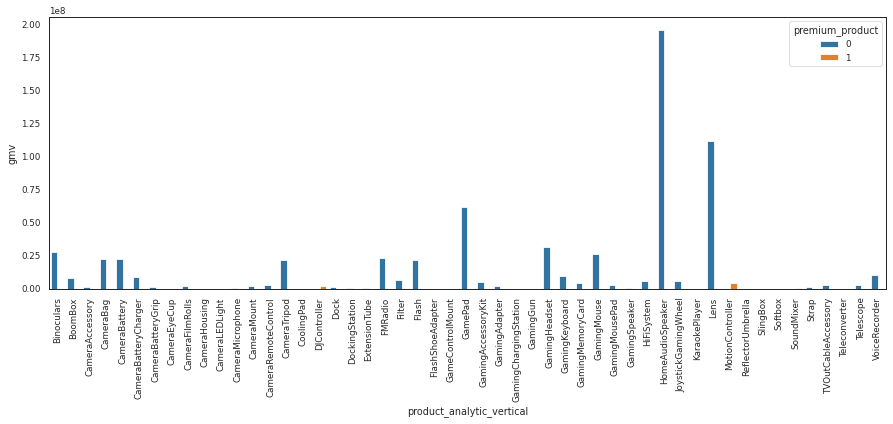

In [894]:
plt.figure(figsize=(15,5))
sns.barplot(x = prod_cat.product_analytic_vertical, y=prod_cat.gmv, hue=prod_cat.premium_product)
plt.xticks(rotation=90)
plt.show()

- We can clearly see that, maximum revenue is generated through mass producs like HomeAudioSpeaker, Lens, GamingPad, etc and not premium products that contibute quite less towards revenue.
- The company hence should focus more on mass products than premium products.

In [895]:
electronics = electronics.merge(prod_cat[['product_analytic_vertical', 'premium_product']] , left_on='product_analytic_vertical', 
            right_on='product_analytic_vertical',
                   how = 'inner')

In [896]:
sales = electronics.copy()

In [897]:
electronics.head()

,fsn_id,order_date,Year,Month,order_id,order_item_id,gmv,units,s1_fact.order_payment_type,sla,product_analytic_category,product_analytic_sub_category,product_analytic_vertical,product_mrp,product_procurement_sla,BoomBox,CameraAccessory,CameraBag,CameraBattery,CameraBatteryCharger,CameraBatteryGrip,CameraEyeCup,CameraFilmRolls,CameraHousing,CameraLEDLight,CameraMicrophone,CameraMount,CameraRemoteControl,CameraTripod,CoolingPad,DJController,Dock,DockingStation,ExtensionTube,FMRadio,Filter,Flash,FlashShoeAdapter,GameControlMount,GamePad,GamingAccessoryKit,GamingAdapter,GamingChargingStation,GamingGun,GamingHeadset,GamingKeyboard,GamingMemoryCard,GamingMouse,GamingMousePad,GamingSpeaker,HiFiSystem,HomeAudioSpeaker,JoystickGamingWheel,KaraokePlayer,Lens,MotionController,ReflectorUmbrella,SlingBox,Softbox,SoundMixer,Strap,TVOutCableAccessory,Teleconverter,Telescope,VoiceRecorder,paydate,list_price,discount%,Total_Order_Value,week,premium_product
0,ACCCX3S58G7B5F6P,2015-10-17 15:11:54,2015,10,3419300926147000.000,3419300926147000.000,6400.000,1,0,5,CameraAccessory,CameraAccessory,CameraTripod,7190.000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6400.000,0.110,7190.000,16,0
1,ACCCX3S58G7B5F6P,2015-10-19 10:07:22,2015,10,1420830839915200.000,1420830839915200.000,6900.000,1,0,7,CameraAccessory,CameraAccessory,CameraTripod,7190.000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6900.000,0.040,7190.000,17,0
2,ACCCX3S5AHMF55FV,2015-10-20 15:45:56,2015,10,2421912925714800.000,2421912925714800.000,1990.000,1,0,10,CameraAccessory,CameraAccessory,CameraTripod,2099.000,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1990.000,0.050,2099.000,17,0
3,ACCCX3S5AHMF55FV,2015-10-14 12:05:15,2015,10,4416592101738400.000,4416592101738400.000,1690.000,1,1,4,CameraAccessory,CameraAccessory,CameraTripod,2099.000,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1690.000,0.190,2099.000,16,0
4,ACCCX3S5AHMF55FV,2015-10-17 21:25:03,2015,10,4419525153426400.000,4419525153426400.000,1618.000,1,1,6,CameraAccessory,CameraAccessory,CameraTripod,2099.000,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1618.000,0.230,2099.000,16,0


## **Creating 3 seperate dataframes for 3 sub categories**

In [898]:
electronics.head()

,fsn_id,order_date,Year,Month,order_id,order_item_id,gmv,units,s1_fact.order_payment_type,sla,product_analytic_category,product_analytic_sub_category,product_analytic_vertical,product_mrp,product_procurement_sla,BoomBox,CameraAccessory,CameraBag,CameraBattery,CameraBatteryCharger,CameraBatteryGrip,CameraEyeCup,CameraFilmRolls,CameraHousing,CameraLEDLight,CameraMicrophone,CameraMount,CameraRemoteControl,CameraTripod,CoolingPad,DJController,Dock,DockingStation,ExtensionTube,FMRadio,Filter,Flash,FlashShoeAdapter,GameControlMount,GamePad,GamingAccessoryKit,GamingAdapter,GamingChargingStation,GamingGun,GamingHeadset,GamingKeyboard,GamingMemoryCard,GamingMouse,GamingMousePad,GamingSpeaker,HiFiSystem,HomeAudioSpeaker,JoystickGamingWheel,KaraokePlayer,Lens,MotionController,ReflectorUmbrella,SlingBox,Softbox,SoundMixer,Strap,TVOutCableAccessory,Teleconverter,Telescope,VoiceRecorder,paydate,list_price,discount%,Total_Order_Value,week,premium_product
0,ACCCX3S58G7B5F6P,2015-10-17 15:11:54,2015,10,3419300926147000.000,3419300926147000.000,6400.000,1,0,5,CameraAccessory,CameraAccessory,CameraTripod,7190.000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6400.000,0.110,7190.000,16,0
1,ACCCX3S58G7B5F6P,2015-10-19 10:07:22,2015,10,1420830839915200.000,1420830839915200.000,6900.000,1,0,7,CameraAccessory,CameraAccessory,CameraTripod,7190.000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6900.000,0.040,7190.000,17,0
2,ACCCX3S5AHMF55FV,2015-10-20 15:45:56,2015,10,2421912925714800.000,2421912925714800.000,1990.000,1,0,10,CameraAccessory,CameraAccessory,CameraTripod,2099.000,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1990.000,0.050,2099.000,17,0
3,ACCCX3S5AHMF55FV,2015-10-14 12:05:15,2015,10,4416592101738400.000,4416592101738400.000,1690.000,1,1,4,CameraAccessory,CameraAccessory,CameraTripod,2099.000,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1690.000,0.190,2099.000,16,0
4,ACCCX3S5AHMF55FV,2015-10-17 21:25:03,2015,10,4419525153426400.000,4419525153426400.000,1618.000,1,1,6,CameraAccessory,CameraAccessory,CameraTripod,2099.000,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1618.000,0.230,2099.000,16,0


In [899]:
electronics.rename(columns={'week': 'Week'},inplace=True)

In [900]:
electronics.head()

,fsn_id,order_date,Year,Month,order_id,order_item_id,gmv,units,s1_fact.order_payment_type,sla,product_analytic_category,product_analytic_sub_category,product_analytic_vertical,product_mrp,product_procurement_sla,BoomBox,CameraAccessory,CameraBag,CameraBattery,CameraBatteryCharger,CameraBatteryGrip,CameraEyeCup,CameraFilmRolls,CameraHousing,CameraLEDLight,CameraMicrophone,CameraMount,CameraRemoteControl,CameraTripod,CoolingPad,DJController,Dock,DockingStation,ExtensionTube,FMRadio,Filter,Flash,FlashShoeAdapter,GameControlMount,GamePad,GamingAccessoryKit,GamingAdapter,GamingChargingStation,GamingGun,GamingHeadset,GamingKeyboard,GamingMemoryCard,GamingMouse,GamingMousePad,GamingSpeaker,HiFiSystem,HomeAudioSpeaker,JoystickGamingWheel,KaraokePlayer,Lens,MotionController,ReflectorUmbrella,SlingBox,Softbox,SoundMixer,Strap,TVOutCableAccessory,Teleconverter,Telescope,VoiceRecorder,paydate,list_price,discount%,Total_Order_Value,Week,premium_product
0,ACCCX3S58G7B5F6P,2015-10-17 15:11:54,2015,10,3419300926147000.000,3419300926147000.000,6400.000,1,0,5,CameraAccessory,CameraAccessory,CameraTripod,7190.000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6400.000,0.110,7190.000,16,0
1,ACCCX3S58G7B5F6P,2015-10-19 10:07:22,2015,10,1420830839915200.000,1420830839915200.000,6900.000,1,0,7,CameraAccessory,CameraAccessory,CameraTripod,7190.000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6900.000,0.040,7190.000,17,0
2,ACCCX3S5AHMF55FV,2015-10-20 15:45:56,2015,10,2421912925714800.000,2421912925714800.000,1990.000,1,0,10,CameraAccessory,CameraAccessory,CameraTripod,2099.000,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1990.000,0.050,2099.000,17,0
3,ACCCX3S5AHMF55FV,2015-10-14 12:05:15,2015,10,4416592101738400.000,4416592101738400.000,1690.000,1,1,4,CameraAccessory,CameraAccessory,CameraTripod,2099.000,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1690.000,0.190,2099.000,16,0
4,ACCCX3S5AHMF55FV,2015-10-17 21:25:03,2015,10,4419525153426400.000,4419525153426400.000,1618.000,1,1,6,CameraAccessory,CameraAccessory,CameraTripod,2099.000,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1618.000,0.230,2099.000,16,0


In [901]:
electronics['Week'] = electronics['Week'].astype('str')

In [902]:
camera_access = electronics[electronics['product_analytic_sub_category'] == 'CameraAccessory']
gaming = electronics[electronics['product_analytic_sub_category'] == 'GamingAccessory']
home_audio = electronics[electronics['product_analytic_sub_category'] == 'HomeAudio']


In [903]:
camera_access.dtypes

fsn_id                                   object
order_date                       datetime64[ns]
Year                                      int64
Month                                     int64
order_id                                float64
order_item_id                           float64
gmv                                     float64
units                                     int64
s1_fact.order_payment_type                int64
sla                                       int64
product_analytic_category                object
product_analytic_sub_category            object
product_analytic_vertical                object
product_mrp                             float64
product_procurement_sla                   int64
BoomBox                                   uint8
CameraAccessory                           uint8
CameraBag                                 uint8
CameraBattery                             uint8
CameraBatteryCharger                      uint8
CameraBatteryGrip                       

In [904]:
camera_access.shape

(211806, 71)

**OUTLIER DETECTION**

Checking for Outliers

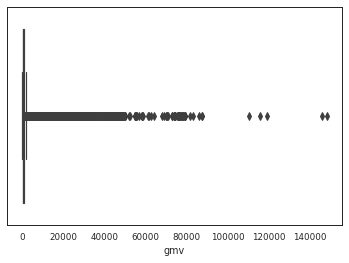

In [905]:
sns.boxplot(camera_access['gmv'])

In [906]:
Q1 = camera_access.gmv.quantile(0.25)
Q3 = camera_access.gmv.quantile(0.75)
IQR = Q3 - Q1
camera_access = camera_access[(camera_access.gmv >= Q1 - 1.5*IQR) & (camera_access.gmv <= Q3 + 1.5*IQR)]


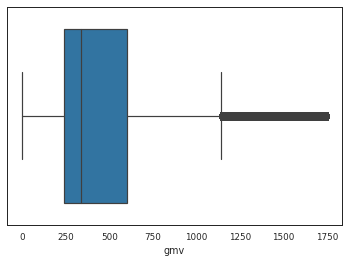

In [907]:
sns.boxplot(camera_access['gmv'])

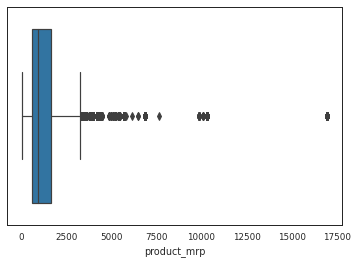

In [908]:
sns.boxplot(camera_access['product_mrp'])


In [909]:
Q1 = camera_access.product_mrp.quantile(0.25)
Q3 = camera_access.product_mrp.quantile(0.75)
IQR = Q3 - Q1
camera_access = camera_access[(camera_access.product_mrp >= Q1 - 1.5*IQR) & (camera_access.product_mrp <= Q3 + 1.5*IQR)]


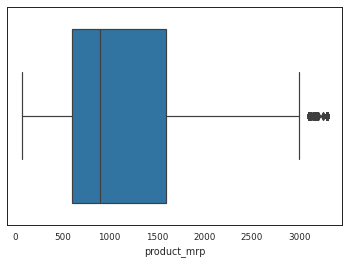

In [910]:
sns.boxplot(camera_access['product_mrp'])

In [911]:
camera_access.head()

,fsn_id,order_date,Year,Month,order_id,order_item_id,gmv,units,s1_fact.order_payment_type,sla,product_analytic_category,product_analytic_sub_category,product_analytic_vertical,product_mrp,product_procurement_sla,BoomBox,CameraAccessory,CameraBag,CameraBattery,CameraBatteryCharger,CameraBatteryGrip,CameraEyeCup,CameraFilmRolls,CameraHousing,CameraLEDLight,CameraMicrophone,CameraMount,CameraRemoteControl,CameraTripod,CoolingPad,DJController,Dock,DockingStation,ExtensionTube,FMRadio,Filter,Flash,FlashShoeAdapter,GameControlMount,GamePad,GamingAccessoryKit,GamingAdapter,GamingChargingStation,GamingGun,GamingHeadset,GamingKeyboard,GamingMemoryCard,GamingMouse,GamingMousePad,GamingSpeaker,HiFiSystem,HomeAudioSpeaker,JoystickGamingWheel,KaraokePlayer,Lens,MotionController,ReflectorUmbrella,SlingBox,Softbox,SoundMixer,Strap,TVOutCableAccessory,Teleconverter,Telescope,VoiceRecorder,paydate,list_price,discount%,Total_Order_Value,Week,premium_product
3,ACCCX3S5AHMF55FV,2015-10-14 12:05:15,2015,10,4416592101738400.000,4416592101738400.000,1690.000,1,1,4,CameraAccessory,CameraAccessory,CameraTripod,2099.000,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1690.000,0.190,2099.000,16,0
4,ACCCX3S5AHMF55FV,2015-10-17 21:25:03,2015,10,4419525153426400.000,4419525153426400.000,1618.000,1,1,6,CameraAccessory,CameraAccessory,CameraTripod,2099.000,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1618.000,0.230,2099.000,16,0
17,ACCD38YG3UDFDG6D,2015-10-06 00:45:01,2015,10,2409274855504000.000,2409274855504000.000,1495.000,1,0,5,CameraAccessory,CameraAccessory,CameraTripod,2750.000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1495.000,0.460,2750.000,15,0
18,ACCD38YG3UDFDG6D,2015-10-12 23:38:46,2015,10,4415284052002400.000,4415284052002400.000,1440.000,1,0,5,CameraAccessory,CameraAccessory,CameraTripod,2750.000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1440.000,0.480,2750.000,16,0
19,ACCD38YG3UDFDG6D,2015-10-14 10:09:46,2015,10,1416516698047300.000,1416516698047300.000,1440.000,1,0,4,CameraAccessory,CameraAccessory,CameraTripod,2750.000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1440.000,0.480,2750.000,16,0


In [912]:
gaming.head()

,fsn_id,order_date,Year,Month,order_id,order_item_id,gmv,units,s1_fact.order_payment_type,sla,product_analytic_category,product_analytic_sub_category,product_analytic_vertical,product_mrp,product_procurement_sla,BoomBox,CameraAccessory,CameraBag,CameraBattery,CameraBatteryCharger,CameraBatteryGrip,CameraEyeCup,CameraFilmRolls,CameraHousing,CameraLEDLight,CameraMicrophone,CameraMount,CameraRemoteControl,CameraTripod,CoolingPad,DJController,Dock,DockingStation,ExtensionTube,FMRadio,Filter,Flash,FlashShoeAdapter,GameControlMount,GamePad,GamingAccessoryKit,GamingAdapter,GamingChargingStation,GamingGun,GamingHeadset,GamingKeyboard,GamingMemoryCard,GamingMouse,GamingMousePad,GamingSpeaker,HiFiSystem,HomeAudioSpeaker,JoystickGamingWheel,KaraokePlayer,Lens,MotionController,ReflectorUmbrella,SlingBox,Softbox,SoundMixer,Strap,TVOutCableAccessory,Teleconverter,Telescope,VoiceRecorder,paydate,list_price,discount%,Total_Order_Value,Week,premium_product
174625,ACCCZ34CBVZJTVQF,2015-10-04 19:24:36,2015,10,1408216975064600.000,1408216975064600.000,3075.000,1,0,9,GamingHardware,GamingAccessory,GamePad,3999.000,5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3075.000,0.230,3999.000,14,0
174626,ACCCZ34CBVZJTVQF,2015-10-14 22:54:54,2015,10,1416985339691600.000,1416985339691600.000,2750.000,1,0,7,GamingHardware,GamingAccessory,GamePad,3999.000,5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2750.000,0.310,3999.000,16,0
174627,ACCCZ34CBVZJTVQF,2015-10-15 20:19:38,2015,10,1417669228375400.000,1417669228375400.000,2899.000,1,1,5,GamingHardware,GamingAccessory,GamePad,3999.000,5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,2899.000,0.280,3999.000,16,0
174628,ACCCZ34CBVZJTVQF,2015-10-17 18:21:43,2015,10,1419414998353400.000,1419414998353400.000,2609.000,1,1,5,GamingHardware,GamingAccessory,GamePad,3999.000,5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2609.000,0.350,3999.000,16,0
174629,ACCCZ34CBVZJTVQF,2015-10-26 17:49:39,2015,10,1427167582532600.000,1427167582532600.000,2772.000,1,1,5,GamingHardware,GamingAccessory,GamePad,3999.000,5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2772.000,0.310,3999.000,18,0


Checking for Outliers

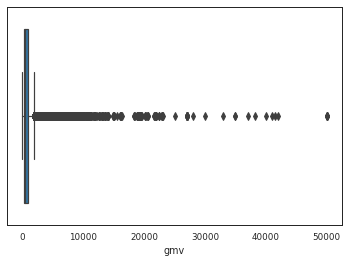

In [913]:

sns.boxplot(gaming['gmv'])

In [914]:
Q1 = gaming.gmv.quantile(0.25)
Q3 = gaming.gmv.quantile(0.75)
IQR = Q3 - Q1
gaming = gaming[(gaming.gmv >= Q1 - 1.5*IQR) & (gaming.gmv <= Q3 + 1.5*IQR)]

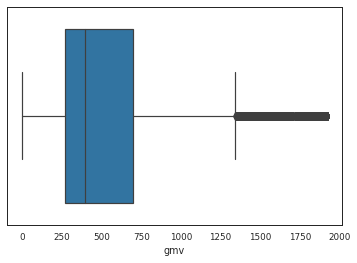

In [915]:
sns.boxplot(gaming['gmv'])

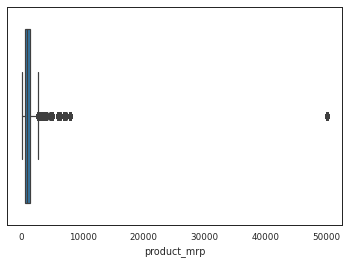

In [916]:
sns.boxplot(gaming['product_mrp'])

In [917]:
Q1 = gaming.product_mrp.quantile(0.25)
Q3 = gaming.product_mrp.quantile(0.75)
IQR = Q3 - Q1
gaming = gaming[(gaming.product_mrp >= Q1 - 1.5*IQR) & (gaming.product_mrp <= Q3 + 1.5*IQR)]

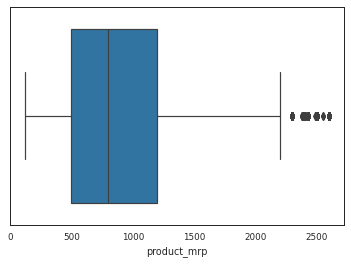

In [918]:
sns.boxplot(gaming['product_mrp'])

Checking for outliers

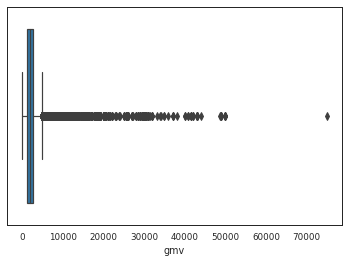

In [919]:
sns.boxplot(home_audio['gmv'])

In [920]:
Q1= home_audio.gmv.quantile(0.25)
Q3= home_audio.gmv.quantile(0.75)
IQR= Q3-Q1

home_audio=home_audio[(home_audio.gmv >= Q1 - 1.5*IQR)& (home_audio.gmv <= Q3 + 1.5*IQR)]  


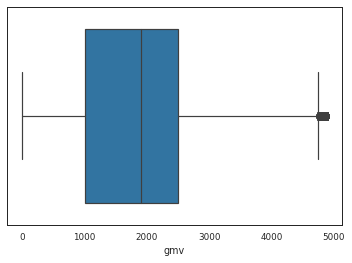

In [921]:
sns.boxplot(home_audio['gmv'])

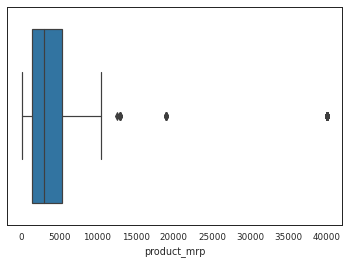

In [922]:
sns.boxplot(home_audio['product_mrp'])

In [923]:
Q1= home_audio.product_mrp.quantile(0.25)
Q3= home_audio.product_mrp.quantile(0.75)
IQR= Q3-Q1

home_audio = home_audio[(home_audio.product_mrp >= Q1-1.5*IQR)&(home_audio.product_mrp <= Q3 + 1.5*IQR)]

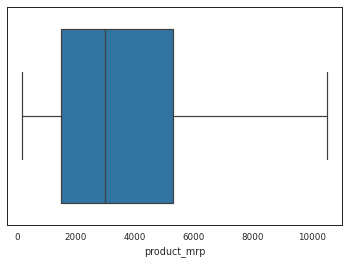

In [924]:
sns.boxplot(home_audio['product_mrp'])

## CAMERA ACCESS EDA

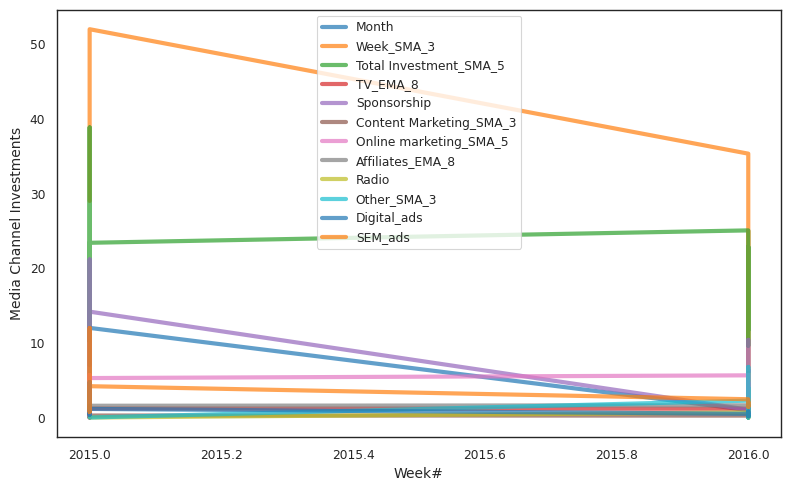

In [925]:
# Slightly alter the figure size to make it more horizontal.
plt.figure(figsize=(8, 5), dpi=100, facecolor='w', edgecolor='k', frameon='True')
sns.set_style("white") # white/whitegrid/dark/ticks
sns.set_context("paper") # talk/poster

# subplot 1
plt.subplot(1, 1, 1)
plt.plot(media.iloc[:,0], media.iloc[:,1::5], linewidth=3, alpha = 0.7)
plt.xlabel('Week#', fontsize=10)
plt.ylabel('Media Channel Investments', fontsize=10)
plt.legend(media.iloc[:,1::5])
# Automatically adjust subplot params so that the subplotS fits in to the figure area.
plt.tight_layout()

# display the plot
plt.show()

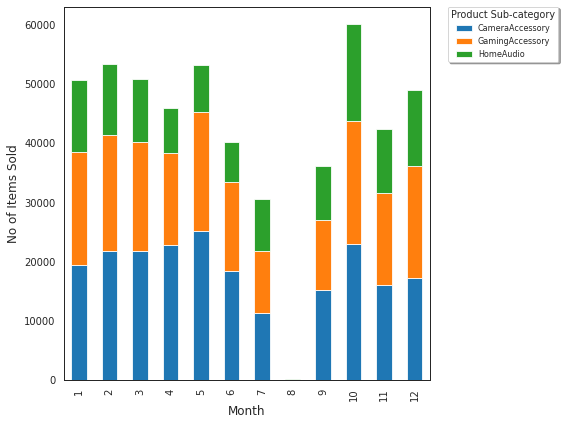

In [926]:
electronics.groupby(["Month", "product_analytic_sub_category"]).size().unstack().plot(kind='bar', \
                                                                                             stacked=True, figsize=(8,6), \
                                                                                           fontsize = 10) 
# plot x axis label
plt.xlabel('Month', fontsize = 12)
# plot y axis label
plt.ylabel('No of Items Sold', fontsize = 12)
# plot legend
plt.legend(frameon=True, fontsize='small', shadow='True', title='Product Sub-category', \
           bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


# Automatically adjust subplot params so that the subplotS fits in to the figure area.
plt.tight_layout()

# display the plot
plt.show()

#The above graph shows that the category HomeAudio sold the least items out of the three categories. CameraAccessory seems to have sold the most amount of items during the period 

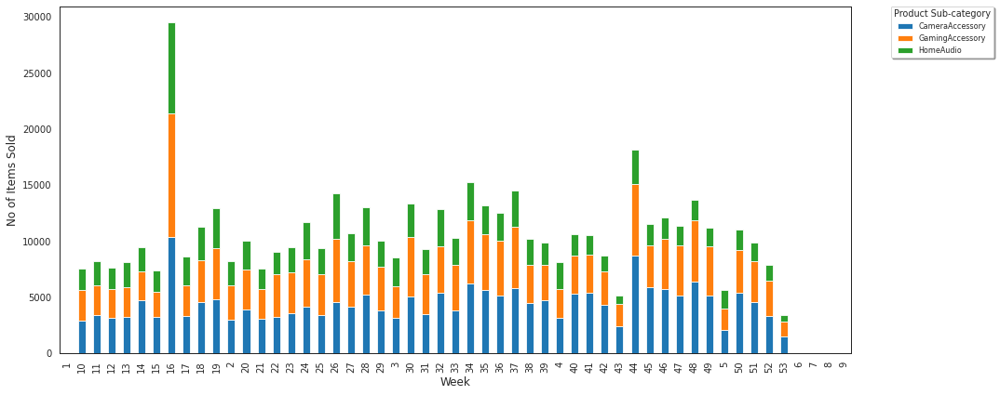

In [927]:
electronics.groupby(["Week", "product_analytic_sub_category"]).size().unstack().plot(kind='bar', \
                                                                                             stacked=True, figsize=(15,6), \
                                                                                           fontsize = 10) 
# plot x axis label
plt.xlabel('Week', fontsize = 12)
# plot y axis label
plt.ylabel('No of Items Sold', fontsize = 12)
# plot legend
plt.legend(frameon=True, fontsize='small', shadow='True', title='Product Sub-category', \
           bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

# Automatically adjust subplot params so that the subplotS fits in to the figure area.
plt.tight_layout()

# display the plot
plt.show()

In [928]:
camera_access.head()

,fsn_id,order_date,Year,Month,order_id,order_item_id,gmv,units,s1_fact.order_payment_type,sla,product_analytic_category,product_analytic_sub_category,product_analytic_vertical,product_mrp,product_procurement_sla,BoomBox,CameraAccessory,CameraBag,CameraBattery,CameraBatteryCharger,CameraBatteryGrip,CameraEyeCup,CameraFilmRolls,CameraHousing,CameraLEDLight,CameraMicrophone,CameraMount,CameraRemoteControl,CameraTripod,CoolingPad,DJController,Dock,DockingStation,ExtensionTube,FMRadio,Filter,Flash,FlashShoeAdapter,GameControlMount,GamePad,GamingAccessoryKit,GamingAdapter,GamingChargingStation,GamingGun,GamingHeadset,GamingKeyboard,GamingMemoryCard,GamingMouse,GamingMousePad,GamingSpeaker,HiFiSystem,HomeAudioSpeaker,JoystickGamingWheel,KaraokePlayer,Lens,MotionController,ReflectorUmbrella,SlingBox,Softbox,SoundMixer,Strap,TVOutCableAccessory,Teleconverter,Telescope,VoiceRecorder,paydate,list_price,discount%,Total_Order_Value,Week,premium_product
3,ACCCX3S5AHMF55FV,2015-10-14 12:05:15,2015,10,4416592101738400.000,4416592101738400.000,1690.000,1,1,4,CameraAccessory,CameraAccessory,CameraTripod,2099.000,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1690.000,0.190,2099.000,16,0
4,ACCCX3S5AHMF55FV,2015-10-17 21:25:03,2015,10,4419525153426400.000,4419525153426400.000,1618.000,1,1,6,CameraAccessory,CameraAccessory,CameraTripod,2099.000,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1618.000,0.230,2099.000,16,0
17,ACCD38YG3UDFDG6D,2015-10-06 00:45:01,2015,10,2409274855504000.000,2409274855504000.000,1495.000,1,0,5,CameraAccessory,CameraAccessory,CameraTripod,2750.000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1495.000,0.460,2750.000,15,0
18,ACCD38YG3UDFDG6D,2015-10-12 23:38:46,2015,10,4415284052002400.000,4415284052002400.000,1440.000,1,0,5,CameraAccessory,CameraAccessory,CameraTripod,2750.000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1440.000,0.480,2750.000,16,0
19,ACCD38YG3UDFDG6D,2015-10-14 10:09:46,2015,10,1416516698047300.000,1416516698047300.000,1440.000,1,0,4,CameraAccessory,CameraAccessory,CameraTripod,2750.000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1440.000,0.480,2750.000,16,0


In [929]:
camera_access.columns

Index(['fsn_id', 'order_date', 'Year', 'Month', 'order_id', 'order_item_id',
       'gmv', 'units', 's1_fact.order_payment_type', 'sla',
       'product_analytic_category', 'product_analytic_sub_category',
       'product_analytic_vertical', 'product_mrp', 'product_procurement_sla',
       'BoomBox', 'CameraAccessory', 'CameraBag', 'CameraBattery',
       'CameraBatteryCharger', 'CameraBatteryGrip', 'CameraEyeCup',
       'CameraFilmRolls', 'CameraHousing', 'CameraLEDLight',
       'CameraMicrophone', 'CameraMount', 'CameraRemoteControl',
       'CameraTripod', 'CoolingPad', 'DJController', 'Dock', 'DockingStation',
       'ExtensionTube', 'FMRadio', 'Filter', 'Flash', 'FlashShoeAdapter',
       'GameControlMount', 'GamePad', 'GamingAccessoryKit', 'GamingAdapter',
       'GamingChargingStation', 'GamingGun', 'GamingHeadset', 'GamingKeyboard',
       'GamingMemoryCard', 'GamingMouse', 'GamingMousePad', 'GamingSpeaker',
       'HiFiSystem', 'HomeAudioSpeaker', 'JoystickGamingWheel',
    

In [930]:
camera_access.head()

,fsn_id,order_date,Year,Month,order_id,order_item_id,gmv,units,s1_fact.order_payment_type,sla,product_analytic_category,product_analytic_sub_category,product_analytic_vertical,product_mrp,product_procurement_sla,BoomBox,CameraAccessory,CameraBag,CameraBattery,CameraBatteryCharger,CameraBatteryGrip,CameraEyeCup,CameraFilmRolls,CameraHousing,CameraLEDLight,CameraMicrophone,CameraMount,CameraRemoteControl,CameraTripod,CoolingPad,DJController,Dock,DockingStation,ExtensionTube,FMRadio,Filter,Flash,FlashShoeAdapter,GameControlMount,GamePad,GamingAccessoryKit,GamingAdapter,GamingChargingStation,GamingGun,GamingHeadset,GamingKeyboard,GamingMemoryCard,GamingMouse,GamingMousePad,GamingSpeaker,HiFiSystem,HomeAudioSpeaker,JoystickGamingWheel,KaraokePlayer,Lens,MotionController,ReflectorUmbrella,SlingBox,Softbox,SoundMixer,Strap,TVOutCableAccessory,Teleconverter,Telescope,VoiceRecorder,paydate,list_price,discount%,Total_Order_Value,Week,premium_product
3,ACCCX3S5AHMF55FV,2015-10-14 12:05:15,2015,10,4416592101738400.000,4416592101738400.000,1690.000,1,1,4,CameraAccessory,CameraAccessory,CameraTripod,2099.000,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1690.000,0.190,2099.000,16,0
4,ACCCX3S5AHMF55FV,2015-10-17 21:25:03,2015,10,4419525153426400.000,4419525153426400.000,1618.000,1,1,6,CameraAccessory,CameraAccessory,CameraTripod,2099.000,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1618.000,0.230,2099.000,16,0
17,ACCD38YG3UDFDG6D,2015-10-06 00:45:01,2015,10,2409274855504000.000,2409274855504000.000,1495.000,1,0,5,CameraAccessory,CameraAccessory,CameraTripod,2750.000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1495.000,0.460,2750.000,15,0
18,ACCD38YG3UDFDG6D,2015-10-12 23:38:46,2015,10,4415284052002400.000,4415284052002400.000,1440.000,1,0,5,CameraAccessory,CameraAccessory,CameraTripod,2750.000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1440.000,0.480,2750.000,16,0
19,ACCD38YG3UDFDG6D,2015-10-14 10:09:46,2015,10,1416516698047300.000,1416516698047300.000,1440.000,1,0,4,CameraAccessory,CameraAccessory,CameraTripod,2750.000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1440.000,0.480,2750.000,16,0


In [931]:
camera_week=pd.DataFrame(camera_access.groupby('Week').agg({'gmv':'sum','list_price':'mean',
                                                             'product_mrp':'mean','discount%':'mean',
                                                             'sla':'mean','product_procurement_sla':'mean',
                                                             'fsn_id':pd.Series.nunique,'order_item_id':pd.Series.nunique,
                                                             'order_id': pd.Series.nunique,
                                                             's1_fact.order_payment_type':'sum',
                                                            'premium_product':'sum','CameraTripod':'sum' ,'Lens':'sum', 'CameraBag':'sum', 'Flash':'sum', 'CameraBattery':'sum',
 'CameraBatteryCharger':'sum', 'CameraRemoteControl':'sum',  'Filter':'sum',
 'Strap':'sum', 'CameraBatteryGrip':'sum', 'CameraAccessory':'sum', 'CameraFilmRolls':'sum',
 'CameraMount':'sum', 'ExtensionTube':'sum', 'Telescope':'sum', 'CameraEyeCup':'sum', 'CameraLEDLight':'sum',
 'CameraMicrophone':'sum', 'Softbox':'sum', 'CameraHousing':'sum', 'FlashShoeAdapter':'sum',
 'ReflectorUmbrella':'sum', 'Teleconverter':'sum'})) 
camera_week.reset_index(inplace=True)


In [932]:
camera_week.dtypes

Week                           object
gmv                           float64
list_price                    float64
product_mrp                   float64
discount%                     float64
sla                           float64
product_procurement_sla       float64
fsn_id                          int64
order_item_id                 float64
order_id                      float64
s1_fact.order_payment_type      int64
premium_product                 int64
CameraTripod                  float64
Lens                          float64
CameraBag                     float64
Flash                         float64
CameraBattery                 float64
CameraBatteryCharger          float64
CameraRemoteControl           float64
Filter                        float64
Strap                           uint8
CameraBatteryGrip               uint8
CameraAccessory                 uint8
CameraFilmRolls                 uint8
CameraMount                     uint8
ExtensionTube                   uint8
Telescope   

In [933]:
camera_week['Week'] = camera_week['Week'].astype('str')
calendor['Week'] = calendor['Week'].astype('str')

In [934]:
#camera_access['Week'] = camera_access['Week'].astype(int)
#calendor['Week'] = calendor['Week'].astype(int)

In [935]:
camera_week.dtypes

Week                           object
gmv                           float64
list_price                    float64
product_mrp                   float64
discount%                     float64
sla                           float64
product_procurement_sla       float64
fsn_id                          int64
order_item_id                 float64
order_id                      float64
s1_fact.order_payment_type      int64
premium_product                 int64
CameraTripod                  float64
Lens                          float64
CameraBag                     float64
Flash                         float64
CameraBattery                 float64
CameraBatteryCharger          float64
CameraRemoteControl           float64
Filter                        float64
Strap                           uint8
CameraBatteryGrip               uint8
CameraAccessory                 uint8
CameraFilmRolls                 uint8
CameraMount                     uint8
ExtensionTube                   uint8
Telescope   

In [936]:
media.dtypes

Year                               object
Month                              object
Month_SMA_3                       float64
Month_SMA_5                       float64
Month_EMA_8                       float64
Week                               object
Week_SMA_3                        float64
Week_SMA_5                        float64
Week_EMA_8                        float64
Total Investment                   object
Total Investment_SMA_3            float64
Total Investment_SMA_5            float64
Total Investment_EMA_8            float64
TV                                 object
TV_SMA_3                          float64
TV_SMA_5                          float64
TV_EMA_8                          float64
Digital                            object
Digital_SMA_3                     float64
Digital_SMA_5                     float64
Digital_EMA_8                     float64
Sponsorship                        object
Sponsorship_SMA_3                 float64
Sponsorship_SMA_5                 

In [937]:
camera_week = camera_week.merge(media, how = 'left', on = 'Week')

In [938]:
camera_week = camera_week.merge(calendor, how = 'left', on = 'Week')

In [939]:
camera_week.head()

,Week,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,order_item_id,order_id,s1_fact.order_payment_type,premium_product,CameraTripod,Lens,CameraBag,Flash,CameraBattery,CameraBatteryCharger,CameraRemoteControl,Filter,Strap,CameraBatteryGrip,CameraAccessory,CameraFilmRolls,CameraMount,ExtensionTube,Telescope,CameraEyeCup,CameraLEDLight,CameraMicrophone,Softbox,CameraHousing,FlashShoeAdapter,ReflectorUmbrella,Teleconverter,Year,Month,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV,TV_SMA_3,TV_SMA_5,...,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other,Other_SMA_3,Other_SMA_5,Other_EMA_8,Date,TV_ads,Digital_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,Affiliates_ads,SEM_ads,Radio_ads,Other_ads,NPS,Stock_Index,Sale_days,Payday,max_temp_C,min_temp_C,mean_temp_C,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,total_precip_mm,snow_on_grnd_cm
0,1,11151.000,428.885,1121.038,0.491,2.423,2.731,20,26.000,26.000,26,0,13.000,2.000,1.000,0.000,5.000,2.000,1.000,0.000,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,2016.000,1.000,8.333,9.800,9.146,35.333,41.400,38.727,18.549,23.974,25.059,22.026,1.095,1.264,1.298,...,9.801,11.551,9.191,0.225,0.253,0.259,0.236,5.725,5.659,5.646,5.234,1.842,1.752,1.734,1.633,1.050,2.213,2.446,2.271,0.675,0.225,0.135,0.150,6.773,2.258,1.355,1.505,2016-01-01,1.769,0.497,8.138,0.359,8.538,2.696,2.447,0.675,6.773,54.600,1177.000,0.000,0.200,25.500,13.200,19.360,0.100,1.460,0.000,0.000,0.000,0.000
1,10,1310468.000,523.287,1143.769,0.455,6.605,2.679,522,2028.000,2442.000,679,0,525.000,310.000,207.000,148.000,665.000,147.000,117.000,134.000,12,0,35,10,12,0,16,0,0,0,0,0,0,0,0,2016.000,3.000,2.333,2.200,2.849,9.000,8.000,10.794,25.006,14.742,12.689,15.372,2.325,1.120,0.879,...,5.029,3.955,4.696,0.093,0.110,0.114,0.138,4.609,4.188,4.104,4.454,1.554,1.380,1.345,1.451,1.298,1.083,1.040,1.191,0.218,0.073,0.044,0.143,3.986,1.329,0.797,1.836,2016-03-01,2.584,0.717,11.569,0.152,6.598,2.200,1.786,0.218,3.986,48.791,1116.000,0.000,0.143,28.811,15.842,21.540,1.632,5.172,9.026,0.029,9.055,0.041
2,11,1554864.000,541.519,1234.061,0.469,6.507,2.775,563,2151.000,2825.000,790,0,730.000,313.000,228.000,165.000,632.000,193.000,149.000,187.000,18,0,42,3,5,0,12,0,0,0,0,0,0,0,0,2016.000,3.000,2.667,2.400,2.883,10.000,9.000,10.840,25.006,19.874,15.768,17.513,2.325,1.722,1.240,...,7.713,5.566,5.963,0.093,0.102,0.109,0.128,4.609,4.399,4.230,4.488,1.554,1.467,1.397,1.474,1.298,1.190,1.104,1.214,0.218,0.145,0.087,0.160,3.986,2.657,1.594,2.314,2016-03-01,3.488,0.788,15.596,0.140,6.913,2.331,1.947,0.327,5.979,46.925,1101.000,0.000,0.000,22.265,13.128,17.812,2.546,2.358,1.424,0.058,1.482,0.082
3,12,1412868.000,538.608,1210.890,0.466,6.791,2.707,559,2564.000,2578.000,682,0,586.000,362.000,217.000,210.000,505.000,151.000,136.000,171.000,14,0,44,15,10,1,19,0,0,0,0,0,0,0,0,2016.000,3.000,3.000,2.600,2.909,11.000,10.000,11.098,25.006,25.006,18.848,19.178,2.325,2.325,1.602,...,10.397,7.176,6.948,0.093,0.093,0.103,0.120,4.609,4.609,4.357,4.515,1.554,1.554,1.450,1.492,1.298,1.298,1.169,1.233,0.218,0.218,0.131,0.173,3.986,3.986,2.392,2.686,2016-03-01,3.488,0.788,15.596,0.140,6.913,2.331,1.947,0.327,5.979,46.925,1101.000,0.000,0.143,20.770,10.855,16.044,4.080,2.124,1.422,0.088,1.509,0.124
4,13,1416383.000,519.797,1411.577,0.509,6.319,2.916,536,2677.000,2677.000,685,0,822.000,317.000,192.000,114.000,504.000,170.000,128.000,162.000,20,0,46,21,10,0,17,0,0,0,0,0,0,0,0,2016.000,3.000,3.000,2.800,2.929,12.000,11.000,11.520,25.006,25.006,21.927,20.473,2.325,2.325,1.963,...,10.397,8.787,7.714,0.093,0.093,0.098

In [940]:
camera_week['online_order_percentage'] = camera_week['s1_fact.order_payment_type']*100/camera_week['order_item_id']

In [941]:
camera_week.head()

,Week,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,order_item_id,order_id,s1_fact.order_payment_type,premium_product,CameraTripod,Lens,CameraBag,Flash,CameraBattery,CameraBatteryCharger,CameraRemoteControl,Filter,Strap,CameraBatteryGrip,CameraAccessory,CameraFilmRolls,CameraMount,ExtensionTube,Telescope,CameraEyeCup,CameraLEDLight,CameraMicrophone,Softbox,CameraHousing,FlashShoeAdapter,ReflectorUmbrella,Teleconverter,Year,Month,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV,TV_SMA_3,TV_SMA_5,...,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other,Other_SMA_3,Other_SMA_5,Other_EMA_8,Date,TV_ads,Digital_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,Affiliates_ads,SEM_ads,Radio_ads,Other_ads,NPS,Stock_Index,Sale_days,Payday,max_temp_C,min_temp_C,mean_temp_C,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,total_precip_mm,snow_on_grnd_cm,online_order_percentage
0,1,11151.000,428.885,1121.038,0.491,2.423,2.731,20,26.000,26.000,26,0,13.000,2.000,1.000,0.000,5.000,2.000,1.000,0.000,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,2016.000,1.000,8.333,9.800,9.146,35.333,41.400,38.727,18.549,23.974,25.059,22.026,1.095,1.264,1.298,...,11.551,9.191,0.225,0.253,0.259,0.236,5.725,5.659,5.646,5.234,1.842,1.752,1.734,1.633,1.050,2.213,2.446,2.271,0.675,0.225,0.135,0.150,6.773,2.258,1.355,1.505,2016-01-01,1.769,0.497,8.138,0.359,8.538,2.696,2.447,0.675,6.773,54.600,1177.000,0.000,0.200,25.500,13.200,19.360,0.100,1.460,0.000,0.000,0.000,0.000,100.000
1,10,1310468.000,523.287,1143.769,0.455,6.605,2.679,522,2028.000,2442.000,679,0,525.000,310.000,207.000,148.000,665.000,147.000,117.000,134.000,12,0,35,10,12,0,16,0,0,0,0,0,0,0,0,2016.000,3.000,2.333,2.200,2.849,9.000,8.000,10.794,25.006,14.742,12.689,15.372,2.325,1.120,0.879,...,3.955,4.696,0.093,0.110,0.114,0.138,4.609,4.188,4.104,4.454,1.554,1.380,1.345,1.451,1.298,1.083,1.040,1.191,0.218,0.073,0.044,0.143,3.986,1.329,0.797,1.836,2016-03-01,2.584,0.717,11.569,0.152,6.598,2.200,1.786,0.218,3.986,48.791,1116.000,0.000,0.143,28.811,15.842,21.540,1.632,5.172,9.026,0.029,9.055,0.041,33.481
2,11,1554864.000,541.519,1234.061,0.469,6.507,2.775,563,2151.000,2825.000,790,0,730.000,313.000,228.000,165.000,632.000,193.000,149.000,187.000,18,0,42,3,5,0,12,0,0,0,0,0,0,0,0,2016.000,3.000,2.667,2.400,2.883,10.000,9.000,10.840,25.006,19.874,15.768,17.513,2.325,1.722,1.240,...,5.566,5.963,0.093,0.102,0.109,0.128,4.609,4.399,4.230,4.488,1.554,1.467,1.397,1.474,1.298,1.190,1.104,1.214,0.218,0.145,0.087,0.160,3.986,2.657,1.594,2.314,2016-03-01,3.488,0.788,15.596,0.140,6.913,2.331,1.947,0.327,5.979,46.925,1101.000,0.000,0.000,22.265,13.128,17.812,2.546,2.358,1.424,0.058,1.482,0.082,36.727
3,12,1412868.000,538.608,1210.890,0.466,6.791,2.707,559,2564.000,2578.000,682,0,586.000,362.000,217.000,210.000,505.000,151.000,136.000,171.000,14,0,44,15,10,1,19,0,0,0,0,0,0,0,0,2016.000,3.000,3.000,2.600,2.909,11.000,10.000,11.098,25.006,25.006,18.848,19.178,2.325,2.325,1.602,...,7.176,6.948,0.093,0.093,0.103,0.120,4.609,4.609,4.357,4.515,1.554,1.554,1.450,1.492,1.298,1.298,1.169,1.233,0.218,0.218,0.131,0.173,3.986,3.986,2.392,2.686,2016-03-01,3.488,0.788,15.596,0.140,6.913,2.331,1.947,0.327,5.979,46.925,1101.000,0.000,0.143,20.770,10.855,16.044,4.080,2.124,1.422,0.088,1.509,0.124,26.599
4,13,1416383.000,519.797,1411.577,0.509,6.319,2.916,536,2677.000,2677.000,685,0,822.000,317.000,192.000,114.000,504.000,170.000,128.000,162.000,20,0,46,21,10,0,17,0,0,0,0,0,0,0,0,2016.000,3.000,3.000,2.800,2.929,12.000,11.000,11.520,25.006,25.006,21.927,20.473,2.325,2.325,1.963,...,8.787,7.714,0.093,0.093,0.

In [942]:
#camera_access=camera_access.round(2)

Univariate Analysis

In [943]:
camera_week.columns

Index(['Week', 'gmv', 'list_price', 'product_mrp', 'discount%', 'sla',
       'product_procurement_sla', 'fsn_id', 'order_item_id', 'order_id',
       ...
       'max_temp_C', 'min_temp_C', 'mean_temp_C', 'heat_deg_days',
       'cool_deg_days', 'total_rain_mm', 'total_snow_cm', 'total_precip_mm',
       'snow_on_grnd_cm', 'online_order_percentage'],
      dtype='object', length=107)

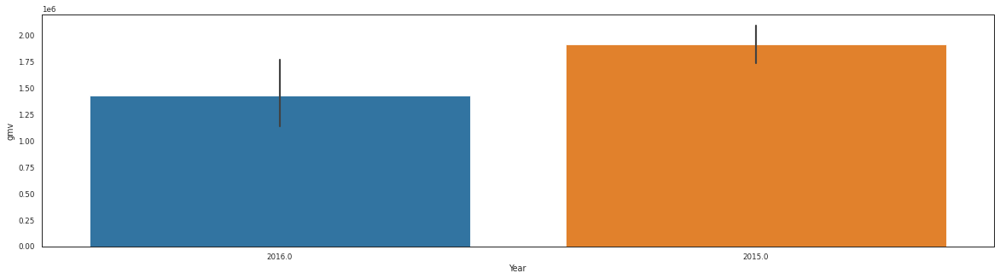

In [944]:
plt.figure(figsize=(20, 5))
sns.barplot(camera_week['Year'],camera_week['gmv'])

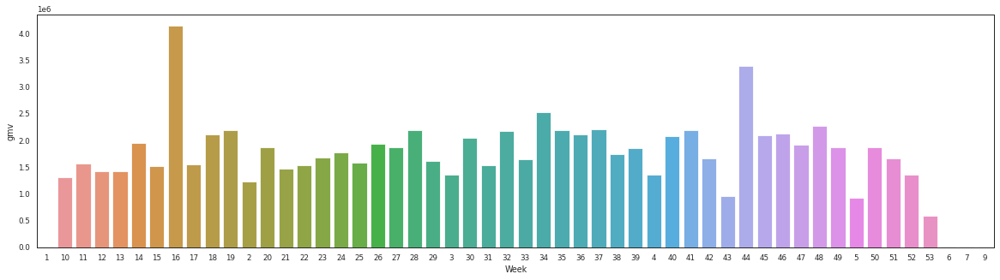

In [945]:
plt.figure(figsize=(20, 5))
sns.barplot(camera_week['Week'],camera_week['gmv'])

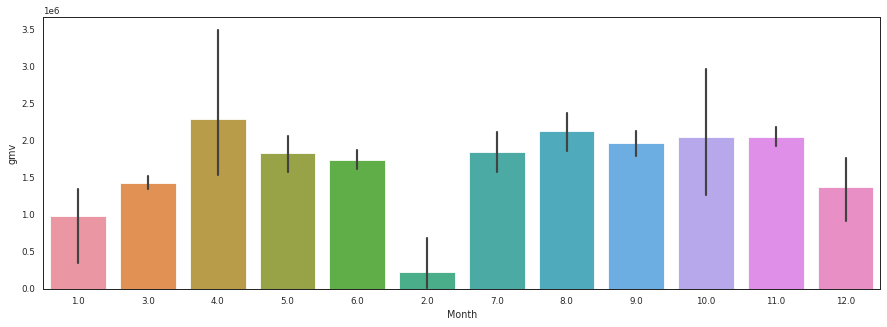

In [946]:
plt.figure(figsize=(15, 5))
sns.barplot(camera_week['Month'],camera_week['gmv'])

Checking impact of ads on gmv 

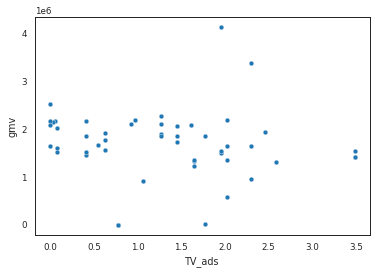

In [947]:
sns.scatterplot('TV_ads','gmv',data=camera_week)

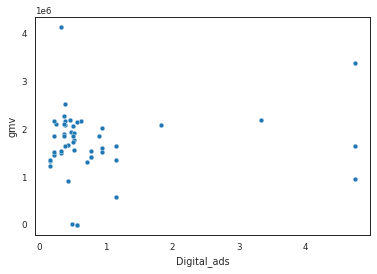

In [948]:
sns.scatterplot('Digital_ads','gmv',data=camera_week)

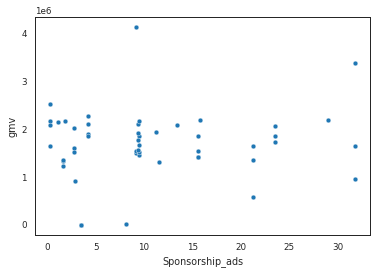

In [949]:
sns.scatterplot('Sponsorship_ads','gmv',data=camera_week)

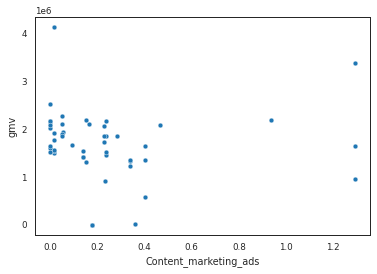

In [950]:
sns.scatterplot('Content_marketing_ads','gmv',data=camera_week)

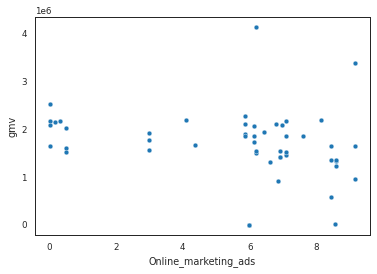

In [951]:
sns.scatterplot('Online_marketing_ads','gmv',data=camera_week)

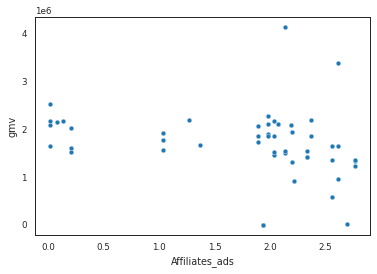

In [952]:
sns.scatterplot('Affiliates_ads','gmv',data=camera_week)

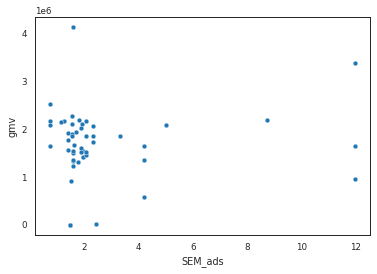

In [953]:
sns.scatterplot('SEM_ads','gmv',data=camera_week)

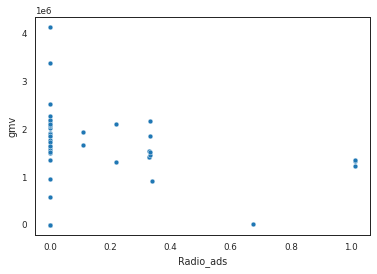

In [954]:
sns.scatterplot('Radio_ads','gmv',data=camera_week)

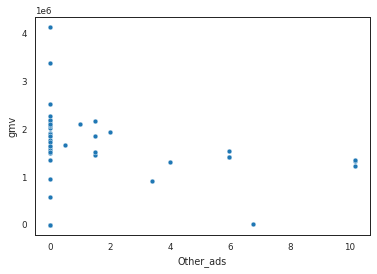

In [955]:
sns.scatterplot('Other_ads','gmv',data=camera_week)

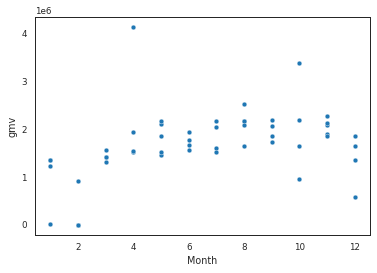

In [956]:
sns.scatterplot('Month','gmv',data=camera_week)

In [957]:
#Moving Average

camera_week[['MA2_LP','MA2_Discount']] = camera_week[['list_price','discount%']].rolling(window=2,min_periods=1).mean()
camera_week[['MA3_LP','MA3_Discount']] = camera_week[['list_price','discount%']].rolling(window=3,min_periods=1).mean()
camera_week[['MA4_LP','MA4_Discount']] = camera_week[['list_price','discount%']].rolling(window=4,min_periods=1).mean()

### Reference listed price Inflation 

camera_week['MA2_listed_price'] = (camera_week['list_price']-camera_week['MA2_LP'])/camera_week['MA2_LP']
camera_week['MA3_listed_price'] = (camera_week['list_price']-camera_week['MA3_LP'])/camera_week['MA3_LP']
camera_week['MA4_listed_price'] = (camera_week['list_price']-camera_week['MA4_LP'])/camera_week['MA4_LP']

### Reference discount Inflation

camera_week['MA2_discount_offer'] = (camera_week['discount%']-camera_week['MA2_Discount'])/camera_week['MA2_Discount']
camera_week['MA3_discount_offer'] = (camera_week['discount%']-camera_week['MA3_Discount'])/camera_week['MA3_Discount']
camera_week['MA4_discount_offer'] = (camera_week['discount%']-camera_week['MA4_Discount'])/camera_week['MA4_Discount']


camera_week.drop(['MA2_LP','MA3_LP','MA4_LP','MA2_Discount','MA3_Discount','MA4_Discount'], axis = 1, inplace = True)  
camera_week.head()



,Week,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,order_item_id,order_id,s1_fact.order_payment_type,premium_product,CameraTripod,Lens,CameraBag,Flash,CameraBattery,CameraBatteryCharger,CameraRemoteControl,Filter,Strap,CameraBatteryGrip,CameraAccessory,CameraFilmRolls,CameraMount,ExtensionTube,Telescope,CameraEyeCup,CameraLEDLight,CameraMicrophone,Softbox,CameraHousing,FlashShoeAdapter,ReflectorUmbrella,Teleconverter,Year,Month,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV,TV_SMA_3,TV_SMA_5,...,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other,Other_SMA_3,Other_SMA_5,Other_EMA_8,Date,TV_ads,Digital_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,Affiliates_ads,SEM_ads,Radio_ads,Other_ads,NPS,Stock_Index,Sale_days,Payday,max_temp_C,min_temp_C,mean_temp_C,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,total_precip_mm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount_offer,MA3_discount_offer,MA4_discount_offer
0,1,11151.000,428.885,1121.038,0.491,2.423,2.731,20,26.000,26.000,26,0,13.000,2.000,1.000,0.000,5.000,2.000,1.000,0.000,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,2016.000,1.000,8.333,9.800,9.146,35.333,41.400,38.727,18.549,23.974,25.059,22.026,1.095,1.264,1.298,...,5.725,5.659,5.646,5.234,1.842,1.752,1.734,1.633,1.050,2.213,2.446,2.271,0.675,0.225,0.135,0.150,6.773,2.258,1.355,1.505,2016-01-01,1.769,0.497,8.138,0.359,8.538,2.696,2.447,0.675,6.773,54.600,1177.000,0.000,0.200,25.500,13.200,19.360,0.100,1.460,0.000,0.000,0.000,0.000,100.000,0.000,0.000,0.000,0.000,0.000,0.000
1,10,1310468.000,523.287,1143.769,0.455,6.605,2.679,522,2028.000,2442.000,679,0,525.000,310.000,207.000,148.000,665.000,147.000,117.000,134.000,12,0,35,10,12,0,16,0,0,0,0,0,0,0,0,2016.000,3.000,2.333,2.200,2.849,9.000,8.000,10.794,25.006,14.742,12.689,15.372,2.325,1.120,0.879,...,4.609,4.188,4.104,4.454,1.554,1.380,1.345,1.451,1.298,1.083,1.040,1.191,0.218,0.073,0.044,0.143,3.986,1.329,0.797,1.836,2016-03-01,2.584,0.717,11.569,0.152,6.598,2.200,1.786,0.218,3.986,48.791,1116.000,0.000,0.143,28.811,15.842,21.540,1.632,5.172,9.026,0.029,9.055,0.041,33.481,0.099,0.099,0.099,-0.038,-0.038,-0.038
2,11,1554864.000,541.519,1234.061,0.469,6.507,2.775,563,2151.000,2825.000,790,0,730.000,313.000,228.000,165.000,632.000,193.000,149.000,187.000,18,0,42,3,5,0,12,0,0,0,0,0,0,0,0,2016.000,3.000,2.667,2.400,2.883,10.000,9.000,10.840,25.006,19.874,15.768,17.513,2.325,1.722,1.240,...,4.609,4.399,4.230,4.488,1.554,1.467,1.397,1.474,1.298,1.190,1.104,1.214,0.218,0.145,0.087,0.160,3.986,2.657,1.594,2.314,2016-03-01,3.488,0.788,15.596,0.140,6.913,2.331,1.947,0.327,5.979,46.925,1101.000,0.000,0.000,22.265,13.128,17.812,2.546,2.358,1.424,0.058,1.482,0.082,36.727,0.017,0.088,0.088,0.015,-0.005,-0.005
3,12,1412868.000,538.608,1210.890,0.466,6.791,2.707,559,2564.000,2578.000,682,0,586.000,362.000,217.000,210.000,505.000,151.000,136.000,171.000,14,0,44,15,10,1,19,0,0,0,0,0,0,0,0,2016.000,3.000,3.000,2.600,2.909,11.000,10.000,11.098,25.006,25.006,18.848,19.178,2.325,2.325,1.602,...,4.609,4.609,4.357,4.515,1.554,1.554,1.450,1.492,1.298,1.298,1.169,1.233,0.218,0.218,0.131,0.173,3.986,3.986,2.392,2.686,2016-03-01,3.488,0.788,15.596,0.140,6.913,2.331,1.947,0.327,5.979,46.925,1101.000,0.000,0.143,20.770,10.855,16.044,4.080,2.124,1.422,0.088,1.509,0.124,26.599,-0.003,0.008,0.060,-0.004,0.005,-0.010
4,13,1416383.000,519.797,1411.577,0.509,6.319,2.916,536,2677.000,2677.000,685,0,822.000,317.000,192.000,114.000,504.000,170.000,128.000,162.000,20,0,46,21,10,0,17,0,0,0,0,0,0,0,0,2016.000,3.000,3.000,2.800,2.929,12.000,11.000,11.520,25.006,25.006,21.927,20.473,2.325,2.325,1.963,...,4.609,4.609,4.483,4.536,1.554,1.554,1

## GAMING EDA

In [958]:
gaming.columns

Index(['fsn_id', 'order_date', 'Year', 'Month', 'order_id', 'order_item_id',
       'gmv', 'units', 's1_fact.order_payment_type', 'sla',
       'product_analytic_category', 'product_analytic_sub_category',
       'product_analytic_vertical', 'product_mrp', 'product_procurement_sla',
       'BoomBox', 'CameraAccessory', 'CameraBag', 'CameraBattery',
       'CameraBatteryCharger', 'CameraBatteryGrip', 'CameraEyeCup',
       'CameraFilmRolls', 'CameraHousing', 'CameraLEDLight',
       'CameraMicrophone', 'CameraMount', 'CameraRemoteControl',
       'CameraTripod', 'CoolingPad', 'DJController', 'Dock', 'DockingStation',
       'ExtensionTube', 'FMRadio', 'Filter', 'Flash', 'FlashShoeAdapter',
       'GameControlMount', 'GamePad', 'GamingAccessoryKit', 'GamingAdapter',
       'GamingChargingStation', 'GamingGun', 'GamingHeadset', 'GamingKeyboard',
       'GamingMemoryCard', 'GamingMouse', 'GamingMousePad', 'GamingSpeaker',
       'HiFiSystem', 'HomeAudioSpeaker', 'JoystickGamingWheel',
    

In [959]:
gaming_week = pd.DataFrame(gaming.groupby('Week').agg({'gmv':'sum','list_price':'mean',
                                                             'product_mrp':'mean','discount%':'mean',
                                                             'sla':'mean','product_procurement_sla':'mean',
                                                             'fsn_id':pd.Series.nunique,'order_item_id':pd.Series.nunique,
                                                             'order_id': pd.Series.nunique,
                                                             's1_fact.order_payment_type':'sum',
                                                       'GamePad':'sum', 'GamingAccessoryKit':'sum', 'GamingHeadset':'sum', 'GamingMemoryCard':'sum',
 'MotionController':'sum', 'GamingMouse':'sum', 'GamingAdapter':'sum', 'TVOutCableAccessory':'sum',
 'GamingGun':'sum', 'JoystickGamingWheel':'sum', 'GamingMousePad':'sum', 'GamingKeyboard':'sum',
 'GamingSpeaker':'sum', 'CoolingPad':'sum', 'GamingChargingStation':'sum', 'GameControlMount':'sum',}))

gaming_week.reset_index( inplace = True)

In [960]:
gaming_week.head()

,Week,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,order_item_id,order_id,s1_fact.order_payment_type,GamePad,GamingAccessoryKit,GamingHeadset,GamingMemoryCard,MotionController,GamingMouse,GamingAdapter,TVOutCableAccessory,GamingGun,JoystickGamingWheel,GamingMousePad,GamingKeyboard,GamingSpeaker,CoolingPad,GamingChargingStation,GameControlMount
0,1,17466.000,681.080,898.440,0.220,2.960,2.560,19,25.000,25.000,25,15.000,4.000,1.000,0.000,0,4.000,0,0,0,0,0.000,1.000,0,0,0,0
1,10,1083391.500,463.833,746.250,0.380,5.081,2.506,306,1977.000,2269.000,442,1188.000,89.000,307.000,12.000,3,362.000,31,126,0,20,92.000,53.000,0,0,0,0
2,11,1118085.000,519.637,833.842,0.371,5.517,2.437,314,1723.000,2105.000,413,821.000,114.000,304.000,127.000,1,351.000,22,210,0,25,88.000,42.000,0,0,0,0
3,12,1080541.251,514.867,846.017,0.381,5.861,2.474,310,2038.000,2050.000,426,730.000,114.000,312.000,96.000,5,332.000,37,242,0,27,115.000,41.000,0,0,0,0
4,13,1168008.000,524.315,935.469,0.400,6.014,2.327,309,2168.000,2166.000,401,747.000,150.000,541.000,55.000,4,323.000,32,158,0,24,91.000,43.000,0,0,0,0


In [961]:
gaming_week = gaming_week.merge(media, how = 'left', on = 'Week')

In [962]:
gaming_week = gaming_week.merge(calendor, how = 'left', on = 'Week')

In [963]:
gaming_week.head()

,Week,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,order_item_id,order_id,s1_fact.order_payment_type,GamePad,GamingAccessoryKit,GamingHeadset,GamingMemoryCard,MotionController,GamingMouse,GamingAdapter,TVOutCableAccessory,GamingGun,JoystickGamingWheel,GamingMousePad,GamingKeyboard,GamingSpeaker,CoolingPad,GamingChargingStation,GameControlMount,Year,Month,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other,Other_SMA_3,Other_SMA_5,Other_EMA_8,Date,TV_ads,Digital_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,Affiliates_ads,SEM_ads,Radio_ads,Other_ads,NPS,Stock_Index,Sale_days,Payday,max_temp_C,min_temp_C,mean_temp_C,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,total_precip_mm,snow_on_grnd_cm
0,1,17466.000,681.080,898.440,0.220,2.960,2.560,19,25.000,25.000,25,15.000,4.000,1.000,0.000,0,4.000,0,0,0,0,0.000,1.000,0,0,0,0,2016.000,1.000,8.333,9.800,9.146,35.333,41.400,38.727,18.549,23.974,25.059,22.026,1.095,1.264,1.298,1.178,0.114,0.549,0.636,0.627,1.050,9.801,11.551,9.191,0.225,0.253,0.259,0.236,5.725,5.659,5.646,5.234,1.842,1.752,1.734,1.633,1.050,2.213,2.446,2.271,0.675,0.225,0.135,0.150,6.773,2.258,1.355,1.505,2016-01-01,1.769,0.497,8.138,0.359,8.538,2.696,2.447,0.675,6.773,54.600,1177.000,0.000,0.200,25.500,13.200,19.360,0.100,1.460,0.000,0.000,0.000,0.000
1,10,1083391.500,463.833,746.250,0.380,5.081,2.506,306,1977.000,2269.000,442,1188.000,89.000,307.000,12.000,3,362.000,31,126,0,20,92.000,53.000,0,0,0,0,2016.000,3.000,2.333,2.200,2.849,9.000,8.000,10.794,25.006,14.742,12.689,15.372,2.325,1.120,0.879,1.055,0.525,0.430,0.411,0.408,10.397,5.029,3.955,4.696,0.093,0.110,0.114,0.138,4.609,4.188,4.104,4.454,1.554,1.380,1.345,1.451,1.298,1.083,1.040,1.191,0.218,0.073,0.044,0.143,3.986,1.329,0.797,1.836,2016-03-01,2.584,0.717,11.569,0.152,6.598,2.200,1.786,0.218,3.986,48.791,1116.000,0.000,0.143,28.811,15.842,21.540,1.632,5.172,9.026,0.029,9.055,0.041
2,11,1118085.000,519.637,833.842,0.371,5.517,2.437,314,1723.000,2105.000,413,821.000,114.000,304.000,127.000,1,351.000,22,210,0,25,88.000,42.000,0,0,0,0,2016.000,3.000,2.667,2.400,2.883,10.000,9.000,10.840,25.006,19.874,15.768,17.513,2.325,1.722,1.240,1.337,0.525,0.478,0.440,0.434,10.397,7.713,5.566,5.963,0.093,0.102,0.109,0.128,4.609,4.399,4.230,4.488,1.554,1.467,1.397,1.474,1.298,1.190,1.104,1.214,0.218,0.145,0.087,0.160,3.986,2.657,1.594,2.314,2016-03-01,3.488,0.788,15.596,0.140,6.913,2.331,1.947,0.327,5.979,46.925,1101.000,0.000,0.000,22.265,13.128,17.812,2.546,2.358,1.424,0.058,1.482,0.082
3,12,1080541.251,514.867,846.017,0.381,5.861,2.474,310,2038.000,2050.000,426,730.000,114.000,312.000,96.000,5,332.000,37,242,0,27,115.000,41.000,0,0,0,0,2016.000,3.000,3.000,2.600,2.909,11.000,10.000,11.098,25.006,25.006,18.848,19.178,2.325,2.325,1.602,1.557,0.525,0.525,0.468,0.455,10.397,10.397,7.176,6.948,0.093,0.093,0.103,0.120,4.609,4.609,4.357,4.515,1.554,1.554,1.450,1.492,1.298,1.298,1.169,1.233,0.218,0.218,0.131,0.173,3.986,3.986,2.392,2.686,2016-03-01,3.488,0.788,15.596,0.140,6.913,2.331,1.947,0.327,5.979,46.925,1101.000,0.000,0.143,20.770,10.855,16.044,4.080,2.124,1.422,0.088,1.509,0.124
4,13,1168008.000,524.315,935.469,0.400,6.014,2.327,309,2168.000,2166.000,401,747.000,150.000,541.000,55.000,4,323.000,32,158,0,24,91.000,43.000,0,0,0,0,2016.000,3.000,3.000,2.800,2.929,12.000,11.000,11.520,25.006,25.006,21.927,20.473,2.325,2.325,1.963,1.728,0.525,0.525,0.497,0.470,10.397,10.39

In [964]:
gaming_week['online_order_percentage'] = gaming_week['s1_fact.order_payment_type']*100/gaming_week['order_item_id']

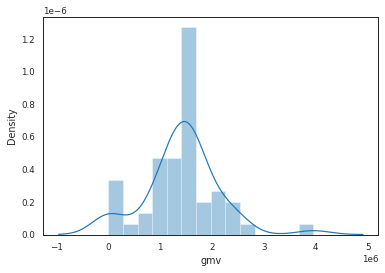

In [965]:
sns.distplot(gaming_week['gmv'],kde=True)

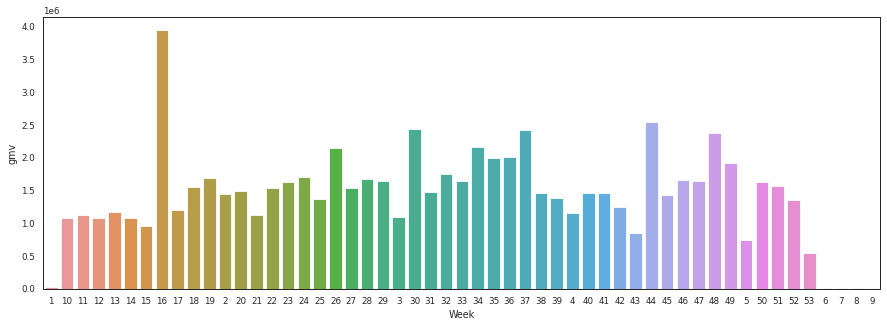

In [966]:
plt.figure(figsize=(15, 5))
sns.barplot(gaming_week['Week'],gaming_week['gmv'])

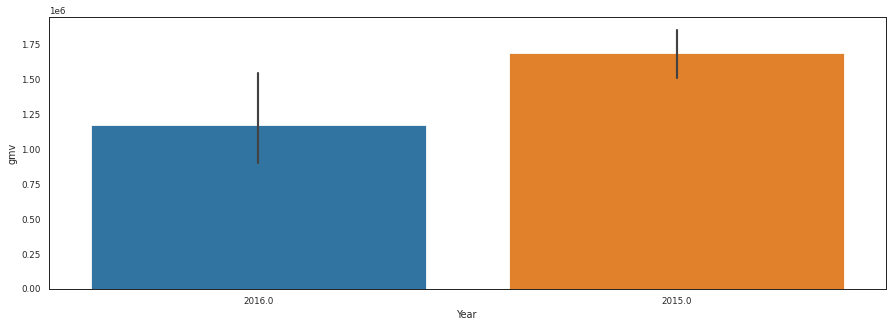

In [967]:
plt.figure(figsize=(15, 5))
sns.barplot(gaming_week['Year'],gaming_week['gmv'])

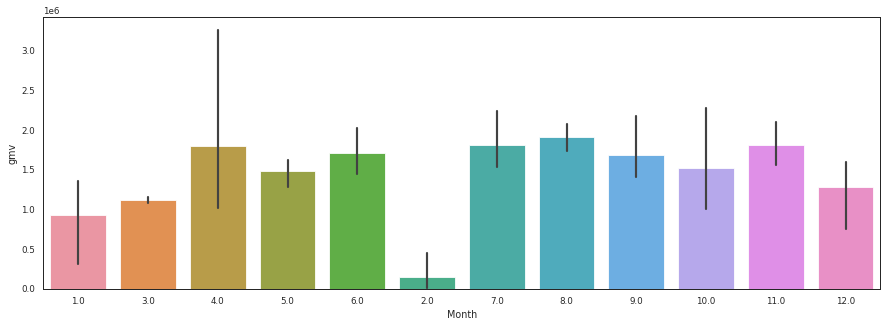

In [968]:
plt.figure(figsize=(15, 5))
sns.barplot(gaming_week['Month'],gaming_week['gmv'])

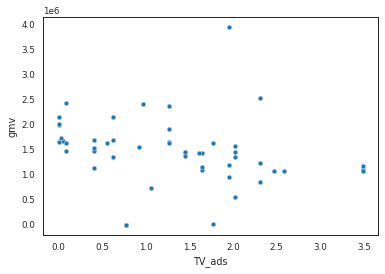

In [969]:
sns.scatterplot('TV_ads','gmv',data=gaming_week)

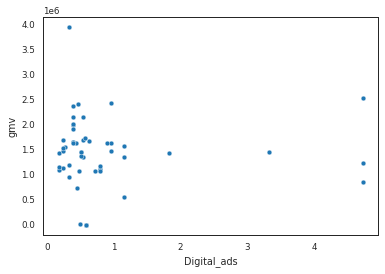

In [970]:
sns.scatterplot('Digital_ads','gmv',data=gaming_week)

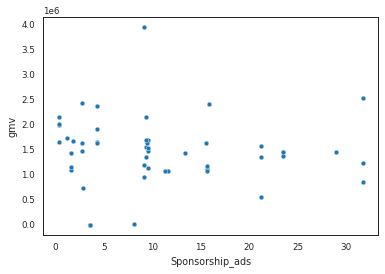

In [971]:
sns.scatterplot('Sponsorship_ads','gmv',data=gaming_week)

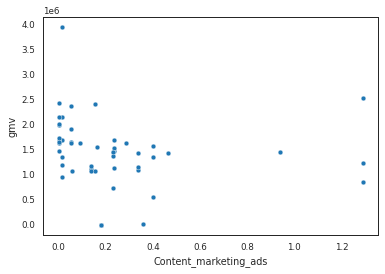

In [972]:
sns.scatterplot('Content_marketing_ads','gmv',data=gaming_week)

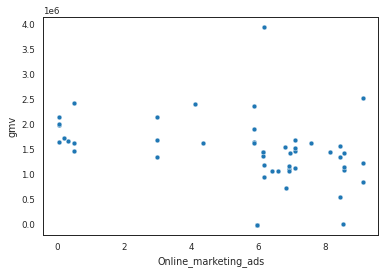

In [973]:
sns.scatterplot('Online_marketing_ads','gmv',data=gaming_week)

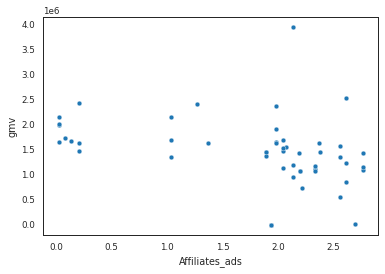

In [974]:
sns.scatterplot('Affiliates_ads','gmv',data=gaming_week)


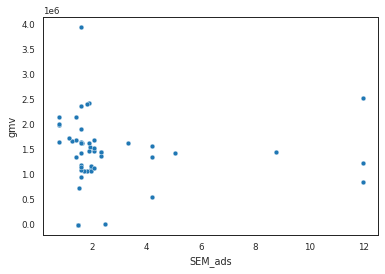

In [975]:
sns.scatterplot('SEM_ads','gmv',data=gaming_week)

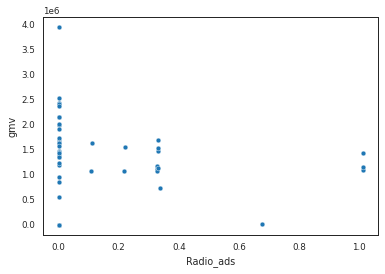

In [976]:
sns.scatterplot('Radio_ads','gmv',data=gaming_week)

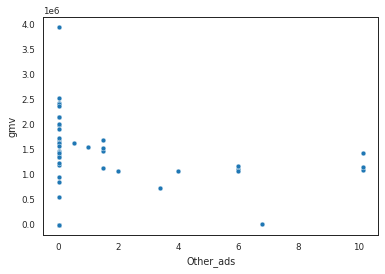

In [977]:
sns.scatterplot('Other_ads','gmv',data=gaming_week)

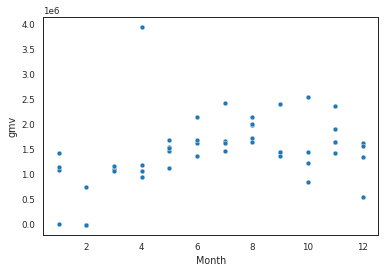

In [978]:
sns.scatterplot('Month','gmv',data=gaming_week)

In [979]:
#Moving Average

gaming_week[['MA2_LP','MA2_Discount']] = gaming_week[['list_price','discount%']].rolling(window=2,min_periods=1).mean()
gaming_week[['MA3_LP','MA3_Discount']] = gaming_week[['list_price','discount%']].rolling(window=3,min_periods=1).mean()
gaming_week[['MA4_LP','MA4_Discount']] = gaming_week[['list_price','discount%']].rolling(window=4,min_periods=1).mean()

### Reference listed price Inflation 

gaming_week['MA2_listed_price'] = (gaming_week['list_price']-gaming_week['MA2_LP'])/gaming_week['MA2_LP']
gaming_week['MA3_listed_price'] = (gaming_week['list_price']-gaming_week['MA3_LP'])/gaming_week['MA3_LP']
gaming_week['MA4_listed_price'] = (gaming_week['list_price']-gaming_week['MA4_LP'])/gaming_week['MA4_LP']

### Reference discount Inflation

gaming_week['MA2_discount'] = (gaming_week['discount%']-gaming_week['MA2_Discount'])/gaming_week['MA2_Discount']
gaming_week['MA3_discount'] = (gaming_week['discount%']-gaming_week['MA3_Discount'])/gaming_week['MA3_Discount']
gaming_week['MA4_discount'] = (gaming_week['discount%']-gaming_week['MA4_Discount'])/gaming_week['MA4_Discount']


gaming_week.drop(['MA2_LP','MA3_LP','MA4_LP','MA2_Discount','MA3_Discount','MA4_Discount'], axis = 1, inplace = True)  
gaming_week


,Week,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,order_item_id,order_id,s1_fact.order_payment_type,GamePad,GamingAccessoryKit,GamingHeadset,GamingMemoryCard,MotionController,GamingMouse,GamingAdapter,TVOutCableAccessory,GamingGun,JoystickGamingWheel,GamingMousePad,GamingKeyboard,GamingSpeaker,CoolingPad,GamingChargingStation,GameControlMount,Year,Month,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship,Sponsorship_SMA_3,Sponsorship_SMA_5,...,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other,Other_SMA_3,Other_SMA_5,Other_EMA_8,Date,TV_ads,Digital_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,Affiliates_ads,SEM_ads,Radio_ads,Other_ads,NPS,Stock_Index,Sale_days,Payday,max_temp_C,min_temp_C,mean_temp_C,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,total_precip_mm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
0,1,17466.000,681.080,898.440,0.220,2.960,2.560,19,25.000,25.000,25,15.000,4.000,1.000,0.000,0,4.000,0,0,0,0,0.000,1.000,0,0,0,0,2016.000,1.000,8.333,9.800,9.146,35.333,41.400,38.727,18.549,23.974,25.059,22.026,1.095,1.264,1.298,1.178,0.114,0.549,0.636,0.627,1.050,9.801,11.551,...,5.725,5.659,5.646,5.234,1.842,1.752,1.734,1.633,1.050,2.213,2.446,2.271,0.675,0.225,0.135,0.150,6.773,2.258,1.355,1.505,2016-01-01,1.769,0.497,8.138,0.359,8.538,2.696,2.447,0.675,6.773,54.600,1177.000,0.000,0.200,25.500,13.200,19.360,0.100,1.460,0.000,0.000,0.000,0.000,100.000,0.000,0.000,0.000,0.000,0.000,0.000
1,10,1083391.500,463.833,746.250,0.380,5.081,2.506,306,1977.000,2269.000,442,1188.000,89.000,307.000,12.000,3,362.000,31,126,0,20,92.000,53.000,0,0,0,0,2016.000,3.000,2.333,2.200,2.849,9.000,8.000,10.794,25.006,14.742,12.689,15.372,2.325,1.120,0.879,1.055,0.525,0.430,0.411,0.408,10.397,5.029,3.955,...,4.609,4.188,4.104,4.454,1.554,1.380,1.345,1.451,1.298,1.083,1.040,1.191,0.218,0.073,0.044,0.143,3.986,1.329,0.797,1.836,2016-03-01,2.584,0.717,11.569,0.152,6.598,2.200,1.786,0.218,3.986,48.791,1116.000,0.000,0.143,28.811,15.842,21.540,1.632,5.172,9.026,0.029,9.055,0.041,22.357,-0.190,-0.190,-0.190,0.268,0.268,0.268
2,11,1118085.000,519.637,833.842,0.371,5.517,2.437,314,1723.000,2105.000,413,821.000,114.000,304.000,127.000,1,351.000,22,210,0,25,88.000,42.000,0,0,0,0,2016.000,3.000,2.667,2.400,2.883,10.000,9.000,10.840,25.006,19.874,15.768,17.513,2.325,1.722,1.240,1.337,0.525,0.478,0.440,0.434,10.397,7.713,5.566,...,4.609,4.399,4.230,4.488,1.554,1.467,1.397,1.474,1.298,1.190,1.104,1.214,0.218,0.145,0.087,0.160,3.986,2.657,1.594,2.314,2016-03-01,3.488,0.788,15.596,0.140,6.913,2.331,1.947,0.327,5.979,46.925,1101.000,0.000,0.000,22.265,13.128,17.812,2.546,2.358,1.424,0.058,1.482,0.082,23.970,0.057,-0.063,-0.063,-0.012,0.147,0.147
3,12,1080541.251,514.867,846.017,0.381,5.861,2.474,310,2038.000,2050.000,426,730.000,114.000,312.000,96.000,5,332.000,37,242,0,27,115.000,41.000,0,0,0,0,2016.000,3.000,3.000,2.600,2.909,11.000,10.000,11.098,25.006,25.006,18.848,19.178,2.325,2.325,1.602,1.557,0.525,0.525,0.468,0.455,10.397,10.397,7.176,...,4.609,4.609,4.357,4.515,1.554,1.554,1.450,1.492,1.298,1.298,1.169,1.233,0.218,0.218,0.131,0.173,3.986,3.986,2.392,2.686,2016-03-01,3.488,0.788,15.596,0.140,6.913,2.331,1.947,0.327,5.979,46.925,1101.000,0.000,0.143,20.770,10.855,16.044,4.080,2.124,1.422,0.088,1.509,0.124,20.903,-0.005,0.031,-0.055,0.013,0.009,0.127
4,13,1168008.000,524.315,935.469,0.400,6.014,2.327,309,2168.000,2166.000,401,747.000,150.000,541.000,55.000,4,323.000,32,158,0,24,91.000,43.000,0,0,0,0,2016.000,3.000,3.000,2.800,2.929,12.000,11.000,11.520,2

## HOME AUDIO EDA

In [980]:
home_audio.columns

Index(['fsn_id', 'order_date', 'Year', 'Month', 'order_id', 'order_item_id',
       'gmv', 'units', 's1_fact.order_payment_type', 'sla',
       'product_analytic_category', 'product_analytic_sub_category',
       'product_analytic_vertical', 'product_mrp', 'product_procurement_sla',
       'BoomBox', 'CameraAccessory', 'CameraBag', 'CameraBattery',
       'CameraBatteryCharger', 'CameraBatteryGrip', 'CameraEyeCup',
       'CameraFilmRolls', 'CameraHousing', 'CameraLEDLight',
       'CameraMicrophone', 'CameraMount', 'CameraRemoteControl',
       'CameraTripod', 'CoolingPad', 'DJController', 'Dock', 'DockingStation',
       'ExtensionTube', 'FMRadio', 'Filter', 'Flash', 'FlashShoeAdapter',
       'GameControlMount', 'GamePad', 'GamingAccessoryKit', 'GamingAdapter',
       'GamingChargingStation', 'GamingGun', 'GamingHeadset', 'GamingKeyboard',
       'GamingMemoryCard', 'GamingMouse', 'GamingMousePad', 'GamingSpeaker',
       'HiFiSystem', 'HomeAudioSpeaker', 'JoystickGamingWheel',
    

In [981]:
home_audio_week=pd.DataFrame(home_audio.groupby('Week').agg({'gmv':'sum','list_price':'mean',
                                                             'product_mrp':'mean','discount%':'mean',
                                                             'sla':'mean','product_procurement_sla':'mean',
                                                             'fsn_id':pd.Series.nunique,'order_item_id':pd.Series.nunique,
                                                             'order_id': pd.Series.nunique,
                                                             's1_fact.order_payment_type':'sum',
                                                             'HomeAudioSpeaker':'sum', 'Dock':'sum', 'BoomBox':'sum', 'DockingStation':'sum', 'DJController':'sum',
 'FMRadio':'sum', 'HiFiSystem':'sum', 'VoiceRecorder':'sum', 'KaraokePlayer':'sum', 'SlingBox':'sum',
 'SoundMixer':'sum'})) 
home_audio_week.reset_index(inplace=True)


In [982]:
home_audio_week.head()

,Week,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,order_item_id,order_id,s1_fact.order_payment_type,HomeAudioSpeaker,Dock,BoomBox,DockingStation,DJController,FMRadio,HiFiSystem,VoiceRecorder,KaraokePlayer,SlingBox,SoundMixer
0,1,83742.000,2392.629,4369.057,0.397,2.943,3.486,19,35.000,35.000,34,29.000,0,4,0,0,2.000,0,0,0,0,0
1,10,3069876.000,1760.821,3140.983,0.365,5.685,2.723,227,1577.000,1738.000,393,1044.000,47,65,1,0,521.000,23,38,0,0,0
2,11,3465270.000,1734.538,3141.557,0.368,5.606,2.815,241,1625.000,1992.000,391,1178.000,52,81,3,0,604.000,27,47,0,0,0
3,12,3087099.000,1707.189,2985.867,0.359,6.310,2.618,240,1797.000,1801.000,387,1074.000,51,76,4,0,545.000,23,28,0,0,0
4,13,3400840.000,1589.708,2733.376,0.349,6.397,2.589,248,2133.000,2133.000,448,1220.000,52,76,3,0,727.000,20,35,0,0,0


In [983]:
home_audio_week = home_audio_week.merge(media, how = 'left', on = 'Week')

In [984]:
home_audio_week = home_audio_week.merge(calendor, how = 'left', on = 'Week')

In [985]:
home_audio_week['online_order_percentage'] = home_audio_week['s1_fact.order_payment_type']*100/home_audio_week['order_item_id']

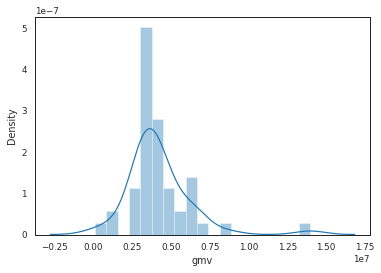

In [986]:
sns.distplot(home_audio_week['gmv'],kde=True)

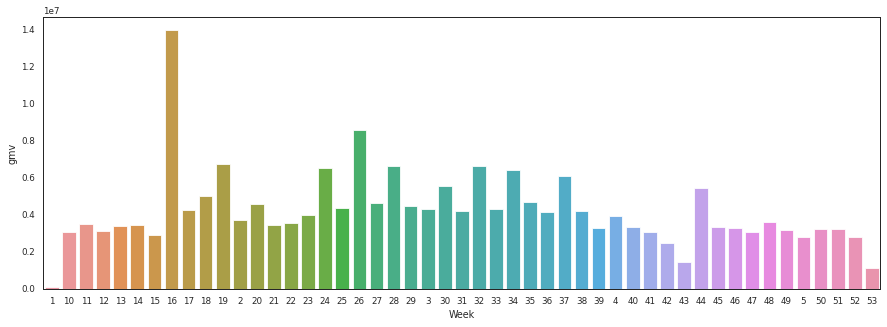

In [987]:
plt.figure(figsize=(15, 5))
sns.barplot(home_audio_week['Week'],home_audio_week['gmv'])

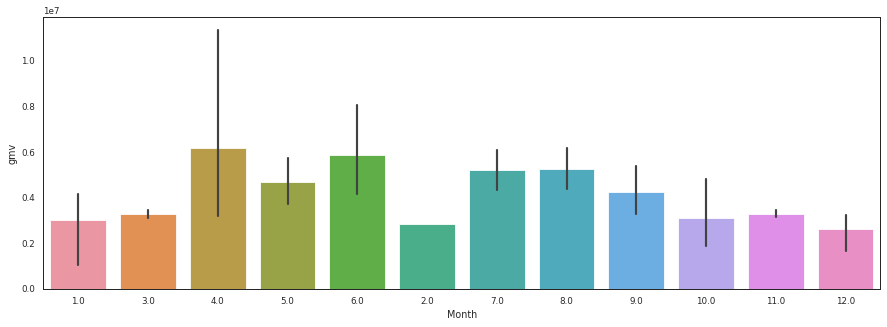

In [988]:
plt.figure(figsize=(15, 5))
sns.barplot(home_audio_week['Month'],home_audio_week['gmv'])

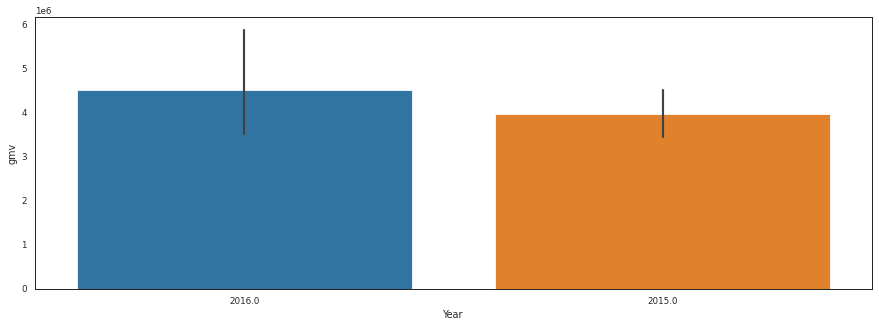

In [989]:
plt.figure(figsize=(15, 5))
sns.barplot(home_audio_week['Year'],home_audio_week['gmv'])

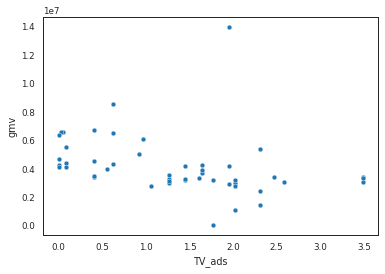

In [990]:
sns.scatterplot('TV_ads','gmv',data=home_audio_week)

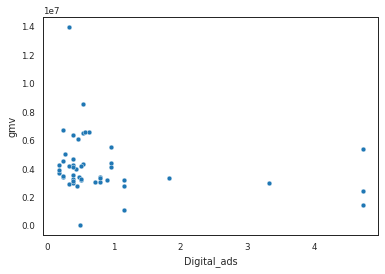

In [991]:
sns.scatterplot('Digital_ads','gmv',data=home_audio_week)

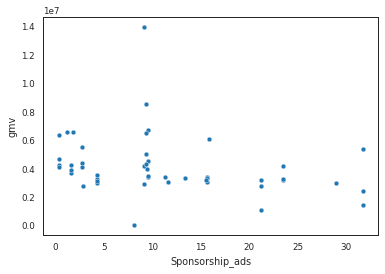

In [992]:
sns.scatterplot('Sponsorship_ads','gmv',data=home_audio_week)

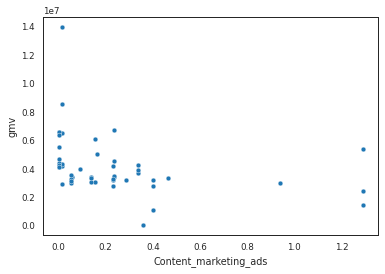

In [993]:
sns.scatterplot('Content_marketing_ads','gmv',data=home_audio_week)

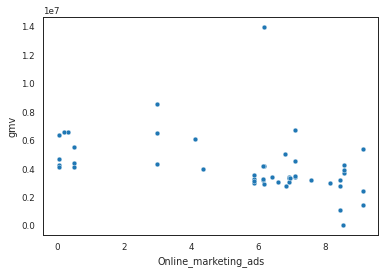

In [994]:
sns.scatterplot('Online_marketing_ads','gmv',data=home_audio_week)

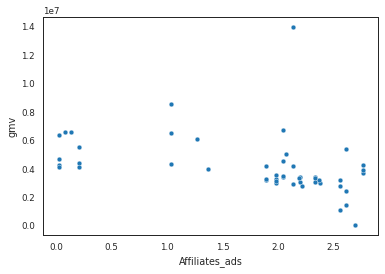

In [995]:
sns.scatterplot('Affiliates_ads','gmv',data=home_audio_week)

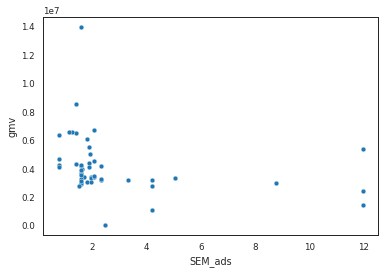

In [996]:
sns.scatterplot('SEM_ads','gmv',data=home_audio_week)

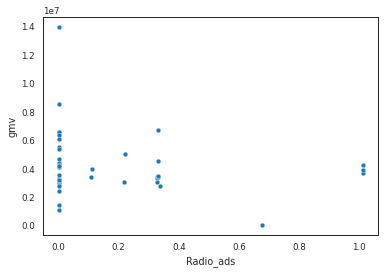

In [997]:
sns.scatterplot('Radio_ads','gmv',data=home_audio_week)

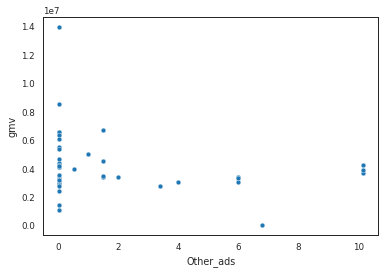

In [998]:
sns.scatterplot('Other_ads','gmv',data=home_audio_week)

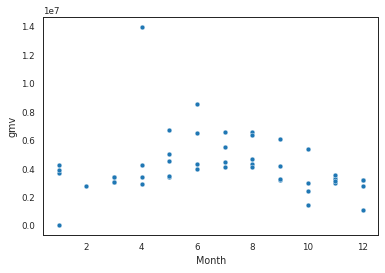

In [999]:
sns.scatterplot('Month','gmv',data=home_audio_week)

In [1000]:
#Moving Average

home_audio_week[['MA2_LP','MA2_Discount']] = home_audio_week[['list_price','discount%']].rolling(window=2,min_periods=1).mean()
home_audio_week[['MA3_LP','MA3_Discount']] = home_audio_week[['list_price','discount%']].rolling(window=3,min_periods=1).mean()
home_audio_week[['MA4_LP','MA4_Discount']] = home_audio_week[['list_price','discount%']].rolling(window=4,min_periods=1).mean()

### Reference listed price Inflation 

home_audio_week['MA2_listed_price'] = (home_audio_week['list_price']-home_audio_week['MA2_LP'])/home_audio_week['MA2_LP']
home_audio_week['MA3_listed_price'] = (home_audio_week['list_price']-home_audio_week['MA3_LP'])/home_audio_week['MA3_LP']
home_audio_week['MA4_listed_price'] = (home_audio_week['list_price']-home_audio_week['MA4_LP'])/home_audio_week['MA4_LP']

### Reference discount Inflation

home_audio_week['MA2_discount'] = (home_audio_week['discount%']-home_audio_week['MA2_Discount'])/home_audio_week['MA2_Discount']
home_audio_week['MA3_discount'] = (home_audio_week['discount%']-home_audio_week['MA3_Discount'])/home_audio_week['MA3_Discount']
home_audio_week['MA4_discount'] = (home_audio_week['discount%']-home_audio_week['MA4_Discount'])/home_audio_week['MA4_Discount']


home_audio_week.drop(['MA2_LP','MA3_LP','MA4_LP','MA2_Discount','MA3_Discount','MA4_Discount'], axis = 1, inplace = True)  
home_audio_week



,Week,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,order_item_id,order_id,s1_fact.order_payment_type,HomeAudioSpeaker,Dock,BoomBox,DockingStation,DJController,FMRadio,HiFiSystem,VoiceRecorder,KaraokePlayer,SlingBox,SoundMixer,Year,Month,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other,Other_SMA_3,Other_SMA_5,Other_EMA_8,Date,TV_ads,Digital_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,Affiliates_ads,SEM_ads,Radio_ads,Other_ads,NPS,Stock_Index,Sale_days,Payday,max_temp_C,min_temp_C,mean_temp_C,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,total_precip_mm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
0,1,83742.000,2392.629,4369.057,0.397,2.943,3.486,19,35.000,35.000,34,29.000,0,4,0,0,2.000,0,0,0,0,0,2016.000,1.000,8.333,9.800,9.146,35.333,41.400,38.727,18.549,23.974,25.059,22.026,1.095,1.264,1.298,1.178,0.114,0.549,0.636,0.627,1.050,9.801,11.551,9.191,0.225,0.253,0.259,0.236,5.725,5.659,5.646,5.234,1.842,1.752,1.734,1.633,1.050,2.213,2.446,2.271,0.675,0.225,0.135,0.150,6.773,2.258,1.355,1.505,2016-01-01,1.769,0.497,8.138,0.359,8.538,2.696,2.447,0.675,6.773,54.600,1177.000,0.000,0.200,25.500,13.200,19.360,0.100,1.460,0.000,0.000,0.000,0.000,97.143,0.000,0.000,0.000,0.000,0.000,0.000
1,10,3069876.000,1760.821,3140.983,0.365,5.685,2.723,227,1577.000,1738.000,393,1044.000,47,65,1,0,521.000,23,38,0,0,0,2016.000,3.000,2.333,2.200,2.849,9.000,8.000,10.794,25.006,14.742,12.689,15.372,2.325,1.120,0.879,1.055,0.525,0.430,0.411,0.408,10.397,5.029,3.955,4.696,0.093,0.110,0.114,0.138,4.609,4.188,4.104,4.454,1.554,1.380,1.345,1.451,1.298,1.083,1.040,1.191,0.218,0.073,0.044,0.143,3.986,1.329,0.797,1.836,2016-03-01,2.584,0.717,11.569,0.152,6.598,2.200,1.786,0.218,3.986,48.791,1116.000,0.000,0.143,28.811,15.842,21.540,1.632,5.172,9.026,0.029,9.055,0.041,24.921,-0.152,-0.152,-0.152,-0.042,-0.042,-0.042
2,11,3465270.000,1734.538,3141.557,0.368,5.606,2.815,241,1625.000,1992.000,391,1178.000,52,81,3,0,604.000,27,47,0,0,0,2016.000,3.000,2.667,2.400,2.883,10.000,9.000,10.840,25.006,19.874,15.768,17.513,2.325,1.722,1.240,1.337,0.525,0.478,0.440,0.434,10.397,7.713,5.566,5.963,0.093,0.102,0.109,0.128,4.609,4.399,4.230,4.488,1.554,1.467,1.397,1.474,1.298,1.190,1.104,1.214,0.218,0.145,0.087,0.160,3.986,2.657,1.594,2.314,2016-03-01,3.488,0.788,15.596,0.140,6.913,2.331,1.947,0.327,5.979,46.925,1101.000,0.000,0.000,22.265,13.128,17.812,2.546,2.358,1.424,0.058,1.482,0.082,24.062,-0.008,-0.116,-0.116,0.003,-0.024,-0.024
3,12,3087099.000,1707.189,2985.867,0.359,6.310,2.618,240,1797.000,1801.000,387,1074.000,51,76,4,0,545.000,23,28,0,0,0,2016.000,3.000,3.000,2.600,2.909,11.000,10.000,11.098,25.006,25.006,18.848,19.178,2.325,2.325,1.602,1.557,0.525,0.525,0.468,0.455,10.397,10.397,7.176,6.948,0.093,0.093,0.103,0.120,4.609,4.609,4.357,4.515,1.554,1.554,1.450,1.492,1.298,1.298,1.169,1.233,0.218,0.218,0.131,0.173,3.986,3.986,2.392,2.686,2016-03-01,3.488,0.788,15.596,0.140,6.913,2.331,1.947,0.327,5.979,46.925,1101.000,0.000,0.143,20.770,10.855,16.044,4.080,2.124,1.422,0.088,1.509,0.124,21.536,-0.008,-0.016,-0.101,-0.012,-0.014,-0.036
4,13,3400840.000,1589.708,2733.376,0.349,6.397,2.589,248,2133.000,2133.000,448,1220.000,52,76,3,0,727.000,20,35,0,0,0,2016.000,3.000,3.000,2.800,2.929,12.000,11.000,11.520,25.006,25.006,21.927,20.473,2.325,2.325,1.963,1.728,0.525,0.525,0.497,0

In [1001]:
camera_week.tail()


,Week,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,order_item_id,order_id,s1_fact.order_payment_type,premium_product,CameraTripod,Lens,CameraBag,Flash,CameraBattery,CameraBatteryCharger,CameraRemoteControl,Filter,Strap,CameraBatteryGrip,CameraAccessory,CameraFilmRolls,CameraMount,ExtensionTube,Telescope,CameraEyeCup,CameraLEDLight,CameraMicrophone,Softbox,CameraHousing,FlashShoeAdapter,ReflectorUmbrella,Teleconverter,Year,Month,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV,TV_SMA_3,TV_SMA_5,...,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other,Other_SMA_3,Other_SMA_5,Other_EMA_8,Date,TV_ads,Digital_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,Affiliates_ads,SEM_ads,Radio_ads,Other_ads,NPS,Stock_Index,Sale_days,Payday,max_temp_C,min_temp_C,mean_temp_C,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,total_precip_mm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount_offer,MA3_discount_offer,MA4_discount_offer
47,52,1348645.000,462.703,1090.140,0.513,6.124,2.440,613,2866.000,2864.000,562,0,176.000,470.000,234.000,806.000,432.000,236.000,78.000,144.000,33,0,40,48,7,0,16,4,0,0,0,2,0,0,0,2015.000,12.000,12.000,11.600,11.324,51.000,50.000,48.508,26.686,26.686,20.109,21.972,1.349,1.349,1.147,...,5.626,5.626,4.940,4.942,1.707,1.707,1.552,1.536,2.795,2.795,2.095,2.570,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,2015-12-01,2.023,1.149,21.264,0.401,8.439,2.561,4.192,0.000,0.000,50.517,1194.000,0.000,0.000,28.122,14.199,21.269,1.632,4.901,1.195,0.058,1.254,0.082,19.609,0.065,0.113,0.046,-0.042,-0.077,-0.028
48,53,588952.000,447.332,1075.601,0.523,5.346,2.413,377,1301.000,1301.000,219,0,77.000,218.000,132.000,384.000,161.000,110.000,18.000,73.000,16,0,14,21,2,0,6,4,0,0,0,1,0,0,0,2015.000,12.000,12.000,11.800,11.474,52.000,51.000,49.507,26.686,26.686,23.397,23.020,1.349,1.349,1.248,...,5.626,5.626,5.283,5.094,1.707,1.707,1.629,1.574,2.795,2.795,2.445,2.620,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,2015-12-01,2.023,1.149,21.264,0.401,8.439,2.561,4.192,0.000,0.000,50.517,1194.000,0.000,0.000,25.714,12.598,19.321,2.856,4.177,1.792,0.102,1.894,0.144,16.833,-0.017,0.020,0.056,0.009,-0.016,-0.045
49,6,1498.000,749.000,1124.500,0.260,9.500,4.000,2,2.000,2.000,1,0,1.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2016.000,2.000,1.667,1.400,3.714,5.000,4.000,14.234,9.610,12.590,14.973,16.007,0.517,0.710,0.864,...,3.978,4.560,5.026,4.895,1.293,1.476,1.622,1.566,0.975,1.000,1.020,1.368,0.000,0.225,0.405,0.259,0.000,2.258,4.064,2.598,2016-02-01,0.776,0.575,3.518,0.178,5.967,1.939,1.462,0.000,0.000,59.987,1206.000,0.000,0.000,24.908,12.870,18.475,2.448,2.923,0.938,0.058,0.997,0.082,50.000,0.252,0.354,0.451,-0.336,-0.398,-0.439
50,7,299.000,299.000,1990.000,0.850,6.000,1.000,1,1.000,1.000,0,0,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2016.000,2.000,2.000,1.600,3.333,6.000,5.000,12.627,9.610,9.610,13.186,14.586,0.517,0.517,0.748,...,3.978,3.978,4.677,4.691,1.293,1.293,1.513,1.505,0.975,0.975,1.005,1.281,0.000,0.000,0.270,0.201,0.000,0.000,2.709,2.021,2016-02-01,0.776,0.575,3.518,0.178,5.967,1.939,1.462,0.000,0.000,59.987,1206.000,0.286,0.143,25.148,14.156,19.789,2.448,4.237,2.764,0.088,2.852,0.124,0.000,-0.429,-0.400,-0.389,0.532,0.562,0.585
51,9,905.000,452.500,744.500,0.475,7.500,1.500,2,2.000,2.000,2,0,0.000,2.000,0.000,0.000,0.000,0.000,0.000,0.000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2016.000,2.000,2.000,2.000,2.806,8.000,7.000,11.021,9.610,9.610,9.610,12.620,0.517,0.517,0.517,...,3.978,3.978,3.978,4.410,1.293,1.293,1.293,1.421,0.975,0.975,0.975,1.160,0.000,0.000,0.000,0.122,0.000,0.000,0.000,1.2

In [1002]:
### Sorting the dataframes based on Week# from July,2015 to June,2016

In [1003]:
# String to Int

camera_week['Week'] = camera_week['Week'].astype('int64')
gaming_week['Week'] = gaming_week['Week'].astype('int64')
home_audio_week['Week'] = home_audio_week['Week'].astype('int64')

In [1004]:
camera_week1 = camera_week.loc[camera_week['Week'] >= 28]
camera_week2 = camera_week.loc[camera_week['Week'] < 28]

gaming_week1 = gaming_week.loc[gaming_week['Week'] >= 28]
gaming_week2 = gaming_week.loc[gaming_week['Week'] < 28]

home_audio_week1 = home_audio_week[home_audio_week['Week'] >= 28]
home_audio_week2 = home_audio_week.loc[home_audio_week['Week'] < 28]

camera_week = camera_week1.append(camera_week2)
gaming_week = gaming_week1.append(gaming_week2)
home_audio_week = home_audio_week1.append(home_audio_week2)

camera_week.head()

,Week,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,order_item_id,order_id,s1_fact.order_payment_type,premium_product,CameraTripod,Lens,CameraBag,Flash,CameraBattery,CameraBatteryCharger,CameraRemoteControl,Filter,Strap,CameraBatteryGrip,CameraAccessory,CameraFilmRolls,CameraMount,ExtensionTube,Telescope,CameraEyeCup,CameraLEDLight,CameraMicrophone,Softbox,CameraHousing,FlashShoeAdapter,ReflectorUmbrella,Teleconverter,Year,Month,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV,TV_SMA_3,TV_SMA_5,...,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other,Other_SMA_3,Other_SMA_5,Other_EMA_8,Date,TV_ads,Digital_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,Affiliates_ads,SEM_ads,Radio_ads,Other_ads,NPS,Stock_Index,Sale_days,Payday,max_temp_C,min_temp_C,mean_temp_C,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,total_precip_mm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount_offer,MA3_discount_offer,MA4_discount_offer
20,28,2178725.000,455.569,1075.559,0.513,5.874,2.751,626,4716.000,4717.000,793,0,775.000,469.000,211.000,1987.000,496.000,232.000,83.000,175.000,24,0,42,26,15,1,15,1,0,0,0,0,0,0,0,2015.000,7.000,nan,nan,7.000,nan,nan,28.000,4.265,nan,nan,4.265,0.054,nan,nan,...,0.332,nan,nan,0.332,0.137,nan,nan,0.137,1.256,nan,nan,1.256,0.000,nan,nan,0.000,0.000,nan,nan,0.000,2015-07-01,0.054,0.633,1.854,0.000,0.332,0.137,1.256,0.000,0.000,47.093,1052.000,0.000,0.000,13.316,2.684,8.166,10.950,1.116,4.848,1.117,5.965,0.165,16.815,-0.067,-0.080,-0.107,0.047,0.034,0.055
21,29,1615463.000,480.423,1132.643,0.511,6.639,2.476,594,3323.000,3322.000,622,0,604.000,346.000,195.000,1055.000,395.000,202.000,73.000,182.000,32,0,39,37,9,2,7,2,0,0,0,0,0,0,0,2015.000,7.000,nan,nan,7.000,nan,nan,28.222,4.265,nan,nan,4.265,0.054,nan,nan,...,0.332,nan,nan,0.332,0.137,nan,nan,0.137,1.256,nan,nan,1.256,0.000,nan,nan,0.000,0.000,nan,nan,0.000,2015-07-01,0.081,0.950,2.781,0.000,0.498,0.206,1.884,0.000,0.000,47.093,1052.000,0.000,0.143,11.245,1.469,6.538,12.578,1.116,2.562,0.117,2.679,4.593,18.718,0.027,-0.011,-0.022,-0.003,0.027,0.021
23,30,2035389.500,467.726,1039.439,0.507,6.411,2.563,659,4299.000,4299.000,906,0,426.000,449.000,231.000,1819.000,510.000,281.000,76.000,212.000,35,0,39,40,14,2,15,1,0,0,0,0,0,0,0,2015.000,7.000,7.000,nan,7.000,29.000,nan,28.617,4.265,4.265,nan,4.265,0.054,0.054,nan,...,0.332,0.332,nan,0.332,0.137,0.137,nan,0.137,1.256,1.256,nan,1.256,0.000,0.000,nan,0.000,0.000,0.000,nan,0.000,2015-07-01,0.081,0.950,2.781,0.000,0.498,0.206,1.884,0.000,0.000,47.093,1052.000,0.429,0.000,13.698,8.696,14.241,5.712,1.953,1.846,0.146,1.992,0.206,21.075,-0.046,-0.040,-0.024,0.051,0.031,0.020
24,31,1529971.000,522.751,1099.183,0.461,6.673,2.468,640,2894.000,2893.000,547,0,370.000,410.000,274.000,587.000,518.000,198.000,62.000,170.000,27,0,40,27,13,2,10,0,0,0,0,0,0,0,0,2015.000,7.000,7.000,nan,7.000,30.000,nan,29.147,4.265,4.265,nan,4.265,0.054,0.054,nan,...,0.332,0.332,nan,0.332,0.137,0.137,nan,0.137,1.256,1.256,nan,1.256,0.000,0.000,nan,0.000,0.000,0.000,nan,0.000,2015-07-01,0.081,0.950,2.781,0.000,0.498,0.206,1.884,0.000,0.000,47.093,1052.000,0.000,0.000,15.341,6.168,11.950,7.725,1.674,1.846,0.146,1.992,0.206,18.901,0.056,0.043,0.054,-0.048,-0.030,-0.048
25,32,2161258.000,442.547,1068.245,0.531,6.335,2.606,683,4808.000,4808.000,908,0,577.000,432.000,261.000,1847.000,820.000,217.000,71.000,215.000,35,0,46,32,21,3,16,1,0,0,0,0,0,0,0,2015.000,8.000,7.333,7.200,7.222,31.000,30.000,29.781,1.013,3.181,3.615,3.542,0.001,0.036,0.043,...,0.026,0.230,0.271,0.264,0.015,0.096,0.113,0.110,0.503,1.005,1.105,1.089,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,2015-08-01,0.028,0.

In [1005]:
camera_week.fillna(value=0, inplace=True)
gaming_week.fillna(value=0, inplace=True)
home_audio_week.fillna(value=0, inplace=True)



In [1006]:
gaming_week.head()

,Week,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,order_item_id,order_id,s1_fact.order_payment_type,GamePad,GamingAccessoryKit,GamingHeadset,GamingMemoryCard,MotionController,GamingMouse,GamingAdapter,TVOutCableAccessory,GamingGun,JoystickGamingWheel,GamingMousePad,GamingKeyboard,GamingSpeaker,CoolingPad,GamingChargingStation,GameControlMount,Year,Month,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship,Sponsorship_SMA_3,Sponsorship_SMA_5,...,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other,Other_SMA_3,Other_SMA_5,Other_EMA_8,Date,TV_ads,Digital_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,Affiliates_ads,SEM_ads,Radio_ads,Other_ads,NPS,Stock_Index,Sale_days,Payday,max_temp_C,min_temp_C,mean_temp_C,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,total_precip_mm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
20,28,1665891.000,447.723,1015.418,0.469,6.025,2.360,430,3658.000,3658.000,547,721.000,135.000,1456.000,318.000,9,644.000,55,140,0,27,67.000,69.000,13,3,1,0,2015.000,7.000,0.000,0.000,7.000,0.000,0.000,28.000,4.265,0.000,0.000,4.265,0.054,0.000,0.000,0.054,0.633,0.000,0.000,0.633,1.854,0.000,0.000,...,0.332,0.000,0.000,0.332,0.137,0.000,0.000,0.137,1.256,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.054,0.633,1.854,0.000,0.332,0.137,1.256,0.000,0.000,47.093,1052.000,0.000,0.000,13.316,2.684,8.166,10.950,1.116,4.848,1.117,5.965,0.165,14.954,-0.011,-0.014,-0.004,0.003,-0.026,-0.020
21,29,1640618.000,485.839,979.843,0.437,5.992,2.325,396,3319.000,3319.000,511,545.000,140.000,1333.000,363.000,2,609.000,61,87,0,30,75.000,60.000,8,3,4,0,2015.000,7.000,0.000,0.000,7.000,0.000,0.000,28.222,4.265,0.000,0.000,4.265,0.054,0.000,0.000,0.054,0.633,0.000,0.000,0.633,1.854,0.000,0.000,...,0.332,0.000,0.000,0.332,0.137,0.000,0.000,0.137,1.256,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,0.950,2.781,0.000,0.498,0.206,1.884,0.000,0.000,47.093,1052.000,0.000,0.143,11.245,1.469,6.538,12.578,1.116,2.562,0.117,2.679,4.593,15.396,0.041,0.048,0.051,-0.035,-0.044,-0.071
23,30,2432792.041,535.982,1017.082,0.451,6.059,2.447,452,4449.000,4446.000,789,999.000,157.000,1599.000,457.000,1,823.000,46,115,0,21,101.000,119.000,10,0,2,0,2015.000,7.000,7.000,0.000,7.000,29.000,0.000,28.617,4.265,4.265,0.000,4.265,0.054,0.054,0.000,0.054,0.633,0.633,0.000,0.633,1.854,1.854,0.000,...,0.332,0.332,0.000,0.332,0.137,0.137,0.000,0.137,1.256,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,0.950,2.781,0.000,0.498,0.206,1.884,0.000,0.000,47.093,1052.000,0.429,0.000,13.698,8.696,14.241,5.712,1.953,1.846,0.146,1.992,0.206,17.734,0.087,0.093,0.117,0.025,0.027,0.010
24,31,1480041.000,497.602,918.566,0.434,6.162,2.543,450,2925.000,2924.000,488,638.000,98.000,1059.000,273.000,2,499.000,49,115,0,19,86.000,75.000,10,1,1,0,2015.000,7.000,7.000,0.000,7.000,30.000,0.000,29.147,4.265,4.265,0.000,4.265,0.054,0.054,0.000,0.054,0.633,0.633,0.000,0.633,1.854,1.854,0.000,...,0.332,0.332,0.000,0.332,0.137,0.137,0.000,0.137,1.256,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,0.950,2.781,0.000,0.498,0.206,1.884,0.000,0.000,47.093,1052.000,0.000,0.000,15.341,6.168,11.950,7.725,1.674,1.846,0.146,1.992,0.206,16.684,-0.037,0.006,0.011,-0.019,-0.008,-0.008
25,32,1739754.500,478.737,903.732,0.446,5.977,2.478,460,3578.000,3577.000,589,673.000,110.000,1461.000,258.000,3,646.000,54,155,0,12,99.000,86.000,19,0,2,0,2015.

### Relationship between gmv and Spends

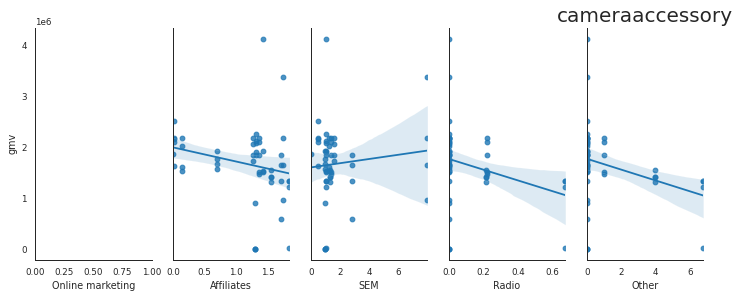

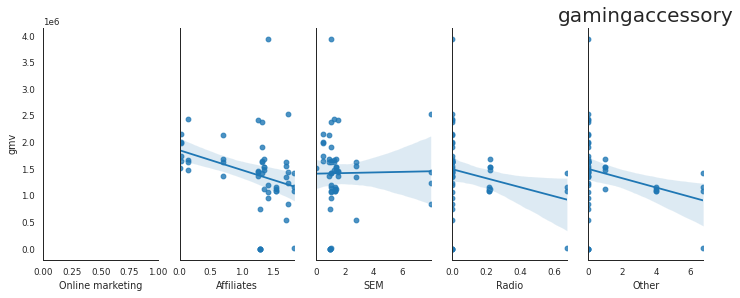

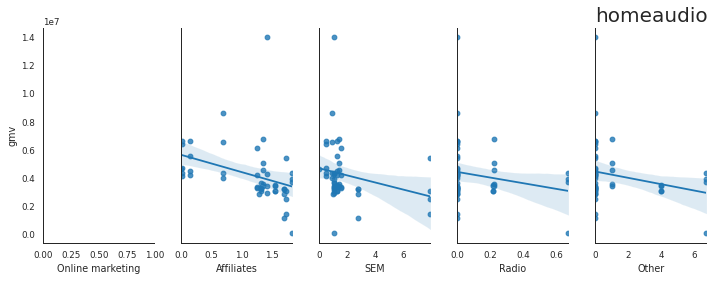

In [1007]:
sns.set_style("white") # white/whitegrid/dark/ticks
sns.set_context("paper") # talk/poster

sns.pairplot(camera_week, x_vars=['Online marketing', 'Affiliates', 'SEM', 'Radio', 'Other'], \
             y_vars='gmv',size=4, aspect=0.5, kind='reg')
plt.title('cameraaccessory', fontsize = 20)

sns.pairplot(gaming_week, x_vars=['Online marketing', 'Affiliates', 'SEM', 'Radio', 'Other'], \
             y_vars='gmv',size=4, aspect=0.5, kind='reg')
plt.title('gamingaccessory', fontsize = 20)

sns.pairplot(home_audio_week, x_vars=['Online marketing', 'Affiliates', 'SEM', 'Radio', 'Other'], \
             y_vars='gmv',size=4, aspect=0.5, kind='reg')
plt.title('homeaudio', fontsize = 20)

# Automatically adjust subplot params so that the subplotS fits in to the figure area.
plt.tight_layout()

# display the plot
plt.show()

Removing Multicollinearity

In [1008]:
#Camera Accessory

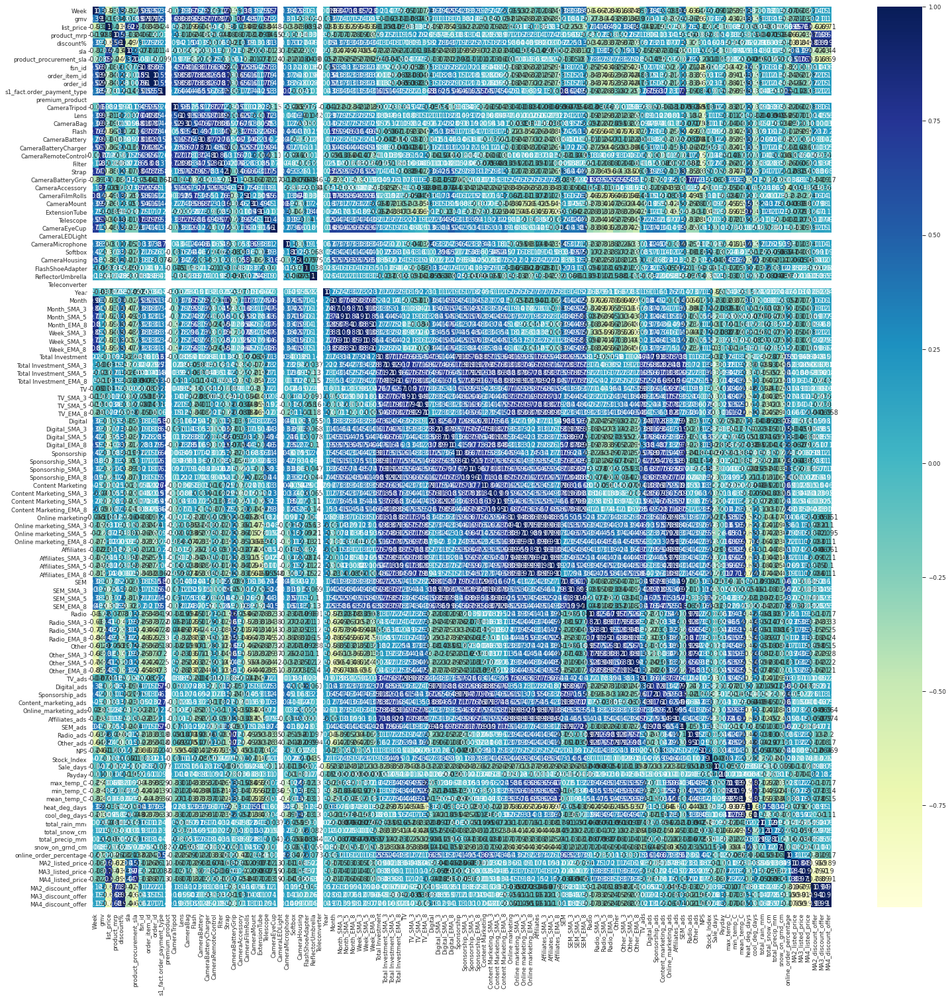

In [1009]:
plt.figure(figsize=(25,25))
sns.heatmap(camera_week.corr(),annot = True, cmap="YlGnBu")
plt.show()

In [1010]:
camera_week.drop(['Affiliates_ads','SEM_ads','Digital_ads','Radio_ads','TV', 'Digital', 'Sponsorship','Affiliates', 'SEM','Radio',
              'Other','Other_ads','mean_temp_C','min_temp_C',
              'order_id','order_item_id','total_precip_mm',
               'max_temp_C'], axis = 1, inplace = True)

In [1011]:
#gaming accessory

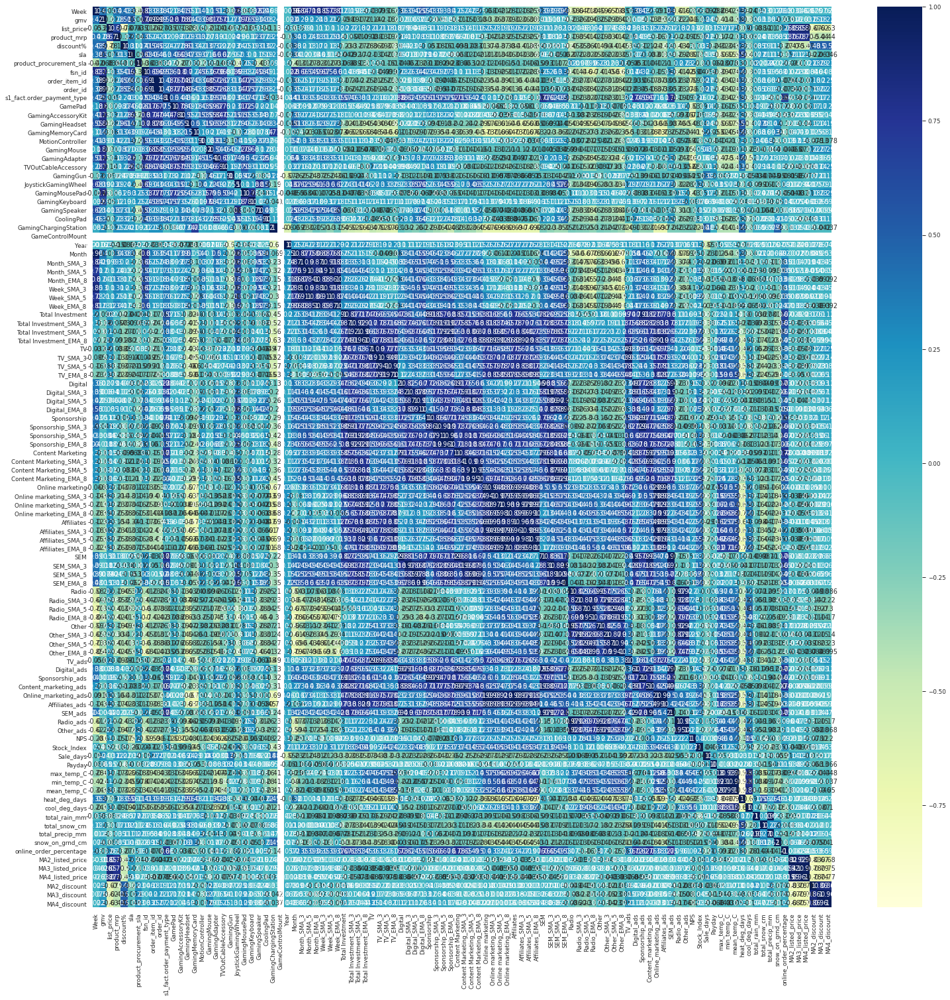

In [1012]:
plt.figure(figsize=(25,25))
sns.heatmap(gaming_week.corr(),annot = True, cmap="YlGnBu")
plt.show()

In [1013]:
gaming_week.drop(['TV', 'Digital', 'Sponsorship', 'Affiliates', 'SEM','Radio',
              'Other','Affiliates_ads','SEM_ads','Digital_ads','Radio_ads','Other_ads','mean_temp_C','min_temp_C',
              'order_id','order_item_id','total_precip_mm'], axis = 1, inplace = True)

In [1014]:
#Home Audio

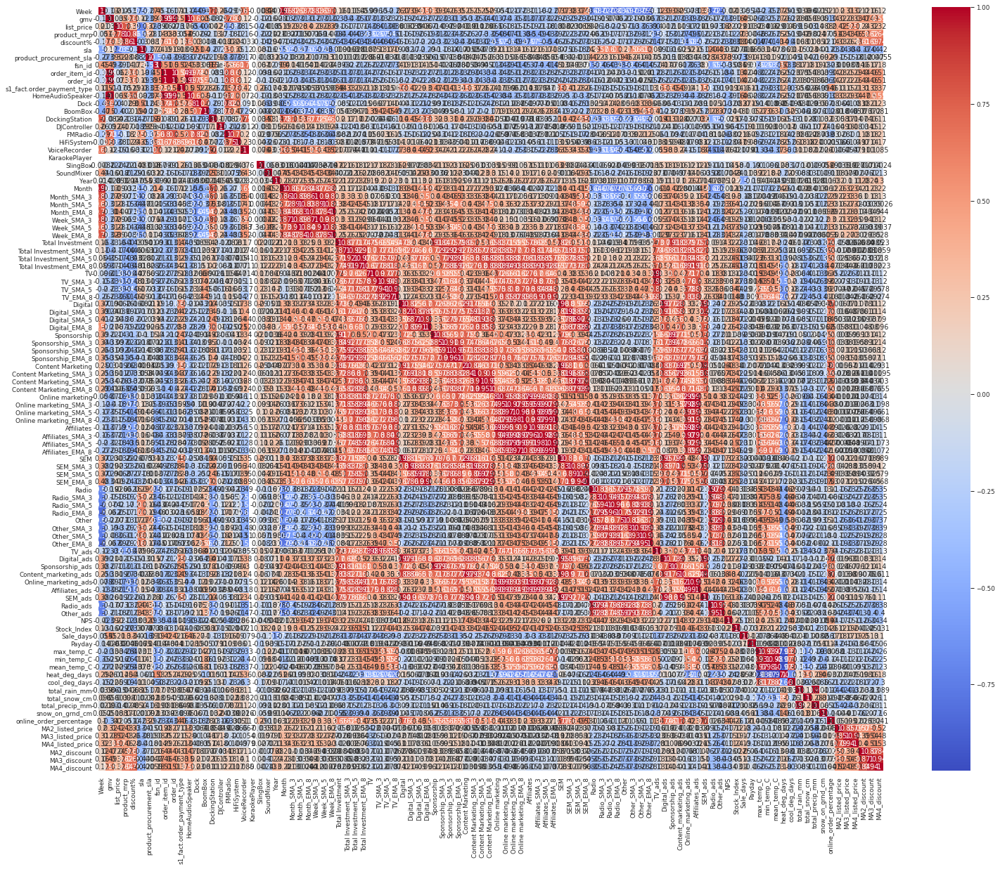

In [1015]:
plt.figure(figsize=(25,20))

### Heatmap
sns.heatmap(home_audio_week.corr(), cmap="coolwarm", annot=True)
plt.show()

In [1016]:
home_audio_week.drop(['TV', 'Digital', 'Sponsorship', 'Affiliates', 'SEM','Radio',
              'Other','Affiliates_ads','SEM_ads','Digital_ads','max_temp_C','Radio_ads','Other_ads','mean_temp_C','min_temp_C',
              'order_id','order_item_id','total_precip_mm'], axis = 1, inplace = True)

## Linear Regression Models

In [1017]:
# making a copy of original dataframes
camera_week_df = camera_week.copy()
gaming_week_df = gaming_week.copy()
home_audio_week_df = home_audio_week.copy()
home_audio_week_df.head()

,Week,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,HomeAudioSpeaker,Dock,BoomBox,DockingStation,DJController,FMRadio,HiFiSystem,VoiceRecorder,KaraokePlayer,SlingBox,SoundMixer,Year,Month,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,Date,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
20,28,6608403.000,2002.174,4250.826,0.447,4.819,2.826,277,442,2701.000,35,28,3,0,453.000,22,53,0,0,0,2015.000,7.000,0.000,0.000,7.000,0.000,0.000,28.000,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.054,1.854,0.000,0.332,47.093,1052.000,0.000,0.000,10.950,1.116,4.848,1.117,0.165,13.414,0.016,-0.015,-0.003,0.114,0.073,0.090
21,29,4453585.000,1984.649,3836.581,0.392,5.479,2.795,278,387,1669.000,46,34,8,1,417.000,14,50,0,0,0,2015.000,7.000,0.000,0.000,7.000,0.000,0.000,28.222,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.143,12.578,1.116,2.562,0.117,4.593,17.285,-0.004,0.005,-0.018,-0.066,-0.016,-0.046
23,30,5550427.500,1928.914,3808.947,0.417,5.535,2.499,288,583,2198.000,56,23,14,0,482.000,18,73,0,0,0,2015.000,7.000,7.000,0.000,7.000,29.000,0.000,28.617,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.429,0.000,5.712,1.953,1.846,0.146,0.206,20.356,0.022,0.005,-0.006,0.102,0.089,0.045
24,31,4160893.000,1912.447,3563.507,0.382,5.688,2.655,273,380,1518.000,26,26,12,1,499.000,17,68,0,0,0,2015.000,7.000,7.000,0.000,7.000,30.000,0.000,29.147,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.000,7.725,1.674,1.846,0.146,0.206,17.536,-0.004,0.009,-0.003,-0.044,0.006,-0.002
25,32,6607912.000,2025.304,4077.258,0.428,4.892,2.758,289,506,2532.000,28,37,4,0,564.000,18,75,0,0,0,2015.000,8.000,7.333,7.200,7.222,31.000,30.000,29.781,1.013,3.181,3.615,3.542,0.036,0.043,0.042,0.507,0.558,0.549,1.307,1.526,1.489,0.000,0.000,0.000,0.000,0.026,0.230,0.271,0.264,0.096,0.113,0.110,1.005,1.105,1.089,0.000,0.000,0.000,0.000,0.000,0.000,2015-08-01 00:00:00,0.028,1.140,0.000,0.192,50.327,1222.000,0.286,0.143,9.607,1.116,2.622,0.088,0.124,15.531,0.029,0.036,0.050,0.057,0.046,0.093


# Rescaling the Features of the 3 Dataframes

We will use Standard scaling.

In [1018]:
#### We will drop the `Week` column as it is a row identifier and will not help in prediction of revenue

In [1019]:
# removing columns
camera_week = camera_week.drop('Week', axis=1)
gaming_week = gaming_week.drop('Week', axis=1)
home_audio_week = home_audio_week.drop('Week', axis=1)

In [1020]:
#Dropping Year Month and Date 
camera_week = camera_week.drop(['Date','Year','Month'], axis=1)
gaming_week = gaming_week.drop(['Date','Year','Month'], axis=1)
home_audio_week = home_audio_week.drop(['Date','Year','Month'], axis=1)

In [1021]:
camera_week.head()

,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,premium_product,CameraTripod,Lens,CameraBag,Flash,CameraBattery,CameraBatteryCharger,CameraRemoteControl,Filter,Strap,CameraBatteryGrip,CameraAccessory,CameraFilmRolls,CameraMount,ExtensionTube,Telescope,CameraEyeCup,CameraLEDLight,CameraMicrophone,Softbox,CameraHousing,FlashShoeAdapter,ReflectorUmbrella,Teleconverter,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount_offer,MA3_discount_offer,MA4_discount_offer
20,2178725.000,455.569,1075.559,0.513,5.874,2.751,626,793,0,775.000,469.000,211.000,1987.000,496.000,232.000,83.000,175.000,24,0,42,26,15,1,15,1,0,0,0,0,0,0,0,0.000,0.000,7.000,0.000,0.000,28.000,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.054,1.854,0.000,0.332,47.093,1052.000,0.000,0.000,10.950,1.116,4.848,1.117,0.165,16.815,-0.067,-0.080,-0.107,0.047,0.034,0.055
21,1615463.000,480.423,1132.643,0.511,6.639,2.476,594,622,0,604.000,346.000,195.000,1055.000,395.000,202.000,73.000,182.000,32,0,39,37,9,2,7,2,0,0,0,0,0,0,0,0.000,0.000,7.000,0.000,0.000,28.222,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.143,12.578,1.116,2.562,0.117,4.593,18.718,0.027,-0.011,-0.022,-0.003,0.027,0.021
23,2035389.500,467.726,1039.439,0.507,6.411,2.563,659,906,0,426.000,449.000,231.000,1819.000,510.000,281.000,76.000,212.000,35,0,39,40,14,2,15,1,0,0,0,0,0,0,0,7.000,0.000,7.000,29.000,0.000,28.617,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.081,2.781,0.000,0.498,47.093,1052.000,0.429,0.000,5.712,1.953,1.846,0.146,0.206,21.075,-0.046,-0.040,-0.024,0.051,0.031,0.020
24,1529971.000,522.751,1099.183,0.461,6.673,2.468,640,547,0,370.000,410.000,274.000,587.000,518.000,198.000,62.000,170.000,27,0,40,27,13,2,10,0,0,0,0,0,0,0,0,7.000,0.000,7.000,30.000,0.000,29.147,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.000,7.725,1.674,1.846,0.146,0.206,18.901,0.056,0.043,0.054,-0.048,-0.030,-0.048
25,2161258.000,442.547,1068.245,0.531,6.335,2.606,683,908,0,577.000,432.000,261.000,1847.000,820.000,217.000,71.000,215.000,35,0,46,32,21,3,16,1,0,0,0,0,0,0,0,7.333,7.200,7.222,31.000,30.000,29.781,1.013,3.181,3.615,3.542,0.036,0.043,0.042,0.507,0.558,0.549,1.307,1.526,1.489,0.000,0.000,0.000,0.000,0.026,0.230,0.271,0.264,0.096,0.113,0.110,1.005,1.105,1.089,0.000,0.000,0.000,0.000,0.000,0.000,0.028,1.140,0.000,0.192,50.327,1222.000,0.286,0.143,9.607,1.116,2.622,0.088,0.124,18.885,-0.083,-0.074,-0.090,0.071,0.063,0.086


In [1022]:
camera_week.dtypes

gmv                           float64
list_price                    float64
product_mrp                   float64
discount%                     float64
sla                           float64
product_procurement_sla       float64
fsn_id                          int64
s1_fact.order_payment_type      int64
premium_product                 int64
CameraTripod                  float64
Lens                          float64
CameraBag                     float64
Flash                         float64
CameraBattery                 float64
CameraBatteryCharger          float64
CameraRemoteControl           float64
Filter                        float64
Strap                           uint8
CameraBatteryGrip               uint8
CameraAccessory                 uint8
CameraFilmRolls                 uint8
CameraMount                     uint8
ExtensionTube                   uint8
Telescope                       uint8
CameraEyeCup                    uint8
CameraLEDLight                  uint8
CameraMicrop

In [1023]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

camera_week[camera_week.columns]=scaler.fit_transform(camera_week[camera_week.columns])
gaming_week[gaming_week.columns]=scaler.fit_transform(gaming_week[gaming_week.columns])
home_audio_week[home_audio_week.columns]=scaler.fit_transform(home_audio_week[home_audio_week.columns])

camera_week.head()

,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,premium_product,CameraTripod,Lens,CameraBag,Flash,CameraBattery,CameraBatteryCharger,CameraRemoteControl,Filter,Strap,CameraBatteryGrip,CameraAccessory,CameraFilmRolls,CameraMount,ExtensionTube,Telescope,CameraEyeCup,CameraLEDLight,CameraMicrophone,Softbox,CameraHousing,FlashShoeAdapter,ReflectorUmbrella,Teleconverter,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount_offer,MA3_discount_offer,MA4_discount_offer
20,0.688,-0.348,-0.588,0.004,-0.388,0.692,0.294,-0.210,0.000,0.411,0.266,-0.166,1.513,-0.354,-0.143,-0.318,-0.048,-0.265,-0.242,0.547,-0.165,0.142,-0.050,-0.151,-0.297,0.000,-0.486,-0.361,-0.394,-0.200,-0.189,0.000,-1.743,-1.643,0.161,-1.640,-1.557,0.068,-1.077,-1.551,-1.613,-1.482,-1.360,-1.421,-1.540,-0.804,-0.891,0.109,-1.196,-1.284,-1.220,-0.685,-0.779,-0.888,-1.103,-1.679,-1.847,-1.830,-1.745,-1.895,-1.852,-1.713,-1.010,-1.103,-0.444,-0.559,-0.643,-0.778,-0.540,-0.623,-0.757,-1.271,-0.954,-0.728,-1.752,-0.599,-1.378,-0.524,-0.921,1.506,-0.572,1.222,2.688,-0.188,-0.583,-0.748,-0.824,-1.038,0.439,0.285,0.442
21,-0.087,0.025,-0.225,-0.033,0.522,-0.052,0.121,-0.400,0.000,0.010,-0.318,-0.321,0.247,-0.736,-0.359,-0.528,0.020,0.361,-0.242,0.329,0.295,-0.386,0.599,-0.965,0.089,0.000,-0.486,-0.361,-0.394,-0.200,-0.189,0.000,-1.743,-1.643,0.161,-1.640,-1.557,0.086,-1.077,-1.551,-1.613,-1.482,-1.360,-1.421,-1.540,-0.804,-0.891,0.109,-1.196,-1.284,-1.220,-0.685,-0.779,-0.888,-1.103,-1.679,-1.847,-1.830,-1.745,-1.895,-1.852,-1.713,-1.010,-1.103,-0.444,-0.559,-0.643,-0.778,-0.540,-0.623,-0.757,-1.242,-0.851,-0.728,-1.695,-0.599,-1.378,-0.524,1.041,1.978,-0.572,0.022,-0.263,6.459,-0.503,0.283,-0.086,-0.211,-0.015,0.219,0.154
23,0.491,-0.165,-0.817,-0.080,0.251,0.183,0.472,-0.084,0.000,-0.408,0.171,0.029,1.285,-0.301,0.209,-0.465,0.314,0.595,-0.242,0.329,0.421,0.054,0.599,-0.151,-0.297,0.000,-0.486,-0.361,-0.394,-0.200,-0.189,0.000,0.221,-1.643,0.161,0.201,-1.557,0.117,-1.077,-1.132,-1.613,-1.482,-1.272,-1.421,-1.540,0.131,-0.891,0.109,-0.871,-1.284,-1.220,-0.685,-0.779,-0.888,-1.103,-1.679,-1.677,-1.830,-1.745,-1.667,-1.852,-1.713,-0.261,-1.103,-0.444,-0.559,-0.643,-0.778,-0.540,-0.623,-0.757,-1.242,-0.851,-0.728,-1.695,-0.599,-1.378,1.377,-0.921,-0.012,0.030,-0.355,-0.177,-0.127,-0.404,-0.518,-0.395,-0.224,0.483,0.257,0.142
24,-0.205,0.661,-0.438,-0.707,0.562,-0.073,0.369,-0.483,0.000,-0.539,-0.014,0.446,-0.388,-0.271,-0.388,-0.758,-0.097,-0.030,-0.242,0.402,-0.123,-0.034,0.599,-0.660,-0.683,0.000,-0.486,-0.361,-0.394,-0.200,-0.189,0.000,0.221,-1.643,0.161,0.265,-1.557,0.159,-1.077,-1.132,-1.613,-1.482,-1.272,-1.421,-1.540,0.131,-0.891,0.109,-0.871,-1.284,-1.220,-0.685,-0.779,-0.888,-1.103,-1.679,-1.677,-1.830,-1.745,-1.667,-1.852,-1.713,-0.261,-1.103,-0.444,-0.559,-0.643,-0.778,-0.540,-0.623,-0.757,-1.242,-0.851,-0.728,-1.695,-0.599,-1.378,-0.524,-0.921,0.572,-0.171,-0.355,-0.177,-0.127,-0.495,0.604,0.487,0.541,-0.432,-0.293,-0.435
25,0.664,-0.543,-0.634,0.245,0.161,0.299,0.602,-0.082,0.000,-0.054,0.090,0.320,1.323,0.871,-0.251,-0.570,0.344,0.595,-0.242,0.838,0.086,0.670,1.247,-0.049,-0.297,0.000,-0.486,-0.361,-0.394,-0.200,-0.189

In [1024]:
## Splitting the 3 Dataframes into Training and Testing Sets
from sklearn.model_selection import train_test_split

# We specify this so that the train and test data set always have the same rows, respectively

camera_week_train, camera_week_test = train_test_split(camera_week, \
                                                               train_size = 0.7, test_size = 0.3, random_state = 100)

gaming_week_train, gaming_week_test = train_test_split(gaming_week, \
                                                               train_size = 0.7, test_size = 0.3, random_state = 100)

home_audio_week_train, home_audio_week_test = train_test_split(home_audio_week, \
                                                               train_size = 0.7, test_size = 0.3, random_state = 100)

In [1025]:
## Dividing the 3 dataframes into X and Y sets for the model building

y_cameraaccessory_train = camera_week_train.pop('gmv')
X_cameraaccessory_train = camera_week_train

y_gamingaccessory_train = gaming_week_train.pop('gmv')
X_gamingaccessory_train = gaming_week_train

y_homeaudio_train  = home_audio_week_train.pop('gmv')
X_homeaudio_train  = home_audio_week_train

X_cameraaccessory_train.head()

,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,premium_product,CameraTripod,Lens,CameraBag,Flash,CameraBattery,CameraBatteryCharger,CameraRemoteControl,Filter,Strap,CameraBatteryGrip,CameraAccessory,CameraFilmRolls,CameraMount,ExtensionTube,Telescope,CameraEyeCup,CameraLEDLight,CameraMicrophone,Softbox,CameraHousing,FlashShoeAdapter,ReflectorUmbrella,Teleconverter,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount_offer,MA3_discount_offer,MA4_discount_offer
14,1.219,0.301,-0.987,0.256,0.520,0.110,-0.495,0.000,-0.070,-0.351,-0.331,-0.911,0.141,-0.330,0.311,0.040,-0.343,-0.242,-1.199,-0.625,-0.738,0.599,-0.965,-0.683,0.000,-0.486,-0.361,-0.394,-0.200,-0.189,0.000,-0.340,-0.266,-0.684,-0.306,-0.302,-0.670,-0.044,-0.019,0.013,0.054,-0.913,-0.948,-0.405,-0.577,-0.631,-0.898,-0.086,-0.065,-0.058,0.026,0.031,0.039,-0.159,0.548,0.578,0.608,0.636,0.367,0.394,0.515,-0.185,-0.180,-0.396,0.809,0.978,0.886,0.043,0.069,0.135,-0.895,-0.101,0.028,0.562,-0.623,0.961,-0.524,-0.921,0.174,-0.171,0.516,-0.177,-0.127,-0.450,0.068,0.209,0.407,-0.404,-0.512,-0.416
18,0.456,0.318,-0.069,0.276,0.328,0.386,-0.093,0.000,0.643,0.370,0.048,-0.306,0.149,-0.359,0.248,0.697,-0.265,-0.242,-0.035,0.295,-0.386,1.895,0.358,0.089,0.000,-0.486,-0.361,-0.394,-0.200,-0.189,0.000,-0.059,-0.046,-0.372,-0.052,-0.051,-0.363,-0.490,-0.500,-0.395,-0.379,-0.682,-0.751,-0.657,-0.280,-0.358,-0.668,-0.099,-0.076,-0.086,-0.636,-0.723,-0.651,-0.706,-0.838,-0.825,-0.521,-0.286,-0.744,-0.488,-0.270,-0.453,-0.419,-0.612,-0.559,-0.319,-0.169,-0.540,-0.485,-0.431,-0.670,-0.114,-0.675,-0.843,-0.935,-1.559,1.377,-0.921,0.339,-0.371,1.418,-0.349,-0.250,-0.282,-0.480,-0.243,-0.378,0.500,0.254,0.327
11,0.338,-0.983,-0.880,1.251,0.224,-0.172,-0.254,0.000,-0.478,-0.218,0.388,-1.179,0.115,-0.344,0.814,0.216,-1.125,6.056,0.693,-1.253,-0.826,-0.698,-1.474,-0.683,0.000,-0.486,-0.361,-0.394,-0.200,-0.189,0.000,-0.433,0.450,0.280,-0.455,0.439,0.272,0.224,0.535,0.828,0.767,0.563,0.733,0.712,-0.315,-0.035,-0.168,-0.245,0.433,0.183,0.328,0.446,0.580,0.639,1.052,1.071,1.090,1.050,1.094,1.057,1.038,-0.037,0.298,0.234,2.240,1.346,1.736,2.102,1.258,1.576,0.402,-0.985,0.349,1.073,1.348,0.238,-0.524,-0.921,-1.360,0.295,0.858,-0.522,-0.374,0.033,-0.167,-0.252,-0.348,-0.523,-0.558,-0.480
39,-1.250,0.126,1.191,-0.490,-0.745,0.775,-0.074,0.000,0.026,0.370,1.038,1.639,0.221,0.948,-0.025,-0.009,1.299,-0.242,-0.544,0.588,0.670,-0.698,2.088,0.089,0.000,0.486,5.899,-0.394,-0.200,-0.189,0.000,1.157,1.166,1.150,1.154,1.142,1.144,-0.533,1.566,2.146,1.634,0.768,0.992,0.636,2.432,3.473,2.610,1.443,2.084,1.854,-0.532,2.222,3.193,2.329,0.134,0.904,1.085,0.649,0.769,0.887,0.513,2.371,3.305,2.534,-0.559,-0.643,-0.778,-0.540,-0.623,-0.757,0.370,0.335,0.754,0.516,-0.544,0.897,-0.524,-0.921,0.065,-0.974,-0.126,-0.435,-0.312,-0.555,-0.595,-0.785,-0.745,0.260,0.357,0.417
28,-0.784,-0.310,0.519,0.071,-0.773,0.467,-0.131,0.000,0.425,-0.199,0.359,1.455,0.417,0.266,0.562,-0.078,0.986,-0.242,1.275,0.002,3.045,1.247,0.155,1.247,0.000,2.431,1.204,-0.394,-0.200,-0.189,0.000,0.502,0.505,0.385,0.519,0.514,0.394,-1.374,-1.451,-1.440,-1.755,-1.359,-1.400,-1.608,-0.426,-0.330,-0.445,-1.159,-1.

In [1026]:
## Dividing into X and Y test sets for the model building for 3 dataframes
y_cameraaccessory_test = camera_week_test.pop('gmv')
X_cameraaccessory_test = camera_week_test

y_gamingaccessory_test = gaming_week_test.pop('gmv')
X_gamingaccessory_test = gaming_week_test

y_homeaudio_test = home_audio_week_test.pop('gmv')
X_homeaudio_test = home_audio_week_test

X_cameraaccessory_test.head()

,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,premium_product,CameraTripod,Lens,CameraBag,Flash,CameraBattery,CameraBatteryCharger,CameraRemoteControl,Filter,Strap,CameraBatteryGrip,CameraAccessory,CameraFilmRolls,CameraMount,ExtensionTube,Telescope,CameraEyeCup,CameraLEDLight,CameraMicrophone,Softbox,CameraHousing,FlashShoeAdapter,ReflectorUmbrella,Teleconverter,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount_offer,MA3_discount_offer,MA4_discount_offer
27,-0.455,-0.761,-0.274,-0.013,0.283,0.732,0.080,0.000,0.387,0.005,0.174,0.849,2.743,2.665,0.667,0.059,0.205,-0.242,1.857,0.463,2.869,-0.698,-0.863,0.475,0.000,1.459,-0.361,-0.394,-0.200,-0.189,0.000,0.502,0.450,0.348,0.455,0.451,0.328,-1.374,-1.451,-1.372,-1.710,-1.359,-1.382,-1.597,-0.426,-0.202,-0.353,-1.159,-1.117,-1.440,-0.685,-0.779,-0.888,-1.103,-1.834,-1.834,-1.754,-1.835,-1.870,-1.747,-1.828,-0.710,-0.566,-0.807,-0.559,-0.643,-0.778,-0.540,-0.623,-0.757,-1.326,-1.125,-0.728,-1.852,0.240,0.819,1.377,1.041,0.873,-0.572,-0.549,-0.263,0.669,-0.490,-0.582,-0.304,-0.594,0.132,-0.174,-0.000
6,1.040,0.657,-0.479,0.167,0.173,-0.210,-0.425,0.000,0.481,-0.351,-0.428,-0.996,-0.180,-0.481,0.185,-0.166,-0.499,-0.242,0.256,-0.291,-0.650,-0.698,-0.151,-0.683,0.000,-0.486,-0.361,-0.394,-0.200,-0.189,0.000,-0.714,-0.707,-1.126,-0.751,-0.741,-1.145,-0.171,0.197,0.542,0.336,1.318,1.886,1.527,-0.331,-0.210,-0.499,0.121,0.384,0.103,-0.645,-0.589,-0.539,-0.562,0.244,0.352,0.446,0.510,0.545,0.628,0.669,-0.332,-0.301,-0.521,-0.107,0.321,0.265,0.237,1.037,0.812,0.727,-0.144,-0.685,0.254,-1.298,0.664,-0.524,-0.921,-0.908,-0.974,-0.936,-0.435,-0.312,-0.366,0.954,0.836,0.606,-1.072,-0.909,-0.630
12,0.911,0.367,-0.512,0.572,0.539,0.018,-0.295,0.000,0.305,0.309,0.155,-0.437,-0.142,-0.416,1.296,0.481,-0.108,-0.242,-1.272,-0.123,-0.386,-0.698,0.053,-0.683,0.000,-0.486,-0.361,-0.394,-0.200,-0.189,0.000,-0.340,-0.376,-0.775,-0.433,-0.427,-0.817,-0.044,-0.019,-0.045,0.076,-0.913,-0.238,0.043,-0.577,-0.587,-0.831,-0.086,-0.085,-0.042,0.026,0.031,-0.310,-0.312,0.548,0.578,0.484,0.589,0.367,0.436,0.546,-0.185,-0.267,-0.439,0.809,0.330,0.617,0.043,-0.208,0.150,-0.895,-0.101,0.028,0.562,-0.623,0.961,3.279,1.041,0.417,-0.572,0.607,-0.263,-0.188,-0.404,0.395,0.450,0.359,0.281,-0.026,-0.047
9,0.726,-0.182,-0.463,0.428,0.804,0.277,-0.262,0.000,0.378,0.389,0.300,0.007,-0.119,-0.230,0.772,0.530,0.048,-0.242,0.183,-0.584,-0.474,-0.698,0.155,-0.683,0.000,-0.486,-0.361,-0.394,-0.200,-0.189,0.000,-0.527,-0.486,-0.926,-0.560,-0.553,-0.958,-0.044,-0.111,-0.103,0.112,0.203,0.471,0.783,-0.514,-0.544,-0.719,-0.116,-0.105,-0.016,0.026,-0.478,-0.660,-0.566,0.548,0.373,0.360,0.512,0.437,0.478,0.597,-0.315,-0.354,-0.511,-0.103,-0.319,0.174,-0.346,-0.485,0.175,-0.354,-0.116,-0.209,0.459,-1.202,0.706,-0.524,1.041,0.103,-0.371,-0.220,-0.177,-0.127,-0.492,-0.109,0.353,0.133,0.163,-0.369,-0.273
7,-0.123,0.138,0.533,0.315,0.962,0.894,1.232,0.000,4.027,4.607,4.086,0.255,2.217,1.070,4.126,5.531,-0.265,-0.242,2.076,0.086,0.054,-0.698,1.783,-0.683,0.000,-0.486,-0.361,-0.394,-0.200,-0.189,0.000,-0.621,-0.651,-1.075,-0.687,-0.678,-1.087,-0.171,-0.156,0.317,0.225,0.761,1.532,1.410,-0.482,-

Building Linear Regression model for `cameraaccessory`

In [1027]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

cameraaccessory_model = LinearRegression().fit(X_cameraaccessory_train, y_cameraaccessory_train)
y_cameraaccessory_test_pred = cameraaccessory_model.predict(X_cameraaccessory_test)

print('R2 Score: {}'.format(r2_score(y_cameraaccessory_test, y_cameraaccessory_test_pred)))
print('Mean Squared Error: {}'.format(mean_squared_error(y_cameraaccessory_test, y_cameraaccessory_test_pred)))

R2 Score: 0.9731234748623178
Mean Squared Error: 0.04869909569873061


Building Linear Regression model for `cameraaccessory` using K-fold Cross Validation

In [1028]:
y_cameraaccessory = camera_week.pop('gmv')
X_cameraaccessory = camera_week

In [1029]:
# Make cross validated predictions
from sklearn.model_selection import cross_val_score,cross_val_predict
from sklearn import metrics

cameraaccessory_model_cv = LinearRegression().fit(X_cameraaccessory, y_cameraaccessory)
cameraaccessory_predictions_cv = cross_val_predict(cameraaccessory_model_cv, X_cameraaccessory, y_cameraaccessory, cv=10)
accuracy = metrics.r2_score(y_cameraaccessory, cameraaccessory_predictions_cv)
print("Cross-Predicted Accuracy:", accuracy)
print('Mean Squared Error: {}'.format(mean_squared_error(y_cameraaccessory, cameraaccessory_predictions_cv)))

Cross-Predicted Accuracy: 0.9461095884870503
Mean Squared Error: 0.053890411512949696


In [1030]:
pd.set_option('display.float_format', lambda x: '{:.3f}'.format(x)) 
pd.set_option('display.precision',1)


cameraaccessory_lr_model_parameters = list(cameraaccessory_model.coef_)
cameraaccessory_lr_model_parameters.insert(0, cameraaccessory_model.intercept_)
cameraaccessory_lr_model_parameters = [round(x, 3) for x in cameraaccessory_lr_model_parameters]
cols = X_cameraaccessory_test.columns
cols = cols.insert(0, "constant")
cameraaccessory_lr_coef = list(zip(cols, cameraaccessory_lr_model_parameters))
cameraaccessory_lr_coef

[('constant', 0.001),
 ('list_price', -0.019),
 ('product_mrp', -0.081),
 ('discount%', 0.02),
 ('sla', -0.026),
 ('product_procurement_sla', 0.032),
 ('fsn_id', 0.091),
 ('s1_fact.order_payment_type', 0.057),
 ('premium_product', 0.0),
 ('CameraTripod', 0.195),
 ('Lens', 0.057),
 ('CameraBag', 0.116),
 ('Flash', 0.258),
 ('CameraBattery', 0.1),
 ('CameraBatteryCharger', 0.052),
 ('CameraRemoteControl', 0.082),
 ('Filter', 0.066),
 ('Strap', 0.033),
 ('CameraBatteryGrip', 0.008),
 ('CameraAccessory', -0.003),
 ('CameraFilmRolls', -0.009),
 ('CameraMount', 0.035),
 ('ExtensionTube', -0.059),
 ('Telescope', 0.077),
 ('CameraEyeCup', 0.03),
 ('CameraLEDLight', 0.0),
 ('CameraMicrophone', 0.014),
 ('Softbox', -0.072),
 ('CameraHousing', 0.005),
 ('FlashShoeAdapter', 0.01),
 ('ReflectorUmbrella', -0.034),
 ('Teleconverter', -0.0),
 ('Month_SMA_3', 0.009),
 ('Month_SMA_5', -0.004),
 ('Month_EMA_8', -0.046),
 ('Week_SMA_3', -0.012),
 ('Week_SMA_5', -0.011),
 ('Week_EMA_8', -0.057),
 ('Total I

In [1031]:
cameraaccessory_lr_coef_df = pd.DataFrame(cameraaccessory_lr_coef)
col_rename = {0:'Features',1: 'Coefficients'}
cameraaccessory_lr_coef_df = cameraaccessory_lr_coef_df.rename(columns=col_rename)
cameraaccessory_lr_coef_df = cameraaccessory_lr_coef_df.iloc[1:,:]
cameraaccessory_lr_coef_df = cameraaccessory_lr_coef_df.loc[cameraaccessory_lr_coef_df['Coefficients']!=0.0]
cameraaccessory_lr_coef_df = cameraaccessory_lr_coef_df.sort_values(by=['Coefficients'], ascending = False)
cameraaccessory_lr_coef_df

,Features,Coefficients
12,Flash,0.258
9,CameraTripod,0.195
11,CameraBag,0.116
13,CameraBattery,0.100
6,fsn_id,0.091
15,CameraRemoteControl,0.082
23,Telescope,0.077
16,Filter,0.066
79,heat_deg_days,0.064
48,Sponsorship_SMA_3,0.061


Plotting the Features in descending order of Importance for `cameraaccessory`**bold text**

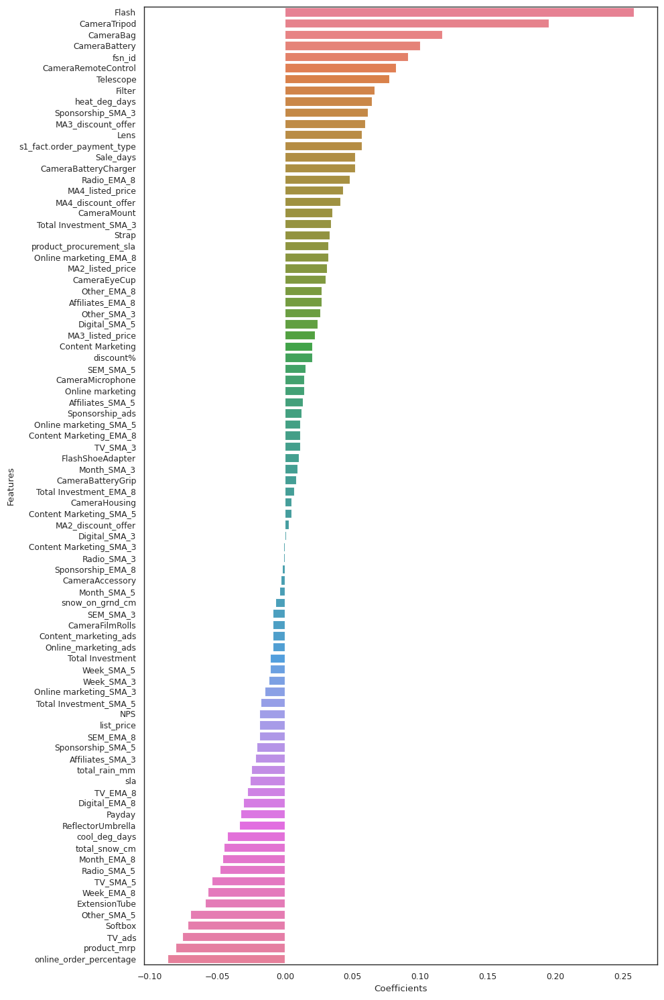

In [1032]:
# Slightly alter the figure size to make it more horizontal.
plt.figure(figsize=(10, 15), dpi=100, facecolor='w', edgecolor='k', frameon='True')
sns.barplot(y='Features', x='Coefficients', palette='husl', data=cameraaccessory_lr_coef_df, estimator=np.sum)
# Automatically adjust subplot params so that the subplotS fits in to the figure area.
plt.tight_layout()

# display the plot
plt.show()

##### The 5 most important features affecting GMV(Revenue) for cameraaccessory are:



|Features|Coefficients|
|--------|------------|
|CameraRemoteContro  0.071
10	Lens	0.069
48	Sponsorship_SMA_3	0.066
16	Filter	0.063
7	s1_fact.order_payment_type	0.063
67	Radio_EMA_8	0.057


## Building Linear Regression model for `gamingaccessory`

In [1033]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

gamingaccessory_model = LinearRegression().fit(X_gamingaccessory_train, y_gamingaccessory_train)
y_gamingaccessory_test_pred = gamingaccessory_model.predict(X_gamingaccessory_test)

print('R2 Score: {}'.format(r2_score(y_gamingaccessory_test, y_gamingaccessory_test_pred)))
print('Mean Squared Error: {}'.format(mean_squared_error(y_gamingaccessory_test, y_gamingaccessory_test_pred)))

R2 Score: 0.9741617789464421
Mean Squared Error: 0.038515461876759305


##### With Simple Linear Regression, we get a r2 score of 0.94 and mse of 0.088

## Building Linear Regression model for `gamingaccessory` using K-fold Cross Validation

In [1034]:
y_gamingaccessory = gaming_week.pop('gmv')
X_gamingaccessory = gaming_week

In [1035]:
# Make cross validated predictions
from sklearn.model_selection import cross_val_score,cross_val_predict
from sklearn import metrics

gamingaccessory_model_cv = LinearRegression().fit(X_gamingaccessory, y_gamingaccessory)
gamingaccessory_predictions_cv = cross_val_predict(gamingaccessory_model_cv, X_gamingaccessory, y_gamingaccessory, cv=10)
accuracy = metrics.r2_score(y_gamingaccessory, gamingaccessory_predictions_cv)
print("Cross-Predicted Accuracy:", accuracy)
print('Mean Squared Error: {}'.format(mean_squared_error(y_gamingaccessory, gamingaccessory_predictions_cv)))

Cross-Predicted Accuracy: 0.8492619322742521
Mean Squared Error: 0.15073806772574788


## Determining Feature Importance for `gamingaccessory` from model without cv

In [1036]:
# linear regression model parameters
#Limiting floats output to 3 decimal points
pd.set_option('display.float_format', lambda x: '{:.3f}'.format(x)) 
pd.set_option('display.precision',1)


gamingaccessory_lr_model_parameters = list(gamingaccessory_model.coef_)
gamingaccessory_lr_model_parameters.insert(0, gamingaccessory_model.intercept_)
gamingaccessory_lr_model_parameters = [round(x, 3) for x in gamingaccessory_lr_model_parameters]
cols = X_gamingaccessory_test.columns
cols = cols.insert(0, "constant")
gamingaccessory_lr_coef = list(zip(cols, gamingaccessory_lr_model_parameters))
gamingaccessory_lr_coef

[('constant', 0.019),
 ('list_price', 0.035),
 ('product_mrp', -0.04),
 ('discount%', 0.091),
 ('sla', -0.063),
 ('product_procurement_sla', 0.006),
 ('fsn_id', 0.047),
 ('s1_fact.order_payment_type', 0.154),
 ('GamePad', 0.017),
 ('GamingAccessoryKit', 0.214),
 ('GamingHeadset', 0.299),
 ('GamingMemoryCard', 0.03),
 ('MotionController', 0.014),
 ('GamingMouse', 0.2),
 ('GamingAdapter', 0.138),
 ('TVOutCableAccessory', 0.007),
 ('GamingGun', 0.0),
 ('JoystickGamingWheel', -0.015),
 ('GamingMousePad', 0.0),
 ('GamingKeyboard', 0.133),
 ('GamingSpeaker', 0.044),
 ('CoolingPad', -0.092),
 ('GamingChargingStation', 0.06),
 ('GameControlMount', 0.0),
 ('Month_SMA_3', 0.026),
 ('Month_SMA_5', -0.026),
 ('Month_EMA_8', 0.041),
 ('Week_SMA_3', 0.033),
 ('Week_SMA_5', -0.021),
 ('Week_EMA_8', 0.036),
 ('Total Investment', 0.027),
 ('Total Investment_SMA_3', 0.032),
 ('Total Investment_SMA_5', -0.016),
 ('Total Investment_EMA_8', -0.022),
 ('TV_SMA_3', 0.071),
 ('TV_SMA_5', -0.031),
 ('TV_EMA_8'

In [1037]:
gamingaccessory_lr_coef_df = pd.DataFrame(gamingaccessory_lr_coef)
col_rename = {0:'Features',1: 'Coefficients'}
gamingaccessory_lr_coef_df = gamingaccessory_lr_coef_df.rename(columns=col_rename)
gamingaccessory_lr_coef_df = gamingaccessory_lr_coef_df.iloc[1:,:]
gamingaccessory_lr_coef_df = gamingaccessory_lr_coef_df.loc[gamingaccessory_lr_coef_df['Coefficients']!=0.0]
gamingaccessory_lr_coef_df = gamingaccessory_lr_coef_df.sort_values(by=['Coefficients'], ascending = False)
gamingaccessory_lr_coef_df

,Features,Coefficients
10,GamingHeadset,0.299
9,GamingAccessoryKit,0.214
13,GamingMouse,0.200
7,s1_fact.order_payment_type,0.154
14,GamingAdapter,0.138
19,GamingKeyboard,0.133
78,MA2_listed_price,0.118
82,MA3_discount,0.111
80,MA4_listed_price,0.098
3,discount%,0.091


In [1038]:
## Plotting the Features in descending order of Importance for `gamingaccessory`

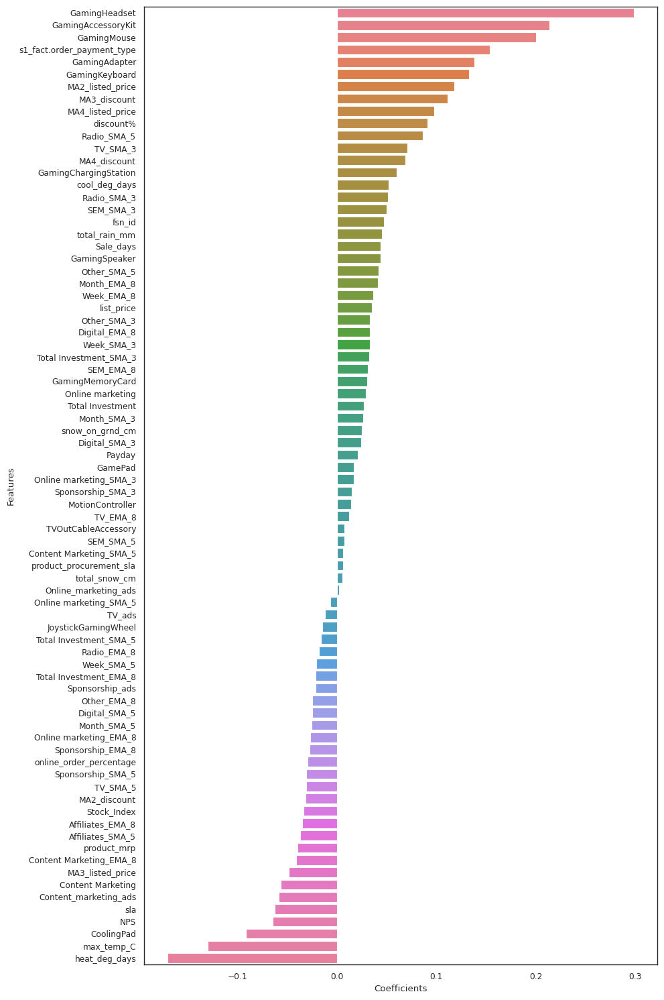

In [1039]:
# Slightly alter the figure size to make it more horizontal.
plt.figure(figsize=(10, 15), dpi=100, facecolor='w', edgecolor='k', frameon='True')
sns.barplot(y='Features', x='Coefficients', palette='husl', data=gamingaccessory_lr_coef_df, estimator=np.sum)
# Automatically adjust subplot params so that the subplotS fits in to the figure area.
plt.tight_layout()

# display the plot
plt.show()

##### The 5 most important features affecting GMV(Revenue) for gamingaccessory are:

|Features|Coefficients|
|--------|------------|
|product_vertical_gamepad	|0.201|
|product_vertical_gamingheadset|	0.183|
|is_mass_market|	0.167|
|product_vertical_gamingaccessorykit	|0.126|
|product_vertical_gamingmouse	|0.107|

## Building Linear Regression model for `homeaudio`

In [1040]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

homeaudio_model = LinearRegression().fit(X_homeaudio_train, y_homeaudio_train)
y_homeaudio_test_pred = homeaudio_model.predict(X_homeaudio_test)

print('R2 Score: {}'.format(r2_score(y_homeaudio_test, y_homeaudio_test_pred)))
print('Mean Squared Error: {}'.format(mean_squared_error(y_homeaudio_test, y_homeaudio_test_pred)))

R2 Score: 0.9475167143467809
Mean Squared Error: 0.09230891968242588


##### With Simple Linear Regression, we get a r2 score of 0.98 and mse of 0.03

## Building Linear Regression model for `homeaudio` using K-fold Cross Validation

In [1041]:
y_homeaudio = home_audio_week.pop('gmv')
X_homeaudio = home_audio_week

In [1042]:
# Make cross validated predictions
from sklearn.model_selection import cross_val_score,cross_val_predict
from sklearn import metrics

homeaudio_model_cv = LinearRegression().fit(X_homeaudio, y_homeaudio)
homeaudio_predictions_cv = cross_val_predict(homeaudio_model_cv, X_homeaudio, y_homeaudio, cv=5)
accuracy = metrics.r2_score(y_homeaudio, homeaudio_predictions_cv)
print("Cross-Predicted Accuracy:", accuracy)
print('Mean Squared Error: {}'.format(mean_squared_error(y_homeaudio, homeaudio_predictions_cv)))

Cross-Predicted Accuracy: 0.8180034835699024
Mean Squared Error: 0.18199651643009757


In [1043]:
##### With Simple Linear Regression, using cross validation, we get a r2 score of 0.93 and mse score of 0.65

## Determining Feature Importance for `homeaudio` from model without cv

In [1044]:
# linear regression model parameters
#Limiting floats output to 3 decimal points
pd.set_option('display.float_format', lambda x: '{:.3f}'.format(x)) 
pd.set_option('display.precision',1)


homeaudio_lr_model_parameters = list(homeaudio_model.coef_)
homeaudio_lr_model_parameters.insert(0, homeaudio_model.intercept_)
homeaudio_lr_model_parameters = [round(x, 3) for x in homeaudio_lr_model_parameters]
cols = X_homeaudio_test.columns
cols = cols.insert(0, "constant")
homeaudio_lr_coef = list(zip(cols, homeaudio_lr_model_parameters))
homeaudio_lr_coef

[('constant', 0.0),
 ('list_price', 0.099),
 ('product_mrp', 0.152),
 ('discount%', 0.167),
 ('sla', -0.029),
 ('product_procurement_sla', -0.159),
 ('fsn_id', 0.123),
 ('s1_fact.order_payment_type', 0.099),
 ('HomeAudioSpeaker', 0.282),
 ('Dock', 0.037),
 ('BoomBox', 0.055),
 ('DockingStation', -0.074),
 ('DJController', -0.012),
 ('FMRadio', 0.197),
 ('HiFiSystem', 0.024),
 ('VoiceRecorder', 0.097),
 ('KaraokePlayer', 0.0),
 ('SlingBox', 0.043),
 ('SoundMixer', 0.074),
 ('Month_SMA_3', -0.019),
 ('Month_SMA_5', 0.005),
 ('Month_EMA_8', 0.017),
 ('Week_SMA_3', -0.026),
 ('Week_SMA_5', 0.001),
 ('Week_EMA_8', 0.005),
 ('Total Investment', -0.056),
 ('Total Investment_SMA_3', -0.001),
 ('Total Investment_SMA_5', 0.004),
 ('Total Investment_EMA_8', 0.002),
 ('TV_SMA_3', -0.031),
 ('TV_SMA_5', 0.009),
 ('TV_EMA_8', -0.001),
 ('Digital_SMA_3', 0.015),
 ('Digital_SMA_5', 0.011),
 ('Digital_EMA_8', -0.019),
 ('Sponsorship_SMA_3', 0.005),
 ('Sponsorship_SMA_5', 0.001),
 ('Sponsorship_EMA_8', 

In [1045]:
homeaudio_lr_coef_df = pd.DataFrame(homeaudio_lr_coef)
col_rename = {0:'Features',1: 'Coefficients'}
homeaudio_lr_coef_df = homeaudio_lr_coef_df.rename(columns=col_rename)
homeaudio_lr_coef_df = homeaudio_lr_coef_df.iloc[1:,:]
homeaudio_lr_coef_df = homeaudio_lr_coef_df.loc[homeaudio_lr_coef_df['Coefficients']!=0.0]
homeaudio_lr_coef_df = homeaudio_lr_coef_df.sort_values(by=['Coefficients'], ascending = False)
homeaudio_lr_coef_df

,Features,Coefficients
8,HomeAudioSpeaker,0.282
13,FMRadio,0.197
3,discount%,0.167
2,product_mrp,0.152
6,fsn_id,0.123
1,list_price,0.099
7,s1_fact.order_payment_type,0.099
15,VoiceRecorder,0.097
74,MA4_listed_price,0.090
18,SoundMixer,0.074


## Plotting the Features in descending order of Importance for `homeaudio`

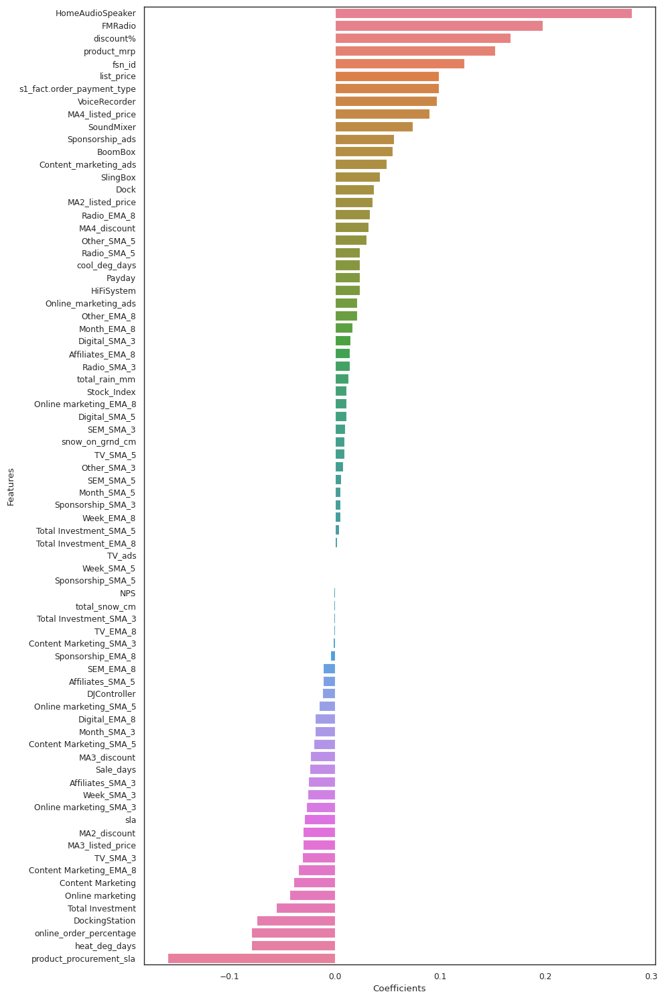

In [1046]:
# Slightly alter the figure size to make it more horizontal.
plt.figure(figsize=(10, 15), dpi=100, facecolor='w', edgecolor='k', frameon='True')
sns.barplot(y='Features', x='Coefficients', palette='husl', data=homeaudio_lr_coef_df, estimator=np.sum)
# Automatically adjust subplot params so that the subplotS fits in to the figure area.
plt.tight_layout()

# display the plot
plt.show()

##### The 5 most important features affecting GMV(Revenue) for homeaudio are:

|Features|Coefficients|
|--------|------------|
|product_vertical_homeaudiospeaker|	0.392|
|is_mass_market	|0.148|
|Digital_SMA_3	|0.139|
|product_vertical_fmradio	|0.133|
|is_cod	|0.131|

## Multiplicative Model

In [1047]:
camera_week.head()

,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,premium_product,CameraTripod,Lens,CameraBag,Flash,CameraBattery,CameraBatteryCharger,CameraRemoteControl,Filter,Strap,CameraBatteryGrip,CameraAccessory,CameraFilmRolls,CameraMount,ExtensionTube,Telescope,CameraEyeCup,CameraLEDLight,CameraMicrophone,Softbox,CameraHousing,FlashShoeAdapter,ReflectorUmbrella,Teleconverter,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount_offer,MA3_discount_offer,MA4_discount_offer
20,-0.348,-0.588,0.004,-0.388,0.692,0.294,-0.210,0.000,0.411,0.266,-0.166,1.513,-0.354,-0.143,-0.318,-0.048,-0.265,-0.242,0.547,-0.165,0.142,-0.050,-0.151,-0.297,0.000,-0.486,-0.361,-0.394,-0.200,-0.189,0.000,-1.743,-1.643,0.161,-1.640,-1.557,0.068,-1.077,-1.551,-1.613,-1.482,-1.360,-1.421,-1.540,-0.804,-0.891,0.109,-1.196,-1.284,-1.220,-0.685,-0.779,-0.888,-1.103,-1.679,-1.847,-1.830,-1.745,-1.895,-1.852,-1.713,-1.010,-1.103,-0.444,-0.559,-0.643,-0.778,-0.540,-0.623,-0.757,-1.271,-0.954,-0.728,-1.752,-0.599,-1.378,-0.524,-0.921,1.506,-0.572,1.222,2.688,-0.188,-0.583,-0.748,-0.824,-1.038,0.439,0.285,0.442
21,0.025,-0.225,-0.033,0.522,-0.052,0.121,-0.400,0.000,0.010,-0.318,-0.321,0.247,-0.736,-0.359,-0.528,0.020,0.361,-0.242,0.329,0.295,-0.386,0.599,-0.965,0.089,0.000,-0.486,-0.361,-0.394,-0.200,-0.189,0.000,-1.743,-1.643,0.161,-1.640,-1.557,0.086,-1.077,-1.551,-1.613,-1.482,-1.360,-1.421,-1.540,-0.804,-0.891,0.109,-1.196,-1.284,-1.220,-0.685,-0.779,-0.888,-1.103,-1.679,-1.847,-1.830,-1.745,-1.895,-1.852,-1.713,-1.010,-1.103,-0.444,-0.559,-0.643,-0.778,-0.540,-0.623,-0.757,-1.242,-0.851,-0.728,-1.695,-0.599,-1.378,-0.524,1.041,1.978,-0.572,0.022,-0.263,6.459,-0.503,0.283,-0.086,-0.211,-0.015,0.219,0.154
23,-0.165,-0.817,-0.080,0.251,0.183,0.472,-0.084,0.000,-0.408,0.171,0.029,1.285,-0.301,0.209,-0.465,0.314,0.595,-0.242,0.329,0.421,0.054,0.599,-0.151,-0.297,0.000,-0.486,-0.361,-0.394,-0.200,-0.189,0.000,0.221,-1.643,0.161,0.201,-1.557,0.117,-1.077,-1.132,-1.613,-1.482,-1.272,-1.421,-1.540,0.131,-0.891,0.109,-0.871,-1.284,-1.220,-0.685,-0.779,-0.888,-1.103,-1.679,-1.677,-1.830,-1.745,-1.667,-1.852,-1.713,-0.261,-1.103,-0.444,-0.559,-0.643,-0.778,-0.540,-0.623,-0.757,-1.242,-0.851,-0.728,-1.695,-0.599,-1.378,1.377,-0.921,-0.012,0.030,-0.355,-0.177,-0.127,-0.404,-0.518,-0.395,-0.224,0.483,0.257,0.142
24,0.661,-0.438,-0.707,0.562,-0.073,0.369,-0.483,0.000,-0.539,-0.014,0.446,-0.388,-0.271,-0.388,-0.758,-0.097,-0.030,-0.242,0.402,-0.123,-0.034,0.599,-0.660,-0.683,0.000,-0.486,-0.361,-0.394,-0.200,-0.189,0.000,0.221,-1.643,0.161,0.265,-1.557,0.159,-1.077,-1.132,-1.613,-1.482,-1.272,-1.421,-1.540,0.131,-0.891,0.109,-0.871,-1.284,-1.220,-0.685,-0.779,-0.888,-1.103,-1.679,-1.677,-1.830,-1.745,-1.667,-1.852,-1.713,-0.261,-1.103,-0.444,-0.559,-0.643,-0.778,-0.540,-0.623,-0.757,-1.242,-0.851,-0.728,-1.695,-0.599,-1.378,-0.524,-0.921,0.572,-0.171,-0.355,-0.177,-0.127,-0.495,0.604,0.487,0.541,-0.432,-0.293,-0.435
25,-0.543,-0.634,0.245,0.161,0.299,0.602,-0.082,0.000,-0.054,0.090,0.320,1.323,0.871,-0.251,-0.570,0.344,0.595,-0.242,0.838,0.086,0.670,1.247,-0.049,-0.297,0.000,-0.486,-0.361,-0.394,-0.200,-0.189,0.000,0.315,0.340,0.239,0.328,0.326

In [1048]:
# Making copy of dataframes from the original ones
cameraaccessory_mul_df = camera_week_df.copy()
gamingaccessory_mul_df = gaming_week_df.copy()
homeaudio_mul_df = home_audio_week_df.copy()
homeaudio_mul_df.head()

,Week,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,HomeAudioSpeaker,Dock,BoomBox,DockingStation,DJController,FMRadio,HiFiSystem,VoiceRecorder,KaraokePlayer,SlingBox,SoundMixer,Year,Month,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,Date,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
20,28,6608403.000,2002.174,4250.826,0.447,4.819,2.826,277,442,2701.000,35,28,3,0,453.000,22,53,0,0,0,2015.000,7.000,0.000,0.000,7.000,0.000,0.000,28.000,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.054,1.854,0.000,0.332,47.093,1052.000,0.000,0.000,10.950,1.116,4.848,1.117,0.165,13.414,0.016,-0.015,-0.003,0.114,0.073,0.090
21,29,4453585.000,1984.649,3836.581,0.392,5.479,2.795,278,387,1669.000,46,34,8,1,417.000,14,50,0,0,0,2015.000,7.000,0.000,0.000,7.000,0.000,0.000,28.222,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.143,12.578,1.116,2.562,0.117,4.593,17.285,-0.004,0.005,-0.018,-0.066,-0.016,-0.046
23,30,5550427.500,1928.914,3808.947,0.417,5.535,2.499,288,583,2198.000,56,23,14,0,482.000,18,73,0,0,0,2015.000,7.000,7.000,0.000,7.000,29.000,0.000,28.617,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.429,0.000,5.712,1.953,1.846,0.146,0.206,20.356,0.022,0.005,-0.006,0.102,0.089,0.045
24,31,4160893.000,1912.447,3563.507,0.382,5.688,2.655,273,380,1518.000,26,26,12,1,499.000,17,68,0,0,0,2015.000,7.000,7.000,0.000,7.000,30.000,0.000,29.147,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.000,7.725,1.674,1.846,0.146,0.206,17.536,-0.004,0.009,-0.003,-0.044,0.006,-0.002
25,32,6607912.000,2025.304,4077.258,0.428,4.892,2.758,289,506,2532.000,28,37,4,0,564.000,18,75,0,0,0,2015.000,8.000,7.333,7.200,7.222,31.000,30.000,29.781,1.013,3.181,3.615,3.542,0.036,0.043,0.042,0.507,0.558,0.549,1.307,1.526,1.489,0.000,0.000,0.000,0.000,0.026,0.230,0.271,0.264,0.096,0.113,0.110,1.005,1.105,1.089,0.000,0.000,0.000,0.000,0.000,0.000,2015-08-01 00:00:00,0.028,1.140,0.000,0.192,50.327,1222.000,0.286,0.143,9.607,1.116,2.622,0.088,0.124,15.531,0.029,0.036,0.050,0.057,0.046,0.093


In [1049]:
# removing columns
cameraaccessory_mul_df = cameraaccessory_mul_df.drop('Week', axis=1)
gamingaccessory_mul_df = gamingaccessory_mul_df.drop('Week', axis=1)
homeaudio_mul_df = homeaudio_mul_df.drop('Week', axis=1)
homeaudio_mul_df.head()

,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,HomeAudioSpeaker,Dock,BoomBox,DockingStation,DJController,FMRadio,HiFiSystem,VoiceRecorder,KaraokePlayer,SlingBox,SoundMixer,Year,Month,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,Date,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
20,6608403.000,2002.174,4250.826,0.447,4.819,2.826,277,442,2701.000,35,28,3,0,453.000,22,53,0,0,0,2015.000,7.000,0.000,0.000,7.000,0.000,0.000,28.000,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.054,1.854,0.000,0.332,47.093,1052.000,0.000,0.000,10.950,1.116,4.848,1.117,0.165,13.414,0.016,-0.015,-0.003,0.114,0.073,0.090
21,4453585.000,1984.649,3836.581,0.392,5.479,2.795,278,387,1669.000,46,34,8,1,417.000,14,50,0,0,0,2015.000,7.000,0.000,0.000,7.000,0.000,0.000,28.222,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.143,12.578,1.116,2.562,0.117,4.593,17.285,-0.004,0.005,-0.018,-0.066,-0.016,-0.046
23,5550427.500,1928.914,3808.947,0.417,5.535,2.499,288,583,2198.000,56,23,14,0,482.000,18,73,0,0,0,2015.000,7.000,7.000,0.000,7.000,29.000,0.000,28.617,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.429,0.000,5.712,1.953,1.846,0.146,0.206,20.356,0.022,0.005,-0.006,0.102,0.089,0.045
24,4160893.000,1912.447,3563.507,0.382,5.688,2.655,273,380,1518.000,26,26,12,1,499.000,17,68,0,0,0,2015.000,7.000,7.000,0.000,7.000,30.000,0.000,29.147,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.000,7.725,1.674,1.846,0.146,0.206,17.536,-0.004,0.009,-0.003,-0.044,0.006,-0.002
25,6607912.000,2025.304,4077.258,0.428,4.892,2.758,289,506,2532.000,28,37,4,0,564.000,18,75,0,0,0,2015.000,8.000,7.333,7.200,7.222,31.000,30.000,29.781,1.013,3.181,3.615,3.542,0.036,0.043,0.042,0.507,0.558,0.549,1.307,1.526,1.489,0.000,0.000,0.000,0.000,0.026,0.230,0.271,0.264,0.096,0.113,0.110,1.005,1.105,1.089,0.000,0.000,0.000,0.000,0.000,0.000,2015-08-01 00:00:00,0.028,1.140,0.000,0.192,50.327,1222.000,0.286,0.143,9.607,1.116,2.622,0.088,0.124,15.531,0.029,0.036,0.050,0.057,0.046,0.093


In [1050]:
cameraaccessory_mul_df = cameraaccessory_mul_df.drop(['Date','Year','Month'], axis=1)
gamingaccessory_mul_df = gamingaccessory_mul_df.drop(['Date','Year','Month'], axis=1)
homeaudio_mul_df = homeaudio_mul_df.drop(['Date','Year','Month'], axis=1)
homeaudio_mul_df.head()

,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,HomeAudioSpeaker,Dock,BoomBox,DockingStation,DJController,FMRadio,HiFiSystem,VoiceRecorder,KaraokePlayer,SlingBox,SoundMixer,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
20,6608403.000,2002.174,4250.826,0.447,4.819,2.826,277,442,2701.000,35,28,3,0,453.000,22,53,0,0,0,0.000,0.000,7.000,0.000,0.000,28.000,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.054,1.854,0.000,0.332,47.093,1052.000,0.000,0.000,10.950,1.116,4.848,1.117,0.165,13.414,0.016,-0.015,-0.003,0.114,0.073,0.090
21,4453585.000,1984.649,3836.581,0.392,5.479,2.795,278,387,1669.000,46,34,8,1,417.000,14,50,0,0,0,0.000,0.000,7.000,0.000,0.000,28.222,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.143,12.578,1.116,2.562,0.117,4.593,17.285,-0.004,0.005,-0.018,-0.066,-0.016,-0.046
23,5550427.500,1928.914,3808.947,0.417,5.535,2.499,288,583,2198.000,56,23,14,0,482.000,18,73,0,0,0,7.000,0.000,7.000,29.000,0.000,28.617,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.081,2.781,0.000,0.498,47.093,1052.000,0.429,0.000,5.712,1.953,1.846,0.146,0.206,20.356,0.022,0.005,-0.006,0.102,0.089,0.045
24,4160893.000,1912.447,3563.507,0.382,5.688,2.655,273,380,1518.000,26,26,12,1,499.000,17,68,0,0,0,7.000,0.000,7.000,30.000,0.000,29.147,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.000,7.725,1.674,1.846,0.146,0.206,17.536,-0.004,0.009,-0.003,-0.044,0.006,-0.002
25,6607912.000,2025.304,4077.258,0.428,4.892,2.758,289,506,2532.000,28,37,4,0,564.000,18,75,0,0,0,7.333,7.200,7.222,31.000,30.000,29.781,1.013,3.181,3.615,3.542,0.036,0.043,0.042,0.507,0.558,0.549,1.307,1.526,1.489,0.000,0.000,0.000,0.000,0.026,0.230,0.271,0.264,0.096,0.113,0.110,1.005,1.105,1.089,0.000,0.000,0.000,0.000,0.000,0.000,0.028,1.140,0.000,0.192,50.327,1222.000,0.286,0.143,9.607,1.116,2.622,0.088,0.124,15.531,0.029,0.036,0.050,0.057,0.046,0.093


In [1051]:
cameraaccessory_mul_df.head()

,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,premium_product,CameraTripod,Lens,CameraBag,Flash,CameraBattery,CameraBatteryCharger,CameraRemoteControl,Filter,Strap,CameraBatteryGrip,CameraAccessory,CameraFilmRolls,CameraMount,ExtensionTube,Telescope,CameraEyeCup,CameraLEDLight,CameraMicrophone,Softbox,CameraHousing,FlashShoeAdapter,ReflectorUmbrella,Teleconverter,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount_offer,MA3_discount_offer,MA4_discount_offer
20,2178725.000,455.569,1075.559,0.513,5.874,2.751,626,793,0,775.000,469.000,211.000,1987.000,496.000,232.000,83.000,175.000,24,0,42,26,15,1,15,1,0,0,0,0,0,0,0,0.000,0.000,7.000,0.000,0.000,28.000,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.054,1.854,0.000,0.332,47.093,1052.000,0.000,0.000,10.950,1.116,4.848,1.117,0.165,16.815,-0.067,-0.080,-0.107,0.047,0.034,0.055
21,1615463.000,480.423,1132.643,0.511,6.639,2.476,594,622,0,604.000,346.000,195.000,1055.000,395.000,202.000,73.000,182.000,32,0,39,37,9,2,7,2,0,0,0,0,0,0,0,0.000,0.000,7.000,0.000,0.000,28.222,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.143,12.578,1.116,2.562,0.117,4.593,18.718,0.027,-0.011,-0.022,-0.003,0.027,0.021
23,2035389.500,467.726,1039.439,0.507,6.411,2.563,659,906,0,426.000,449.000,231.000,1819.000,510.000,281.000,76.000,212.000,35,0,39,40,14,2,15,1,0,0,0,0,0,0,0,7.000,0.000,7.000,29.000,0.000,28.617,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.081,2.781,0.000,0.498,47.093,1052.000,0.429,0.000,5.712,1.953,1.846,0.146,0.206,21.075,-0.046,-0.040,-0.024,0.051,0.031,0.020
24,1529971.000,522.751,1099.183,0.461,6.673,2.468,640,547,0,370.000,410.000,274.000,587.000,518.000,198.000,62.000,170.000,27,0,40,27,13,2,10,0,0,0,0,0,0,0,0,7.000,0.000,7.000,30.000,0.000,29.147,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.000,7.725,1.674,1.846,0.146,0.206,18.901,0.056,0.043,0.054,-0.048,-0.030,-0.048
25,2161258.000,442.547,1068.245,0.531,6.335,2.606,683,908,0,577.000,432.000,261.000,1847.000,820.000,217.000,71.000,215.000,35,0,46,32,21,3,16,1,0,0,0,0,0,0,0,7.333,7.200,7.222,31.000,30.000,29.781,1.013,3.181,3.615,3.542,0.036,0.043,0.042,0.507,0.558,0.549,1.307,1.526,1.489,0.000,0.000,0.000,0.000,0.026,0.230,0.271,0.264,0.096,0.113,0.110,1.005,1.105,1.089,0.000,0.000,0.000,0.000,0.000,0.000,0.028,1.140,0.000,0.192,50.327,1222.000,0.286,0.143,9.607,1.116,2.622,0.088,0.124,18.885,-0.083,-0.074,-0.090,0.071,0.063,0.086


In [1052]:
### Taking Logarithm of both the Dependent and the independent variables

##### After taking log, all 0 values will be transformed to `inf`. Retransforming these values to 0.

In [1053]:
cameraaccessory_mul_df = cameraaccessory_mul_df.applymap(lambda x: np.log(x))
cameraaccessory_mul_df = cameraaccessory_mul_df.replace([np.inf, -np.inf], 0)
cameraaccessory_mul_df = cameraaccessory_mul_df.replace(np.nan, 0)

gamingaccessory_mul_df = gamingaccessory_mul_df.applymap(lambda x: np.log(x))
gamingaccessory_mul_df = gamingaccessory_mul_df.replace([np.inf, -np.inf], 0)
gamingaccessory_mul_df = gamingaccessory_mul_df.replace(np.nan, 0)

homeaudio_mul_df = homeaudio_mul_df.applymap(lambda x: np.log(x))
homeaudio_mul_df = homeaudio_mul_df.replace([np.inf, -np.inf], 0)
homeaudio_mul_df = homeaudio_mul_df.replace(np.nan, 0)


homeaudio_mul_df.head()

,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,HomeAudioSpeaker,Dock,BoomBox,DockingStation,DJController,FMRadio,HiFiSystem,VoiceRecorder,KaraokePlayer,SlingBox,SoundMixer,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
20,15.704,7.602,8.355,-0.804,1.573,1.039,5.624,6.091,7.901,3.555,3.332,1.099,0.000,6.116,3.091,3.970,0.000,0.000,0.000,0.000,0.000,1.946,0.000,0.000,3.332,1.450,0.000,0.000,1.450,0.000,0.000,-2.919,0.000,0.000,-0.457,0.000,0.000,0.617,0.000,0.000,0.000,0.000,-1.103,0.000,0.000,-1.103,0.000,0.000,-1.988,0.000,0.000,0.228,0.000,0.000,0.000,0.000,0.000,0.000,-2.919,0.617,0.000,-1.103,3.852,6.958,0.000,0.000,2.393,0.110,1.579,0.111,-1.803,2.596,-4.137,0.000,0.000,-2.167,-2.618,-2.408
21,15.309,7.593,8.252,-0.937,1.701,1.028,5.628,5.958,7.420,3.829,3.526,2.079,0.000,6.033,2.639,3.912,0.000,0.000,0.000,0.000,0.000,1.946,0.000,0.000,3.340,1.450,0.000,0.000,1.450,0.000,0.000,-2.919,0.000,0.000,-0.457,0.000,0.000,0.617,0.000,0.000,0.000,0.000,-1.103,0.000,0.000,-1.103,0.000,0.000,-1.988,0.000,0.000,0.228,0.000,0.000,0.000,0.000,0.000,0.000,-2.513,1.023,0.000,-0.697,3.852,6.958,0.000,-1.946,2.532,0.110,0.941,-2.146,1.525,2.850,0.000,-5.358,0.000,0.000,0.000,0.000
23,15.529,7.565,8.245,-0.875,1.711,0.916,5.663,6.368,7.695,4.025,3.135,2.639,0.000,6.178,2.890,4.290,0.000,0.000,0.000,1.946,0.000,1.946,3.367,0.000,3.354,1.450,1.450,0.000,1.450,-2.919,0.000,-2.919,-0.457,0.000,-0.457,0.617,0.000,0.617,0.000,0.000,0.000,0.000,-1.103,-1.103,0.000,-1.103,-1.988,0.000,-1.988,0.228,0.000,0.228,0.000,0.000,0.000,0.000,0.000,0.000,-2.513,1.023,0.000,-0.697,3.852,6.958,-0.847,0.000,1.743,0.670,0.613,-1.923,-1.580,3.013,-3.812,-5.337,0.000,-2.278,-2.415,-3.097
24,15.241,7.556,8.179,-0.963,1.738,0.977,5.609,5.940,7.325,3.258,3.258,2.485,0.000,6.213,2.833,4.220,0.000,0.000,0.000,1.946,0.000,1.946,3.401,0.000,3.372,1.450,1.450,0.000,1.450,-2.919,0.000,-2.919,-0.457,0.000,-0.457,0.617,0.000,0.617,0.000,0.000,0.000,0.000,-1.103,-1.103,0.000,-1.103,-1.988,0.000,-1.988,0.228,0.000,0.228,0.000,0.000,0.000,0.000,0.000,0.000,-2.513,1.023,0.000,-0.697,3.852,6.958,0.000,0.000,2.044,0.515,0.613,-1.923,-1.580,2.864,0.000,-4.724,0.000,0.000,-5.123,0.000
25,15.704,7.613,8.313,-0.849,1.588,1.014,5.666,6.227,7.837,3.332,3.611,1.386,0.000,6.335,2.890,4.317,0.000,0.000,0.000,1.992,1.974,1.977,3.434,3.401,3.394,0.013,1.157,1.285,1.265,-3.315,-3.137,-3.165,-0.679,-0.584,-0.599,0.268,0.423,0.398,0.000,0.000,0.000,0.000,-3.650,-1.470,-1.306,-1.332,-2.340,-2.184,-2.208,0.005,0.100,0.085,0.000,0.000,0.000,0.000,0.000,0.000,-3.576,0.131,0.000,-1.650,3.919,7.108,-1.253,-1.946,2.262,0.110,0.964,-2.434,-2.091,2.743,-3.552,-3.334,-2.987,-2.865,-3.071,-2.379


In [1054]:
## Rescaling the Features of the 3 Dataframes
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

cameraaccessory_mul_df[cameraaccessory_mul_df.columns]=scaler.fit_transform(cameraaccessory_mul_df[cameraaccessory_mul_df.columns])
gamingaccessory_mul_df[gamingaccessory_mul_df.columns]=scaler.fit_transform(gamingaccessory_mul_df[gamingaccessory_mul_df.columns])
homeaudio_mul_df[homeaudio_mul_df.columns]=scaler.fit_transform(homeaudio_mul_df[homeaudio_mul_df.columns])

homeaudio_mul_df.head()

,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,HomeAudioSpeaker,Dock,BoomBox,DockingStation,DJController,FMRadio,HiFiSystem,VoiceRecorder,KaraokePlayer,SlingBox,SoundMixer,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
20,0.875,0.836,1.919,2.019,-0.843,1.130,0.227,-0.018,1.013,0.247,-0.426,-0.614,-0.144,0.029,0.274,0.239,0.000,0.000,-0.284,-2.252,-2.165,0.280,-2.850,-2.542,0.222,-0.921,-2.247,-2.176,-1.320,0.406,0.361,-1.691,1.078,1.013,0.360,-1.248,-1.521,-1.322,1.220,1.287,1.439,1.544,-1.091,-0.565,-0.761,-1.669,0.160,0.084,-1.665,-0.553,-0.650,-0.434,0.363,0.810,0.853,-0.323,-0.128,-0.365,-1.133,-0.957,1.097,-1.395,-0.560,-1.314,0.485,0.939,0.966,-0.447,1.259,2.142,0.056,-1.132,-1.118,0.963,0.859,-0.631,-0.667,-0.926
21,0.292,0.713,1.104,0.684,-0.065,0.974,0.236,-0.236,0.338,0.515,-0.088,0.495,-0.144,-0.067,-0.452,0.163,0.000,0.000,-0.284,-2.252,-2.165,0.280,-2.850,-2.542,0.234,-0.921,-2.247,-2.176,-1.320,0.406,0.361,-1.691,1.078,1.013,0.360,-1.248,-1.521,-1.322,1.220,1.287,1.439,1.544,-1.091,-0.565,-0.761,-1.669,0.160,0.084,-1.665,-0.553,-0.650,-0.434,0.363,0.810,0.853,-0.323,-0.128,-0.365,-0.938,-0.639,1.097,-1.141,-0.560,-1.314,0.485,-1.077,1.114,-0.447,0.328,0.042,3.177,-0.612,0.899,-1.332,0.859,0.713,0.764,0.650
23,0.617,0.315,1.046,1.309,-0.003,-0.610,0.324,0.435,0.724,0.707,-0.768,1.127,-0.144,0.101,-0.048,0.658,0.000,0.000,-0.284,0.374,-2.165,0.280,0.381,-2.542,0.256,-0.921,-0.896,-2.176,-1.320,-1.149,0.361,-1.691,0.507,1.013,0.360,-0.730,-1.521,-1.322,1.220,1.287,1.439,1.544,-1.091,-1.328,-0.761,-1.669,-1.400,0.084,-1.665,-0.185,-0.650,-0.434,0.363,0.810,0.853,-0.323,-0.128,-0.365,-0.938,-0.639,1.097,-1.141,-0.560,-1.314,-1.356,0.939,0.271,0.422,-0.151,0.250,0.265,-0.277,-0.960,-1.323,0.859,-0.700,-0.556,-1.377
24,0.191,0.195,0.517,0.419,0.161,0.247,0.191,-0.266,0.205,-0.044,-0.555,0.953,-0.144,0.141,-0.140,0.565,0.000,0.000,-0.284,0.374,-2.165,0.280,0.414,-2.542,0.284,-0.921,-0.896,-2.176,-1.320,-1.149,0.361,-1.691,0.507,1.013,0.360,-0.730,-1.521,-1.322,1.220,1.287,1.439,1.544,-1.091,-1.328,-0.761,-1.669,-1.400,0.084,-1.665,-0.185,-0.650,-0.434,0.363,0.810,0.853,-0.323,-0.128,-0.365,-0.938,-0.639,1.097,-1.141,-0.560,-1.314,0.485,0.939,0.594,0.182,-0.151,0.250,0.265,-0.582,0.899,-1.060,0.859,0.713,-2.036,0.650
25,0.875,0.996,1.587,1.564,-0.752,0.784,0.333,0.203,0.922,0.028,0.059,-0.289,-0.144,0.282,-0.048,0.694,0.000,0.000,-0.284,0.437,0.462,0.343,0.445,0.456,0.317,-2.273,-1.169,-1.001,-1.550,-1.360,-1.794,-1.876,0.230,0.221,0.118,-1.023,-1.112,-1.593,1.220,1.287,1.439,1.544,-2.627,-1.582,-1.850,-1.867,-1.676,-2.001,-1.875,-0.545,-0.478,-0.722,0.363,0.810,0.853,-0.323,-0.128,-0.365,-1.448,-1.339,1.097,-1.737,0.570,0.834,-2.236,-1.077,0.826,-0.447,0.362,-0.225,-0.214,-0.831,-0.833,-0.465,-0.554,-1.063,-0.914,-0.907


In [1055]:
## Splitting the 3 Dataframes into Training and Testing Sets

from sklearn.model_selection import train_test_split

# We specify this so that the train and test data set always have the same rows, respectively

cameraaccessory_mul_train, cameraaccessory_mul_test = train_test_split(cameraaccessory_mul_df, \
                                                               train_size = 0.7, test_size = 0.3, random_state = 100)

gamingaccessory_mul_train, gamingaccessory_mul_test = train_test_split(gamingaccessory_mul_df, \
                                                               train_size = 0.7, test_size = 0.3, random_state = 100)

homeaudio_mul_train, homeaudio_mul_test = train_test_split(homeaudio_mul_df, \
                                                               train_size = 0.7, test_size = 0.3, random_state = 100)

In [1056]:
## Dividing the 3 dataframes into X and Y sets for the model building
y_cameraaccessory_mul_train = cameraaccessory_mul_train.pop('gmv')
X_cameraaccessory_mul_train = cameraaccessory_mul_train

y_gamingaccessory_mul_train = gamingaccessory_mul_train.pop('gmv')
X_gamingaccessory_mul_train = gamingaccessory_mul_train

y_homeaudio_mul_train = homeaudio_mul_train.pop('gmv')
X_homeaudio_mul_train = homeaudio_mul_train

X_homeaudio_mul_train.head()

,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,HomeAudioSpeaker,Dock,BoomBox,DockingStation,DJController,FMRadio,HiFiSystem,VoiceRecorder,KaraokePlayer,SlingBox,SoundMixer,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
48,1.156,-0.109,-1.578,-2.330,-0.378,-1.107,-2.505,-1.763,-2.557,-0.306,0.170,-0.144,-1.647,-2.105,-1.104,0.000,0.000,-0.284,1.101,1.120,1.272,0.941,0.923,1.095,0.805,0.811,0.707,0.766,0.565,0.513,0.638,0.745,0.457,0.703,0.980,0.874,0.941,0.380,0.317,0.095,0.103,0.616,0.631,0.627,0.679,0.580,0.549,0.659,1.107,0.890,1.048,0.363,0.810,0.853,-0.323,-0.128,-0.365,0.609,0.958,0.431,0.628,0.633,0.502,0.485,0.939,-0.469,1.600,-0.194,-0.082,-0.069,-0.541,0.899,-0.922,-0.767,0.713,-2.251,0.650
10,0.578,1.756,1.783,-0.593,0.484,0.182,0.413,0.944,0.426,1.013,-0.289,-0.144,0.488,0.603,-0.463,0.000,0.000,-0.284,-0.173,-0.193,-0.766,-0.077,-0.045,-0.639,0.300,0.283,0.286,0.327,0.148,0.281,0.493,-1.097,-1.222,-1.232,0.292,0.240,0.240,0.047,-0.345,-0.943,-0.865,0.511,0.481,0.469,0.564,0.414,0.403,0.559,-0.163,-0.357,-0.481,0.170,-1.368,-1.197,-0.976,-1.543,-0.257,-0.157,0.326,0.050,0.520,-0.594,0.963,-2.236,0.939,0.027,-1.522,-0.058,-0.603,-0.594,-0.665,-0.648,-0.223,-0.438,-0.700,-0.316,-0.785
39,-0.476,-0.606,0.001,-0.394,-0.691,0.384,-0.387,-0.128,-0.405,-1.012,0.953,-0.144,0.103,0.274,0.728,0.000,0.000,-0.284,0.900,0.926,0.957,0.781,0.773,0.827,-0.096,0.973,1.103,0.999,0.548,0.591,0.587,2.057,2.296,2.054,1.031,1.246,1.180,-0.930,0.894,1.116,0.762,0.397,0.598,0.684,0.596,0.530,0.566,0.538,2.250,2.600,2.148,0.363,0.810,0.853,-0.323,-0.128,-0.365,0.500,0.596,0.539,0.508,-0.483,0.904,0.485,0.939,0.319,-1.522,0.158,-0.603,-0.594,-0.386,-2.080,0.963,0.859,0.713,-1.327,-1.717
28,0.096,0.065,0.089,0.245,-0.366,0.341,-0.090,0.412,0.159,-0.489,0.747,-0.144,0.188,0.876,0.745,0.000,0.000,-0.284,0.554,0.569,0.454,0.534,0.540,0.432,-2.273,-2.234,-1.711,-2.138,-3.274,-2.700,-2.422,-0.625,-0.484,-0.448,-2.548,-2.115,-2.343,1.220,1.287,1.439,1.544,-2.627,-3.091,-2.794,-2.424,-3.136,-3.003,-2.457,-1.664,-1.383,-1.397,0.363,0.810,0.853,-0.323,-0.128,-0.365,-2.855,-2.337,1.097,-2.733,0.570,0.834,0.485,0.939,0.804,-0.100,1.437,2.042,1.805,-0.621,0.899,0.963,0.859,0.713,0.764,0.650
22,-0.303,-0.579,-0.756,1.513,0.291,-0.279,0.254,0.256,0.596,0.871,-1.855,-0.144,0.330,0.603,-0.596,0.000,0.000,-0.284,-2.252,0.080,-0.054,-2.185,0.190,0.014,0.462,0.472,0.642,0.631,0.454,0.484,0.602,-1.635,-0.317,-0.320,-1.207,0.259,0.128,0.271,0.192,0.177,0.072,0.626,0.643,0.688,0.733,0.640,0.638,0.742,-0.475,0.312,0.279,0.324,0.000,-0.171,2.734,2.030,2.322,0.509,-1.085,0.307,0.639,1.956,0.296,-2.236,-1.077,-1.807,1.791,-0.388,-1.248,-1.244,-0.078,0.899,0.963,0.859,0.713,0.764,0.650


In [1057]:
## Dividing into X and Y test sets for the model building for 3 dataframes

In [1058]:
y_cameraaccessory_mul_test = cameraaccessory_mul_test.pop('gmv')
X_cameraaccessory_mul_test = cameraaccessory_mul_test

y_gamingaccessory_mul_test = gamingaccessory_mul_test.pop('gmv')
X_gamingaccessory_mul_test = gamingaccessory_mul_test

y_homeaudio_mul_test = homeaudio_mul_test.pop('gmv')
X_homeaudio_mul_test = homeaudio_mul_test

X_homeaudio_mul_test.head()

,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,HomeAudioSpeaker,Dock,BoomBox,DockingStation,DJController,FMRadio,HiFiSystem,VoiceRecorder,KaraokePlayer,SlingBox,SoundMixer,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
27,0.678,1.330,1.611,-0.562,-0.680,0.555,0.427,0.902,0.616,-0.194,-0.289,-0.144,0.247,-0.341,0.711,0.000,0.000,-0.284,0.554,0.534,0.427,0.505,0.513,0.392,-2.273,-2.234,-1.409,-1.960,-3.274,-2.255,-2.242,-0.625,-0.206,-0.285,-2.548,-1.656,-2.106,1.220,1.287,1.439,1.544,-2.627,-3.091,-2.351,-2.245,-3.136,-2.543,-2.272,-1.664,-1.026,-1.203,0.363,0.810,0.853,-0.323,-0.128,-0.365,-2.855,-2.337,1.097,-2.733,0.570,0.834,-1.356,-1.077,0.728,-0.447,-0.477,0.042,1.460,-0.528,-0.909,-1.086,-1.130,-1.122,-1.059,-1.227
42,1.198,0.376,0.015,-1.568,-0.710,0.079,-0.297,0.091,-1.481,-0.194,1.278,-0.144,-0.709,0.199,-0.342,0.000,0.000,-0.284,0.984,1.002,1.082,0.844,0.832,0.932,-0.096,-0.081,0.398,0.495,0.316,0.349,0.481,-0.629,0.769,1.034,-0.373,0.289,0.501,-0.930,-1.197,0.006,0.085,0.397,0.379,0.465,0.522,0.378,0.407,0.513,-0.484,0.881,1.094,0.363,0.810,0.853,-0.323,-0.128,-0.365,0.384,-0.306,-1.067,0.401,-0.483,0.904,-1.356,0.939,-1.807,1.781,-1.602,-1.248,-1.244,-0.180,-0.534,-0.128,-0.280,-1.301,-1.023,-1.676
7,-0.367,0.412,1.411,0.470,-1.726,0.555,2.262,2.100,1.666,2.363,-0.289,-0.144,1.263,1.831,0.163,0.000,0.000,-0.284,-0.381,-0.460,-1.114,-0.252,-0.216,-0.900,0.212,0.224,0.493,0.402,0.546,0.729,0.806,-0.825,-0.446,-0.715,0.268,0.466,0.297,-1.776,-2.173,-1.367,-1.312,0.429,0.416,0.459,0.537,0.437,0.455,0.589,-0.467,-0.406,-0.619,-3.341,-1.376,-1.588,-0.323,0.590,0.343,0.592,0.293,-2.034,0.435,-1.563,0.693,-1.356,-1.077,0.181,0.022,-0.687,-0.225,-0.214,0.012,-0.509,-0.196,-0.292,-0.742,-0.325,-0.578
2,-1.170,-0.485,0.046,0.074,1.076,-0.119,-0.219,-0.151,0.635,1.423,-0.614,-0.144,0.361,0.603,0.082,0.000,0.000,-0.284,-0.928,-1.000,-1.501,-0.641,-0.605,-1.230,0.743,0.536,0.346,0.427,0.696,0.509,0.719,0.155,-0.101,-0.281,0.468,0.139,0.125,-0.291,-0.392,-0.535,-0.525,0.496,0.460,0.442,0.570,0.461,0.403,0.597,-0.272,-0.480,-0.502,0.170,-1.376,-0.971,1.239,0.590,1.400,0.871,0.714,-0.336,0.504,-0.621,-0.661,0.485,0.939,-0.592,0.714,-0.530,-0.603,-0.594,0.066,0.899,0.963,0.859,-2.816,0.764,0.650
16,1.278,2.460,2.359,-0.667,1.531,0.060,0.117,0.889,0.378,-0.088,-0.289,-0.144,0.227,-0.048,-0.129,0.000,0.000,-0.284,0.089,0.080,-0.334,0.159,0.182,-0.245,-0.055,0.093,0.214,0.135,-0.126,-0.399,0.029,-0.477,-0.954,-1.153,0.297,0.260,0.206,-1.648,-0.780,-0.615,-0.985,-0.010,0.173,0.315,0.373,0.090,0.168,0.329,-0.424,-0.332,-0.592,0.101,-1.004,-1.373,-2.084,-0.919,-1.374,0.044,0.316,-1.888,-0.020,-1.034,-1.507,0.485,0.939,0.612,-0.893,-0.788,-0.225,-0.214,-0.869,-0.618,-0.188,-0.389,-0.863,-0.240,-0.434


## Building Linear Regression model for `cameraaccessory`

In [1059]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

cameraaccessory_mul_model = LinearRegression().fit(X_cameraaccessory_mul_train, y_cameraaccessory_mul_train)
y_cameraaccessory_mul_test_pred = cameraaccessory_mul_model.predict(X_cameraaccessory_mul_test)

print('R2 Score: {}'.format(r2_score(y_cameraaccessory_mul_test, y_cameraaccessory_mul_test_pred)))
print('Mean Squared Error: {}'.format(mean_squared_error(y_cameraaccessory_mul_test, y_cameraaccessory_mul_test_pred)))

R2 Score: 0.9805964197396178
Mean Squared Error: 0.024444896093715716


In [1060]:
##### With Simple Linear Regression, we get a r2 score of 0.98 and mse of 0.01

In [1061]:
## Building Linear Regression model for `cameraaccessory` using K-fold Cross Validation
#*We will use GridSearchCV method and 5 fold cross validation method for our linear regression.*


In [1062]:
y_cameraaccessory_mul = cameraaccessory_mul_df.pop('gmv')
X_cameraaccessory_mul = cameraaccessory_mul_df



In [1063]:
# Make cross validated predictions
from sklearn.model_selection import cross_val_score,cross_val_predict
from sklearn import metrics

cameraaccessory_mul_model_cv = LinearRegression().fit(X_cameraaccessory_mul, y_cameraaccessory_mul)
cameraaccessory_mul_predictions_cv = cross_val_predict(cameraaccessory_mul_model_cv, X_cameraaccessory_mul, \
                                                       y_cameraaccessory_mul, cv=10)
accuracy = metrics.r2_score(y_cameraaccessory_mul, cameraaccessory_mul_predictions_cv)
print("Cross-Predicted Accuracy:", accuracy)
print('Mean Squared Error: {}'.format(mean_squared_error(y_cameraaccessory_mul, cameraaccessory_mul_predictions_cv)))

Cross-Predicted Accuracy: 0.7956716102724027
Mean Squared Error: 0.20432838972759726


In [1064]:
##### With Simple Linear Regression, using cross validation, we get a r2 score of 0.86 and mse score of 0.13

In [1065]:
## Determining Feature Importance for `cameraaccessory` from model with cv

In [1066]:
# linear regression model parameters
#Limiting floats output to 3 decimal points
pd.set_option('display.float_format', lambda x: '{:.3f}'.format(x)) 
pd.set_option('display.precision',1)


cameraaccessory_mul_lr_model_parameters = list(cameraaccessory_mul_model_cv.coef_)
cameraaccessory_mul_lr_model_parameters.insert(0, cameraaccessory_mul_model_cv.intercept_)
cameraaccessory_mul_lr_model_parameters = [round(x, 3) for x in cameraaccessory_mul_lr_model_parameters]
cols = X_cameraaccessory_test.columns
cols = cols.insert(0, "constant")
cameraaccessory_mul_lr_coef = list(zip(cols, cameraaccessory_mul_lr_model_parameters))
cameraaccessory_mul_lr_coef

[('constant', 0.0),
 ('list_price', -0.005),
 ('product_mrp', -0.031),
 ('discount%', 0.053),
 ('sla', 0.027),
 ('product_procurement_sla', 0.073),
 ('fsn_id', 0.242),
 ('s1_fact.order_payment_type', 0.043),
 ('premium_product', 0.004),
 ('CameraTripod', 0.313),
 ('Lens', 0.104),
 ('CameraBag', 0.09),
 ('Flash', 0.059),
 ('CameraBattery', 0.032),
 ('CameraBatteryCharger', 0.032),
 ('CameraRemoteControl', -0.036),
 ('Filter', -0.041),
 ('Strap', 0.102),
 ('CameraBatteryGrip', 0.024),
 ('CameraAccessory', 0.025),
 ('CameraFilmRolls', 0.026),
 ('CameraMount', 0.02),
 ('ExtensionTube', -0.019),
 ('Telescope', -0.021),
 ('CameraEyeCup', -0.003),
 ('CameraLEDLight', -0.003),
 ('CameraMicrophone', 0.007),
 ('Softbox', 0.012),
 ('CameraHousing', -0.045),
 ('FlashShoeAdapter', -0.0),
 ('ReflectorUmbrella', -0.001),
 ('Teleconverter', -0.004),
 ('Month_SMA_3', -0.006),
 ('Month_SMA_5', 0.03),
 ('Month_EMA_8', 0.005),
 ('Week_SMA_3', 0.018),
 ('Week_SMA_5', 0.02),
 ('Week_EMA_8', 0.004),
 ('Total

In [1067]:

cameraaccessory_mul_lr_coef_df = pd.DataFrame(cameraaccessory_mul_lr_coef)
col_rename = {0:'Features',1: 'Coefficients'}
cameraaccessory_mul_lr_coef_df = cameraaccessory_mul_lr_coef_df.rename(columns=col_rename)
cameraaccessory_mul_lr_coef_df = cameraaccessory_mul_lr_coef_df.iloc[1:,:]
cameraaccessory_mul_lr_coef_df = cameraaccessory_mul_lr_coef_df.loc[cameraaccessory_mul_lr_coef_df['Coefficients']!=0.0]
cameraaccessory_mul_lr_coef_df = cameraaccessory_mul_lr_coef_df.sort_values(by=['Coefficients'], ascending = False)
cameraaccessory_mul_lr_coef_df

,Features,Coefficients
9,CameraTripod,0.313
6,fsn_id,0.242
10,Lens,0.104
17,Strap,0.102
42,TV_SMA_3,0.093
11,CameraBag,0.090
53,Content Marketing_SMA_5,0.074
5,product_procurement_sla,0.073
12,Flash,0.059
68,Other_SMA_3,0.056


## Plotting the Features in descending order of Importance for `cameraaccessory`

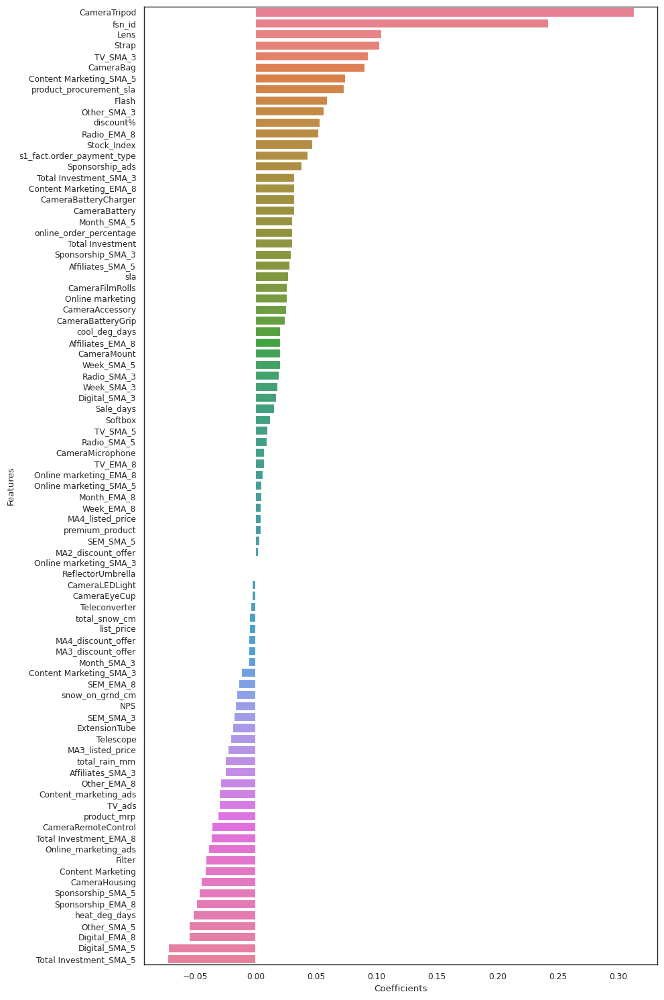

In [1068]:
# Slightly alter the figure size to make it more horizontal.
plt.figure(figsize=(10, 15), dpi=100, facecolor='w', edgecolor='k', frameon='True')
sns.barplot(y='Features', x='Coefficients', palette='husl', data=cameraaccessory_mul_lr_coef_df, estimator=np.sum)
# Automatically adjust subplot params so that the subplotS fits in to the figure area.
plt.tight_layout()

# display the plot
plt.show()


##### The 5 most important features affecting GMV(Revenue) for cameraaccessory are:

|Features|Coefficients|
|--------|------------|
|product_vertical_lens	|0.181|
|product_vertical_camerabattery	|0.160|
|is_mass_market	|0.149|
|product_vertical_camerabatterycharger	|0.121|
|TV	|0.105|

## Building Linear Regression model for `gaming`

In [1069]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

gamingaccessory_mul_model = LinearRegression().fit(X_gamingaccessory_mul_train, y_gamingaccessory_mul_train)
y_gamingaccessory_mul_test_pred = gamingaccessory_mul_model.predict(X_gamingaccessory_mul_test)

print('R2 Score: {}'.format(r2_score(y_gamingaccessory_mul_test, y_gamingaccessory_mul_test_pred)))
print('Mean Squared Error: {}'.format(mean_squared_error(y_gamingaccessory_mul_test, y_gamingaccessory_mul_test_pred)))

R2 Score: 0.9525072278291377
Mean Squared Error: 0.028834455594104823


In [1070]:
##### With Simple Linear Regression, we get a r2 score of 0.96 and mse of 0.018

## Building Linear Regression model for `gamingaccessory` using K-fold Cross Validation

In [1071]:
y_gamingaccessory_mul = gamingaccessory_mul_df.pop('gmv')
X_gamingaccessory_mul = gamingaccessory_mul_df

In [1072]:
# Make cross validated predictions
from sklearn.model_selection import cross_val_score,cross_val_predict
from sklearn import metrics

gamingaccessory_mul_model_cv = LinearRegression().fit(X_gamingaccessory_mul, y_gamingaccessory_mul)
gamingaccessory_mul_predictions_cv = cross_val_predict(gamingaccessory_mul_model_cv, X_gamingaccessory_mul, \
                                                       y_gamingaccessory_mul, cv=10)
accuracy = metrics.r2_score(y_gamingaccessory_mul, gamingaccessory_mul_predictions_cv)
print("Cross-Predicted Accuracy:", accuracy)
print('Mean Squared Error: {}'.format(mean_squared_error(y_gamingaccessory_mul, gamingaccessory_mul_predictions_cv)))

Cross-Predicted Accuracy: 0.8069472791275714
Mean Squared Error: 0.19305272087242858


In [1073]:
##### With Simple Linear Regression, using cross validation, we get a r2 score of 0.91 and mse score of 0.08

## Determining Feature Importance for `gamingaccessory` with model with cv

In [1074]:
# linear regression model parameters
#Limiting floats output to 3 decimal points
pd.set_option('display.float_format', lambda x: '{:.3f}'.format(x)) 
pd.set_option('display.precision',1)


gamingaccessory_mul_lr_model_parameters = list(gamingaccessory_mul_model_cv.coef_)
gamingaccessory_mul_lr_model_parameters.insert(0, gamingaccessory_mul_model_cv.intercept_)
gamingaccessory_mul_lr_model_parameters = [round(x, 3) for x in gamingaccessory_mul_lr_model_parameters]
cols = X_gamingaccessory_test.columns
cols = cols.insert(0, "constant")
gamingaccessory_mul_lr_coef = list(zip(cols, gamingaccessory_mul_lr_model_parameters))
gamingaccessory_mul_lr_coef

[('constant', -0.0),
 ('list_price', 0.036),
 ('product_mrp', 0.031),
 ('discount%', -0.028),
 ('sla', -0.0),
 ('product_procurement_sla', -0.029),
 ('fsn_id', 0.238),
 ('s1_fact.order_payment_type', 0.05),
 ('GamePad', 0.215),
 ('GamingAccessoryKit', 0.019),
 ('GamingHeadset', 0.246),
 ('GamingMemoryCard', -0.008),
 ('MotionController', 0.005),
 ('GamingMouse', 0.147),
 ('GamingAdapter', -0.053),
 ('TVOutCableAccessory', -0.024),
 ('GamingGun', 0.0),
 ('JoystickGamingWheel', 0.024),
 ('GamingMousePad', 0.067),
 ('GamingKeyboard', 0.071),
 ('GamingSpeaker', -0.025),
 ('CoolingPad', -0.012),
 ('GamingChargingStation', 0.027),
 ('GameControlMount', -0.0),
 ('Month_SMA_3', 0.032),
 ('Month_SMA_5', -0.0),
 ('Month_EMA_8', 0.015),
 ('Week_SMA_3', 0.004),
 ('Week_SMA_5', -0.01),
 ('Week_EMA_8', 0.013),
 ('Total Investment', -0.0),
 ('Total Investment_SMA_3', -0.088),
 ('Total Investment_SMA_5', 0.012),
 ('Total Investment_EMA_8', -0.024),
 ('TV_SMA_3', -0.029),
 ('TV_SMA_5', -0.005),
 ('TV_E

In [1075]:
gamingaccessory_mul_lr_coef_df = pd.DataFrame(gamingaccessory_mul_lr_coef)
col_rename = {0:'Features',1: 'Coefficients'}
gamingaccessory_mul_lr_coef_df = gamingaccessory_mul_lr_coef_df.rename(columns=col_rename)
gamingaccessory_mul_lr_coef_df = gamingaccessory_mul_lr_coef_df.iloc[1:,:]
gamingaccessory_mul_lr_coef_df = gamingaccessory_mul_lr_coef_df.loc[gamingaccessory_mul_lr_coef_df['Coefficients']!=0.0]
gamingaccessory_mul_lr_coef_df = gamingaccessory_mul_lr_coef_df.sort_values(by=['Coefficients'], ascending = False)
gamingaccessory_mul_lr_coef_df

,Features,Coefficients
10,GamingHeadset,0.246
6,fsn_id,0.238
8,GamePad,0.215
13,GamingMouse,0.147
55,SEM_SMA_5,0.088
19,GamingKeyboard,0.071
18,GamingMousePad,0.067
7,s1_fact.order_payment_type,0.050
77,online_order_percentage,0.048
43,Content Marketing,0.036


## Plotting the Features in descending order of Importance for `gamingaccessory`

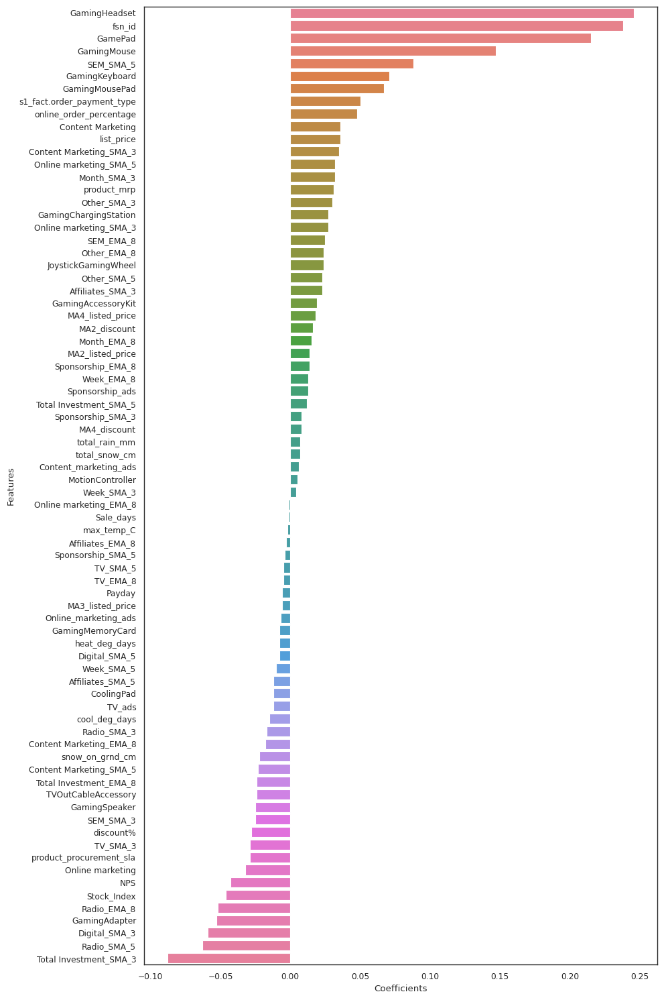

In [1076]:
# Slightly alter the figure size to make it more horizontal.
plt.figure(figsize=(10, 15), dpi=100, facecolor='w', edgecolor='k', frameon='True')
sns.barplot(y='Features', x='Coefficients', palette='husl', data=gamingaccessory_mul_lr_coef_df, estimator=np.sum)
# Automatically adjust subplot params so that the subplotS fits in to the figure area.
plt.tight_layout()

# display the plot
plt.show()

##### The 5 most important features affecting GMV(Revenue) for gamingaccessory are:

|Features|Coefficients|
|--------|------------|
|product_vertical_gamingheadset	|0.250|
|is_mass_market	|0.234|
|product_vertical_gamingmouse	|0.224|
|product_vertical_gamepad	|0.211|
|Online marketing_SMA_3	|0.157|

## Building Linear Regression model for `homeaudio`

In [1077]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

homeaudio_mul_model = LinearRegression().fit(X_homeaudio_mul_train, y_homeaudio_mul_train)
y_homeaudio_mul_test_pred = homeaudio_mul_model.predict(X_homeaudio_mul_test)

print('R2 Score: {}'.format(r2_score(y_homeaudio_mul_test, y_homeaudio_mul_test_pred)))
print('Mean Squared Error: {}'.format(mean_squared_error(y_homeaudio_mul_test, y_homeaudio_mul_test_pred)))

R2 Score: 0.8816698370157038
Mean Squared Error: 0.04416052209277976


In [1078]:
###### With Simple Linear Regression, we get a r2 score of 0.98 and mse of 0.004

## Building Linear Regression model for `homeaudio` using K-fold Cross Validation

In [1079]:
y_homeaudio_mul = homeaudio_mul_df.pop('gmv')
X_homeaudio_mul = homeaudio_mul_df

In [1080]:
# Make cross validated predictions
from sklearn.model_selection import cross_val_score,cross_val_predict
from sklearn import metrics

homeaudio_mul_model_cv = LinearRegression().fit(X_homeaudio_mul, y_homeaudio_mul)
homeaudio_mul_predictions_cv = cross_val_predict(homeaudio_mul_model_cv, X_homeaudio_mul, y_homeaudio_mul, cv=5)
accuracy = metrics.r2_score(y_homeaudio_mul, homeaudio_mul_predictions_cv)
print("Cross-Predicted Accuracy:", accuracy)
print('Mean Squared Error: {}'.format(mean_squared_error(y_homeaudio_mul, homeaudio_mul_predictions_cv)))

Cross-Predicted Accuracy: 0.7946052244744478
Mean Squared Error: 0.20539477552555213


In [1081]:
##### With Simple Linear Regression, using cross validation, we get a r2 score of 0.91 and mse score of 0.08

## Determining Feature Importance for `homeaudio` with model with cv

In [1082]:
# linear regression model parameters
#Limiting floats output to 3 decimal points
pd.set_option('display.float_format', lambda x: '{:.3f}'.format(x)) 
pd.set_option('display.precision',1)


homeaudio_mul_lr_model_parameters = list(homeaudio_mul_model_cv.coef_)
homeaudio_mul_lr_model_parameters.insert(0, homeaudio_mul_model_cv.intercept_)
homeaudio_mul_lr_model_parameters = [round(x, 3) for x in homeaudio_mul_lr_model_parameters]
cols = X_homeaudio_test.columns
cols = cols.insert(0, "constant")
homeaudio_mul_lr_coef = list(zip(cols, homeaudio_mul_lr_model_parameters))
homeaudio_mul_lr_coef

[('constant', -0.0),
 ('list_price', 0.09),
 ('product_mrp', 0.024),
 ('discount%', 0.059),
 ('sla', -0.02),
 ('product_procurement_sla', -0.042),
 ('fsn_id', 0.045),
 ('s1_fact.order_payment_type', 0.226),
 ('HomeAudioSpeaker', 0.362),
 ('Dock', 0.066),
 ('BoomBox', 0.069),
 ('DockingStation', 0.004),
 ('DJController', -0.005),
 ('FMRadio', 0.245),
 ('HiFiSystem', 0.018),
 ('VoiceRecorder', 0.065),
 ('KaraokePlayer', -0.0),
 ('SlingBox', 0.0),
 ('SoundMixer', 0.004),
 ('Month_SMA_3', 0.025),
 ('Month_SMA_5', 0.001),
 ('Month_EMA_8', 0.024),
 ('Week_SMA_3', -0.016),
 ('Week_SMA_5', -0.009),
 ('Week_EMA_8', 0.038),
 ('Total Investment', -0.12),
 ('Total Investment_SMA_3', -0.052),
 ('Total Investment_SMA_5', 0.02),
 ('Total Investment_EMA_8', 0.005),
 ('TV_SMA_3', -0.057),
 ('TV_SMA_5', 0.016),
 ('TV_EMA_8', -0.007),
 ('Digital_SMA_3', -0.015),
 ('Digital_SMA_5', 0.014),
 ('Digital_EMA_8', 0.001),
 ('Sponsorship_SMA_3', 0.019),
 ('Sponsorship_SMA_5', -0.01),
 ('Sponsorship_EMA_8', 0.025

In [1083]:
homeaudio_mul_lr_coef_df = pd.DataFrame(homeaudio_mul_lr_coef)
col_rename = {0:'Features',1: 'Coefficients'}
homeaudio_mul_lr_coef_df = homeaudio_mul_lr_coef_df.rename(columns=col_rename)
homeaudio_mul_lr_coef_df = homeaudio_mul_lr_coef_df.iloc[1:,:]
homeaudio_mul_lr_coef_df = homeaudio_mul_lr_coef_df.loc[homeaudio_mul_lr_coef_df['Coefficients']!=0.0]
homeaudio_mul_lr_coef_df = homeaudio_mul_lr_coef_df.sort_values(by=['Coefficients'], ascending = False)
homeaudio_mul_lr_coef_df

,Features,Coefficients
8,HomeAudioSpeaker,0.362
13,FMRadio,0.245
7,s1_fact.order_payment_type,0.226
1,list_price,0.090
38,Content Marketing,0.071
10,BoomBox,0.069
9,Dock,0.066
15,VoiceRecorder,0.065
3,discount%,0.059
61,Online_marketing_ads,0.056


## Plotting the Features in descending order of Importance for `homeaudio`

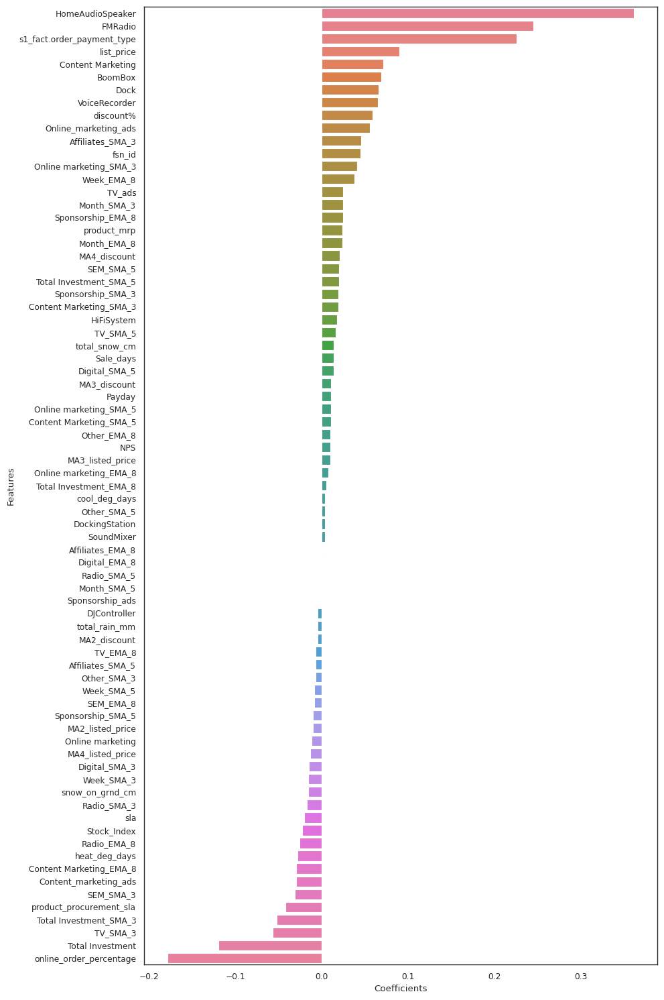

In [1084]:
# Slightly alter the figure size to make it more horizontal.
plt.figure(figsize=(10, 15), dpi=100, facecolor='w', edgecolor='k', frameon='True')
sns.barplot(y='Features', x='Coefficients', palette='husl', data=homeaudio_mul_lr_coef_df, estimator=np.sum)
# Automatically adjust subplot params so that the subplotS fits in to the figure area.
plt.tight_layout()

# display the plot
plt.show()

##### The 5 most important features affecting GMV(Revenue) for homeaudio are:

|Features|Coefficients|
|--------|------------|
|product_vertical_homeaudiospeaker	|0.469|
|is_mass_market	|0.289|
|product_vertical_fmradio	|0.224|
|Radio_Ad_Stock	|0.147|
|Sponsorship	|0.121|

## Koyck Model

In [1085]:
# Making copy of dataframes from the original ones
cameraaccessory_koy_df = camera_week_df.copy()
gamingaccessory_koy_df = gaming_week_df.copy()
homeaudio_koy_df = home_audio_week_df.copy()
homeaudio_koy_df.head()

,Week,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,HomeAudioSpeaker,Dock,BoomBox,DockingStation,DJController,FMRadio,HiFiSystem,VoiceRecorder,KaraokePlayer,SlingBox,SoundMixer,Year,Month,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,Date,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
20,28,6608403.000,2002.174,4250.826,0.447,4.819,2.826,277,442,2701.000,35,28,3,0,453.000,22,53,0,0,0,2015.000,7.000,0.000,0.000,7.000,0.000,0.000,28.000,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.054,1.854,0.000,0.332,47.093,1052.000,0.000,0.000,10.950,1.116,4.848,1.117,0.165,13.414,0.016,-0.015,-0.003,0.114,0.073,0.090
21,29,4453585.000,1984.649,3836.581,0.392,5.479,2.795,278,387,1669.000,46,34,8,1,417.000,14,50,0,0,0,2015.000,7.000,0.000,0.000,7.000,0.000,0.000,28.222,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.143,12.578,1.116,2.562,0.117,4.593,17.285,-0.004,0.005,-0.018,-0.066,-0.016,-0.046
23,30,5550427.500,1928.914,3808.947,0.417,5.535,2.499,288,583,2198.000,56,23,14,0,482.000,18,73,0,0,0,2015.000,7.000,7.000,0.000,7.000,29.000,0.000,28.617,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.429,0.000,5.712,1.953,1.846,0.146,0.206,20.356,0.022,0.005,-0.006,0.102,0.089,0.045
24,31,4160893.000,1912.447,3563.507,0.382,5.688,2.655,273,380,1518.000,26,26,12,1,499.000,17,68,0,0,0,2015.000,7.000,7.000,0.000,7.000,30.000,0.000,29.147,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.000,7.725,1.674,1.846,0.146,0.206,17.536,-0.004,0.009,-0.003,-0.044,0.006,-0.002
25,32,6607912.000,2025.304,4077.258,0.428,4.892,2.758,289,506,2532.000,28,37,4,0,564.000,18,75,0,0,0,2015.000,8.000,7.333,7.200,7.222,31.000,30.000,29.781,1.013,3.181,3.615,3.542,0.036,0.043,0.042,0.507,0.558,0.549,1.307,1.526,1.489,0.000,0.000,0.000,0.000,0.026,0.230,0.271,0.264,0.096,0.113,0.110,1.005,1.105,1.089,0.000,0.000,0.000,0.000,0.000,0.000,2015-08-01 00:00:00,0.028,1.140,0.000,0.192,50.327,1222.000,0.286,0.143,9.607,1.116,2.622,0.088,0.124,15.531,0.029,0.036,0.050,0.057,0.046,0.093


In [1086]:
### Creating a new variable which is the Lag of 1 week of the dependent variable (GMV)

In [1087]:
GMV_Lag = ['gmv']

In [1088]:
def lag_variables(df,var,n):
    for i in var:
        loc_index = df.columns.get_loc(i) + 1
        df.insert(loc=loc_index,column= i+'_lag'+np.str(n),value=df[i].shift(n))
    return df

In [1089]:
cameraaccessory_koy_df = lag_variables(cameraaccessory_koy_df,GMV_Lag,1) 
gamingaccessory_koy_df = lag_variables(gamingaccessory_koy_df,GMV_Lag,1) 
homeaudio_koy_df = lag_variables(homeaudio_koy_df,GMV_Lag,1) 
homeaudio_koy_df.head()

,Week,gmv,gmv_lag1,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,HomeAudioSpeaker,Dock,BoomBox,DockingStation,DJController,FMRadio,HiFiSystem,VoiceRecorder,KaraokePlayer,SlingBox,SoundMixer,Year,Month,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,Date,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
20,28,6608403.000,nan,2002.174,4250.826,0.447,4.819,2.826,277,442,2701.000,35,28,3,0,453.000,22,53,0,0,0,2015.000,7.000,0.000,0.000,7.000,0.000,0.000,28.000,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.054,1.854,0.000,0.332,47.093,1052.000,0.000,0.000,10.950,1.116,4.848,1.117,0.165,13.414,0.016,-0.015,-0.003,0.114,0.073,0.090
21,29,4453585.000,6608403.000,1984.649,3836.581,0.392,5.479,2.795,278,387,1669.000,46,34,8,1,417.000,14,50,0,0,0,2015.000,7.000,0.000,0.000,7.000,0.000,0.000,28.222,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.143,12.578,1.116,2.562,0.117,4.593,17.285,-0.004,0.005,-0.018,-0.066,-0.016,-0.046
23,30,5550427.500,4453585.000,1928.914,3808.947,0.417,5.535,2.499,288,583,2198.000,56,23,14,0,482.000,18,73,0,0,0,2015.000,7.000,7.000,0.000,7.000,29.000,0.000,28.617,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.429,0.000,5.712,1.953,1.846,0.146,0.206,20.356,0.022,0.005,-0.006,0.102,0.089,0.045
24,31,4160893.000,5550427.500,1912.447,3563.507,0.382,5.688,2.655,273,380,1518.000,26,26,12,1,499.000,17,68,0,0,0,2015.000,7.000,7.000,0.000,7.000,30.000,0.000,29.147,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.000,7.725,1.674,1.846,0.146,0.206,17.536,-0.004,0.009,-0.003,-0.044,0.006,-0.002
25,32,6607912.000,4160893.000,2025.304,4077.258,0.428,4.892,2.758,289,506,2532.000,28,37,4,0,564.000,18,75,0,0,0,2015.000,8.000,7.333,7.200,7.222,31.000,30.000,29.781,1.013,3.181,3.615,3.542,0.036,0.043,0.042,0.507,0.558,0.549,1.307,1.526,1.489,0.000,0.000,0.000,0.000,0.026,0.230,0.271,0.264,0.096,0.113,0.110,1.005,1.105,1.089,0.000,0.000,0.000,0.000,0.000,0.000,2015-08-01 00:00:00,0.028,1.140,0.000,0.192,50.327,1222.000,0.286,0.143,9.607,1.116,2.622,0.088,0.124,15.531,0.029,0.036,0.050,0.057,0.046,0.093


In [1090]:
# Imputing all null values with 0
cameraaccessory_koy_df.fillna(value=0, inplace=True)
gamingaccessory_koy_df.fillna(value=0, inplace=True)
homeaudio_koy_df.fillna(value=0, inplace=True)
homeaudio_koy_df.head(10)

,Week,gmv,gmv_lag1,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,HomeAudioSpeaker,Dock,BoomBox,DockingStation,DJController,FMRadio,HiFiSystem,VoiceRecorder,KaraokePlayer,SlingBox,SoundMixer,Year,Month,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,Date,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
20,28,6608403.000,0.000,2002.174,4250.826,0.447,4.819,2.826,277,442,2701.000,35,28,3,0,453.000,22,53,0,0,0,2015.000,7.000,0.000,0.000,7.000,0.000,0.000,28.000,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.054,1.854,0.000,0.332,47.093,1052.000,0.000,0.000,10.950,1.116,4.848,1.117,0.165,13.414,0.016,-0.015,-0.003,0.114,0.073,0.090
21,29,4453585.000,6608403.000,1984.649,3836.581,0.392,5.479,2.795,278,387,1669.000,46,34,8,1,417.000,14,50,0,0,0,2015.000,7.000,0.000,0.000,7.000,0.000,0.000,28.222,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.143,12.578,1.116,2.562,0.117,4.593,17.285,-0.004,0.005,-0.018,-0.066,-0.016,-0.046
23,30,5550427.500,4453585.000,1928.914,3808.947,0.417,5.535,2.499,288,583,2198.000,56,23,14,0,482.000,18,73,0,0,0,2015.000,7.000,7.000,0.000,7.000,29.000,0.000,28.617,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.429,0.000,5.712,1.953,1.846,0.146,0.206,20.356,0.022,0.005,-0.006,0.102,0.089,0.045
24,31,4160893.000,5550427.500,1912.447,3563.507,0.382,5.688,2.655,273,380,1518.000,26,26,12,1,499.000,17,68,0,0,0,2015.000,7.000,7.000,0.000,7.000,30.000,0.000,29.147,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.000,7.725,1.674,1.846,0.146,0.206,17.536,-0.004,0.009,-0.003,-0.044,0.006,-0.002
25,32,6607912.000,4160893.000,2025.304,4077.258,0.428,4.892,2.758,289,506,2532.000,28,37,4,0,564.000,18,75,0,0,0,2015.000,8.000,7.333,7.200,7.222,31.000,30.000,29.781,1.013,3.181,3.615,3.542,0.036,0.043,0.042,0.507,0.558,0.549,1.307,1.526,1.489,0.000,0.000,0.000,0.000,0.026,0.230,0.271,0.264,0.096,0.113,0.110,1.005,1.105,1.089,0.000,0.000,0.000,0.000,0.000,0.000,2015-08-01 00:00:00,0.028,1.140,0.000,0.192,50.327,1222.000,0.286,0.143,9.607,1.116,2.622,0.088,0.124,15.531,0.029,0.036,0.050,0.057,0.046,0.093
26,33,4315356.000,6607912.000,1885.000,3520.812,0.387,5.351,2.761,291,392,1582.000,42,38,8,0,533.000,18,63,0,0,0,2015.000,8.000,7.667,7.400,7.395,32.000,31.000,30.496,1.013,2.097,2.964,2.980,0.019,0.033,0.033,0.382,0.482,0.484,0.760,1.198,1.206,0.000,0.000,0.000,0.000,0.026,0.128,0.210,0.211,0.056,

In [1091]:
# removing columns
cameraaccessory_koy_df = cameraaccessory_koy_df.drop(['Week','Year','Date','Month'], axis=1)
gamingaccessory_koy_df = gamingaccessory_koy_df.drop(['Week','Year','Date','Month'], axis=1)
homeaudio_koy_df = homeaudio_koy_df.drop(['Week','Year','Date','Month'], axis=1)
homeaudio_koy_df.head()

,gmv,gmv_lag1,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,HomeAudioSpeaker,Dock,BoomBox,DockingStation,DJController,FMRadio,HiFiSystem,VoiceRecorder,KaraokePlayer,SlingBox,SoundMixer,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
20,6608403.000,0.000,2002.174,4250.826,0.447,4.819,2.826,277,442,2701.000,35,28,3,0,453.000,22,53,0,0,0,0.000,0.000,7.000,0.000,0.000,28.000,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.054,1.854,0.000,0.332,47.093,1052.000,0.000,0.000,10.950,1.116,4.848,1.117,0.165,13.414,0.016,-0.015,-0.003,0.114,0.073,0.090
21,4453585.000,6608403.000,1984.649,3836.581,0.392,5.479,2.795,278,387,1669.000,46,34,8,1,417.000,14,50,0,0,0,0.000,0.000,7.000,0.000,0.000,28.222,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.143,12.578,1.116,2.562,0.117,4.593,17.285,-0.004,0.005,-0.018,-0.066,-0.016,-0.046
23,5550427.500,4453585.000,1928.914,3808.947,0.417,5.535,2.499,288,583,2198.000,56,23,14,0,482.000,18,73,0,0,0,7.000,0.000,7.000,29.000,0.000,28.617,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.081,2.781,0.000,0.498,47.093,1052.000,0.429,0.000,5.712,1.953,1.846,0.146,0.206,20.356,0.022,0.005,-0.006,0.102,0.089,0.045
24,4160893.000,5550427.500,1912.447,3563.507,0.382,5.688,2.655,273,380,1518.000,26,26,12,1,499.000,17,68,0,0,0,7.000,0.000,7.000,30.000,0.000,29.147,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.000,7.725,1.674,1.846,0.146,0.206,17.536,-0.004,0.009,-0.003,-0.044,0.006,-0.002
25,6607912.000,4160893.000,2025.304,4077.258,0.428,4.892,2.758,289,506,2532.000,28,37,4,0,564.000,18,75,0,0,0,7.333,7.200,7.222,31.000,30.000,29.781,1.013,3.181,3.615,3.542,0.036,0.043,0.042,0.507,0.558,0.549,1.307,1.526,1.489,0.000,0.000,0.000,0.000,0.026,0.230,0.271,0.264,0.096,0.113,0.110,1.005,1.105,1.089,0.000,0.000,0.000,0.000,0.000,0.000,0.028,1.140,0.000,0.192,50.327,1222.000,0.286,0.143,9.607,1.116,2.622,0.088,0.124,15.531,0.029,0.036,0.050,0.057,0.046,0.093


In [1092]:
## Rescaling the Features of the 3 Dataframes
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

cameraaccessory_koy_df[cameraaccessory_koy_df.columns]=scaler.fit_transform(cameraaccessory_koy_df[cameraaccessory_koy_df.columns])
gamingaccessory_koy_df[gamingaccessory_koy_df.columns]=scaler.fit_transform(gamingaccessory_koy_df[gamingaccessory_koy_df.columns])
homeaudio_koy_df[homeaudio_koy_df.columns]=scaler.fit_transform(homeaudio_koy_df[homeaudio_koy_df.columns])

homeaudio_koy_df.head()

,gmv,gmv_lag1,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,HomeAudioSpeaker,Dock,BoomBox,DockingStation,DJController,FMRadio,HiFiSystem,VoiceRecorder,KaraokePlayer,SlingBox,SoundMixer,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
20,1.158,-1.943,0.807,1.985,2.113,-0.920,1.101,0.237,-0.251,1.307,-0.099,-0.579,-0.763,-0.388,-0.332,0.062,-0.030,0.000,-0.206,-0.331,-1.849,-1.742,0.092,-1.750,-1.662,-0.002,-1.093,-1.549,-1.591,-1.449,-1.353,-1.395,-1.497,-0.800,-0.893,0.077,-1.234,-1.336,-1.257,-0.674,-0.763,-0.861,-1.063,-1.621,-1.782,-1.763,-1.678,-1.827,-1.785,-1.647,-1.011,-1.103,-0.459,-0.555,-0.612,-0.723,-0.537,-0.590,-0.703,-1.274,-0.990,-0.716,-1.692,-0.570,-1.316,-0.490,-0.935,1.446,-0.521,1.175,2.599,-0.197,-0.645,0.472,-0.292,-0.007,2.040,1.243,1.474
21,0.115,1.144,0.680,1.055,0.635,-0.152,0.938,0.256,-0.408,0.133,0.356,-0.322,0.162,1.986,-0.525,-0.717,-0.129,0.000,-0.206,-0.331,-1.849,-1.742,0.092,-1.750,-1.662,0.015,-1.093,-1.549,-1.591,-1.449,-1.353,-1.395,-1.497,-0.800,-0.893,0.077,-1.234,-1.336,-1.257,-0.674,-0.763,-0.861,-1.063,-1.621,-1.782,-1.763,-1.678,-1.827,-1.785,-1.647,-1.011,-1.103,-0.459,-0.555,-0.612,-0.723,-0.537,-0.590,-0.703,-1.246,-0.888,-0.716,-1.637,-0.570,-1.316,-0.490,1.023,1.913,-0.521,0.000,-0.275,6.267,-0.468,-0.076,0.150,-0.311,-1.115,-0.187,-0.600
23,0.646,0.137,0.276,0.993,1.303,-0.087,-0.611,0.448,0.151,0.735,0.769,-0.794,1.273,-0.388,-0.177,-0.328,0.633,0.000,-0.206,-0.331,0.150,-1.742,0.092,0.128,-1.662,0.047,-1.093,-1.139,-1.591,-1.449,-1.267,-1.395,-1.497,0.111,-0.893,0.077,-0.912,-1.336,-1.257,-0.674,-0.763,-0.861,-1.063,-1.621,-1.616,-1.763,-1.678,-1.605,-1.785,-1.647,-0.280,-1.103,-0.459,-0.555,-0.612,-0.723,-0.537,-0.590,-0.703,-1.246,-0.888,-0.716,-1.637,-0.570,-1.316,1.407,-0.935,-0.059,0.085,-0.368,-0.191,-0.137,-0.327,0.637,0.152,-0.070,1.830,1.506,0.791
24,-0.027,0.650,0.156,0.442,0.365,0.090,0.206,0.161,-0.428,-0.039,-0.470,-0.665,0.903,1.986,-0.086,-0.425,0.467,0.000,-0.206,-0.331,0.150,-1.742,0.092,0.193,-1.662,0.090,-1.093,-1.139,-1.591,-1.449,-1.267,-1.395,-1.497,0.111,-0.893,0.077,-0.912,-1.336,-1.257,-0.674,-0.763,-0.861,-1.063,-1.621,-1.616,-1.763,-1.678,-1.605,-1.785,-1.647,-0.280,-1.103,-0.459,-0.555,-0.612,-0.723,-0.537,-0.590,-0.703,-1.246,-0.888,-0.716,-1.637,-0.570,-1.316,-0.490,-0.935,0.519,-0.117,-0.368,-0.191,-0.137,-0.456,-0.073,0.242,-0.009,-0.730,0.170,0.068
25,1.158,0.001,0.975,1.596,1.588,-0.835,0.744,0.467,-0.068,1.115,-0.388,-0.193,-0.578,-0.388,0.262,-0.328,0.699,0.000,-0.206,-0.331,0.245,0.272,0.171,0.258,0.256,0.141,-1.383,-1.243,-1.224,-1.542,-1.295,-1.322,-1.521,-0.070,0.028,-0.113,-1.007,-1.044,-1.349,-0.674,-0.763,-0.861,-1.063,-1.772,-1.667,-1.626,-1.715,-1.671,-1.602,-1.695,-0.426,-0.382,-0.608,-0.555,-0.612,-0.723,-0.537,-0.590,-0.703,-1.301,-1.068,-0.716,-1.738,0.540,0.841,0.774,1.023,1.060,-0.521,0.031,-0.359,-0.257,-0.548,0.814,0.833,1.046,1.037,0.817,1.515


In [1093]:
## Splitting the 3 Dataframes into Training and Testing Sets

from sklearn.model_selection import train_test_split

# We specify this so that the train and test data set always have the same rows, respectively

cameraaccessory_train, cameraaccessory_test = train_test_split(cameraaccessory_koy_df, \
                                                               train_size = 0.7, test_size = 0.3, random_state = 100)

gamingaccessory_train, gamingaccessory_test = train_test_split(gamingaccessory_koy_df, \
                                                               train_size = 0.7, test_size = 0.3, random_state = 100)

homeaudio_train, homeaudio_test = train_test_split(homeaudio_koy_df, \
                                                               train_size = 0.7, test_size = 0.3, random_state = 100)

In [1094]:
## Dividing the 3 dataframes into X and Y sets for the model building

y_cameraaccessory_train = cameraaccessory_train.pop('gmv')
X_cameraaccessory_train = cameraaccessory_train

y_gamingaccessory_train = gamingaccessory_train.pop('gmv')
X_gamingaccessory_train = gamingaccessory_train

y_homeaudio_train = homeaudio_train.pop('gmv')
X_homeaudio_train = homeaudio_train

X_homeaudio_train.head()

,gmv_lag1,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,HomeAudioSpeaker,Dock,BoomBox,DockingStation,DJController,FMRadio,HiFiSystem,VoiceRecorder,KaraokePlayer,SlingBox,SoundMixer,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
48,-0.632,1.143,-0.163,-1.461,-2.140,-0.395,-1.964,-1.235,-1.342,-1.461,-0.493,-0.208,1.986,-2.189,-1.592,-1.157,0.000,-0.206,-0.331,1.577,1.558,1.691,1.617,1.598,1.728,0.911,1.014,0.786,0.965,0.795,0.703,0.774,0.302,0.204,0.397,1.227,0.948,1.171,0.493,0.566,0.395,0.670,0.984,1.028,0.906,0.938,0.942,0.860,0.881,0.616,0.492,0.755,-0.555,-0.612,-0.723,-0.537,-0.590,-0.703,0.755,1.150,0.525,1.004,0.605,0.486,-0.490,-0.935,-0.879,1.693,-0.396,-0.317,-0.227,-0.440,-0.128,0.317,0.684,-0.094,0.138,0.100
10,0.403,0.542,1.791,1.838,-0.685,0.441,0.141,0.128,1.160,0.190,0.964,-0.578,-0.388,0.851,0.548,-0.759,0.000,-0.206,-0.331,-0.517,-0.511,-0.924,-0.584,-0.575,-0.972,-0.079,-0.094,-0.090,0.081,-0.371,0.101,0.355,-0.547,-0.575,-0.795,-0.149,-0.151,-0.079,0.017,-0.224,-0.470,-0.402,0.543,0.480,0.445,0.588,0.413,0.484,0.604,-0.270,-0.329,-0.485,0.342,0.071,0.495,-0.155,-0.301,0.220,-0.906,-0.147,0.018,0.557,-0.602,0.981,0.774,-0.935,-0.393,-0.925,-0.306,-0.443,-0.317,-0.488,1.171,1.430,1.325,1.828,2.294,1.803
39,0.586,-0.493,-0.612,-0.048,-0.489,-0.686,0.582,-0.505,-0.405,-0.801,-0.922,0.903,-0.388,-0.171,0.062,0.766,0.000,-0.206,-0.331,1.101,1.111,1.094,1.099,1.087,1.088,-0.558,1.503,2.074,1.580,0.725,0.954,0.616,2.350,3.365,2.524,1.380,2.021,1.788,-0.526,2.152,3.103,2.273,0.140,0.898,1.095,0.680,0.771,0.907,0.549,2.289,3.201,2.448,-0.555,-0.612,-0.723,-0.537,-0.590,-0.703,0.331,0.285,0.723,0.511,-0.497,0.917,-0.490,-0.935,0.017,-0.925,-0.144,-0.443,-0.317,-0.375,0.102,-0.890,-0.574,0.013,0.423,0.512
28,1.049,0.059,-0.000,0.037,0.183,-0.384,0.486,-0.305,0.235,-0.222,-0.622,0.533,-0.388,0.027,1.034,0.799,0.000,-0.206,-0.331,0.435,0.439,0.318,0.452,0.447,0.328,-1.383,-1.451,-1.422,-1.714,-1.351,-1.375,-1.564,-0.431,-0.345,-0.465,-1.197,-1.232,-1.519,-0.674,-0.763,-0.861,-1.063,-1.772,-1.769,-1.719,-1.785,-1.802,-1.721,-1.783,-0.718,-0.677,-0.884,-0.555,-0.612,-0.723,-0.537,-0.590,-0.703,-1.328,-1.159,-0.716,-1.789,0.540,0.841,-0.490,-0.935,1.003,-0.319,1.497,2.273,1.114,-0.471,-0.519,-0.210,-0.445,-1.277,-0.986,-1.190
22,0.213,-0.329,-0.588,-0.753,1.745,0.249,-0.739,-0.023,0.025,0.521,0.750,-1.134,-0.388,0.391,0.548,-0.858,0.000,-0.206,-0.331,-1.564,-0.232,-0.291,-1.620,-0.243,-0.289,0.184,0.233,0.624,0.660,0.391,0.616,0.662,-0.636,-0.274,-0.396,-1.052,-0.128,-0.222,0.310,0.357,0.517,0.617,1.032,1.077,1.110,1.121,1.161,1.117,1.131,-0.400,0.038,0.015,3.573,2.533,2.694,3.355,2.353,2.442,0.363,-1.020,0.330,1.053,2.006,0.270,0.774,1.023,-1.465,2.088,-0.510,-0.527,-0.377,-0.232,-0.937,-1.074,-0.947,-1.206,-2.106,-1.650


In [1095]:
## Dividing into X and Y test sets for the model building for 3 dataframes

y_cameraaccessory_test = cameraaccessory_test.pop('gmv')
X_cameraaccessory_test = cameraaccessory_test

y_gamingaccessory_test = gamingaccessory_test.pop('gmv')
X_gamingaccessory_test = gamingaccessory_test

y_homeaudio_test = homeaudio_test.pop('gmv')
X_homeaudio_test = homeaudio_test

X_homeaudio_test.head()

,gmv_lag1,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,HomeAudioSpeaker,Dock,BoomBox,DockingStation,DJController,FMRadio,HiFiSystem,VoiceRecorder,KaraokePlayer,SlingBox,SoundMixer,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
27,0.073,0.645,1.304,1.640,-0.654,-0.676,0.984,0.143,1.073,0.562,-0.408,-0.578,-0.388,0.171,-0.619,0.733,0.000,-0.206,-0.331,0.435,0.384,0.281,0.387,0.384,0.261,-1.383,-1.451,-1.356,-1.671,-1.351,-1.357,-1.553,-0.431,-0.221,-0.376,-1.197,-1.169,-1.475,-0.674,-0.763,-0.861,-1.063,-1.772,-1.769,-1.688,-1.767,-1.802,-1.681,-1.761,-0.718,-0.578,-0.814,-0.555,-0.612,-0.723,-0.537,-0.590,-0.703,-1.328,-1.159,-0.716,-1.789,0.540,0.841,1.407,1.023,0.818,-0.521,-0.558,-0.275,0.637,-0.434,0.703,0.231,0.343,0.947,0.645,0.968
42,-0.529,1.188,0.301,-0.034,-1.553,-0.703,-0.069,-0.448,-0.175,-1.296,-0.408,1.644,-0.388,-1.477,-0.036,-0.659,0.000,-0.206,0.916,1.292,1.278,1.320,1.294,1.278,1.327,-0.558,-0.565,0.106,0.383,-0.009,0.256,0.325,-0.433,0.487,0.774,-0.742,-0.089,0.306,-0.526,-0.594,0.275,0.638,0.140,0.172,0.434,0.473,0.313,0.494,0.487,-0.403,0.484,0.809,-0.555,-0.612,-0.723,-0.537,-0.590,-0.703,-0.025,-0.726,-0.558,0.149,-0.497,0.917,1.407,-0.935,-1.465,2.067,-0.966,-0.527,-0.377,-0.282,1.466,1.774,1.831,0.720,0.683,0.538
7,-0.582,-0.390,0.337,1.416,0.436,-1.604,0.984,3.557,4.907,4.609,4.180,-0.578,-0.388,4.304,3.563,-0.129,0.000,-0.206,-0.331,-0.707,-0.735,-1.160,-0.778,-0.767,-1.173,-0.204,-0.184,0.291,0.210,0.719,1.480,1.368,-0.486,-0.330,-0.595,-0.179,0.161,-0.002,-0.635,-0.718,-0.619,-0.639,0.247,0.280,0.420,0.513,0.481,0.610,0.684,-0.397,-0.351,-0.558,-0.555,0.065,0.099,-0.537,0.565,0.524,0.681,-0.189,-0.674,0.257,-1.495,0.689,1.407,1.023,-0.191,-0.236,-0.660,-0.359,-0.257,-0.186,1.543,1.521,1.784,1.711,2.258,2.438
2,-0.509,-1.133,-0.505,-0.004,-0.004,1.045,-0.452,-0.396,-0.426,0.603,1.693,-0.763,-0.388,0.477,0.548,-0.229,0.000,-0.206,-0.331,-1.088,-1.071,-1.379,-1.102,-1.087,-1.383,0.761,0.360,0.011,0.256,1.389,0.690,1.043,-0.112,-0.166,-0.373,0.105,-0.269,-0.225,-0.268,-0.257,-0.242,-0.135,0.483,0.415,0.374,0.605,0.553,0.483,0.705,-0.318,-0.383,-0.496,0.334,0.065,0.805,0.990,0.565,1.326,2.263,0.525,-0.284,0.497,-0.628,-0.694,-0.490,-0.935,-0.968,0.378,-0.585,-0.443,-0.317,-0.157,-0.160,-2.520,-2.256,0.101,-0.309,-0.262
16,-0.077,1.274,2.658,2.522,-0.755,1.527,-0.107,-0.142,1.048,0.108,-0.322,-0.578,1.986,0.123,-0.328,-0.461,0.000,-0.206,-0.331,-0.231,-0.232,-0.567,-0.260,-0.256,-0.596,-0.517,-0.363,-0.204,-0.218,-0.766,-0.839,-0.548,-0.385,-0.506,-0.768,-0.143,-0.126,-0.123,-0.626,-0.464,-0.296,-0.476,-0.804,-0.331,0.074,0.101,-0.343,-0.011,0.069,-0.380,-0.318,-0.544,-0.107,0.413,0.297,-0.346,-0.156,-0.161,-0.687,-0.159,-0.665,-0.808,-1.014,-1.494,-0.490,-0.935,0.559,-0.723,-0.704,-0.359,-0.257,-0.561,1.242,1.546,1.463,1.415,2.625,3.009


## Building Linear Regression model for `cameraaccessory`

In [1096]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

cameraaccessory_model = LinearRegression().fit(X_cameraaccessory_train, y_cameraaccessory_train)
y_cameraaccessory_test_pred = cameraaccessory_model.predict(X_cameraaccessory_test)

print('R2 Score: {}'.format(r2_score(y_cameraaccessory_test, y_cameraaccessory_test_pred)))
print('Mean Squared Error: {}'.format(mean_squared_error(y_cameraaccessory_test, y_cameraaccessory_test_pred)))

R2 Score: 0.957939583196917
Mean Squared Error: 0.07621164761920833


In [1097]:
##### With Simple Linear Regression, we get a r2 score of 0.95 and mse of 0.07

In [1098]:
## Building Linear Regression model for `cameraaccessory` using K-fold Cross Validation

In [1099]:
y_cameraaccessory = cameraaccessory_koy_df.pop('gmv')
X_cameraaccessory = cameraaccessory_koy_df

In [1100]:
# Make cross validated predictions
from sklearn.model_selection import cross_val_score,cross_val_predict
from sklearn import metrics

cameraaccessory_model_cv = LinearRegression().fit(X_cameraaccessory, y_cameraaccessory)
cameraaccessory_predictions_cv = cross_val_predict(cameraaccessory_model_cv, X_cameraaccessory, y_cameraaccessory, cv=10)
accuracy = metrics.r2_score(y_cameraaccessory, cameraaccessory_predictions_cv)
print("Cross-Predicted Accuracy:", accuracy)
print('Mean Squared Error: {}'.format(mean_squared_error(y_cameraaccessory, cameraaccessory_predictions_cv)))

Cross-Predicted Accuracy: 0.9353479515956931
Mean Squared Error: 0.06465204840430698


In [1101]:
##### With Simple Linear Regression, using cross validation, we get a r2 score of 0.94 and mse score of 0.05

## Determining Feature Importance for `cameraaccessory` with model without cv

In [1102]:
# linear regression model parameters
#Limiting floats output to 3 decimal points
pd.set_option('display.float_format', lambda x: '{:.3f}'.format(x)) 
pd.set_option('display.precision',1)


cameraaccessory_lr_model_parameters = list(cameraaccessory_model.coef_)
cameraaccessory_lr_model_parameters.insert(0, cameraaccessory_model.intercept_)
cameraaccessory_lr_model_parameters = [round(x, 3) for x in cameraaccessory_lr_model_parameters]
cols = X_cameraaccessory_test.columns
cols = cols.insert(0, "constant")
cameraaccessory_lr_coef = list(zip(cols, cameraaccessory_lr_model_parameters))
cameraaccessory_lr_coef

[('constant', 0.025),
 ('gmv_lag1', -0.075),
 ('list_price', -0.017),
 ('product_mrp', -0.083),
 ('discount%', 0.016),
 ('sla', 0.001),
 ('product_procurement_sla', -0.004),
 ('fsn_id', 0.091),
 ('s1_fact.order_payment_type', 0.061),
 ('premium_product', -0.0),
 ('CameraTripod', 0.191),
 ('Lens', 0.068),
 ('CameraBag', 0.121),
 ('Flash', 0.21),
 ('CameraBattery', 0.09),
 ('CameraBatteryCharger', 0.045),
 ('CameraRemoteControl', 0.092),
 ('Filter', 0.07),
 ('Strap', 0.034),
 ('CameraBatteryGrip', 0.008),
 ('CameraAccessory', 0.009),
 ('CameraFilmRolls', -0.003),
 ('CameraMount', 0.049),
 ('ExtensionTube', -0.069),
 ('Telescope', 0.091),
 ('CameraEyeCup', 0.019),
 ('CameraLEDLight', -0.0),
 ('CameraMicrophone', 0.027),
 ('Softbox', -0.038),
 ('CameraHousing', -0.0),
 ('FlashShoeAdapter', 0.003),
 ('ReflectorUmbrella', -0.017),
 ('Teleconverter', 0.0),
 ('Month_SMA_3', -0.013),
 ('Month_SMA_5', 0.012),
 ('Month_EMA_8', -0.037),
 ('Week_SMA_3', -0.03),
 ('Week_SMA_5', 0.006),
 ('Week_EMA_8

In [1103]:
cameraaccessory_lr_coef_df = pd.DataFrame(cameraaccessory_lr_coef)
col_rename = {0:'Features',1: 'Coefficients'}
cameraaccessory_lr_coef_df = cameraaccessory_lr_coef_df.rename(columns=col_rename)
cameraaccessory_lr_coef_df = cameraaccessory_lr_coef_df.iloc[1:,:]
cameraaccessory_lr_coef_df = cameraaccessory_lr_coef_df.loc[cameraaccessory_lr_coef_df['Coefficients']!=0.0]
cameraaccessory_lr_coef_df = cameraaccessory_lr_coef_df.sort_values(by=['Coefficients'], ascending = False)
cameraaccessory_lr_coef_df

,Features,Coefficients
13,Flash,0.210
10,CameraTripod,0.191
12,CameraBag,0.121
16,CameraRemoteControl,0.092
7,fsn_id,0.091
24,Telescope,0.091
14,CameraBattery,0.090
78,Sale_days,0.078
17,Filter,0.070
11,Lens,0.068


## Determining Total Effect of KPIs from Koyck model

*Equation for Koyck Model:*

__Yt__ = __α__ + __µYt-1__ + __β1X1__ + __β2X2__ + __β3X3__ + __β4X4__ + __β5X5__ + __ϵ__  -- (sale at time t is dependent on sale at time t-1)

*If 	X1 is the advertising effect, β1 is the current effect of advertising, carry over effect of advertising is β1 * µ/(1-µ).*

*Therefore the total effect of advertising  = Current effect + Carry over effect*

                                            = β1 + β1 * µ/(1-µ)	

											= β1/(1-µ)

##### Calculating the coefficient of lag variable

In [1104]:
cameraaccessory_lr_coef_df.loc[cameraaccessory_lr_coef_df['Features'] == 'gmv_lag1'].Coefficients

1   -0.075
Name: Coefficients, dtype: float64

In [1105]:
cameraaccessory_lr_coef_df['Total Effect'] = cameraaccessory_lr_coef_df['Coefficients']/(1-(-0.128))
cameraaccessory_lr_coef_df

,Features,Coefficients,Total Effect
13,Flash,0.210,0.186
10,CameraTripod,0.191,0.169
12,CameraBag,0.121,0.107
16,CameraRemoteControl,0.092,0.082
7,fsn_id,0.091,0.081
24,Telescope,0.091,0.081
14,CameraBattery,0.090,0.080
78,Sale_days,0.078,0.069
17,Filter,0.070,0.062
11,Lens,0.068,0.060


In [1106]:
## Plotting the Features in descending order of Importance for `cameraaccessory`

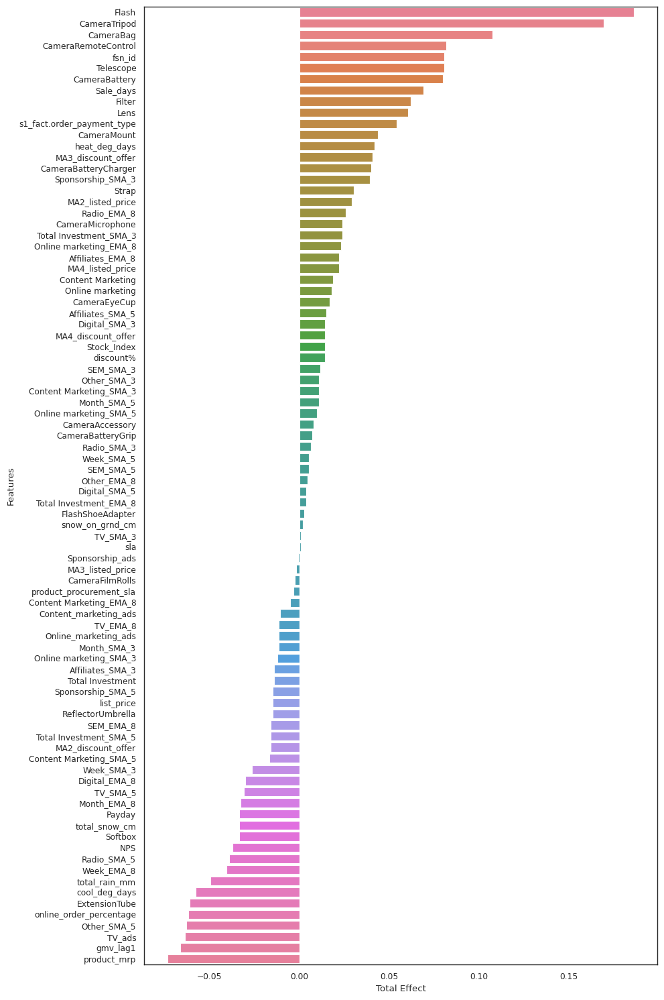

In [1107]:
# Slightly alter the figure size to make it more horizontal.
plt.figure(figsize=(10, 15), dpi=100, facecolor='w', edgecolor='k', frameon='True')
sns.barplot(y='Features', x='Total Effect', palette='husl', data=cameraaccessory_lr_coef_df, estimator=np.sum)
# Automatically adjust subplot params so that the subplotS fits in to the figure area.
plt.tight_layout()

# display the plot
plt.show()

##### The 5 most important features affecting GMV(Revenue) for cameraaccessory are:

|Features|Coefficients|
|--------|------------|
|product_vertical_lens|	0.299|
|product_vertical_camerabag|	0.195|
|product_vertical_camerahousing	|0.135|
|product_vertical_camerabattery|	0.133|
|Online marketing|	0.127|

## Building Linear Regression model for `gamingaccessory`

In [1108]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

gamingaccessory_model = LinearRegression().fit(X_gamingaccessory_train, y_gamingaccessory_train)
y_gamingaccessory_test_pred = gamingaccessory_model.predict(X_gamingaccessory_test)

print('R2 Score: {}'.format(r2_score(y_gamingaccessory_test, y_gamingaccessory_test_pred)))
print('Mean Squared Error: {}'.format(mean_squared_error(y_gamingaccessory_test, y_gamingaccessory_test_pred)))

R2 Score: 0.9710225475476254
Mean Squared Error: 0.043194922858721965


In [1109]:
##### With Simple Linear Regression, we get a r2 score of 0.95 and mse of 0.07

In [1110]:
## Building Linear Regression model for `gamingaccessory` using K-fold Cross Validation

In [1111]:
y_gamingaccessory = gamingaccessory_koy_df.pop('gmv')
X_gamingaccessory = gamingaccessory_koy_df

In [1112]:
# Make cross validated predictions
from sklearn.model_selection import cross_val_score,cross_val_predict
from sklearn import metrics

gamingaccessory_model_cv = LinearRegression().fit(X_gamingaccessory, y_gamingaccessory)
gamingaccessory_predictions_cv = cross_val_predict(gamingaccessory_model_cv, X_gamingaccessory, y_gamingaccessory, cv=10)
accuracy = metrics.r2_score(y_gamingaccessory, gamingaccessory_predictions_cv)
print("Cross-Predicted Accuracy:", accuracy)
print('Mean Squared Error: {}'.format(mean_squared_error(y_gamingaccessory, gamingaccessory_predictions_cv)))

Cross-Predicted Accuracy: 0.8215151163995362
Mean Squared Error: 0.17848488360046377


In [1113]:
##### With Simple Linear Regression, using cross validation, we get a r2 score of 0.77 and mse score of 0.22

In [1114]:
## Determining Feature Importance for `gamingaccessory` with model without cv

In [1115]:
# linear regression model parameters
#Limiting floats output to 3 decimal points
pd.set_option('display.float_format', lambda x: '{:.3f}'.format(x)) 
pd.set_option('display.precision',1)


gamingaccessory_lr_model_parameters = list(gamingaccessory_model.coef_)
gamingaccessory_lr_model_parameters.insert(0, gamingaccessory_model.intercept_)
gamingaccessory_lr_model_parameters = [round(x, 3) for x in gamingaccessory_lr_model_parameters]
cols = X_gamingaccessory_test.columns
cols = cols.insert(0, "constant")
gamingaccessory_lr_coef = list(zip(cols, gamingaccessory_lr_model_parameters))
gamingaccessory_lr_coef

[('constant', 0.026),
 ('gmv_lag1', -0.035),
 ('list_price', 0.024),
 ('product_mrp', -0.037),
 ('discount%', 0.101),
 ('sla', -0.053),
 ('product_procurement_sla', 0.016),
 ('fsn_id', 0.051),
 ('s1_fact.order_payment_type', 0.158),
 ('GamePad', 0.031),
 ('GamingAccessoryKit', 0.206),
 ('GamingHeadset', 0.283),
 ('GamingMemoryCard', 0.023),
 ('MotionController', 0.023),
 ('GamingMouse', 0.185),
 ('GamingAdapter', 0.144),
 ('TVOutCableAccessory', 0.001),
 ('GamingGun', -0.0),
 ('JoystickGamingWheel', -0.02),
 ('GamingMousePad', 0.001),
 ('GamingKeyboard', 0.143),
 ('GamingSpeaker', 0.043),
 ('CoolingPad', -0.097),
 ('GamingChargingStation', 0.055),
 ('GameControlMount', 0.0),
 ('Month_SMA_3', 0.018),
 ('Month_SMA_5', -0.023),
 ('Month_EMA_8', 0.049),
 ('Week_SMA_3', 0.024),
 ('Week_SMA_5', -0.016),
 ('Week_EMA_8', 0.045),
 ('Total Investment', 0.025),
 ('Total Investment_SMA_3', 0.028),
 ('Total Investment_SMA_5', -0.023),
 ('Total Investment_EMA_8', -0.019),
 ('TV_SMA_3', 0.069),
 ('TV

In [1116]:
gamingaccessory_lr_coef_df = pd.DataFrame(gamingaccessory_lr_coef)
col_rename = {0:'Features',1: 'Coefficients'}
gamingaccessory_lr_coef_df = gamingaccessory_lr_coef_df.rename(columns=col_rename)
gamingaccessory_lr_coef_df = gamingaccessory_lr_coef_df.iloc[1:,:]
gamingaccessory_lr_coef_df = gamingaccessory_lr_coef_df.loc[gamingaccessory_lr_coef_df['Coefficients']!=0.0]
gamingaccessory_lr_coef_df = gamingaccessory_lr_coef_df.sort_values(by=['Coefficients'], ascending = False)
gamingaccessory_lr_coef_df

,Features,Coefficients
11,GamingHeadset,0.283
10,GamingAccessoryKit,0.206
14,GamingMouse,0.185
8,s1_fact.order_payment_type,0.158
15,GamingAdapter,0.144
20,GamingKeyboard,0.143
79,MA2_listed_price,0.116
83,MA3_discount,0.102
4,discount%,0.101
81,MA4_listed_price,0.088


## Determining Total Effect of KPIs from Koyck model

*Equation for Koyck Model:*

__Yt__ = __α__ + __µYt-1__ + __β1X1__ + __β2X2__ + __β3X3__ + __β4X4__ + __β5X5__ + __ϵ__  -- (sale at time t is dependent on sale at time t-1)

*If 	X1 is the advertising effect, β1 is the current effect of advertising, carry over effect of advertising is β1 * µ/(1-µ).*

*Therefore the total effect of advertising  = Current effect + Carry over effect*

                                            = β1 + β1 * µ/(1-µ)	

											= β1/(1-µ)

In [1117]:
gamingaccessory_lr_coef_df.loc[gamingaccessory_lr_coef_df['Features'] == 'gmv_lag1'].Coefficients

1   -0.035
Name: Coefficients, dtype: float64

In [1118]:
gamingaccessory_lr_coef_df['Total Effect'] = gamingaccessory_lr_coef_df['Coefficients']/(1-(-0.015))
gamingaccessory_lr_coef_df

,Features,Coefficients,Total Effect
11,GamingHeadset,0.283,0.279
10,GamingAccessoryKit,0.206,0.203
14,GamingMouse,0.185,0.182
8,s1_fact.order_payment_type,0.158,0.156
15,GamingAdapter,0.144,0.142
20,GamingKeyboard,0.143,0.141
79,MA2_listed_price,0.116,0.114
83,MA3_discount,0.102,0.100
4,discount%,0.101,0.100
81,MA4_listed_price,0.088,0.087


In [1119]:
## Plotting the Features in descending order of Importance for `gamingaccessory`

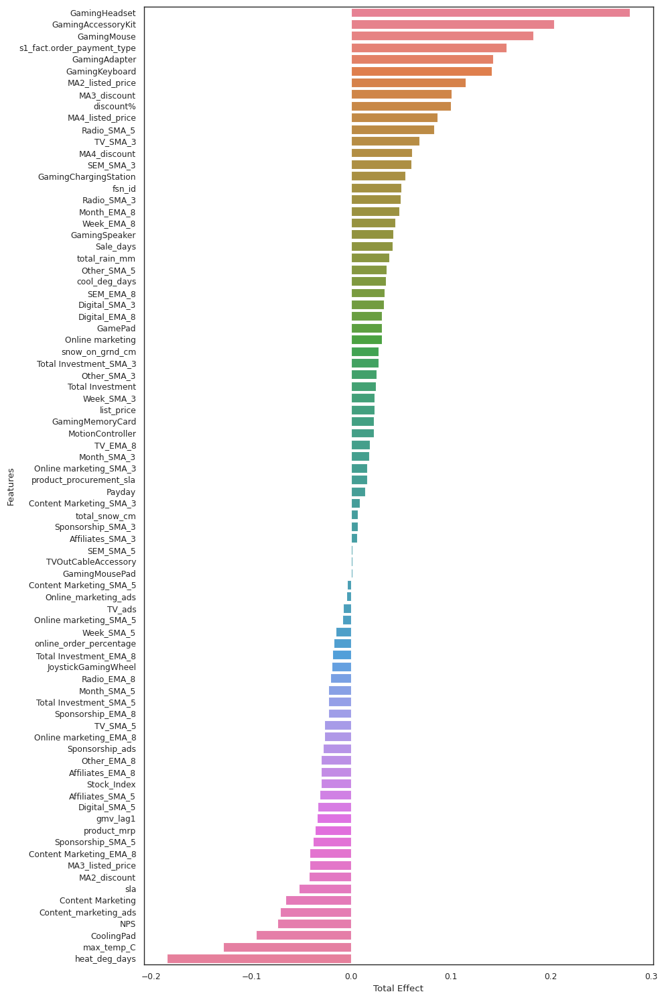

In [1120]:
# Slightly alter the figure size to make it more horizontal.
plt.figure(figsize=(10, 15), dpi=100, facecolor='w', edgecolor='k', frameon='True')
sns.barplot(y='Features', x='Total Effect', palette='husl', data=gamingaccessory_lr_coef_df, estimator=np.sum)
# Automatically adjust subplot params so that the subplotS fits in to the figure area.
plt.tight_layout()

# display the plot
plt.show()

##### The 5 most important features affecting GMV(Revenue) for gamingaccessory are:

|Features|Coefficients|
|--------|------------|
|product_vertical_gamingheadset|	0.199|
|product_vertical_gamingheadset	|0.172|
|is_mass_market	|0.163|
|product_vertical_gamingmouse|	0.125|
|product_vertical_gamingaccessorykit |0.106|

## Building Linear Regression model for `homeaudio`

In [1121]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

homeaudio_model = LinearRegression().fit(X_homeaudio_train, y_homeaudio_train)
y_homeaudio_test_pred = homeaudio_model.predict(X_homeaudio_test)

print('R2 Score: {}'.format(r2_score(y_homeaudio_test, y_homeaudio_test_pred)))
print('Mean Squared Error: {}'.format(mean_squared_error(y_homeaudio_test, y_homeaudio_test_pred)))

R2 Score: 0.9349360262100704
Mean Squared Error: 0.11443614964349487


In [1122]:
##### With Simple Linear Regression, we get a r2 score of 0.98 and mse of 0.03

In [1123]:
## Building Linear Regression model for `homeaudio` using K-fold Cross Validation

In [1124]:
y_homeaudio = homeaudio_koy_df.pop('gmv')
X_homeaudio = homeaudio_koy_df

In [1125]:
# Make cross validated predictions
from sklearn.model_selection import cross_val_score,cross_val_predict
from sklearn import metrics

homeaudio_model_cv = LinearRegression().fit(X_homeaudio, y_homeaudio)
homeaudio_predictions_cv = cross_val_predict(homeaudio_model_cv, X_homeaudio, y_homeaudio, cv=5)
accuracy = metrics.r2_score(y_homeaudio, homeaudio_predictions_cv)
print("Cross-Predicted Accuracy:", accuracy)
print('Mean Squared Error: {}'.format(mean_squared_error(y_homeaudio, homeaudio_predictions_cv)))

Cross-Predicted Accuracy: 0.8118683776156056
Mean Squared Error: 0.1881316223843944


In [1126]:
##### With Simple Linear Regression, using cross validation, we get a r2 score of 0.93 and mse score of 0.06

In [1127]:
## Determining Feature Importance for `homeaudio` with model without cv

In [1128]:
# linear regression model parameters
#Limiting floats output to 3 decimal points
pd.set_option('display.float_format', lambda x: '{:.3f}'.format(x)) 
pd.set_option('display.precision',1)


homeaudio_lr_model_parameters = list(homeaudio_model.coef_)
homeaudio_lr_model_parameters.insert(0, homeaudio_model.intercept_)
homeaudio_lr_model_parameters = [round(x, 3) for x in homeaudio_lr_model_parameters]
cols = homeaudio_test.columns
cols = cols.insert(0, "constant")
homeaudio_lr_coef = list(zip(cols, homeaudio_lr_model_parameters))
homeaudio_lr_coef

[('constant', -0.008),
 ('gmv_lag1', 0.032),
 ('list_price', 0.093),
 ('product_mrp', 0.152),
 ('discount%', 0.169),
 ('sla', -0.045),
 ('product_procurement_sla', -0.162),
 ('fsn_id', 0.118),
 ('s1_fact.order_payment_type', 0.09),
 ('HomeAudioSpeaker', 0.279),
 ('Dock', 0.023),
 ('BoomBox', 0.067),
 ('DockingStation', -0.07),
 ('DJController', -0.009),
 ('FMRadio', 0.194),
 ('HiFiSystem', 0.013),
 ('VoiceRecorder', 0.11),
 ('KaraokePlayer', 0.0),
 ('SlingBox', 0.046),
 ('SoundMixer', 0.08),
 ('Month_SMA_3', -0.012),
 ('Month_SMA_5', 0.014),
 ('Month_EMA_8', 0.005),
 ('Week_SMA_3', -0.019),
 ('Week_SMA_5', 0.009),
 ('Week_EMA_8', -0.006),
 ('Total Investment', -0.048),
 ('Total Investment_SMA_3', 0.003),
 ('Total Investment_SMA_5', -0.004),
 ('Total Investment_EMA_8', 0.005),
 ('TV_SMA_3', -0.024),
 ('TV_SMA_5', -0.004),
 ('TV_EMA_8', -0.003),
 ('Digital_SMA_3', 0.022),
 ('Digital_SMA_5', 0.008),
 ('Digital_EMA_8', -0.013),
 ('Sponsorship_SMA_3', 0.003),
 ('Sponsorship_SMA_5', -0.007),

In [1129]:
homeaudio_lr_coef_df = pd.DataFrame(homeaudio_lr_coef)
col_rename = {0:'Features',1: 'Coefficients'}
homeaudio_lr_coef_df = homeaudio_lr_coef_df.rename(columns=col_rename)
homeaudio_lr_coef_df = homeaudio_lr_coef_df.iloc[1:,:]
homeaudio_lr_coef_df = homeaudio_lr_coef_df.loc[homeaudio_lr_coef_df['Coefficients']!=0.0]
homeaudio_lr_coef_df = homeaudio_lr_coef_df.sort_values(by=['Coefficients'], ascending = False)
homeaudio_lr_coef_df

,Features,Coefficients
9,HomeAudioSpeaker,0.279
14,FMRadio,0.194
4,discount%,0.169
3,product_mrp,0.152
7,fsn_id,0.118
16,VoiceRecorder,0.110
2,list_price,0.093
8,s1_fact.order_payment_type,0.090
75,MA4_listed_price,0.089
19,SoundMixer,0.080


In [1130]:
## Determining Total Effect of KPIs from Koyck model
#Calculating the coefficient of lag variable
homeaudio_lr_coef_df.loc[homeaudio_lr_coef_df['Features'] == 'gmv_lag1'].Coefficients

1   0.032
Name: Coefficients, dtype: float64

In [1131]:
homeaudio_lr_coef_df['Total Effect'] = homeaudio_lr_coef_df['Coefficients']/(1-(0.060))
homeaudio_lr_coef_df

,Features,Coefficients,Total Effect
9,HomeAudioSpeaker,0.279,0.297
14,FMRadio,0.194,0.206
4,discount%,0.169,0.180
3,product_mrp,0.152,0.162
7,fsn_id,0.118,0.126
16,VoiceRecorder,0.110,0.117
2,list_price,0.093,0.099
8,s1_fact.order_payment_type,0.090,0.096
75,MA4_listed_price,0.089,0.095
19,SoundMixer,0.080,0.085


In [1132]:
## Plotting the Features in descending order of Importance for `homeaudio`

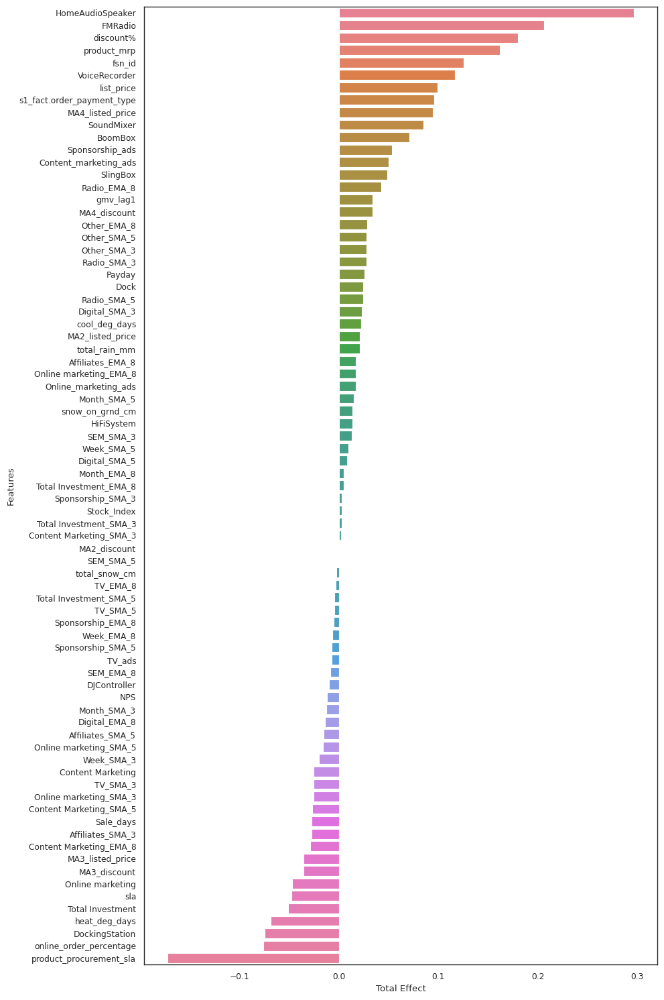

In [1133]:
# Slightly alter the figure size to make it more horizontal.
plt.figure(figsize=(10, 15), dpi=100, facecolor='w', edgecolor='k', frameon='True')
sns.barplot(y='Features', x='Total Effect', palette='husl', data=homeaudio_lr_coef_df, estimator=np.sum)
# Automatically adjust subplot params so that the subplotS fits in to the figure area.
plt.tight_layout()

# display the plot
plt.show()

##### The 5 most important features affecting GMV(Revenue) for homeaudio are:

|Features|Coefficients|
|--------|------------|
|product_vertical_homeaudiospeaker|	0.416|
|is_mass_market|	0.210|
|is_cod|	0.162|
|NPS|	0.120|
|Mean Temp	|0.107|

## Distributive Lag Model(Additive)

In [1134]:
# Making copy of dataframes from the original ones
cameraaccessory_dladd_df = camera_week_df.copy()
gamingaccessory_dladd_df = gaming_week_df.copy()
homeaudio_dladd_df = home_audio_week_df.copy()
homeaudio_dladd_df.head()

,Week,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,HomeAudioSpeaker,Dock,BoomBox,DockingStation,DJController,FMRadio,HiFiSystem,VoiceRecorder,KaraokePlayer,SlingBox,SoundMixer,Year,Month,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,Date,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
20,28,6608403.000,2002.174,4250.826,0.447,4.819,2.826,277,442,2701.000,35,28,3,0,453.000,22,53,0,0,0,2015.000,7.000,0.000,0.000,7.000,0.000,0.000,28.000,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.054,1.854,0.000,0.332,47.093,1052.000,0.000,0.000,10.950,1.116,4.848,1.117,0.165,13.414,0.016,-0.015,-0.003,0.114,0.073,0.090
21,29,4453585.000,1984.649,3836.581,0.392,5.479,2.795,278,387,1669.000,46,34,8,1,417.000,14,50,0,0,0,2015.000,7.000,0.000,0.000,7.000,0.000,0.000,28.222,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.143,12.578,1.116,2.562,0.117,4.593,17.285,-0.004,0.005,-0.018,-0.066,-0.016,-0.046
23,30,5550427.500,1928.914,3808.947,0.417,5.535,2.499,288,583,2198.000,56,23,14,0,482.000,18,73,0,0,0,2015.000,7.000,7.000,0.000,7.000,29.000,0.000,28.617,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.429,0.000,5.712,1.953,1.846,0.146,0.206,20.356,0.022,0.005,-0.006,0.102,0.089,0.045
24,31,4160893.000,1912.447,3563.507,0.382,5.688,2.655,273,380,1518.000,26,26,12,1,499.000,17,68,0,0,0,2015.000,7.000,7.000,0.000,7.000,30.000,0.000,29.147,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.000,7.725,1.674,1.846,0.146,0.206,17.536,-0.004,0.009,-0.003,-0.044,0.006,-0.002
25,32,6607912.000,2025.304,4077.258,0.428,4.892,2.758,289,506,2532.000,28,37,4,0,564.000,18,75,0,0,0,2015.000,8.000,7.333,7.200,7.222,31.000,30.000,29.781,1.013,3.181,3.615,3.542,0.036,0.043,0.042,0.507,0.558,0.549,1.307,1.526,1.489,0.000,0.000,0.000,0.000,0.026,0.230,0.271,0.264,0.096,0.113,0.110,1.005,1.105,1.089,0.000,0.000,0.000,0.000,0.000,0.000,2015-08-01 00:00:00,0.028,1.140,0.000,0.192,50.327,1222.000,0.286,0.143,9.607,1.116,2.622,0.088,0.124,15.531,0.029,0.036,0.050,0.057,0.046,0.093


In [1135]:
cameraaccessory_dladd_df = cameraaccessory_dladd_df.drop(['Week','Year','Month','Date'], axis=1)
gamingaccessory_dladd_df = gamingaccessory_dladd_df.drop(['Week','Year','Month','Date'], axis=1)
homeaudio_dladd_df = homeaudio_dladd_df.drop(['Week','Year','Month','Date'], axis=1)
homeaudio_dladd_df.head()

,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,HomeAudioSpeaker,Dock,BoomBox,DockingStation,DJController,FMRadio,HiFiSystem,VoiceRecorder,KaraokePlayer,SlingBox,SoundMixer,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
20,6608403.000,2002.174,4250.826,0.447,4.819,2.826,277,442,2701.000,35,28,3,0,453.000,22,53,0,0,0,0.000,0.000,7.000,0.000,0.000,28.000,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.054,1.854,0.000,0.332,47.093,1052.000,0.000,0.000,10.950,1.116,4.848,1.117,0.165,13.414,0.016,-0.015,-0.003,0.114,0.073,0.090
21,4453585.000,1984.649,3836.581,0.392,5.479,2.795,278,387,1669.000,46,34,8,1,417.000,14,50,0,0,0,0.000,0.000,7.000,0.000,0.000,28.222,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.143,12.578,1.116,2.562,0.117,4.593,17.285,-0.004,0.005,-0.018,-0.066,-0.016,-0.046
23,5550427.500,1928.914,3808.947,0.417,5.535,2.499,288,583,2198.000,56,23,14,0,482.000,18,73,0,0,0,7.000,0.000,7.000,29.000,0.000,28.617,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.081,2.781,0.000,0.498,47.093,1052.000,0.429,0.000,5.712,1.953,1.846,0.146,0.206,20.356,0.022,0.005,-0.006,0.102,0.089,0.045
24,4160893.000,1912.447,3563.507,0.382,5.688,2.655,273,380,1518.000,26,26,12,1,499.000,17,68,0,0,0,7.000,0.000,7.000,30.000,0.000,29.147,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.000,7.725,1.674,1.846,0.146,0.206,17.536,-0.004,0.009,-0.003,-0.044,0.006,-0.002
25,6607912.000,2025.304,4077.258,0.428,4.892,2.758,289,506,2532.000,28,37,4,0,564.000,18,75,0,0,0,7.333,7.200,7.222,31.000,30.000,29.781,1.013,3.181,3.615,3.542,0.036,0.043,0.042,0.507,0.558,0.549,1.307,1.526,1.489,0.000,0.000,0.000,0.000,0.026,0.230,0.271,0.264,0.096,0.113,0.110,1.005,1.105,1.089,0.000,0.000,0.000,0.000,0.000,0.000,0.028,1.140,0.000,0.192,50.327,1222.000,0.286,0.143,9.607,1.116,2.622,0.088,0.124,15.531,0.029,0.036,0.050,0.057,0.046,0.093


In [1136]:
### Creating new lag(Lag of 3 weeks) variables for the dependent variable (GMV) as well as independent variables

In [1137]:
cameraaccessory_dladd_df_columns = cameraaccessory_dladd_df.columns
gamingaccessory_dladd_df_columns = gamingaccessory_dladd_df.columns
homeaudio_dladd_df_columns = homeaudio_dladd_df.columns

In [1138]:
cameraaccessory_dladd_df = lag_variables(cameraaccessory_dladd_df,cameraaccessory_dladd_df_columns,3)
gamingaccessory_dladd_df = lag_variables(gamingaccessory_dladd_df,gamingaccessory_dladd_df_columns,3)
homeaudio_dladd_df = lag_variables(homeaudio_dladd_df,homeaudio_dladd_df_columns,3)
homeaudio_dladd_df.head()

,gmv,gmv_lag3,list_price,list_price_lag3,product_mrp,product_mrp_lag3,discount%,discount%_lag3,sla,sla_lag3,product_procurement_sla,product_procurement_sla_lag3,fsn_id,fsn_id_lag3,s1_fact.order_payment_type,s1_fact.order_payment_type_lag3,HomeAudioSpeaker,HomeAudioSpeaker_lag3,Dock,Dock_lag3,BoomBox,BoomBox_lag3,DockingStation,DockingStation_lag3,DJController,DJController_lag3,FMRadio,FMRadio_lag3,HiFiSystem,HiFiSystem_lag3,VoiceRecorder,VoiceRecorder_lag3,KaraokePlayer,KaraokePlayer_lag3,SlingBox,SlingBox_lag3,SoundMixer,SoundMixer_lag3,Month_SMA_3,Month_SMA_3_lag3,Month_SMA_5,Month_SMA_5_lag3,Month_EMA_8,Month_EMA_8_lag3,Week_SMA_3,Week_SMA_3_lag3,Week_SMA_5,Week_SMA_5_lag3,Week_EMA_8,Week_EMA_8_lag3,...,Radio_SMA_5,Radio_SMA_5_lag3,Radio_EMA_8,Radio_EMA_8_lag3,Other_SMA_3,Other_SMA_3_lag3,Other_SMA_5,Other_SMA_5_lag3,Other_EMA_8,Other_EMA_8_lag3,TV_ads,TV_ads_lag3,Sponsorship_ads,Sponsorship_ads_lag3,Content_marketing_ads,Content_marketing_ads_lag3,Online_marketing_ads,Online_marketing_ads_lag3,NPS,NPS_lag3,Stock_Index,Stock_Index_lag3,Sale_days,Sale_days_lag3,Payday,Payday_lag3,heat_deg_days,heat_deg_days_lag3,cool_deg_days,cool_deg_days_lag3,total_rain_mm,total_rain_mm_lag3,total_snow_cm,total_snow_cm_lag3,snow_on_grnd_cm,snow_on_grnd_cm_lag3,online_order_percentage,online_order_percentage_lag3,MA2_listed_price,MA2_listed_price_lag3,MA3_listed_price,MA3_listed_price_lag3,MA4_listed_price,MA4_listed_price_lag3,MA2_discount,MA2_discount_lag3,MA3_discount,MA3_discount_lag3,MA4_discount,MA4_discount_lag3
20,6608403.000,nan,2002.174,nan,4250.826,nan,0.447,nan,4.819,nan,2.826,nan,277,nan,442,nan,2701.000,nan,35,nan,28,nan,3,nan,0,nan,453.000,nan,22,nan,53,nan,0,nan,0,nan,0,nan,0.000,nan,0.000,nan,7.000,nan,0.000,nan,0.000,nan,28.000,nan,...,0.000,nan,0.000,nan,0.000,nan,0.000,nan,0.000,nan,0.054,nan,1.854,nan,0.000,nan,0.332,nan,47.093,nan,1052.000,nan,0.000,nan,0.000,nan,10.950,nan,1.116,nan,4.848,nan,1.117,nan,0.165,nan,13.414,nan,0.016,nan,-0.015,nan,-0.003,nan,0.114,nan,0.073,nan,0.090,nan
21,4453585.000,nan,1984.649,nan,3836.581,nan,0.392,nan,5.479,nan,2.795,nan,278,nan,387,nan,1669.000,nan,46,nan,34,nan,8,nan,1,nan,417.000,nan,14,nan,50,nan,0,nan,0,nan,0,nan,0.000,nan,0.000,nan,7.000,nan,0.000,nan,0.000,nan,28.222,nan,...,0.000,nan,0.000,nan,0.000,nan,0.000,nan,0.000,nan,0.081,nan,2.781,nan,0.000,nan,0.498,nan,47.093,nan,1052.000,nan,0.000,nan,0.143,nan,12.578,nan,1.116,nan,2.562,nan,0.117,nan,4.593,nan,17.285,nan,-0.004,nan,0.005,nan,-0.018,nan,-0.066,nan,-0.016,nan,-0.046,nan
23,5550427.500,nan,1928.914,nan,3808.947,nan,0.417,nan,5.535,nan,2.499,nan,288,nan,583,nan,2198.000,nan,56,nan,23,nan,14,nan,0,nan,482.000,nan,18,nan,73,nan,0,nan,0,nan,0,nan,7.000,nan,0.000,nan,7.000,nan,29.000,nan,0.000,nan,28.617,nan,...,0.000,nan,0.000,nan,0.000,nan,0.000,nan,0.000,nan,0.081,nan,2.781,nan,0.000,nan,0.498,nan,47.093,nan,1052.000,nan,0.429,nan,0.000,nan,5.712,nan,1.953,nan,1.846,nan,0.146,nan,0.206,nan,20.356,nan,0.022,nan,0.005,nan,-0.006,nan,0.102,nan,0.089,nan,0.045,nan
24,4160893.000,6608403.000,1912.447,2002.174,3563.507,4250.826,0.382,0.447,5.688,4.819,2.655,2.826,273,277.000,380,442.000,1518.000,2701.000,26,35.000,26,28.000,12,3.000,1,0.000,499.000,453.000,17,22.000,68,53.000,0,0.000,0,0.000,0,0.000,7.000,0.000,0.000,0.000,7.000,7.000,30.000,0.000,0.000,0.000,29.147,28.000,...,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.081,0.054,2.781,1.854,0.000,0.000,0.498,0.332,47.093,47.093,1052.000,1052.000,0.000,0.000,0.000,0.000,7.725,10.950,1.674,1.116,1.846,4.848,0.146,1.117,0.206,0.165,17.536,13.414,-0.004,0.016,0.009,-0.015,-0.003,-0.003,-0.044,0.114,0.006,0.073,-0.002,0.090
25,6607912.000,4453585.000,2025.304,1984.649,4077.258,3836.581,0.428,0.392,4.892,5.479,2.758,2.795,289,278.000,506,387.000,2532.000,1669.000,28,46.000,37,34.000,4,8.000,0,1.000,564.000,417.000,18,14.000,75,50.000,0,0.000,0,0.000,0,0.000,7.333,0.000,7.200,0.000,7.222,7.000,31.000,0.000,30.000,0.000,29.781,28.222,...,0.000,0.000,0.000,0.000,

In [1139]:
### Creating new lag(Lag of 2 weeks) variables for the dependent variable (GMV) as well as independent variables

In [1140]:
cameraaccessory_dladd_df = lag_variables(cameraaccessory_dladd_df,cameraaccessory_dladd_df_columns,2)
gamingaccessory_dladd_df = lag_variables(gamingaccessory_dladd_df,gamingaccessory_dladd_df_columns,2)
homeaudio_dladd_df = lag_variables(homeaudio_dladd_df,homeaudio_dladd_df_columns,2)
homeaudio_dladd_df.head()

,gmv,gmv_lag2,gmv_lag3,list_price,list_price_lag2,list_price_lag3,product_mrp,product_mrp_lag2,product_mrp_lag3,discount%,discount%_lag2,discount%_lag3,sla,sla_lag2,sla_lag3,product_procurement_sla,product_procurement_sla_lag2,product_procurement_sla_lag3,fsn_id,fsn_id_lag2,fsn_id_lag3,s1_fact.order_payment_type,s1_fact.order_payment_type_lag2,s1_fact.order_payment_type_lag3,HomeAudioSpeaker,HomeAudioSpeaker_lag2,HomeAudioSpeaker_lag3,Dock,Dock_lag2,Dock_lag3,BoomBox,BoomBox_lag2,BoomBox_lag3,DockingStation,DockingStation_lag2,DockingStation_lag3,DJController,DJController_lag2,DJController_lag3,FMRadio,FMRadio_lag2,FMRadio_lag3,HiFiSystem,HiFiSystem_lag2,HiFiSystem_lag3,VoiceRecorder,VoiceRecorder_lag2,VoiceRecorder_lag3,KaraokePlayer,KaraokePlayer_lag2,...,Online_marketing_ads_lag2,Online_marketing_ads_lag3,NPS,NPS_lag2,NPS_lag3,Stock_Index,Stock_Index_lag2,Stock_Index_lag3,Sale_days,Sale_days_lag2,Sale_days_lag3,Payday,Payday_lag2,Payday_lag3,heat_deg_days,heat_deg_days_lag2,heat_deg_days_lag3,cool_deg_days,cool_deg_days_lag2,cool_deg_days_lag3,total_rain_mm,total_rain_mm_lag2,total_rain_mm_lag3,total_snow_cm,total_snow_cm_lag2,total_snow_cm_lag3,snow_on_grnd_cm,snow_on_grnd_cm_lag2,snow_on_grnd_cm_lag3,online_order_percentage,online_order_percentage_lag2,online_order_percentage_lag3,MA2_listed_price,MA2_listed_price_lag2,MA2_listed_price_lag3,MA3_listed_price,MA3_listed_price_lag2,MA3_listed_price_lag3,MA4_listed_price,MA4_listed_price_lag2,MA4_listed_price_lag3,MA2_discount,MA2_discount_lag2,MA2_discount_lag3,MA3_discount,MA3_discount_lag2,MA3_discount_lag3,MA4_discount,MA4_discount_lag2,MA4_discount_lag3
20,6608403.000,nan,nan,2002.174,nan,nan,4250.826,nan,nan,0.447,nan,nan,4.819,nan,nan,2.826,nan,nan,277,nan,nan,442,nan,nan,2701.000,nan,nan,35,nan,nan,28,nan,nan,3,nan,nan,0,nan,nan,453.000,nan,nan,22,nan,nan,53,nan,nan,0,nan,...,nan,nan,47.093,nan,nan,1052.000,nan,nan,0.000,nan,nan,0.000,nan,nan,10.950,nan,nan,1.116,nan,nan,4.848,nan,nan,1.117,nan,nan,0.165,nan,nan,13.414,nan,nan,0.016,nan,nan,-0.015,nan,nan,-0.003,nan,nan,0.114,nan,nan,0.073,nan,nan,0.090,nan,nan
21,4453585.000,nan,nan,1984.649,nan,nan,3836.581,nan,nan,0.392,nan,nan,5.479,nan,nan,2.795,nan,nan,278,nan,nan,387,nan,nan,1669.000,nan,nan,46,nan,nan,34,nan,nan,8,nan,nan,1,nan,nan,417.000,nan,nan,14,nan,nan,50,nan,nan,0,nan,...,nan,nan,47.093,nan,nan,1052.000,nan,nan,0.000,nan,nan,0.143,nan,nan,12.578,nan,nan,1.116,nan,nan,2.562,nan,nan,0.117,nan,nan,4.593,nan,nan,17.285,nan,nan,-0.004,nan,nan,0.005,nan,nan,-0.018,nan,nan,-0.066,nan,nan,-0.016,nan,nan,-0.046,nan,nan
23,5550427.500,6608403.000,nan,1928.914,2002.174,nan,3808.947,4250.826,nan,0.417,0.447,nan,5.535,4.819,nan,2.499,2.826,nan,288,277.000,nan,583,442.000,nan,2198.000,2701.000,nan,56,35.000,nan,23,28.000,nan,14,3.000,nan,0,0.000,nan,482.000,453.000,nan,18,22.000,nan,73,53.000,nan,0,0.000,...,0.332,nan,47.093,47.093,nan,1052.000,1052.000,nan,0.429,0.000,nan,0.000,0.000,nan,5.712,10.950,nan,1.953,1.116,nan,1.846,4.848,nan,0.146,1.117,nan,0.206,0.165,nan,20.356,13.414,nan,0.022,0.016,nan,0.005,-0.015,nan,-0.006,-0.003,nan,0.102,0.114,nan,0.089,0.073,nan,0.045,0.090,nan
24,4160893.000,4453585.000,6608403.000,1912.447,1984.649,2002.174,3563.507,3836.581,4250.826,0.382,0.392,0.447,5.688,5.479,4.819,2.655,2.795,2.826,273,278.000,277.000,380,387.000,442.000,1518.000,1669.000,2701.000,26,46.000,35.000,26,34.000,28.000,12,8.000,3.000,1,1.000,0.000,499.000,417.000,453.000,17,14.000,22.000,68,50.000,53.000,0,0.000,...,0.498,0.332,47.093,47.093,47.093,1052.000,1052.000,1052.000,0.000,0.000,0.000,0.000,0.143,0.000,7.725,12.578,10.950,1.674,1.116,1.116,1.846,2.562,4.848,0.146,0.117,1.117,0.206,4.593,0.165,17.536,17.285,13.414,-0.004,-0.004,0.016,0.009,0.005,-0.015,-0.003,-0.018,-0.003,-0.044,-0.066,0.114,0.006,-0.016,0.073,-0.002,-0.046,0.090
25,6607912.000,5550427.500,4453585.000,2025.304,1928.914,1984.649,4077.258,3808.947,3836.581,0.428,0.417,0.392,4.892,5.535,5.479,2.758,2.499,2.795,289,288.000,278.000,506,583.

In [1141]:
### Creating new lag(Lag of 1 week) variables for the dependent variable (GMV) as well as independent variables

In [1142]:
cameraaccessory_dladd_df = lag_variables(cameraaccessory_dladd_df,cameraaccessory_dladd_df_columns,1)
gamingaccessory_dladd_df = lag_variables(gamingaccessory_dladd_df,gamingaccessory_dladd_df_columns,1)
homeaudio_dladd_df = lag_variables(homeaudio_dladd_df,homeaudio_dladd_df_columns,1)
homeaudio_dladd_df.head()

,gmv,gmv_lag1,gmv_lag2,gmv_lag3,list_price,list_price_lag1,list_price_lag2,list_price_lag3,product_mrp,product_mrp_lag1,product_mrp_lag2,product_mrp_lag3,discount%,discount%_lag1,discount%_lag2,discount%_lag3,sla,sla_lag1,sla_lag2,sla_lag3,product_procurement_sla,product_procurement_sla_lag1,product_procurement_sla_lag2,product_procurement_sla_lag3,fsn_id,fsn_id_lag1,fsn_id_lag2,fsn_id_lag3,s1_fact.order_payment_type,s1_fact.order_payment_type_lag1,s1_fact.order_payment_type_lag2,s1_fact.order_payment_type_lag3,HomeAudioSpeaker,HomeAudioSpeaker_lag1,HomeAudioSpeaker_lag2,HomeAudioSpeaker_lag3,Dock,Dock_lag1,Dock_lag2,Dock_lag3,BoomBox,BoomBox_lag1,BoomBox_lag2,BoomBox_lag3,DockingStation,DockingStation_lag1,DockingStation_lag2,DockingStation_lag3,DJController,DJController_lag1,...,Payday_lag2,Payday_lag3,heat_deg_days,heat_deg_days_lag1,heat_deg_days_lag2,heat_deg_days_lag3,cool_deg_days,cool_deg_days_lag1,cool_deg_days_lag2,cool_deg_days_lag3,total_rain_mm,total_rain_mm_lag1,total_rain_mm_lag2,total_rain_mm_lag3,total_snow_cm,total_snow_cm_lag1,total_snow_cm_lag2,total_snow_cm_lag3,snow_on_grnd_cm,snow_on_grnd_cm_lag1,snow_on_grnd_cm_lag2,snow_on_grnd_cm_lag3,online_order_percentage,online_order_percentage_lag1,online_order_percentage_lag2,online_order_percentage_lag3,MA2_listed_price,MA2_listed_price_lag1,MA2_listed_price_lag2,MA2_listed_price_lag3,MA3_listed_price,MA3_listed_price_lag1,MA3_listed_price_lag2,MA3_listed_price_lag3,MA4_listed_price,MA4_listed_price_lag1,MA4_listed_price_lag2,MA4_listed_price_lag3,MA2_discount,MA2_discount_lag1,MA2_discount_lag2,MA2_discount_lag3,MA3_discount,MA3_discount_lag1,MA3_discount_lag2,MA3_discount_lag3,MA4_discount,MA4_discount_lag1,MA4_discount_lag2,MA4_discount_lag3
20,6608403.000,nan,nan,nan,2002.174,nan,nan,nan,4250.826,nan,nan,nan,0.447,nan,nan,nan,4.819,nan,nan,nan,2.826,nan,nan,nan,277,nan,nan,nan,442,nan,nan,nan,2701.000,nan,nan,nan,35,nan,nan,nan,28,nan,nan,nan,3,nan,nan,nan,0,nan,...,nan,nan,10.950,nan,nan,nan,1.116,nan,nan,nan,4.848,nan,nan,nan,1.117,nan,nan,nan,0.165,nan,nan,nan,13.414,nan,nan,nan,0.016,nan,nan,nan,-0.015,nan,nan,nan,-0.003,nan,nan,nan,0.114,nan,nan,nan,0.073,nan,nan,nan,0.090,nan,nan,nan
21,4453585.000,6608403.000,nan,nan,1984.649,2002.174,nan,nan,3836.581,4250.826,nan,nan,0.392,0.447,nan,nan,5.479,4.819,nan,nan,2.795,2.826,nan,nan,278,277.000,nan,nan,387,442.000,nan,nan,1669.000,2701.000,nan,nan,46,35.000,nan,nan,34,28.000,nan,nan,8,3.000,nan,nan,1,0.000,...,nan,nan,12.578,10.950,nan,nan,1.116,1.116,nan,nan,2.562,4.848,nan,nan,0.117,1.117,nan,nan,4.593,0.165,nan,nan,17.285,13.414,nan,nan,-0.004,0.016,nan,nan,0.005,-0.015,nan,nan,-0.018,-0.003,nan,nan,-0.066,0.114,nan,nan,-0.016,0.073,nan,nan,-0.046,0.090,nan,nan
23,5550427.500,4453585.000,6608403.000,nan,1928.914,1984.649,2002.174,nan,3808.947,3836.581,4250.826,nan,0.417,0.392,0.447,nan,5.535,5.479,4.819,nan,2.499,2.795,2.826,nan,288,278.000,277.000,nan,583,387.000,442.000,nan,2198.000,1669.000,2701.000,nan,56,46.000,35.000,nan,23,34.000,28.000,nan,14,8.000,3.000,nan,0,1.000,...,0.000,nan,5.712,12.578,10.950,nan,1.953,1.116,1.116,nan,1.846,2.562,4.848,nan,0.146,0.117,1.117,nan,0.206,4.593,0.165,nan,20.356,17.285,13.414,nan,0.022,-0.004,0.016,nan,0.005,0.005,-0.015,nan,-0.006,-0.018,-0.003,nan,0.102,-0.066,0.114,nan,0.089,-0.016,0.073,nan,0.045,-0.046,0.090,nan
24,4160893.000,5550427.500,4453585.000,6608403.000,1912.447,1928.914,1984.649,2002.174,3563.507,3808.947,3836.581,4250.826,0.382,0.417,0.392,0.447,5.688,5.535,5.479,4.819,2.655,2.499,2.795,2.826,273,288.000,278.000,277.000,380,583.000,387.000,442.000,1518.000,2198.000,1669.000,2701.000,26,56.000,46.000,35.000,26,23.000,34.000,28.000,12,14.000,8.000,3.000,1,0.000,...,0.143,0.000,7.725,5.712,12.578,10.950,1.674,1.953,1.116,1.116,1.846,1.846,2.562,4.848,0.146,0.146,0.117,1.117,0.206,0.206,4.593,0.165,17.536,20.356,17.285,13.414,-0.004,0.022,-0.004,0.016,0.009,0.005,0.005,-0.015,-0.003,-0.006,-0.018,-0.003,-0.044,0.102,-0.066,0.114,0.006,0.089,-0.016,0

In [1143]:
####  Imputing all null values with 0

In [1144]:
cameraaccessory_dladd_df.fillna(value=0, inplace=True)
gamingaccessory_dladd_df.fillna(value=0, inplace=True)
homeaudio_dladd_df.fillna(value=0, inplace=True)
homeaudio_dladd_df.head(10)

,gmv,gmv_lag1,gmv_lag2,gmv_lag3,list_price,list_price_lag1,list_price_lag2,list_price_lag3,product_mrp,product_mrp_lag1,product_mrp_lag2,product_mrp_lag3,discount%,discount%_lag1,discount%_lag2,discount%_lag3,sla,sla_lag1,sla_lag2,sla_lag3,product_procurement_sla,product_procurement_sla_lag1,product_procurement_sla_lag2,product_procurement_sla_lag3,fsn_id,fsn_id_lag1,fsn_id_lag2,fsn_id_lag3,s1_fact.order_payment_type,s1_fact.order_payment_type_lag1,s1_fact.order_payment_type_lag2,s1_fact.order_payment_type_lag3,HomeAudioSpeaker,HomeAudioSpeaker_lag1,HomeAudioSpeaker_lag2,HomeAudioSpeaker_lag3,Dock,Dock_lag1,Dock_lag2,Dock_lag3,BoomBox,BoomBox_lag1,BoomBox_lag2,BoomBox_lag3,DockingStation,DockingStation_lag1,DockingStation_lag2,DockingStation_lag3,DJController,DJController_lag1,...,Payday_lag2,Payday_lag3,heat_deg_days,heat_deg_days_lag1,heat_deg_days_lag2,heat_deg_days_lag3,cool_deg_days,cool_deg_days_lag1,cool_deg_days_lag2,cool_deg_days_lag3,total_rain_mm,total_rain_mm_lag1,total_rain_mm_lag2,total_rain_mm_lag3,total_snow_cm,total_snow_cm_lag1,total_snow_cm_lag2,total_snow_cm_lag3,snow_on_grnd_cm,snow_on_grnd_cm_lag1,snow_on_grnd_cm_lag2,snow_on_grnd_cm_lag3,online_order_percentage,online_order_percentage_lag1,online_order_percentage_lag2,online_order_percentage_lag3,MA2_listed_price,MA2_listed_price_lag1,MA2_listed_price_lag2,MA2_listed_price_lag3,MA3_listed_price,MA3_listed_price_lag1,MA3_listed_price_lag2,MA3_listed_price_lag3,MA4_listed_price,MA4_listed_price_lag1,MA4_listed_price_lag2,MA4_listed_price_lag3,MA2_discount,MA2_discount_lag1,MA2_discount_lag2,MA2_discount_lag3,MA3_discount,MA3_discount_lag1,MA3_discount_lag2,MA3_discount_lag3,MA4_discount,MA4_discount_lag1,MA4_discount_lag2,MA4_discount_lag3
20,6608403.000,0.000,0.000,0.000,2002.174,0.000,0.000,0.000,4250.826,0.000,0.000,0.000,0.447,0.000,0.000,0.000,4.819,0.000,0.000,0.000,2.826,0.000,0.000,0.000,277,0.000,0.000,0.000,442,0.000,0.000,0.000,2701.000,0.000,0.000,0.000,35,0.000,0.000,0.000,28,0.000,0.000,0.000,3,0.000,0.000,0.000,0,0.000,...,0.000,0.000,10.950,0.000,0.000,0.000,1.116,0.000,0.000,0.000,4.848,0.000,0.000,0.000,1.117,0.000,0.000,0.000,0.165,0.000,0.000,0.000,13.414,0.000,0.000,0.000,0.016,0.000,0.000,0.000,-0.015,0.000,0.000,0.000,-0.003,0.000,0.000,0.000,0.114,0.000,0.000,0.000,0.073,0.000,0.000,0.000,0.090,0.000,0.000,0.000
21,4453585.000,6608403.000,0.000,0.000,1984.649,2002.174,0.000,0.000,3836.581,4250.826,0.000,0.000,0.392,0.447,0.000,0.000,5.479,4.819,0.000,0.000,2.795,2.826,0.000,0.000,278,277.000,0.000,0.000,387,442.000,0.000,0.000,1669.000,2701.000,0.000,0.000,46,35.000,0.000,0.000,34,28.000,0.000,0.000,8,3.000,0.000,0.000,1,0.000,...,0.000,0.000,12.578,10.950,0.000,0.000,1.116,1.116,0.000,0.000,2.562,4.848,0.000,0.000,0.117,1.117,0.000,0.000,4.593,0.165,0.000,0.000,17.285,13.414,0.000,0.000,-0.004,0.016,0.000,0.000,0.005,-0.015,0.000,0.000,-0.018,-0.003,0.000,0.000,-0.066,0.114,0.000,0.000,-0.016,0.073,0.000,0.000,-0.046,0.090,0.000,0.000
23,5550427.500,4453585.000,6608403.000,0.000,1928.914,1984.649,2002.174,0.000,3808.947,3836.581,4250.826,0.000,0.417,0.392,0.447,0.000,5.535,5.479,4.819,0.000,2.499,2.795,2.826,0.000,288,278.000,277.000,0.000,583,387.000,442.000,0.000,2198.000,1669.000,2701.000,0.000,56,46.000,35.000,0.000,23,34.000,28.000,0.000,14,8.000,3.000,0.000,0,1.000,...,0.000,0.000,5.712,12.578,10.950,0.000,1.953,1.116,1.116,0.000,1.846,2.562,4.848,0.000,0.146,0.117,1.117,0.000,0.206,4.593,0.165,0.000,20.356,17.285,13.414,0.000,0.022,-0.004,0.016,0.000,0.005,0.005,-0.015,0.000,-0.006,-0.018,-0.003,0.000,0.102,-0.066,0.114,0.000,0.089,-0.016,0.073,0.000,0.045,-0.046,0.090,0.000
24,4160893.000,5550427.500,4453585.000,6608403.000,1912.447,1928.914,1984.649,2002.174,3563.507,3808.947,3836.581,4250.826,0.382,0.417,0.392,0.447,5.688,5.535,5.479,4.819,2.655,2.499,2.795,2.826,273,288.000,278.000,277.000,380,583.000,387.000,442.000,1518.000,2198.000,1669.000,2701.000,26,56.000,46.000,35.000,26,23.000,34.000,28.000,12,14.000,8.000,3.000

In [1145]:
## Rescaling the Features of the 3 Dataframes
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

cameraaccessory_dladd_df[cameraaccessory_dladd_df.columns]=scaler.fit_transform(cameraaccessory_dladd_df[cameraaccessory_dladd_df.columns])
gamingaccessory_dladd_df[gamingaccessory_dladd_df.columns]=scaler.fit_transform(gamingaccessory_dladd_df[gamingaccessory_dladd_df.columns])
homeaudio_dladd_df[homeaudio_dladd_df.columns]=scaler.fit_transform(homeaudio_dladd_df[homeaudio_dladd_df.columns])

homeaudio_dladd_df.head()

,gmv,gmv_lag1,gmv_lag2,gmv_lag3,list_price,list_price_lag1,list_price_lag2,list_price_lag3,product_mrp,product_mrp_lag1,product_mrp_lag2,product_mrp_lag3,discount%,discount%_lag1,discount%_lag2,discount%_lag3,sla,sla_lag1,sla_lag2,sla_lag3,product_procurement_sla,product_procurement_sla_lag1,product_procurement_sla_lag2,product_procurement_sla_lag3,fsn_id,fsn_id_lag1,fsn_id_lag2,fsn_id_lag3,s1_fact.order_payment_type,s1_fact.order_payment_type_lag1,s1_fact.order_payment_type_lag2,s1_fact.order_payment_type_lag3,HomeAudioSpeaker,HomeAudioSpeaker_lag1,HomeAudioSpeaker_lag2,HomeAudioSpeaker_lag3,Dock,Dock_lag1,Dock_lag2,Dock_lag3,BoomBox,BoomBox_lag1,BoomBox_lag2,BoomBox_lag3,DockingStation,DockingStation_lag1,DockingStation_lag2,DockingStation_lag3,DJController,DJController_lag1,...,Payday_lag2,Payday_lag3,heat_deg_days,heat_deg_days_lag1,heat_deg_days_lag2,heat_deg_days_lag3,cool_deg_days,cool_deg_days_lag1,cool_deg_days_lag2,cool_deg_days_lag3,total_rain_mm,total_rain_mm_lag1,total_rain_mm_lag2,total_rain_mm_lag3,total_snow_cm,total_snow_cm_lag1,total_snow_cm_lag2,total_snow_cm_lag3,snow_on_grnd_cm,snow_on_grnd_cm_lag1,snow_on_grnd_cm_lag2,snow_on_grnd_cm_lag3,online_order_percentage,online_order_percentage_lag1,online_order_percentage_lag2,online_order_percentage_lag3,MA2_listed_price,MA2_listed_price_lag1,MA2_listed_price_lag2,MA2_listed_price_lag3,MA3_listed_price,MA3_listed_price_lag1,MA3_listed_price_lag2,MA3_listed_price_lag3,MA4_listed_price,MA4_listed_price_lag1,MA4_listed_price_lag2,MA4_listed_price_lag3,MA2_discount,MA2_discount_lag1,MA2_discount_lag2,MA2_discount_lag3,MA3_discount,MA3_discount_lag1,MA3_discount_lag2,MA3_discount_lag3,MA4_discount,MA4_discount_lag1,MA4_discount_lag2,MA4_discount_lag3
20,1.158,-1.943,-1.838,-1.741,0.807,-6.159,-4.552,-3.749,1.985,-5.072,-4.049,-3.445,2.113,-5.637,-4.331,-3.621,-0.920,-4.787,-3.930,-3.395,1.101,-6.157,-4.551,-3.748,0.237,-4.093,-3.485,-3.073,-0.251,-1.464,-1.409,-1.353,1.307,-1.699,-1.621,-1.547,-0.099,-1.474,-1.407,-1.345,-0.579,-1.694,-1.614,-1.536,-0.763,-1.319,-1.319,-1.309,-0.388,-0.388,...,-0.897,-0.861,1.446,-1.682,-1.650,-1.633,-0.521,-1.345,-1.307,-1.294,1.175,-1.261,-1.235,-1.203,2.599,-0.609,-0.607,-0.604,-0.197,-0.436,-0.435,-0.433,-0.645,-1.220,-1.185,-1.148,0.472,0.024,0.037,0.017,-0.292,0.021,0.020,-0.004,-0.007,0.030,0.019,-0.001,2.040,0.036,0.026,0.001,1.243,0.058,0.042,-0.003,1.474,0.089,0.062,0.026
21,0.115,1.144,-1.838,-1.741,0.680,0.496,-4.552,-3.749,1.055,1.455,-4.049,-3.445,0.635,1.348,-4.331,-3.621,-0.152,-0.563,-3.930,-3.395,0.938,0.636,-4.551,-3.748,0.256,0.258,-3.485,-3.073,-0.408,-0.227,-1.409,-1.353,0.133,1.295,-1.621,-1.547,0.356,-0.061,-1.407,-1.345,-0.322,-0.530,-1.614,-1.536,0.162,-0.763,-1.319,-1.309,1.986,-0.388,...,-0.897,-0.861,1.913,1.439,-1.650,-1.633,-0.521,-0.470,-1.307,-1.294,0.000,1.211,-1.235,-1.203,-0.275,2.598,-0.607,-0.604,6.267,-0.196,-0.435,-0.433,-0.468,-0.615,-1.185,-1.148,-0.076,0.457,0.037,0.017,0.150,-0.322,0.020,-0.004,-0.311,-0.024,0.019,-0.001,-1.115,2.035,0.026,0.001,-0.187,1.233,0.042,-0.003,-0.600,1.465,0.062,0.026
23,0.646,0.137,1.139,-1.741,0.276,0.437,0.466,-3.749,0.993,0.819,1.260,-3.445,1.303,0.478,1.137,-3.621,-0.087,0.016,-0.367,-3.395,-0.611,0.561,0.583,-3.748,0.448,0.274,0.287,-3.073,0.151,-0.381,-0.198,-1.353,0.735,0.151,1.290,-1.547,0.769,0.383,-0.016,-1.345,-0.794,-0.280,-0.465,-1.536,1.273,0.162,-0.763,-1.309,-0.388,1.986,...,-0.897,-0.861,-0.059,1.904,1.430,-1.633,0.085,-0.470,-0.412,-1.294,-0.368,0.045,1.209,-1.203,-0.191,-0.273,2.598,-0.604,-0.137,6.265,-0.194,-0.433,-0.327,-0.441,-0.588,-1.148,0.637,-0.096,0.473,0.017,0.152,0.126,-0.323,-0.004,-0.070,-0.330,-0.035,-0.001,1.830,-1.123,2.029,0.001,1.506,-0.204,1.224,-0.003,0.791,-0.616,1.463,0.026
24,-0.027,0.650,0.168,1.141,0.156,0.252,0.422,0.471,0.442,0.776,0.742,1.162,0.365,0.871,0.456,1.042,0.090,0.065,0.122,-0.230,0.206,-0.150,0.527,0.574,0.161,0.431,0.300,0.314,-0.428,0.167,-0.348,-0.165,-0.039,0.738,0.178,1.292,-0.470,0.787,0.421,0.024,-

In [1146]:
## Splitting the 3 Dataframes into Training and Testing Sets
from sklearn.model_selection import train_test_split

# We specify this so that the train and test data set always have the same rows, respectively

cameraaccessory_dladd_train, cameraaccessory_dladd_test = train_test_split(cameraaccessory_dladd_df, \
                                                               train_size = 0.7, test_size = 0.3, random_state = 100)

gamingaccessory_dladd_train, gamingaccessory_dladd_test = train_test_split(gamingaccessory_dladd_df, \
                                                               train_size = 0.7, test_size = 0.3, random_state = 100)

homeaudio_dladd_train, homeaudio_dladd_test = train_test_split(homeaudio_dladd_df, \
                                                               train_size = 0.7, test_size = 0.3, random_state = 100)

In [1147]:
## Dividing the 3 dataframes into X and Y sets for the model building

In [1148]:
y_cameraaccessory_dladd_train = cameraaccessory_dladd_train.pop('gmv')
X_cameraaccessory_dladd_train = cameraaccessory_dladd_train

y_gamingaccessory_dladd_train = gamingaccessory_dladd_train.pop('gmv')
X_gamingaccessory_dladd_train = gamingaccessory_dladd_train

y_homeaudio_dladd_train = homeaudio_dladd_train.pop('gmv')
X_homeaudio_dladd_train = homeaudio_dladd_train

X_homeaudio_dladd_train.head()

,gmv_lag1,gmv_lag2,gmv_lag3,list_price,list_price_lag1,list_price_lag2,list_price_lag3,product_mrp,product_mrp_lag1,product_mrp_lag2,product_mrp_lag3,discount%,discount%_lag1,discount%_lag2,discount%_lag3,sla,sla_lag1,sla_lag2,sla_lag3,product_procurement_sla,product_procurement_sla_lag1,product_procurement_sla_lag2,product_procurement_sla_lag3,fsn_id,fsn_id_lag1,fsn_id_lag2,fsn_id_lag3,s1_fact.order_payment_type,s1_fact.order_payment_type_lag1,s1_fact.order_payment_type_lag2,s1_fact.order_payment_type_lag3,HomeAudioSpeaker,HomeAudioSpeaker_lag1,HomeAudioSpeaker_lag2,HomeAudioSpeaker_lag3,Dock,Dock_lag1,Dock_lag2,Dock_lag3,BoomBox,BoomBox_lag1,BoomBox_lag2,BoomBox_lag3,DockingStation,DockingStation_lag1,DockingStation_lag2,DockingStation_lag3,DJController,DJController_lag1,DJController_lag2,...,Payday_lag2,Payday_lag3,heat_deg_days,heat_deg_days_lag1,heat_deg_days_lag2,heat_deg_days_lag3,cool_deg_days,cool_deg_days_lag1,cool_deg_days_lag2,cool_deg_days_lag3,total_rain_mm,total_rain_mm_lag1,total_rain_mm_lag2,total_rain_mm_lag3,total_snow_cm,total_snow_cm_lag1,total_snow_cm_lag2,total_snow_cm_lag3,snow_on_grnd_cm,snow_on_grnd_cm_lag1,snow_on_grnd_cm_lag2,snow_on_grnd_cm_lag3,online_order_percentage,online_order_percentage_lag1,online_order_percentage_lag2,online_order_percentage_lag3,MA2_listed_price,MA2_listed_price_lag1,MA2_listed_price_lag2,MA2_listed_price_lag3,MA3_listed_price,MA3_listed_price_lag1,MA3_listed_price_lag2,MA3_listed_price_lag3,MA4_listed_price,MA4_listed_price_lag1,MA4_listed_price_lag2,MA4_listed_price_lag3,MA2_discount,MA2_discount_lag1,MA2_discount_lag2,MA2_discount_lag3,MA3_discount,MA3_discount_lag1,MA3_discount_lag2,MA3_discount_lag3,MA4_discount,MA4_discount_lag1,MA4_discount_lag2,MA4_discount_lag3
48,-0.632,-0.387,-0.341,1.143,0.736,0.330,0.187,-0.163,0.069,-0.238,-0.180,-1.461,-0.678,-0.615,-0.321,-2.140,-1.028,-0.175,0.345,-0.395,-0.053,0.323,0.178,-1.964,-0.543,0.341,0.241,-1.235,-0.709,-0.406,-0.442,-1.342,-0.642,-0.536,-0.504,-1.461,-1.111,-0.771,-0.798,-0.493,1.383,-0.095,-0.972,-0.208,0.903,0.533,2.009,1.986,-0.388,1.986,...,1.065,-0.861,-0.879,-1.217,-0.893,-1.270,1.693,2.498,1.070,1.303,-0.396,-0.652,-0.360,-1.019,-0.317,-0.441,-0.355,-0.521,-0.227,-0.316,-0.254,-0.373,-0.440,-0.319,-0.193,-0.280,-0.128,0.878,0.613,0.137,0.317,1.291,0.721,-0.389,0.684,1.465,0.399,-0.741,-0.094,0.419,-0.331,-0.313,0.138,0.308,-0.586,-0.604,0.100,0.139,-0.817,-0.979
10,0.403,0.073,4.357,0.542,-0.152,-0.102,0.123,1.791,-0.381,-0.256,0.366,1.838,-0.081,0.051,0.768,-0.685,0.969,0.995,0.536,0.441,-0.206,0.149,-0.216,0.141,0.274,0.273,0.791,0.128,-0.107,-0.252,3.423,1.160,0.383,0.042,4.615,0.190,0.464,1.255,4.484,0.964,1.051,0.725,4.064,-0.578,-0.578,-0.578,-0.572,-0.388,-0.388,-0.388,...,-0.897,1.110,-0.393,0.060,-0.725,-0.167,-0.925,-0.251,-0.860,-0.021,-0.306,-0.189,-0.561,-0.567,-0.443,-0.189,-0.439,-0.353,-0.317,-0.136,-0.314,-0.253,-0.488,-0.430,-0.395,-0.120,1.171,0.263,-0.426,1.551,1.430,0.029,0.323,1.514,1.325,0.499,0.484,1.770,1.828,-0.030,-1.377,1.701,2.294,-0.904,-0.699,2.322,1.803,-0.525,-0.319,2.490
39,0.586,-1.186,-0.664,-0.493,-0.127,0.643,0.080,-0.612,-0.347,0.161,-0.154,-0.048,0.096,-0.160,0.038,-0.489,0.474,-0.474,0.368,-0.686,0.065,0.288,0.101,0.582,2.065,-0.748,0.522,-0.505,3.175,0.383,2.119,-0.405,0.345,-1.127,-0.693,-0.801,1.675,-0.771,-0.211,-0.922,0.053,-1.121,-0.609,0.903,2.940,-0.393,0.903,-0.388,-0.388,-0.388,...,-0.897,1.110,0.017,0.173,-0.098,0.434,-0.925,-0.470,-0.636,-0.823,-0.144,0.642,-0.677,-0.836,-0.443,-0.273,-0.355,-0.437,-0.317,-0.196,-0.254,-0.313,-0.375,1.316,3.007,3.143,0.102,-1.779,1.834,0.007,-0.890,-1.002,2.027,-0.062,-0.574,-0.669,2.021,0.019,0.013,0.675,-0.221,0.339,0.423,0.698,-0.060,0.188,0.512,0.869,-0.137,0.438
28,1.049,0.106,1.141,0.059,0.421,0.172,0.520,-0.000,0.989,0.348,0.974,0.037,1.070,0.402,0.835,0.183,-0.362,0.027,-0.182,-0.384,-0.179,0.464,0.469,0.486,0.871,0.477,0.461,-0.305,0.159,-0.335,0.007,0.235,1.067,0.084,1.114,-0.222,0.585,0.262,-0.250,-0.622,-0.36

In [1149]:
#Test Sets
y_cameraaccessory_dladd_test = cameraaccessory_dladd_test.pop('gmv')
X_cameraaccessory_dladd_test = cameraaccessory_dladd_test

y_gamingaccessory_dladd_test = gamingaccessory_dladd_test.pop('gmv')
X_gamingaccessory_dladd_test = gamingaccessory_dladd_test

y_homeaudio_dladd_test = homeaudio_dladd_test.pop('gmv')
X_homeaudio_dladd_test = homeaudio_dladd_test

X_homeaudio_dladd_test.head()

,gmv_lag1,gmv_lag2,gmv_lag3,list_price,list_price_lag1,list_price_lag2,list_price_lag3,product_mrp,product_mrp_lag1,product_mrp_lag2,product_mrp_lag3,discount%,discount%_lag1,discount%_lag2,discount%_lag3,sla,sla_lag1,sla_lag2,sla_lag3,product_procurement_sla,product_procurement_sla_lag1,product_procurement_sla_lag2,product_procurement_sla_lag3,fsn_id,fsn_id_lag1,fsn_id_lag2,fsn_id_lag3,s1_fact.order_payment_type,s1_fact.order_payment_type_lag1,s1_fact.order_payment_type_lag2,s1_fact.order_payment_type_lag3,HomeAudioSpeaker,HomeAudioSpeaker_lag1,HomeAudioSpeaker_lag2,HomeAudioSpeaker_lag3,Dock,Dock_lag1,Dock_lag2,Dock_lag3,BoomBox,BoomBox_lag1,BoomBox_lag2,BoomBox_lag3,DockingStation,DockingStation_lag1,DockingStation_lag2,DockingStation_lag3,DJController,DJController_lag1,DJController_lag2,...,Payday_lag2,Payday_lag3,heat_deg_days,heat_deg_days_lag1,heat_deg_days_lag2,heat_deg_days_lag3,cool_deg_days,cool_deg_days_lag1,cool_deg_days_lag2,cool_deg_days_lag3,total_rain_mm,total_rain_mm_lag1,total_rain_mm_lag2,total_rain_mm_lag3,total_snow_cm,total_snow_cm_lag1,total_snow_cm_lag2,total_snow_cm_lag3,snow_on_grnd_cm,snow_on_grnd_cm_lag1,snow_on_grnd_cm_lag2,snow_on_grnd_cm_lag3,online_order_percentage,online_order_percentage_lag1,online_order_percentage_lag2,online_order_percentage_lag3,MA2_listed_price,MA2_listed_price_lag1,MA2_listed_price_lag2,MA2_listed_price_lag3,MA3_listed_price,MA3_listed_price_lag1,MA3_listed_price_lag2,MA3_listed_price_lag3,MA4_listed_price,MA4_listed_price_lag1,MA4_listed_price_lag2,MA4_listed_price_lag3,MA2_discount,MA2_discount_lag1,MA2_discount_lag2,MA2_discount_lag3,MA3_discount,MA3_discount_lag1,MA3_discount_lag2,MA3_discount_lag3,MA4_discount,MA4_discount_lag1,MA4_discount_lag2,MA4_discount_lag3
27,0.073,1.139,0.074,0.645,0.106,0.523,0.282,1.304,0.334,1.043,0.417,1.640,0.409,0.895,0.355,-0.654,-0.097,-0.313,0.340,-0.676,0.478,0.459,0.313,0.984,0.478,0.450,0.265,0.143,-0.367,-0.022,-0.332,1.073,0.055,1.108,0.049,0.562,0.222,-0.294,-0.328,-0.408,-0.114,-0.095,-0.488,-0.578,0.162,-0.578,0.903,-0.388,-0.388,-0.388,...,1.065,-0.861,0.818,2.335,1.052,0.523,-0.521,-0.470,-0.412,0.118,-0.558,-0.508,0.086,-0.285,-0.275,3.009,-0.355,-0.186,0.637,1.055,-0.254,-0.133,-0.434,-0.446,-0.494,-0.379,0.703,-0.950,0.819,-0.101,0.231,-0.625,0.819,0.198,0.343,-0.515,1.028,-0.058,0.947,-0.829,1.023,-0.786,0.645,-0.407,0.793,0.098,0.968,-0.520,1.504,-0.010
42,-0.529,-0.359,-0.283,1.188,-0.016,-0.007,0.093,0.301,-0.433,-0.250,-0.092,-0.034,-0.343,-0.009,0.193,-1.553,-0.392,-0.083,0.013,-0.703,0.125,0.143,0.052,-0.069,0.305,0.546,0.534,-0.448,-0.518,-0.461,-0.404,-0.175,-0.561,-0.403,-0.289,-1.296,-1.434,-1.288,-0.641,-0.408,-0.654,-0.465,-0.730,1.644,1.273,2.014,0.903,-0.388,-0.388,-0.388,...,1.065,-0.861,-1.465,-0.063,-0.122,0.035,2.067,-0.251,-0.602,-0.823,-0.966,-0.276,0.547,-0.068,-0.527,-0.189,-0.355,-0.437,-0.377,-0.136,-0.254,-0.313,-0.282,-0.288,-0.332,-0.302,1.466,0.281,-0.032,0.078,1.774,0.266,-0.023,-0.967,1.831,0.285,-0.697,-0.634,0.720,-0.330,-0.274,-0.029,0.683,-0.572,-0.345,0.369,0.538,-0.657,-0.087,0.458
7,-0.582,-0.295,-0.258,-0.390,-0.697,-0.327,-0.398,0.337,-0.735,-0.461,-0.483,1.416,-0.210,-0.139,0.014,0.436,0.454,0.839,0.806,-1.604,-0.017,-0.115,0.211,0.984,-0.103,-0.122,-0.041,3.557,-0.499,-0.225,-0.149,4.907,-0.585,-0.337,-0.265,4.609,0.989,0.659,0.689,4.180,0.177,1.382,1.526,-0.578,-0.763,-1.134,-0.756,-0.388,-0.388,-0.388,...,1.065,-0.861,-0.191,-0.936,-0.652,-0.266,-0.236,-0.908,0.120,0.359,-0.660,-0.885,0.476,-0.836,-0.359,-0.441,-0.439,-0.437,-0.257,-0.316,-0.314,-0.313,-0.186,-0.339,-0.235,-0.227,1.543,-0.323,0.837,-0.964,1.521,0.071,0.355,-1.188,1.784,-0.130,0.096,-1.290,1.711,0.152,-0.120,-0.253,2.258,0.111,-0.292,-0.462,2.438,0.003,-0.446,-0.479
2,-0.509,-1.800,-1.256,-1.133,-0.307,1.444,0.569,-0.505,-0.249,1.407,0.125,-0.004,0.063,0.522,-0.362,-0.004,0.196,-1.754,-0.920,1.045,0.388,1.781,0.137,-0.452,-0.527,-3.226,-1.092,-0.396,-0.364,-1.316,-1.092,-0.426,-0.541,-1.590,-1.155,0.603,0.424,-

## Building Linear Regression model for `cameraaccessory`

In [1150]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

cameraaccessory_dladd_model = LinearRegression().fit(X_cameraaccessory_dladd_train, y_cameraaccessory_dladd_train)
y_cameraaccessory_dladd_test_pred = cameraaccessory_dladd_model.predict(X_cameraaccessory_dladd_test)

print('R2 Score: {}'.format(r2_score(y_cameraaccessory_dladd_test, y_cameraaccessory_dladd_test_pred)))
print('Mean Squared Error: {}'.format(mean_squared_error(y_cameraaccessory_dladd_test, y_cameraaccessory_dladd_test_pred)))

R2 Score: 0.7937039419635344
Mean Squared Error: 0.37379949309381166


In [1151]:
##### With Simple Linear Regression, we get a r2 score of 0.81 and mse of 0.32

In [1152]:
## Building Linear Regression model for `cameraaccessory` using K-fold Cross Validation

In [1153]:
y_cameraaccessory_dladd = cameraaccessory_dladd_df.pop('gmv')
X_cameraaccessory_dladd = cameraaccessory_dladd_df

In [1154]:
# Make cross validated predictions
from sklearn.model_selection import cross_val_score,cross_val_predict
from sklearn import metrics

cameraaccessory_dladd_model_cv = LinearRegression().fit(X_cameraaccessory_dladd, y_cameraaccessory_dladd)
cameraaccessory_dladd_predictions_cv = cross_val_predict(cameraaccessory_dladd_model_cv, X_cameraaccessory_dladd, \
                                                         y_cameraaccessory_dladd, cv=10)
accuracy = metrics.r2_score(y_cameraaccessory_dladd, cameraaccessory_dladd_predictions_cv)
print("Cross-Predicted Accuracy:", accuracy)
print('Mean Squared Error: {}'.format(mean_squared_error(y_cameraaccessory_dladd, cameraaccessory_dladd_predictions_cv)))

Cross-Predicted Accuracy: 0.8298604665285374
Mean Squared Error: 0.17013953347146257


In [1155]:
##### With Simple Linear Regression, using cross validation, we get r2 score of 0.84 and mse score of 0.15

In [1156]:
## Determining Feature Importance for `cameraaccessory` with model with cv

In [1157]:
# linear regression model parameters
#Limiting floats output to 3 decimal points
pd.set_option('display.float_format', lambda x: '{:.3f}'.format(x)) 
pd.set_option('display.precision',1)


cameraaccessory_lr_model_parameters = list(cameraaccessory_dladd_model_cv.coef_)
cameraaccessory_lr_model_parameters.insert(0, cameraaccessory_dladd_model_cv.intercept_)
cameraaccessory_lr_model_parameters = [round(x, 3) for x in cameraaccessory_lr_model_parameters]
cols = X_cameraaccessory_dladd_test.columns
cols = cols.insert(0, "constant")
cameraaccessory_lr_coef = list(zip(cols, cameraaccessory_lr_model_parameters))
cameraaccessory_lr_coef

[('constant', -0.0),
 ('gmv_lag1', -0.014),
 ('gmv_lag2', -0.0),
 ('gmv_lag3', 0.008),
 ('list_price', -0.005),
 ('list_price_lag1', -0.004),
 ('list_price_lag2', 0.001),
 ('list_price_lag3', -0.007),
 ('product_mrp', -0.017),
 ('product_mrp_lag1', 0.006),
 ('product_mrp_lag2', 0.005),
 ('product_mrp_lag3', 0.003),
 ('discount%', 0.006),
 ('discount%_lag1', 0.001),
 ('discount%_lag2', 0.007),
 ('discount%_lag3', -0.0),
 ('sla', 0.007),
 ('sla_lag1', -0.014),
 ('sla_lag2', -0.005),
 ('sla_lag3', -0.007),
 ('product_procurement_sla', 0.032),
 ('product_procurement_sla_lag1', -0.017),
 ('product_procurement_sla_lag2', -0.001),
 ('product_procurement_sla_lag3', 0.003),
 ('fsn_id', 0.047),
 ('fsn_id_lag1', 0.01),
 ('fsn_id_lag2', -0.009),
 ('fsn_id_lag3', -0.002),
 ('s1_fact.order_payment_type', 0.051),
 ('s1_fact.order_payment_type_lag1', -0.011),
 ('s1_fact.order_payment_type_lag2', 0.0),
 ('s1_fact.order_payment_type_lag3', 0.011),
 ('premium_product', 0.0),
 ('premium_product_lag1', -0.

In [1158]:
cameraaccessory_lr_coef_df = pd.DataFrame(cameraaccessory_lr_coef)
col_rename = {0:'Features',1: 'Coefficients'}
cameraaccessory_lr_coef_df = cameraaccessory_lr_coef_df.rename(columns=col_rename)
cameraaccessory_lr_coef_df = cameraaccessory_lr_coef_df.iloc[1:,:]
cameraaccessory_lr_coef_df = cameraaccessory_lr_coef_df.loc[cameraaccessory_lr_coef_df['Coefficients']!=0.0]
cameraaccessory_lr_coef_df = cameraaccessory_lr_coef_df.sort_values(by=['Coefficients'], ascending = False)
cameraaccessory_lr_coef_df

,Features,Coefficients
36,CameraTripod,0.116
64,Filter,0.105
40,Lens,0.095
44,CameraBag,0.088
60,CameraRemoteControl,0.085
52,CameraBattery,0.069
48,Flash,0.066
92,Telescope,0.064
56,CameraBatteryCharger,0.052
28,s1_fact.order_payment_type,0.051


In [1159]:
## Plotting the Features in descending order of Importance for `cameraaccessory`

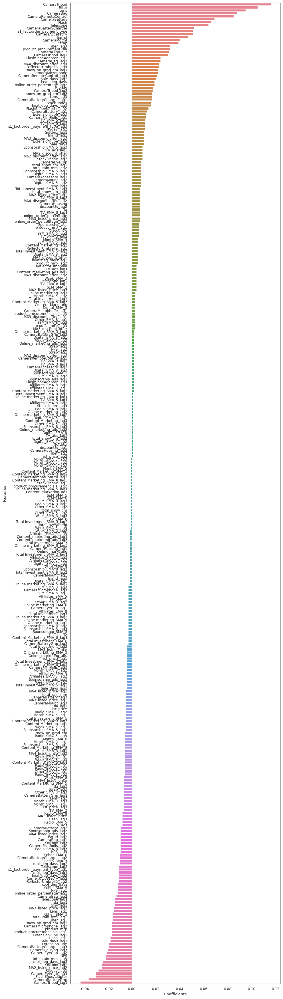

In [1160]:
# Slightly alter the figure size to make it more horizontal.
plt.figure(figsize=(10, 35), dpi=100, facecolor='w', edgecolor='k', frameon='True')
sns.barplot(y='Features', x='Coefficients', palette='husl', data=cameraaccessory_lr_coef_df, estimator=np.sum)
# Automatically adjust subplot params so that the subplotS fits in to the figure area.
plt.tight_layout()

# display the plot
plt.show()

##### The 5 most important features affecting GMV(Revenue) for cameraaccessory are:

|Features|Coefficients|
|--------|------------|
|product_vertical_lens	|0.121|
|product_vertical_filter	|0.117|
|product_vertical_camerabag	|0.102|
|product_vertical_cameraremotecontrol	|0.094|
|is_mass_market	|0.079|

## Building Linear Regression model for `gamingaccessory` using K-fold Cross Validation

In [1161]:
y_gamingaccessory_dladd = gamingaccessory_dladd_df.pop('gmv')
X_gamingaccessory_dladd = gamingaccessory_dladd_df

In [1162]:
# Make cross validated predictions
from sklearn.model_selection import cross_val_score,cross_val_predict
from sklearn import metrics

gamingaccessory_dladd_model_cv = LinearRegression().fit(X_gamingaccessory_dladd, y_gamingaccessory_dladd)
gamingaccessory_dladd_predictions_cv = cross_val_predict(gamingaccessory_dladd_model_cv, X_gamingaccessory_dladd, \
                                                         y_gamingaccessory_dladd, cv=10)
accuracy = metrics.r2_score(y_gamingaccessory_dladd, gamingaccessory_dladd_predictions_cv)
print("Cross-Predicted Accuracy:", accuracy)
print('Mean Squared Error: {}'.format(mean_squared_error(y_gamingaccessory_dladd, gamingaccessory_dladd_predictions_cv)))

Cross-Predicted Accuracy: 0.7497893035837668
Mean Squared Error: 0.2502106964162332


In [1163]:
##### With Simple Linear Regression, using cross validation, we get a r2 score of 0.92 and mse score of 0.08

In [1164]:
## Determining Feature Importance for `gamingaccessory` with model with cv

In [1165]:
# linear regression model parameters
#Limiting floats output to 3 decimal points
pd.set_option('display.float_format', lambda x: '{:.3f}'.format(x)) 
pd.set_option('display.precision',1)


gamingaccessory_lr_model_parameters = list(gamingaccessory_dladd_model_cv.coef_)
gamingaccessory_lr_model_parameters.insert(0, gamingaccessory_dladd_model_cv.intercept_)
gamingaccessory_lr_model_parameters = [round(x, 3) for x in gamingaccessory_lr_model_parameters]
cols = X_gamingaccessory_dladd_test.columns
cols = cols.insert(0, "constant")
gamingaccessory_lr_coef = list(zip(cols, gamingaccessory_lr_model_parameters))
gamingaccessory_lr_coef

[('constant', -0.0),
 ('gmv_lag1', -0.003),
 ('gmv_lag2', -0.004),
 ('gmv_lag3', 0.0),
 ('list_price', 0.007),
 ('list_price_lag1', -0.009),
 ('list_price_lag2', 0.004),
 ('list_price_lag3', -0.008),
 ('product_mrp', 0.028),
 ('product_mrp_lag1', -0.006),
 ('product_mrp_lag2', 0.007),
 ('product_mrp_lag3', -0.0),
 ('discount%', 0.021),
 ('discount%_lag1', 0.014),
 ('discount%_lag2', 0.005),
 ('discount%_lag3', -0.003),
 ('sla', 0.012),
 ('sla_lag1', 0.011),
 ('sla_lag2', 0.003),
 ('sla_lag3', -0.001),
 ('product_procurement_sla', 0.001),
 ('product_procurement_sla_lag1', -0.005),
 ('product_procurement_sla_lag2', 0.012),
 ('product_procurement_sla_lag3', -0.01),
 ('fsn_id', 0.052),
 ('fsn_id_lag1', 0.002),
 ('fsn_id_lag2', 0.001),
 ('fsn_id_lag3', 0.001),
 ('s1_fact.order_payment_type', 0.075),
 ('s1_fact.order_payment_type_lag1', -0.019),
 ('s1_fact.order_payment_type_lag2', -0.002),
 ('s1_fact.order_payment_type_lag3', -0.012),
 ('GamePad', 0.116),
 ('GamePad_lag1', -0.008),
 ('GameP

In [1166]:
gamingaccessory_lr_coef_df = pd.DataFrame(gamingaccessory_lr_coef)
col_rename = {0:'Features',1: 'Coefficients'}
gamingaccessory_lr_coef_df = gamingaccessory_lr_coef_df.rename(columns=col_rename)
gamingaccessory_lr_coef_df = gamingaccessory_lr_coef_df.iloc[1:,:]
gamingaccessory_lr_coef_df = gamingaccessory_lr_coef_df.loc[gamingaccessory_lr_coef_df['Coefficients']!=0.0]
gamingaccessory_lr_coef_df = gamingaccessory_lr_coef_df.sort_values(by=['Coefficients'], ascending = False)
gamingaccessory_lr_coef_df

,Features,Coefficients
52,GamingMouse,0.152
32,GamePad,0.116
40,GamingHeadset,0.113
72,GamingMousePad,0.113
36,GamingAccessoryKit,0.098
76,GamingKeyboard,0.076
28,s1_fact.order_payment_type,0.075
60,TVOutCableAccessory,0.071
56,GamingAdapter,0.063
66,GamingGun_lag2,0.061


In [1167]:
## Plotting the Features in descending order of Importance for `gamingaccessory`

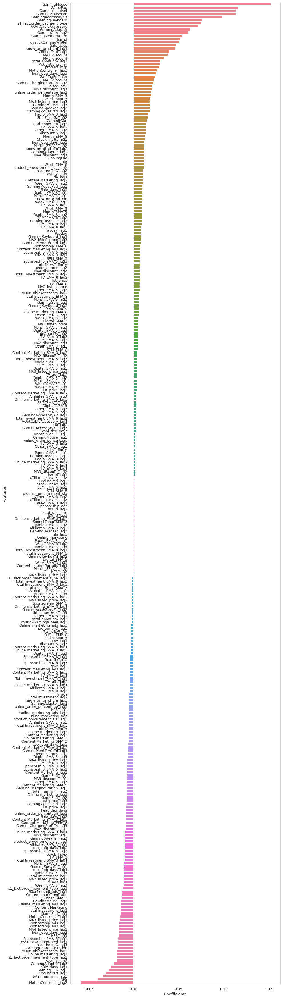

In [1168]:
# Slightly alter the figure size to make it more horizontal.
plt.figure(figsize=(10, 35), dpi=100, facecolor='w', edgecolor='k', frameon='True')
sns.barplot(y='Features', x='Coefficients', palette='husl', data=gamingaccessory_lr_coef_df, estimator=np.sum)
# Automatically adjust subplot params so that the subplotS fits in to the figure area.
plt.tight_layout()

# display the plot
plt.show()

##### The 5 most important features affecting GMV(Revenue) for gamingaccessory are:

|Features|Coefficients|
|--------|------------|
|product_vertical_gamepad	|0.150|
|product_vertical_gamingaccessorykit	|0.115|
|is_mass_market	|0.109|
|product_vertical_motioncontroller	|0.100|
|product_vertical_gamingkeyboard	|0.089|

## Building Linear Regression model for `homeaudio`

In [1169]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

homeaudio_dladd_model = LinearRegression().fit(X_homeaudio_dladd_train, y_homeaudio_dladd_train)
y_homeaudio_dladd_test_pred = homeaudio_dladd_model.predict(X_homeaudio_dladd_test)

print('R2 Score: {}'.format(r2_score(y_homeaudio_dladd_test, y_homeaudio_dladd_test_pred)))
print('Mean Squared Error: {}'.format(mean_squared_error(y_homeaudio_dladd_test, y_homeaudio_dladd_test_pred)))

R2 Score: 0.6123463199598659
Mean Squared Error: 0.6818150192017697


In [1170]:
##### With Simple Linear Regression, we get a r2 score of 0.71 and mse of 0.50

In [1171]:
## Building Linear Regression model for `homeaudio` using K-fold Cross Validation

In [1172]:
y_homeaudio_dladd = homeaudio_dladd_df.pop('gmv')
X_homeaudio_dladd = homeaudio_dladd_df

In [1173]:
# Make cross validated predictions
from sklearn.model_selection import cross_val_score,cross_val_predict
from sklearn import metrics

homeaudio_dladd_model_cv = LinearRegression().fit(X_homeaudio_dladd, y_homeaudio_dladd)
homeaudio_dladd_predictions_cv = cross_val_predict(homeaudio_dladd_model_cv, X_homeaudio_dladd, y_homeaudio_dladd, cv=10)
accuracy = metrics.r2_score(y_homeaudio_dladd, homeaudio_dladd_predictions_cv)
print("Cross-Predicted Accuracy:", accuracy)
print('Mean Squared Error: {}'.format(mean_squared_error(y_homeaudio_dladd, homeaudio_dladd_predictions_cv)))

Cross-Predicted Accuracy: 0.5999189920834949
Mean Squared Error: 0.4000810079165051


In [1174]:
##### With Simple Linear Regression, using cross validation, we get r2 score of 0.55 and mse score of 0.45

In [1175]:
## Determining Feature Importance for `homeaudio`

In [1176]:
# linear regression model parameters
#Limiting floats output to 3 decimal points
pd.set_option('display.float_format', lambda x: '{:.3f}'.format(x)) 
pd.set_option('display.precision',1)


homeaudio_lr_model_parameters = list(homeaudio_dladd_model_cv.coef_)
homeaudio_lr_model_parameters.insert(0, homeaudio_dladd_model_cv.intercept_)
homeaudio_lr_model_parameters = [round(x, 3) for x in homeaudio_lr_model_parameters]
cols = homeaudio_dladd_test.columns
cols = cols.insert(0, "constant")
homeaudio_lr_coef = list(zip(cols, homeaudio_lr_model_parameters))
homeaudio_lr_coef

[('constant', 0.0),
 ('gmv_lag1', -0.012),
 ('gmv_lag2', -0.005),
 ('gmv_lag3', -0.006),
 ('list_price', 0.051),
 ('list_price_lag1', 0.001),
 ('list_price_lag2', -0.0),
 ('list_price_lag3', 0.004),
 ('product_mrp', 0.052),
 ('product_mrp_lag1', 0.016),
 ('product_mrp_lag2', 0.009),
 ('product_mrp_lag3', 0.004),
 ('discount%', 0.069),
 ('discount%_lag1', 0.017),
 ('discount%_lag2', 0.004),
 ('discount%_lag3', 0.004),
 ('sla', 0.001),
 ('sla_lag1', -0.013),
 ('sla_lag2', -0.009),
 ('sla_lag3', 0.009),
 ('product_procurement_sla', -0.109),
 ('product_procurement_sla_lag1', 0.004),
 ('product_procurement_sla_lag2', 0.003),
 ('product_procurement_sla_lag3', 0.01),
 ('fsn_id', 0.035),
 ('fsn_id_lag1', 0.008),
 ('fsn_id_lag2', 0.006),
 ('fsn_id_lag3', -0.005),
 ('s1_fact.order_payment_type', 0.14),
 ('s1_fact.order_payment_type_lag1', -0.028),
 ('s1_fact.order_payment_type_lag2', -0.014),
 ('s1_fact.order_payment_type_lag3', 0.006),
 ('HomeAudioSpeaker', 0.209),
 ('HomeAudioSpeaker_lag1', -0

In [1177]:
homeaudio_lr_coef_df = pd.DataFrame(homeaudio_lr_coef)
col_rename = {0:'Features',1: 'Coefficients'}
homeaudio_lr_coef_df = homeaudio_lr_coef_df.rename(columns=col_rename)
homeaudio_lr_coef_df = homeaudio_lr_coef_df.iloc[1:,:]
homeaudio_lr_coef_df = homeaudio_lr_coef_df.loc[homeaudio_lr_coef_df['Coefficients']!=0.0]
homeaudio_lr_coef_df = homeaudio_lr_coef_df.sort_values(by=['Coefficients'], ascending = False)
homeaudio_lr_coef_df

,Features,Coefficients
32,HomeAudioSpeaker,0.209
28,s1_fact.order_payment_type,0.140
52,FMRadio,0.126
40,BoomBox,0.104
36,Dock,0.093
56,HiFiSystem,0.090
69,SlingBox_lag1,0.073
12,discount%,0.069
308,MA4_discount,0.063
296,MA4_listed_price,0.060


In [1178]:
## Plotting the Features in descending order of Importance for `homeaudio`

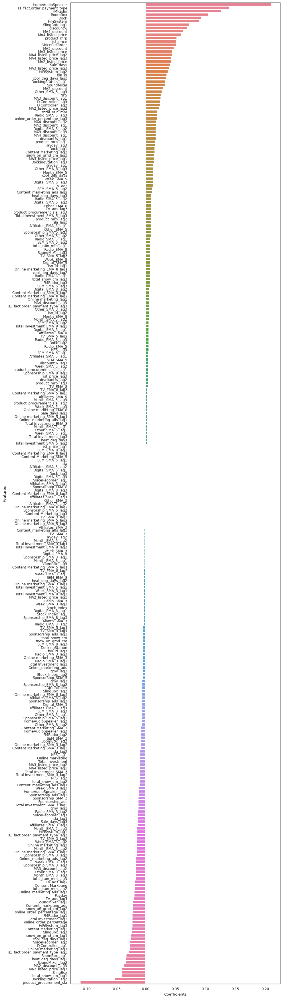

In [1179]:
# Slightly alter the figure size to make it more horizontal.
plt.figure(figsize=(10, 35), dpi=100, facecolor='w', edgecolor='k', frameon='True')
sns.barplot(y='Features', x='Coefficients', palette='husl', data=homeaudio_lr_coef_df, estimator=np.sum)
# Automatically adjust subplot params so that the subplotS fits in to the figure area.
plt.tight_layout()

# display the plot
plt.show()

##### The 5 most important features affecting GMV(Revenue) for homeaudio are:

|Features|Coefficients|
|--------|------------|
|product_vertical_homeaudiospeaker	|0.184|
|product_vertical_karaokeplayer	|0.173|
|is_mass_market	|0.162|
|is_cod	|0.145|
|product_vertical_fmradio	|0.094|

## Distributive Lag Model(Multiplicative)

In [1180]:
# Making copy of dataframes from the original ones
cameraaccessory_dlmul_df = camera_week_df.copy()
gamingaccessory_dlmul_df = gaming_week_df.copy()
homeaudio_dlmul_df = home_audio_week_df.copy()
homeaudio_dlmul_df.head()

,Week,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,HomeAudioSpeaker,Dock,BoomBox,DockingStation,DJController,FMRadio,HiFiSystem,VoiceRecorder,KaraokePlayer,SlingBox,SoundMixer,Year,Month,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,Date,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
20,28,6608403.000,2002.174,4250.826,0.447,4.819,2.826,277,442,2701.000,35,28,3,0,453.000,22,53,0,0,0,2015.000,7.000,0.000,0.000,7.000,0.000,0.000,28.000,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.054,1.854,0.000,0.332,47.093,1052.000,0.000,0.000,10.950,1.116,4.848,1.117,0.165,13.414,0.016,-0.015,-0.003,0.114,0.073,0.090
21,29,4453585.000,1984.649,3836.581,0.392,5.479,2.795,278,387,1669.000,46,34,8,1,417.000,14,50,0,0,0,2015.000,7.000,0.000,0.000,7.000,0.000,0.000,28.222,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.143,12.578,1.116,2.562,0.117,4.593,17.285,-0.004,0.005,-0.018,-0.066,-0.016,-0.046
23,30,5550427.500,1928.914,3808.947,0.417,5.535,2.499,288,583,2198.000,56,23,14,0,482.000,18,73,0,0,0,2015.000,7.000,7.000,0.000,7.000,29.000,0.000,28.617,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.429,0.000,5.712,1.953,1.846,0.146,0.206,20.356,0.022,0.005,-0.006,0.102,0.089,0.045
24,31,4160893.000,1912.447,3563.507,0.382,5.688,2.655,273,380,1518.000,26,26,12,1,499.000,17,68,0,0,0,2015.000,7.000,7.000,0.000,7.000,30.000,0.000,29.147,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,2015-07-01 00:00:00,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.000,7.725,1.674,1.846,0.146,0.206,17.536,-0.004,0.009,-0.003,-0.044,0.006,-0.002
25,32,6607912.000,2025.304,4077.258,0.428,4.892,2.758,289,506,2532.000,28,37,4,0,564.000,18,75,0,0,0,2015.000,8.000,7.333,7.200,7.222,31.000,30.000,29.781,1.013,3.181,3.615,3.542,0.036,0.043,0.042,0.507,0.558,0.549,1.307,1.526,1.489,0.000,0.000,0.000,0.000,0.026,0.230,0.271,0.264,0.096,0.113,0.110,1.005,1.105,1.089,0.000,0.000,0.000,0.000,0.000,0.000,2015-08-01 00:00:00,0.028,1.140,0.000,0.192,50.327,1222.000,0.286,0.143,9.607,1.116,2.622,0.088,0.124,15.531,0.029,0.036,0.050,0.057,0.046,0.093


In [1181]:
# removing columns
cameraaccessory_dlmul_df = cameraaccessory_dlmul_df.drop(['Week','Date','Month','Year'], axis=1)
gamingaccessory_dlmul_df = gamingaccessory_dlmul_df.drop(['Week','Date','Month','Year'], axis=1)
homeaudio_dlmul_df = homeaudio_dlmul_df.drop(['Week','Date','Month','Year'], axis=1)
homeaudio_dlmul_df.head()

,gmv,list_price,product_mrp,discount%,sla,product_procurement_sla,fsn_id,s1_fact.order_payment_type,HomeAudioSpeaker,Dock,BoomBox,DockingStation,DJController,FMRadio,HiFiSystem,VoiceRecorder,KaraokePlayer,SlingBox,SoundMixer,Month_SMA_3,Month_SMA_5,Month_EMA_8,Week_SMA_3,Week_SMA_5,Week_EMA_8,Total Investment,Total Investment_SMA_3,Total Investment_SMA_5,Total Investment_EMA_8,TV_SMA_3,TV_SMA_5,TV_EMA_8,Digital_SMA_3,Digital_SMA_5,Digital_EMA_8,Sponsorship_SMA_3,Sponsorship_SMA_5,Sponsorship_EMA_8,Content Marketing,Content Marketing_SMA_3,Content Marketing_SMA_5,Content Marketing_EMA_8,Online marketing,Online marketing_SMA_3,Online marketing_SMA_5,Online marketing_EMA_8,Affiliates_SMA_3,Affiliates_SMA_5,Affiliates_EMA_8,SEM_SMA_3,SEM_SMA_5,SEM_EMA_8,Radio_SMA_3,Radio_SMA_5,Radio_EMA_8,Other_SMA_3,Other_SMA_5,Other_EMA_8,TV_ads,Sponsorship_ads,Content_marketing_ads,Online_marketing_ads,NPS,Stock_Index,Sale_days,Payday,heat_deg_days,cool_deg_days,total_rain_mm,total_snow_cm,snow_on_grnd_cm,online_order_percentage,MA2_listed_price,MA3_listed_price,MA4_listed_price,MA2_discount,MA3_discount,MA4_discount
20,6608403.000,2002.174,4250.826,0.447,4.819,2.826,277,442,2701.000,35,28,3,0,453.000,22,53,0,0,0,0.000,0.000,7.000,0.000,0.000,28.000,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.054,1.854,0.000,0.332,47.093,1052.000,0.000,0.000,10.950,1.116,4.848,1.117,0.165,13.414,0.016,-0.015,-0.003,0.114,0.073,0.090
21,4453585.000,1984.649,3836.581,0.392,5.479,2.795,278,387,1669.000,46,34,8,1,417.000,14,50,0,0,0,0.000,0.000,7.000,0.000,0.000,28.222,4.265,0.000,0.000,4.265,0.000,0.000,0.054,0.000,0.000,0.633,0.000,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.000,0.000,0.332,0.000,0.000,0.137,0.000,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.143,12.578,1.116,2.562,0.117,4.593,17.285,-0.004,0.005,-0.018,-0.066,-0.016,-0.046
23,5550427.500,1928.914,3808.947,0.417,5.535,2.499,288,583,2198.000,56,23,14,0,482.000,18,73,0,0,0,7.000,0.000,7.000,29.000,0.000,28.617,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.081,2.781,0.000,0.498,47.093,1052.000,0.429,0.000,5.712,1.953,1.846,0.146,0.206,20.356,0.022,0.005,-0.006,0.102,0.089,0.045
24,4160893.000,1912.447,3563.507,0.382,5.688,2.655,273,380,1518.000,26,26,12,1,499.000,17,68,0,0,0,7.000,0.000,7.000,30.000,0.000,29.147,4.265,4.265,0.000,4.265,0.054,0.000,0.054,0.633,0.000,0.633,1.854,0.000,1.854,0.000,0.000,0.000,0.000,0.332,0.332,0.000,0.332,0.137,0.000,0.137,1.256,0.000,1.256,0.000,0.000,0.000,0.000,0.000,0.000,0.081,2.781,0.000,0.498,47.093,1052.000,0.000,0.000,7.725,1.674,1.846,0.146,0.206,17.536,-0.004,0.009,-0.003,-0.044,0.006,-0.002
25,6607912.000,2025.304,4077.258,0.428,4.892,2.758,289,506,2532.000,28,37,4,0,564.000,18,75,0,0,0,7.333,7.200,7.222,31.000,30.000,29.781,1.013,3.181,3.615,3.542,0.036,0.043,0.042,0.507,0.558,0.549,1.307,1.526,1.489,0.000,0.000,0.000,0.000,0.026,0.230,0.271,0.264,0.096,0.113,0.110,1.005,1.105,1.089,0.000,0.000,0.000,0.000,0.000,0.000,0.028,1.140,0.000,0.192,50.327,1222.000,0.286,0.143,9.607,1.116,2.622,0.088,0.124,15.531,0.029,0.036,0.050,0.057,0.046,0.093


In [1182]:
### Creating new lag(Lag of 3 weeks) variables for the dependent variable (GMV) as well as independent variables

In [1183]:
cameraaccessory_dlmul_df_columns = cameraaccessory_dlmul_df.columns
gamingaccessory_dlmul_df_columns = gamingaccessory_dlmul_df.columns
homeaudio_dlmul_df_columns = homeaudio_dlmul_df.columns

In [1184]:
cameraaccessory_dlmul_df = lag_variables(cameraaccessory_dlmul_df,cameraaccessory_dlmul_df_columns,3)
gamingaccessory_dlmul_df = lag_variables(gamingaccessory_dlmul_df,gamingaccessory_dlmul_df_columns,3)
homeaudio_dlmul_df = lag_variables(homeaudio_dlmul_df,homeaudio_dlmul_df_columns,3)
homeaudio_dlmul_df.head()

,gmv,gmv_lag3,list_price,list_price_lag3,product_mrp,product_mrp_lag3,discount%,discount%_lag3,sla,sla_lag3,product_procurement_sla,product_procurement_sla_lag3,fsn_id,fsn_id_lag3,s1_fact.order_payment_type,s1_fact.order_payment_type_lag3,HomeAudioSpeaker,HomeAudioSpeaker_lag3,Dock,Dock_lag3,BoomBox,BoomBox_lag3,DockingStation,DockingStation_lag3,DJController,DJController_lag3,FMRadio,FMRadio_lag3,HiFiSystem,HiFiSystem_lag3,VoiceRecorder,VoiceRecorder_lag3,KaraokePlayer,KaraokePlayer_lag3,SlingBox,SlingBox_lag3,SoundMixer,SoundMixer_lag3,Month_SMA_3,Month_SMA_3_lag3,Month_SMA_5,Month_SMA_5_lag3,Month_EMA_8,Month_EMA_8_lag3,Week_SMA_3,Week_SMA_3_lag3,Week_SMA_5,Week_SMA_5_lag3,Week_EMA_8,Week_EMA_8_lag3,...,Radio_SMA_5,Radio_SMA_5_lag3,Radio_EMA_8,Radio_EMA_8_lag3,Other_SMA_3,Other_SMA_3_lag3,Other_SMA_5,Other_SMA_5_lag3,Other_EMA_8,Other_EMA_8_lag3,TV_ads,TV_ads_lag3,Sponsorship_ads,Sponsorship_ads_lag3,Content_marketing_ads,Content_marketing_ads_lag3,Online_marketing_ads,Online_marketing_ads_lag3,NPS,NPS_lag3,Stock_Index,Stock_Index_lag3,Sale_days,Sale_days_lag3,Payday,Payday_lag3,heat_deg_days,heat_deg_days_lag3,cool_deg_days,cool_deg_days_lag3,total_rain_mm,total_rain_mm_lag3,total_snow_cm,total_snow_cm_lag3,snow_on_grnd_cm,snow_on_grnd_cm_lag3,online_order_percentage,online_order_percentage_lag3,MA2_listed_price,MA2_listed_price_lag3,MA3_listed_price,MA3_listed_price_lag3,MA4_listed_price,MA4_listed_price_lag3,MA2_discount,MA2_discount_lag3,MA3_discount,MA3_discount_lag3,MA4_discount,MA4_discount_lag3
20,6608403.000,nan,2002.174,nan,4250.826,nan,0.447,nan,4.819,nan,2.826,nan,277,nan,442,nan,2701.000,nan,35,nan,28,nan,3,nan,0,nan,453.000,nan,22,nan,53,nan,0,nan,0,nan,0,nan,0.000,nan,0.000,nan,7.000,nan,0.000,nan,0.000,nan,28.000,nan,...,0.000,nan,0.000,nan,0.000,nan,0.000,nan,0.000,nan,0.054,nan,1.854,nan,0.000,nan,0.332,nan,47.093,nan,1052.000,nan,0.000,nan,0.000,nan,10.950,nan,1.116,nan,4.848,nan,1.117,nan,0.165,nan,13.414,nan,0.016,nan,-0.015,nan,-0.003,nan,0.114,nan,0.073,nan,0.090,nan
21,4453585.000,nan,1984.649,nan,3836.581,nan,0.392,nan,5.479,nan,2.795,nan,278,nan,387,nan,1669.000,nan,46,nan,34,nan,8,nan,1,nan,417.000,nan,14,nan,50,nan,0,nan,0,nan,0,nan,0.000,nan,0.000,nan,7.000,nan,0.000,nan,0.000,nan,28.222,nan,...,0.000,nan,0.000,nan,0.000,nan,0.000,nan,0.000,nan,0.081,nan,2.781,nan,0.000,nan,0.498,nan,47.093,nan,1052.000,nan,0.000,nan,0.143,nan,12.578,nan,1.116,nan,2.562,nan,0.117,nan,4.593,nan,17.285,nan,-0.004,nan,0.005,nan,-0.018,nan,-0.066,nan,-0.016,nan,-0.046,nan
23,5550427.500,nan,1928.914,nan,3808.947,nan,0.417,nan,5.535,nan,2.499,nan,288,nan,583,nan,2198.000,nan,56,nan,23,nan,14,nan,0,nan,482.000,nan,18,nan,73,nan,0,nan,0,nan,0,nan,7.000,nan,0.000,nan,7.000,nan,29.000,nan,0.000,nan,28.617,nan,...,0.000,nan,0.000,nan,0.000,nan,0.000,nan,0.000,nan,0.081,nan,2.781,nan,0.000,nan,0.498,nan,47.093,nan,1052.000,nan,0.429,nan,0.000,nan,5.712,nan,1.953,nan,1.846,nan,0.146,nan,0.206,nan,20.356,nan,0.022,nan,0.005,nan,-0.006,nan,0.102,nan,0.089,nan,0.045,nan
24,4160893.000,6608403.000,1912.447,2002.174,3563.507,4250.826,0.382,0.447,5.688,4.819,2.655,2.826,273,277.000,380,442.000,1518.000,2701.000,26,35.000,26,28.000,12,3.000,1,0.000,499.000,453.000,17,22.000,68,53.000,0,0.000,0,0.000,0,0.000,7.000,0.000,0.000,0.000,7.000,7.000,30.000,0.000,0.000,0.000,29.147,28.000,...,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.081,0.054,2.781,1.854,0.000,0.000,0.498,0.332,47.093,47.093,1052.000,1052.000,0.000,0.000,0.000,0.000,7.725,10.950,1.674,1.116,1.846,4.848,0.146,1.117,0.206,0.165,17.536,13.414,-0.004,0.016,0.009,-0.015,-0.003,-0.003,-0.044,0.114,0.006,0.073,-0.002,0.090
25,6607912.000,4453585.000,2025.304,1984.649,4077.258,3836.581,0.428,0.392,4.892,5.479,2.758,2.795,289,278.000,506,387.000,2532.000,1669.000,28,46.000,37,34.000,4,8.000,0,1.000,564.000,417.000,18,14.000,75,50.000,0,0.000,0,0.000,0,0.000,7.333,0.000,7.200,0.000,7.222,7.000,31.000,0.000,30.000,0.000,29.781,28.222,...,0.000,0.000,0.000,0.000,

In [1185]:
### Creating new lag(Lag of 2 weeks) variables for the dependent variable (GMV) as well as independent variables

In [1186]:
cameraaccessory_dlmul_df = lag_variables(cameraaccessory_dlmul_df,cameraaccessory_dlmul_df_columns,2)
gamingaccessory_dlmul_df = lag_variables(gamingaccessory_dlmul_df,gamingaccessory_dlmul_df_columns,2)
homeaudio_dlmul_df = lag_variables(homeaudio_dlmul_df,homeaudio_dlmul_df_columns,2)
homeaudio_dlmul_df.head()

,gmv,gmv_lag2,gmv_lag3,list_price,list_price_lag2,list_price_lag3,product_mrp,product_mrp_lag2,product_mrp_lag3,discount%,discount%_lag2,discount%_lag3,sla,sla_lag2,sla_lag3,product_procurement_sla,product_procurement_sla_lag2,product_procurement_sla_lag3,fsn_id,fsn_id_lag2,fsn_id_lag3,s1_fact.order_payment_type,s1_fact.order_payment_type_lag2,s1_fact.order_payment_type_lag3,HomeAudioSpeaker,HomeAudioSpeaker_lag2,HomeAudioSpeaker_lag3,Dock,Dock_lag2,Dock_lag3,BoomBox,BoomBox_lag2,BoomBox_lag3,DockingStation,DockingStation_lag2,DockingStation_lag3,DJController,DJController_lag2,DJController_lag3,FMRadio,FMRadio_lag2,FMRadio_lag3,HiFiSystem,HiFiSystem_lag2,HiFiSystem_lag3,VoiceRecorder,VoiceRecorder_lag2,VoiceRecorder_lag3,KaraokePlayer,KaraokePlayer_lag2,...,Online_marketing_ads_lag2,Online_marketing_ads_lag3,NPS,NPS_lag2,NPS_lag3,Stock_Index,Stock_Index_lag2,Stock_Index_lag3,Sale_days,Sale_days_lag2,Sale_days_lag3,Payday,Payday_lag2,Payday_lag3,heat_deg_days,heat_deg_days_lag2,heat_deg_days_lag3,cool_deg_days,cool_deg_days_lag2,cool_deg_days_lag3,total_rain_mm,total_rain_mm_lag2,total_rain_mm_lag3,total_snow_cm,total_snow_cm_lag2,total_snow_cm_lag3,snow_on_grnd_cm,snow_on_grnd_cm_lag2,snow_on_grnd_cm_lag3,online_order_percentage,online_order_percentage_lag2,online_order_percentage_lag3,MA2_listed_price,MA2_listed_price_lag2,MA2_listed_price_lag3,MA3_listed_price,MA3_listed_price_lag2,MA3_listed_price_lag3,MA4_listed_price,MA4_listed_price_lag2,MA4_listed_price_lag3,MA2_discount,MA2_discount_lag2,MA2_discount_lag3,MA3_discount,MA3_discount_lag2,MA3_discount_lag3,MA4_discount,MA4_discount_lag2,MA4_discount_lag3
20,6608403.000,nan,nan,2002.174,nan,nan,4250.826,nan,nan,0.447,nan,nan,4.819,nan,nan,2.826,nan,nan,277,nan,nan,442,nan,nan,2701.000,nan,nan,35,nan,nan,28,nan,nan,3,nan,nan,0,nan,nan,453.000,nan,nan,22,nan,nan,53,nan,nan,0,nan,...,nan,nan,47.093,nan,nan,1052.000,nan,nan,0.000,nan,nan,0.000,nan,nan,10.950,nan,nan,1.116,nan,nan,4.848,nan,nan,1.117,nan,nan,0.165,nan,nan,13.414,nan,nan,0.016,nan,nan,-0.015,nan,nan,-0.003,nan,nan,0.114,nan,nan,0.073,nan,nan,0.090,nan,nan
21,4453585.000,nan,nan,1984.649,nan,nan,3836.581,nan,nan,0.392,nan,nan,5.479,nan,nan,2.795,nan,nan,278,nan,nan,387,nan,nan,1669.000,nan,nan,46,nan,nan,34,nan,nan,8,nan,nan,1,nan,nan,417.000,nan,nan,14,nan,nan,50,nan,nan,0,nan,...,nan,nan,47.093,nan,nan,1052.000,nan,nan,0.000,nan,nan,0.143,nan,nan,12.578,nan,nan,1.116,nan,nan,2.562,nan,nan,0.117,nan,nan,4.593,nan,nan,17.285,nan,nan,-0.004,nan,nan,0.005,nan,nan,-0.018,nan,nan,-0.066,nan,nan,-0.016,nan,nan,-0.046,nan,nan
23,5550427.500,6608403.000,nan,1928.914,2002.174,nan,3808.947,4250.826,nan,0.417,0.447,nan,5.535,4.819,nan,2.499,2.826,nan,288,277.000,nan,583,442.000,nan,2198.000,2701.000,nan,56,35.000,nan,23,28.000,nan,14,3.000,nan,0,0.000,nan,482.000,453.000,nan,18,22.000,nan,73,53.000,nan,0,0.000,...,0.332,nan,47.093,47.093,nan,1052.000,1052.000,nan,0.429,0.000,nan,0.000,0.000,nan,5.712,10.950,nan,1.953,1.116,nan,1.846,4.848,nan,0.146,1.117,nan,0.206,0.165,nan,20.356,13.414,nan,0.022,0.016,nan,0.005,-0.015,nan,-0.006,-0.003,nan,0.102,0.114,nan,0.089,0.073,nan,0.045,0.090,nan
24,4160893.000,4453585.000,6608403.000,1912.447,1984.649,2002.174,3563.507,3836.581,4250.826,0.382,0.392,0.447,5.688,5.479,4.819,2.655,2.795,2.826,273,278.000,277.000,380,387.000,442.000,1518.000,1669.000,2701.000,26,46.000,35.000,26,34.000,28.000,12,8.000,3.000,1,1.000,0.000,499.000,417.000,453.000,17,14.000,22.000,68,50.000,53.000,0,0.000,...,0.498,0.332,47.093,47.093,47.093,1052.000,1052.000,1052.000,0.000,0.000,0.000,0.000,0.143,0.000,7.725,12.578,10.950,1.674,1.116,1.116,1.846,2.562,4.848,0.146,0.117,1.117,0.206,4.593,0.165,17.536,17.285,13.414,-0.004,-0.004,0.016,0.009,0.005,-0.015,-0.003,-0.018,-0.003,-0.044,-0.066,0.114,0.006,-0.016,0.073,-0.002,-0.046,0.090
25,6607912.000,5550427.500,4453585.000,2025.304,1928.914,1984.649,4077.258,3808.947,3836.581,0.428,0.417,0.392,4.892,5.535,5.479,2.758,2.499,2.795,289,288.000,278.000,506,583.

In [1187]:
### Creating new lag(Lag of 1 week) variables for the dependent variable (GMV) as well as independent variables

In [1188]:
cameraaccessory_dlmul_df = lag_variables(cameraaccessory_dlmul_df,cameraaccessory_dlmul_df_columns,1)
gamingaccessory_dlmul_df = lag_variables(gamingaccessory_dlmul_df,gamingaccessory_dlmul_df_columns,1)
homeaudio_dlmul_df = lag_variables(homeaudio_dlmul_df,homeaudio_dlmul_df_columns,1)
homeaudio_dlmul_df.head()

,gmv,gmv_lag1,gmv_lag2,gmv_lag3,list_price,list_price_lag1,list_price_lag2,list_price_lag3,product_mrp,product_mrp_lag1,product_mrp_lag2,product_mrp_lag3,discount%,discount%_lag1,discount%_lag2,discount%_lag3,sla,sla_lag1,sla_lag2,sla_lag3,product_procurement_sla,product_procurement_sla_lag1,product_procurement_sla_lag2,product_procurement_sla_lag3,fsn_id,fsn_id_lag1,fsn_id_lag2,fsn_id_lag3,s1_fact.order_payment_type,s1_fact.order_payment_type_lag1,s1_fact.order_payment_type_lag2,s1_fact.order_payment_type_lag3,HomeAudioSpeaker,HomeAudioSpeaker_lag1,HomeAudioSpeaker_lag2,HomeAudioSpeaker_lag3,Dock,Dock_lag1,Dock_lag2,Dock_lag3,BoomBox,BoomBox_lag1,BoomBox_lag2,BoomBox_lag3,DockingStation,DockingStation_lag1,DockingStation_lag2,DockingStation_lag3,DJController,DJController_lag1,...,Payday_lag2,Payday_lag3,heat_deg_days,heat_deg_days_lag1,heat_deg_days_lag2,heat_deg_days_lag3,cool_deg_days,cool_deg_days_lag1,cool_deg_days_lag2,cool_deg_days_lag3,total_rain_mm,total_rain_mm_lag1,total_rain_mm_lag2,total_rain_mm_lag3,total_snow_cm,total_snow_cm_lag1,total_snow_cm_lag2,total_snow_cm_lag3,snow_on_grnd_cm,snow_on_grnd_cm_lag1,snow_on_grnd_cm_lag2,snow_on_grnd_cm_lag3,online_order_percentage,online_order_percentage_lag1,online_order_percentage_lag2,online_order_percentage_lag3,MA2_listed_price,MA2_listed_price_lag1,MA2_listed_price_lag2,MA2_listed_price_lag3,MA3_listed_price,MA3_listed_price_lag1,MA3_listed_price_lag2,MA3_listed_price_lag3,MA4_listed_price,MA4_listed_price_lag1,MA4_listed_price_lag2,MA4_listed_price_lag3,MA2_discount,MA2_discount_lag1,MA2_discount_lag2,MA2_discount_lag3,MA3_discount,MA3_discount_lag1,MA3_discount_lag2,MA3_discount_lag3,MA4_discount,MA4_discount_lag1,MA4_discount_lag2,MA4_discount_lag3
20,6608403.000,nan,nan,nan,2002.174,nan,nan,nan,4250.826,nan,nan,nan,0.447,nan,nan,nan,4.819,nan,nan,nan,2.826,nan,nan,nan,277,nan,nan,nan,442,nan,nan,nan,2701.000,nan,nan,nan,35,nan,nan,nan,28,nan,nan,nan,3,nan,nan,nan,0,nan,...,nan,nan,10.950,nan,nan,nan,1.116,nan,nan,nan,4.848,nan,nan,nan,1.117,nan,nan,nan,0.165,nan,nan,nan,13.414,nan,nan,nan,0.016,nan,nan,nan,-0.015,nan,nan,nan,-0.003,nan,nan,nan,0.114,nan,nan,nan,0.073,nan,nan,nan,0.090,nan,nan,nan
21,4453585.000,6608403.000,nan,nan,1984.649,2002.174,nan,nan,3836.581,4250.826,nan,nan,0.392,0.447,nan,nan,5.479,4.819,nan,nan,2.795,2.826,nan,nan,278,277.000,nan,nan,387,442.000,nan,nan,1669.000,2701.000,nan,nan,46,35.000,nan,nan,34,28.000,nan,nan,8,3.000,nan,nan,1,0.000,...,nan,nan,12.578,10.950,nan,nan,1.116,1.116,nan,nan,2.562,4.848,nan,nan,0.117,1.117,nan,nan,4.593,0.165,nan,nan,17.285,13.414,nan,nan,-0.004,0.016,nan,nan,0.005,-0.015,nan,nan,-0.018,-0.003,nan,nan,-0.066,0.114,nan,nan,-0.016,0.073,nan,nan,-0.046,0.090,nan,nan
23,5550427.500,4453585.000,6608403.000,nan,1928.914,1984.649,2002.174,nan,3808.947,3836.581,4250.826,nan,0.417,0.392,0.447,nan,5.535,5.479,4.819,nan,2.499,2.795,2.826,nan,288,278.000,277.000,nan,583,387.000,442.000,nan,2198.000,1669.000,2701.000,nan,56,46.000,35.000,nan,23,34.000,28.000,nan,14,8.000,3.000,nan,0,1.000,...,0.000,nan,5.712,12.578,10.950,nan,1.953,1.116,1.116,nan,1.846,2.562,4.848,nan,0.146,0.117,1.117,nan,0.206,4.593,0.165,nan,20.356,17.285,13.414,nan,0.022,-0.004,0.016,nan,0.005,0.005,-0.015,nan,-0.006,-0.018,-0.003,nan,0.102,-0.066,0.114,nan,0.089,-0.016,0.073,nan,0.045,-0.046,0.090,nan
24,4160893.000,5550427.500,4453585.000,6608403.000,1912.447,1928.914,1984.649,2002.174,3563.507,3808.947,3836.581,4250.826,0.382,0.417,0.392,0.447,5.688,5.535,5.479,4.819,2.655,2.499,2.795,2.826,273,288.000,278.000,277.000,380,583.000,387.000,442.000,1518.000,2198.000,1669.000,2701.000,26,56.000,46.000,35.000,26,23.000,34.000,28.000,12,14.000,8.000,3.000,1,0.000,...,0.143,0.000,7.725,5.712,12.578,10.950,1.674,1.953,1.116,1.116,1.846,1.846,2.562,4.848,0.146,0.146,0.117,1.117,0.206,0.206,4.593,0.165,17.536,20.356,17.285,13.414,-0.004,0.022,-0.004,0.016,0.009,0.005,0.005,-0.015,-0.003,-0.006,-0.018,-0.003,-0.044,0.102,-0.066,0.114,0.006,0.089,-0.016,0

In [1189]:
# Imputing all null values with 0
cameraaccessory_dlmul_df.fillna(value=0, inplace=True)
gamingaccessory_dlmul_df.fillna(value=0, inplace=True)
homeaudio_dlmul_df.fillna(value=0, inplace=True)
homeaudio_dlmul_df.head(10)

,gmv,gmv_lag1,gmv_lag2,gmv_lag3,list_price,list_price_lag1,list_price_lag2,list_price_lag3,product_mrp,product_mrp_lag1,product_mrp_lag2,product_mrp_lag3,discount%,discount%_lag1,discount%_lag2,discount%_lag3,sla,sla_lag1,sla_lag2,sla_lag3,product_procurement_sla,product_procurement_sla_lag1,product_procurement_sla_lag2,product_procurement_sla_lag3,fsn_id,fsn_id_lag1,fsn_id_lag2,fsn_id_lag3,s1_fact.order_payment_type,s1_fact.order_payment_type_lag1,s1_fact.order_payment_type_lag2,s1_fact.order_payment_type_lag3,HomeAudioSpeaker,HomeAudioSpeaker_lag1,HomeAudioSpeaker_lag2,HomeAudioSpeaker_lag3,Dock,Dock_lag1,Dock_lag2,Dock_lag3,BoomBox,BoomBox_lag1,BoomBox_lag2,BoomBox_lag3,DockingStation,DockingStation_lag1,DockingStation_lag2,DockingStation_lag3,DJController,DJController_lag1,...,Payday_lag2,Payday_lag3,heat_deg_days,heat_deg_days_lag1,heat_deg_days_lag2,heat_deg_days_lag3,cool_deg_days,cool_deg_days_lag1,cool_deg_days_lag2,cool_deg_days_lag3,total_rain_mm,total_rain_mm_lag1,total_rain_mm_lag2,total_rain_mm_lag3,total_snow_cm,total_snow_cm_lag1,total_snow_cm_lag2,total_snow_cm_lag3,snow_on_grnd_cm,snow_on_grnd_cm_lag1,snow_on_grnd_cm_lag2,snow_on_grnd_cm_lag3,online_order_percentage,online_order_percentage_lag1,online_order_percentage_lag2,online_order_percentage_lag3,MA2_listed_price,MA2_listed_price_lag1,MA2_listed_price_lag2,MA2_listed_price_lag3,MA3_listed_price,MA3_listed_price_lag1,MA3_listed_price_lag2,MA3_listed_price_lag3,MA4_listed_price,MA4_listed_price_lag1,MA4_listed_price_lag2,MA4_listed_price_lag3,MA2_discount,MA2_discount_lag1,MA2_discount_lag2,MA2_discount_lag3,MA3_discount,MA3_discount_lag1,MA3_discount_lag2,MA3_discount_lag3,MA4_discount,MA4_discount_lag1,MA4_discount_lag2,MA4_discount_lag3
20,6608403.000,0.000,0.000,0.000,2002.174,0.000,0.000,0.000,4250.826,0.000,0.000,0.000,0.447,0.000,0.000,0.000,4.819,0.000,0.000,0.000,2.826,0.000,0.000,0.000,277,0.000,0.000,0.000,442,0.000,0.000,0.000,2701.000,0.000,0.000,0.000,35,0.000,0.000,0.000,28,0.000,0.000,0.000,3,0.000,0.000,0.000,0,0.000,...,0.000,0.000,10.950,0.000,0.000,0.000,1.116,0.000,0.000,0.000,4.848,0.000,0.000,0.000,1.117,0.000,0.000,0.000,0.165,0.000,0.000,0.000,13.414,0.000,0.000,0.000,0.016,0.000,0.000,0.000,-0.015,0.000,0.000,0.000,-0.003,0.000,0.000,0.000,0.114,0.000,0.000,0.000,0.073,0.000,0.000,0.000,0.090,0.000,0.000,0.000
21,4453585.000,6608403.000,0.000,0.000,1984.649,2002.174,0.000,0.000,3836.581,4250.826,0.000,0.000,0.392,0.447,0.000,0.000,5.479,4.819,0.000,0.000,2.795,2.826,0.000,0.000,278,277.000,0.000,0.000,387,442.000,0.000,0.000,1669.000,2701.000,0.000,0.000,46,35.000,0.000,0.000,34,28.000,0.000,0.000,8,3.000,0.000,0.000,1,0.000,...,0.000,0.000,12.578,10.950,0.000,0.000,1.116,1.116,0.000,0.000,2.562,4.848,0.000,0.000,0.117,1.117,0.000,0.000,4.593,0.165,0.000,0.000,17.285,13.414,0.000,0.000,-0.004,0.016,0.000,0.000,0.005,-0.015,0.000,0.000,-0.018,-0.003,0.000,0.000,-0.066,0.114,0.000,0.000,-0.016,0.073,0.000,0.000,-0.046,0.090,0.000,0.000
23,5550427.500,4453585.000,6608403.000,0.000,1928.914,1984.649,2002.174,0.000,3808.947,3836.581,4250.826,0.000,0.417,0.392,0.447,0.000,5.535,5.479,4.819,0.000,2.499,2.795,2.826,0.000,288,278.000,277.000,0.000,583,387.000,442.000,0.000,2198.000,1669.000,2701.000,0.000,56,46.000,35.000,0.000,23,34.000,28.000,0.000,14,8.000,3.000,0.000,0,1.000,...,0.000,0.000,5.712,12.578,10.950,0.000,1.953,1.116,1.116,0.000,1.846,2.562,4.848,0.000,0.146,0.117,1.117,0.000,0.206,4.593,0.165,0.000,20.356,17.285,13.414,0.000,0.022,-0.004,0.016,0.000,0.005,0.005,-0.015,0.000,-0.006,-0.018,-0.003,0.000,0.102,-0.066,0.114,0.000,0.089,-0.016,0.073,0.000,0.045,-0.046,0.090,0.000
24,4160893.000,5550427.500,4453585.000,6608403.000,1912.447,1928.914,1984.649,2002.174,3563.507,3808.947,3836.581,4250.826,0.382,0.417,0.392,0.447,5.688,5.535,5.479,4.819,2.655,2.499,2.795,2.826,273,288.000,278.000,277.000,380,583.000,387.000,442.000,1518.000,2198.000,1669.000,2701.000,26,56.000,46.000,35.000,26,23.000,34.000,28.000,12,14.000,8.000,3.000

### Taking Logarithm of both the Dependent and the independent variables

##### After taking log, all 0 values will be transformed to `inf`. Retransforming these values to 0.

In [1190]:
cameraaccessory_dlmul_df = cameraaccessory_dlmul_df.applymap(lambda x: np.log(x))
cameraaccessory_dlmul_df = cameraaccessory_dlmul_df.replace([np.inf, -np.inf], 0)
cameraaccessory_dlmul_df = cameraaccessory_dlmul_df.replace(np.nan, 0)

gamingaccessory_dlmul_df = gamingaccessory_dlmul_df.applymap(lambda x: np.log(x))
gamingaccessory_dlmul_df = gamingaccessory_dlmul_df.replace([np.inf, -np.inf], 0)
gamingaccessory_dlmul_df = gamingaccessory_dlmul_df.replace(np.nan, 0)

homeaudio_dlmul_df = homeaudio_dlmul_df.applymap(lambda x: np.log(x))
homeaudio_dlmul_df = homeaudio_dlmul_df.replace([np.inf, -np.inf], 0)
homeaudio_dlmul_df = homeaudio_dlmul_df.replace(np.nan, 0)



In [1191]:
## Rescaling the Features of the 3 Dataframes
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

cameraaccessory_dlmul_df[cameraaccessory_dlmul_df.columns]=scaler.fit_transform(cameraaccessory_dlmul_df[cameraaccessory_dlmul_df.columns])
gamingaccessory_dlmul_df[gamingaccessory_dlmul_df.columns]=scaler.fit_transform(gamingaccessory_dlmul_df[gamingaccessory_dlmul_df.columns])
homeaudio_dlmul_df[homeaudio_dlmul_df.columns]=scaler.fit_transform(homeaudio_dlmul_df[homeaudio_dlmul_df.columns])

homeaudio_dlmul_df.head()

,gmv,gmv_lag1,gmv_lag2,gmv_lag3,list_price,list_price_lag1,list_price_lag2,list_price_lag3,product_mrp,product_mrp_lag1,product_mrp_lag2,product_mrp_lag3,discount%,discount%_lag1,discount%_lag2,discount%_lag3,sla,sla_lag1,sla_lag2,sla_lag3,product_procurement_sla,product_procurement_sla_lag1,product_procurement_sla_lag2,product_procurement_sla_lag3,fsn_id,fsn_id_lag1,fsn_id_lag2,fsn_id_lag3,s1_fact.order_payment_type,s1_fact.order_payment_type_lag1,s1_fact.order_payment_type_lag2,s1_fact.order_payment_type_lag3,HomeAudioSpeaker,HomeAudioSpeaker_lag1,HomeAudioSpeaker_lag2,HomeAudioSpeaker_lag3,Dock,Dock_lag1,Dock_lag2,Dock_lag3,BoomBox,BoomBox_lag1,BoomBox_lag2,BoomBox_lag3,DockingStation,DockingStation_lag1,DockingStation_lag2,DockingStation_lag3,DJController,DJController_lag1,...,Payday_lag2,Payday_lag3,heat_deg_days,heat_deg_days_lag1,heat_deg_days_lag2,heat_deg_days_lag3,cool_deg_days,cool_deg_days_lag1,cool_deg_days_lag2,cool_deg_days_lag3,total_rain_mm,total_rain_mm_lag1,total_rain_mm_lag2,total_rain_mm_lag3,total_snow_cm,total_snow_cm_lag1,total_snow_cm_lag2,total_snow_cm_lag3,snow_on_grnd_cm,snow_on_grnd_cm_lag1,snow_on_grnd_cm_lag2,snow_on_grnd_cm_lag3,online_order_percentage,online_order_percentage_lag1,online_order_percentage_lag2,online_order_percentage_lag3,MA2_listed_price,MA2_listed_price_lag1,MA2_listed_price_lag2,MA2_listed_price_lag3,MA3_listed_price,MA3_listed_price_lag1,MA3_listed_price_lag2,MA3_listed_price_lag3,MA4_listed_price,MA4_listed_price_lag1,MA4_listed_price_lag2,MA4_listed_price_lag3,MA2_discount,MA2_discount_lag1,MA2_discount_lag2,MA2_discount_lag3,MA3_discount,MA3_discount_lag1,MA3_discount_lag2,MA3_discount_lag3,MA4_discount,MA4_discount_lag1,MA4_discount_lag2,MA4_discount_lag3
20,0.875,-6.606,-4.729,-3.850,0.836,-6.913,-4.842,-3.913,1.919,-6.887,-4.833,-3.908,2.019,5.693,4.353,3.633,-0.843,-5.771,-4.400,-3.670,1.130,-6.145,-4.547,-3.745,0.227,-6.168,-4.554,-3.750,-0.018,-5.664,-4.330,-3.616,1.013,-5.674,-4.335,-3.619,0.247,-2.881,-2.613,-2.400,-0.426,-4.578,-3.778,-3.269,-0.614,-1.855,-1.855,-1.855,-0.144,-0.144,...,0.902,0.865,0.966,-1.607,-1.573,-1.590,-0.447,-0.588,-0.556,-0.525,1.259,-1.004,-0.997,-0.975,2.142,1.926,1.826,1.737,0.056,1.664,1.589,1.520,-1.132,-4.672,-3.820,-3.291,-1.118,0.899,0.862,0.862,0.963,0.963,0.963,0.963,0.859,0.859,0.859,0.859,-0.631,0.713,0.713,0.713,-0.667,0.764,0.764,0.764,-0.926,0.650,0.650,0.650
21,0.292,0.399,-4.729,-3.850,0.713,0.200,-4.842,-3.913,1.104,0.351,-4.833,-3.908,0.684,1.033,4.353,3.633,-0.065,-0.341,-4.400,-3.670,0.974,0.653,-4.547,-3.745,0.236,0.227,-4.554,-3.750,-0.236,0.101,-4.330,-3.616,0.338,0.696,-4.335,-3.619,0.515,0.294,-2.613,-2.400,-0.088,-0.223,-3.778,-3.269,0.495,-0.614,-1.855,-1.855,-0.144,-0.144,...,0.902,0.865,1.114,0.969,-1.573,-1.590,-0.447,-0.409,-0.556,-0.525,0.328,1.306,-0.997,-0.975,0.042,2.026,1.826,1.737,3.177,-0.005,1.589,1.520,-0.612,-0.741,-3.820,-3.291,0.899,-1.118,0.862,0.862,-1.332,0.963,0.963,0.963,0.859,0.859,0.859,0.859,0.713,-0.631,0.713,0.713,0.764,-0.667,0.764,0.764,0.650,-0.926,0.650,0.650
23,0.617,0.223,0.393,-3.850,0.315,0.191,0.245,-3.913,1.046,0.262,0.353,-3.908,1.309,0.263,0.706,3.633,-0.003,0.103,-0.158,-3.670,-0.610,0.581,0.597,-3.745,0.324,0.231,0.266,-3.750,0.435,-0.025,0.171,-3.616,0.724,0.308,0.636,-3.619,0.707,0.538,0.341,-2.400,-0.768,0.031,-0.093,-3.269,1.127,0.495,-0.614,-1.855,-0.144,-0.144,...,0.902,0.865,0.271,1.118,0.966,-1.590,0.422,-0.409,-0.372,-0.525,-0.151,0.373,1.305,-0.975,0.250,-0.024,1.925,1.737,0.265,3.075,-0.065,1.520,-0.277,-0.357,-0.540,-3.291,-0.960,0.899,-1.157,0.862,-1.323,-1.332,0.963,0.963,0.859,0.859,0.859,0.859,-0.700,0.713,-0.631,0.713,-0.556,0.764,-0.667,0.764,-1.377,0.650,-0.926,0.650
24,0.191,0.321,0.264,0.411,0.195,0.165,0.239,0.287,0.517,0.256,0.289,0.376,0.419,0.624,0.103,0.517,0.161,0.138,0.189,-0.042,0.247,-0.151,0.542,0.586,0.191,0.271,0.269,0.303,-0.266,0.363,0.073,0.227,0.205,0.530,0.333,0.623,-0.044,0.713,0.568,0.384,-0.555,-0.480,0.122,-0.001,0.953,1.127,0.495,

In [1192]:
## Splitting the 3 Dataframes into Training and Testing Sets

from sklearn.model_selection import train_test_split

# We specify this so that the train and test data set always have the same rows, respectively

cameraaccessory_dlmul_train, cameraaccessory_dlmul_test = train_test_split(cameraaccessory_dlmul_df, \
                                                               train_size = 0.7, test_size = 0.3, random_state = 100)

gamingaccessory_dlmul_train, gamingaccessory_dlmul_test = train_test_split(gamingaccessory_dlmul_df, \
                                                               train_size = 0.7, test_size = 0.3, random_state = 100)

homeaudio_dlmul_train, homeaudio_dlmul_test = train_test_split(homeaudio_dlmul_df, \
                                                               train_size = 0.7, test_size = 0.3, random_state = 100)

In [1193]:
y_cameraaccessory_dlmul_train = cameraaccessory_dlmul_train.pop('gmv')
X_cameraaccessory_dlmul_train = cameraaccessory_dlmul_train

y_gamingaccessory_dlmul_train = gamingaccessory_dlmul_train.pop('gmv')
X_gamingaccessory_dlmul_train = gamingaccessory_dlmul_train

y_homeaudio_dlmul_train = homeaudio_dlmul_train.pop('gmv')
X_homeaudio_dlmul_train = homeaudio_dlmul_train

X_homeaudio_dlmul_train.head()

,gmv_lag1,gmv_lag2,gmv_lag3,list_price,list_price_lag1,list_price_lag2,list_price_lag3,product_mrp,product_mrp_lag1,product_mrp_lag2,product_mrp_lag3,discount%,discount%_lag1,discount%_lag2,discount%_lag3,sla,sla_lag1,sla_lag2,sla_lag3,product_procurement_sla,product_procurement_sla_lag1,product_procurement_sla_lag2,product_procurement_sla_lag3,fsn_id,fsn_id_lag1,fsn_id_lag2,fsn_id_lag3,s1_fact.order_payment_type,s1_fact.order_payment_type_lag1,s1_fact.order_payment_type_lag2,s1_fact.order_payment_type_lag3,HomeAudioSpeaker,HomeAudioSpeaker_lag1,HomeAudioSpeaker_lag2,HomeAudioSpeaker_lag3,Dock,Dock_lag1,Dock_lag2,Dock_lag3,BoomBox,BoomBox_lag1,BoomBox_lag2,BoomBox_lag3,DockingStation,DockingStation_lag1,DockingStation_lag2,DockingStation_lag3,DJController,DJController_lag1,DJController_lag2,...,Payday_lag2,Payday_lag3,heat_deg_days,heat_deg_days_lag1,heat_deg_days_lag2,heat_deg_days_lag3,cool_deg_days,cool_deg_days_lag1,cool_deg_days_lag2,cool_deg_days_lag3,total_rain_mm,total_rain_mm_lag1,total_rain_mm_lag2,total_rain_mm_lag3,total_snow_cm,total_snow_cm_lag1,total_snow_cm_lag2,total_snow_cm_lag3,snow_on_grnd_cm,snow_on_grnd_cm_lag1,snow_on_grnd_cm_lag2,snow_on_grnd_cm_lag3,online_order_percentage,online_order_percentage_lag1,online_order_percentage_lag2,online_order_percentage_lag3,MA2_listed_price,MA2_listed_price_lag1,MA2_listed_price_lag2,MA2_listed_price_lag3,MA3_listed_price,MA3_listed_price_lag1,MA3_listed_price_lag2,MA3_listed_price_lag3,MA4_listed_price,MA4_listed_price_lag1,MA4_listed_price_lag2,MA4_listed_price_lag3,MA2_discount,MA2_discount_lag1,MA2_discount_lag2,MA2_discount_lag3,MA3_discount,MA3_discount_lag1,MA3_discount_lag2,MA3_discount_lag3,MA4_discount,MA4_discount_lag1,MA4_discount_lag2,MA4_discount_lag3
48,0.017,0.158,0.216,1.156,0.233,0.227,0.249,-0.109,0.145,0.147,0.199,-1.578,-0.952,-1.047,-0.821,-2.330,-0.744,-0.016,0.343,-0.378,-0.046,0.339,0.185,-1.107,-0.005,0.278,0.287,-2.505,-0.365,0.032,0.059,-1.763,-0.144,0.015,0.086,-2.557,-0.919,-0.310,-0.334,-0.306,1.047,0.215,-0.681,0.170,0.953,0.747,1.411,-0.144,-0.144,-0.144,...,-1.122,0.865,-0.469,-1.079,-0.523,-1.308,1.600,1.995,1.263,1.438,-0.194,-0.743,-0.193,-2.416,-0.082,-0.654,-0.345,-1.370,-0.069,-0.647,-0.328,-1.387,-0.541,-0.137,0.101,0.028,0.899,-0.787,-1.020,-1.792,-0.922,-0.266,-0.521,0.963,-0.767,-0.386,-1.017,0.859,0.713,-1.656,0.713,0.713,-2.251,-1.513,0.764,0.764,0.650,-3.102,0.650,0.650
10,0.277,0.248,0.615,0.578,0.104,0.165,0.240,1.756,0.065,0.144,0.279,1.783,-0.293,-0.298,0.283,-0.593,0.728,0.716,0.458,0.484,-0.212,0.160,-0.255,0.182,0.231,0.263,0.398,0.413,0.189,0.137,1.104,0.944,0.403,0.284,1.040,0.426,0.576,0.880,1.518,1.013,0.898,0.693,1.570,-0.289,-0.289,-0.289,-0.289,-0.144,-0.144,-0.144,...,0.902,-1.170,0.027,0.341,-0.310,0.183,-1.522,-0.046,-1.532,0.194,-0.058,0.083,-0.572,-0.619,-0.603,0.178,-0.706,-0.403,-0.594,0.201,-0.700,-0.386,-0.665,-0.336,-0.186,0.216,-0.648,-1.407,0.862,-0.547,-0.223,-2.427,-0.879,-0.196,-0.438,-0.915,-0.921,-0.292,-0.700,0.713,0.713,-0.742,-0.316,0.764,0.764,-0.325,-0.785,0.650,0.650,-0.578
39,0.310,-0.103,0.144,-0.476,0.108,0.268,0.233,-0.606,0.071,0.209,0.203,0.001,-0.111,-0.522,-0.422,-0.394,0.418,-0.240,0.357,-0.691,0.079,0.304,0.102,0.384,0.622,-0.009,0.346,-0.387,1.353,0.461,0.903,-0.128,0.388,-0.480,-0.022,-0.405,1.009,-0.310,0.236,-1.012,0.307,-1.030,-0.194,0.953,1.688,-0.037,0.953,-0.144,-0.144,-0.144,...,0.902,-1.170,0.319,0.409,0.239,0.551,-1.522,-0.409,-0.853,-1.543,0.158,0.924,-0.848,-1.414,-0.603,-0.024,-0.345,-0.760,-0.594,-0.005,-0.328,-0.756,-0.386,1.429,1.923,1.804,-2.080,0.899,-0.465,0.862,0.963,0.963,-0.070,0.963,0.859,0.859,-0.230,-2.411,0.713,-1.338,0.713,-1.743,-1.327,-0.999,0.764,-1.690,-1.717,-1.297,0.650,-1.749
28,0.385,0.254,0.411,0.096,0.189,0.205,0.293,0.065,0.287,0.236,0.354,0.089,0.798,0.051,0.342,0.245,-0.180,0.125,-0.008,-0.366,-0.183,0.481,0.484,0.341,0.377,0.308,0.334,-0.090,0.358,0.082,0.312,0.412,0.632,0.299,0.589,0.159,0.630,0.492,0.209,-0.489,-0.048,0.245,0.272,0.

In [1194]:
y_cameraaccessory_dlmul_test = cameraaccessory_dlmul_test.pop('gmv')
X_cameraaccessory_dlmul_test = cameraaccessory_dlmul_test

y_gamingaccessory_dlmul_test = gamingaccessory_dlmul_test.pop('gmv')
X_gamingaccessory_dlmul_test = gamingaccessory_dlmul_test

y_homeaudio_dlmul_test = homeaudio_dlmul_test.pop('gmv')
X_homeaudio_dlmul_test = homeaudio_dlmul_test

X_homeaudio_dlmul_test.head()

,gmv_lag1,gmv_lag2,gmv_lag3,list_price,list_price_lag1,list_price_lag2,list_price_lag3,product_mrp,product_mrp_lag1,product_mrp_lag2,product_mrp_lag3,discount%,discount%_lag1,discount%_lag2,discount%_lag3,sla,sla_lag1,sla_lag2,sla_lag3,product_procurement_sla,product_procurement_sla_lag1,product_procurement_sla_lag2,product_procurement_sla_lag3,fsn_id,fsn_id_lag1,fsn_id_lag2,fsn_id_lag3,s1_fact.order_payment_type,s1_fact.order_payment_type_lag1,s1_fact.order_payment_type_lag2,s1_fact.order_payment_type_lag3,HomeAudioSpeaker,HomeAudioSpeaker_lag1,HomeAudioSpeaker_lag2,HomeAudioSpeaker_lag3,Dock,Dock_lag1,Dock_lag2,Dock_lag3,BoomBox,BoomBox_lag1,BoomBox_lag2,BoomBox_lag3,DockingStation,DockingStation_lag1,DockingStation_lag2,DockingStation_lag3,DJController,DJController_lag1,DJController_lag2,...,Payday_lag2,Payday_lag3,heat_deg_days,heat_deg_days_lag1,heat_deg_days_lag2,heat_deg_days_lag3,cool_deg_days,cool_deg_days_lag1,cool_deg_days_lag2,cool_deg_days_lag3,total_rain_mm,total_rain_mm_lag1,total_rain_mm_lag2,total_rain_mm_lag3,total_snow_cm,total_snow_cm_lag1,total_snow_cm_lag2,total_snow_cm_lag3,snow_on_grnd_cm,snow_on_grnd_cm_lag1,snow_on_grnd_cm_lag2,snow_on_grnd_cm_lag3,online_order_percentage,online_order_percentage_lag1,online_order_percentage_lag2,online_order_percentage_lag3,MA2_listed_price,MA2_listed_price_lag1,MA2_listed_price_lag2,MA2_listed_price_lag3,MA3_listed_price,MA3_listed_price_lag1,MA3_listed_price_lag2,MA3_listed_price_lag3,MA4_listed_price,MA4_listed_price_lag1,MA4_listed_price_lag2,MA4_listed_price_lag3,MA2_discount,MA2_discount_lag1,MA2_discount_lag2,MA2_discount_lag3,MA3_discount,MA3_discount_lag1,MA3_discount_lag2,MA3_discount_lag3,MA4_discount,MA4_discount_lag1,MA4_discount_lag2,MA4_discount_lag3
27,0.209,0.393,0.286,0.678,0.143,0.253,0.262,1.330,0.188,0.327,0.285,1.611,0.197,0.500,-0.100,-0.562,0.021,-0.117,0.340,-0.680,0.500,0.476,0.326,0.555,0.283,0.302,0.293,0.427,-0.012,0.271,0.131,0.902,0.264,0.595,0.314,0.616,0.456,0.155,0.151,-0.194,0.176,0.215,-0.074,-0.289,0.495,-0.289,0.953,-0.144,-0.144,-0.144,...,-1.122,0.865,0.728,1.241,0.827,0.596,-0.447,-0.409,-0.372,0.375,-0.477,-0.434,0.409,-0.089,0.042,2.135,-0.345,0.046,1.460,1.684,-0.328,0.080,-0.528,-0.368,-0.355,-0.107,-0.909,0.899,-0.871,0.862,-1.086,0.963,-0.465,-1.060,-1.130,0.859,-0.554,0.859,-1.122,0.713,-1.063,0.713,-1.059,0.764,-0.914,-2.036,-1.227,0.650,-0.907,0.650
42,0.051,0.165,0.227,1.198,0.125,0.179,0.235,0.376,0.055,0.145,0.213,0.015,-0.573,-0.361,-0.261,-1.568,-0.203,0.049,0.129,-0.710,0.142,0.154,0.050,0.079,0.239,0.323,0.349,-0.297,-0.153,-0.010,0.085,0.091,-0.085,0.088,0.186,-1.481,-2.881,-1.701,-0.137,-0.194,-0.371,-0.093,-0.331,1.278,1.127,1.411,0.953,-0.144,-0.144,-0.144,...,-1.122,0.865,-1.807,0.263,0.223,0.321,1.781,-0.046,-0.770,-1.543,-1.602,-0.041,0.845,0.217,-1.248,0.178,-0.345,-0.760,-1.244,0.201,-0.328,-0.756,-0.180,-0.087,-0.090,-0.000,-0.534,-1.374,0.862,-2.119,-0.128,-0.970,0.963,0.963,-0.280,-1.202,0.859,0.859,-1.301,0.713,0.713,0.713,-1.023,0.764,0.764,-1.327,-1.676,0.650,0.650,-1.717
7,0.034,0.179,0.231,-0.367,0.015,0.130,0.160,0.412,-0.003,0.110,0.149,1.411,-0.429,-0.499,-0.447,0.470,0.404,0.629,0.611,-1.726,-0.008,-0.126,0.220,0.555,0.128,0.167,0.223,2.262,-0.133,0.154,0.235,2.100,-0.101,0.121,0.197,1.666,0.790,0.670,0.694,2.363,0.397,0.967,0.978,-0.289,-0.614,-1.855,-0.614,-0.144,-0.144,-0.144,...,-1.122,0.865,0.181,-0.571,-0.230,0.108,0.022,-1.535,0.409,0.650,-0.687,-1.449,0.786,-1.414,-0.225,-0.654,-0.706,-0.760,-0.214,-0.647,-0.700,-0.756,0.012,-0.172,0.047,0.094,-0.509,0.899,-0.860,0.862,-0.196,-1.652,-0.836,0.963,-0.292,0.859,-1.771,0.859,-0.742,-2.397,0.713,0.713,-0.325,-2.365,0.764,0.764,-0.578,0.650,0.650,0.650
2,0.057,-1.032,-0.072,-1.170,0.079,0.364,0.300,-0.485,0.089,0.370,0.245,0.046,-0.144,0.164,-0.871,0.074,0.230,-1.488,-0.609,1.076,0.410,1.635,0.142,-0.119,0.000,-2.031,-0.083,-0.219,-0.010,-1.724,-0.730,-0.151,-0.071,-2.216,-0.440,0.635,0.557,-2.613,-1.857,1.423,0.878,-2.245,0.067,-0.614,-1.

## Building Linear Regression model for `cameraaccessory`

In [1195]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

cameraaccessory_dlmul_model = LinearRegression().fit(X_cameraaccessory_dlmul_train, y_cameraaccessory_dlmul_train)
y_cameraaccessory_dlmul_test_pred = cameraaccessory_dlmul_model.predict(X_cameraaccessory_dlmul_test)

print('R2 Score: {}'.format(r2_score(y_cameraaccessory_dlmul_test, y_cameraaccessory_dlmul_test_pred)))
print('Mean Squared Error: {}'.format(mean_squared_error(y_cameraaccessory_dlmul_test, y_cameraaccessory_dlmul_test_pred)))

R2 Score: 0.9208448267346752
Mean Squared Error: 0.09972077110437422


In [1196]:
##### With Simple Linear Regression, we get a r2 score of 0.89 and mse of 0.12

In [1197]:
## Building Linear Regression model for `cameraaccessory` using K-fold Cross Validation

In [1198]:
y_cameraaccessory_dlmul = cameraaccessory_dlmul_df.pop('gmv')
X_cameraaccessory_dlmul = cameraaccessory_dlmul_df

In [1199]:
# Make cross validated predictions
from sklearn.model_selection import cross_val_score,cross_val_predict
from sklearn import metrics

cameraaccessory_dlmul_model_cv = LinearRegression().fit(X_cameraaccessory_dlmul, y_cameraaccessory_dlmul)
cameraaccessory_dlmul_predictions_cv = cross_val_predict(cameraaccessory_dlmul_model_cv, X_cameraaccessory_dlmul, \
                                                         y_cameraaccessory_dlmul, cv=10)
accuracy = metrics.r2_score(y_cameraaccessory_dlmul, cameraaccessory_dlmul_predictions_cv)
print("Cross-Predicted Accuracy:", accuracy)
print('Mean Squared Error: {}'.format(mean_squared_error(y_cameraaccessory_dlmul, cameraaccessory_dlmul_predictions_cv)))

Cross-Predicted Accuracy: 0.5975673553721883
Mean Squared Error: 0.4024326446278117


In [1200]:
##### With Simple Linear Regression, using cross validation, we get r2 score of 060 and mse score of 0.39

In [1201]:
## Determining Feature Importance for `cameraaccessory` with model with cv

In [1202]:
# linear regression model parameters
#Limiting floats output to 3 decimal points
pd.set_option('display.float_format', lambda x: '{:.3f}'.format(x)) 
pd.set_option('display.precision',1)


cameraaccessory_lr_model_parameters = list(cameraaccessory_dlmul_model_cv.coef_)
cameraaccessory_lr_model_parameters.insert(0, cameraaccessory_dlmul_model_cv.intercept_)
cameraaccessory_lr_model_parameters = [round(x, 3) for x in cameraaccessory_lr_model_parameters]
cols = X_cameraaccessory_dlmul_test.columns
cols = cols.insert(0, "constant")
cameraaccessory_lr_coef = list(zip(cols, cameraaccessory_lr_model_parameters))
cameraaccessory_lr_coef

[('constant', -0.0),
 ('gmv_lag1', 0.007),
 ('gmv_lag2', 0.001),
 ('gmv_lag3', 0.0),
 ('list_price', 0.008),
 ('list_price_lag1', -0.007),
 ('list_price_lag2', 0.001),
 ('list_price_lag3', 0.001),
 ('product_mrp', -0.011),
 ('product_mrp_lag1', -0.002),
 ('product_mrp_lag2', 0.002),
 ('product_mrp_lag3', 0.0),
 ('discount%', 0.007),
 ('discount%_lag1', 0.023),
 ('discount%_lag2', 0.005),
 ('discount%_lag3', -0.004),
 ('sla', -0.0),
 ('sla_lag1', -0.027),
 ('sla_lag2', -0.001),
 ('sla_lag3', 0.003),
 ('product_procurement_sla', 0.02),
 ('product_procurement_sla_lag1', -0.01),
 ('product_procurement_sla_lag2', 0.001),
 ('product_procurement_sla_lag3', 0.007),
 ('fsn_id', 0.061),
 ('fsn_id_lag1', 0.014),
 ('fsn_id_lag2', 0.002),
 ('fsn_id_lag3', 0.001),
 ('s1_fact.order_payment_type', 0.057),
 ('s1_fact.order_payment_type_lag1', 0.015),
 ('s1_fact.order_payment_type_lag2', -0.002),
 ('s1_fact.order_payment_type_lag3', -0.001),
 ('premium_product', 0.0),
 ('premium_product_lag1', 0.0),
 ('

In [1203]:
cameraaccessory_lr_coef_df = pd.DataFrame(cameraaccessory_lr_coef)
col_rename = {0:'Features',1: 'Coefficients'}
cameraaccessory_lr_coef_df = cameraaccessory_lr_coef_df.rename(columns=col_rename)
cameraaccessory_lr_coef_df = cameraaccessory_lr_coef_df.iloc[1:,:]
cameraaccessory_lr_coef_df = cameraaccessory_lr_coef_df.loc[cameraaccessory_lr_coef_df['Coefficients']!=0.0]
cameraaccessory_lr_coef_df = cameraaccessory_lr_coef_df.sort_values(by=['Coefficients'], ascending = False)
cameraaccessory_lr_coef_df

,Features,Coefficients
36,CameraTripod,0.062
40,Lens,0.061
24,fsn_id,0.061
76,CameraAccessory,0.060
52,CameraBattery,0.060
64,Filter,0.060
44,CameraBag,0.059
60,CameraRemoteControl,0.058
28,s1_fact.order_payment_type,0.057
56,CameraBatteryCharger,0.054


In [1204]:
## Plotting the Features in descending order of Importance for `cameraaccessory`

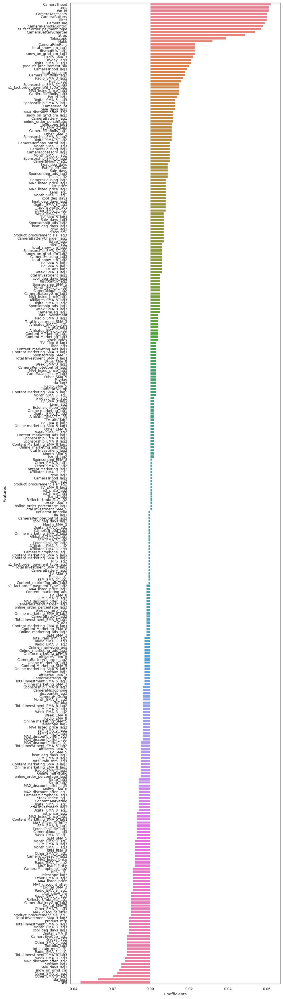

In [1205]:
# Slightly alter the figure size to make it more horizontal.
plt.figure(figsize=(10, 35), dpi=100, facecolor='w', edgecolor='k', frameon='True')
sns.barplot(y='Features', x='Coefficients', palette='husl', data=cameraaccessory_lr_coef_df, estimator=np.sum)
# Automatically adjust subplot params so that the subplotS fits in to the figure area.
plt.tight_layout()

# display the plot
plt.show()

##### The 5 most important features affecting GMV(Revenue) for cameraaccessory are:

|Features|Coefficients|
|--------|------------|
|Lens	|0.052
84	CameraAccessory|	0.051
60	CameraBattery|	0.051
24	fsn_id|	0.051
52	CameraBag|	0.051

## Building Linear Regression model for `gamingaccessory`

In [1206]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

gamingaccessory_dlmul_model = LinearRegression().fit(X_gamingaccessory_dlmul_train, y_gamingaccessory_dlmul_train)
y_gamingaccessory_dlmul_test_pred = gamingaccessory_dlmul_model.predict(X_gamingaccessory_dlmul_test)

print('R2 Score: {}'.format(r2_score(y_gamingaccessory_dlmul_test, y_gamingaccessory_dlmul_test_pred)))
print('Mean Squared Error: {}'.format(mean_squared_error(y_gamingaccessory_dlmul_test, y_gamingaccessory_dlmul_test_pred)))

R2 Score: 0.9264504462164121
Mean Squared Error: 0.04465440204057436


In [1207]:
##### With Simple Linear Regression, we get a r2 score of 0.92 and mse score of 0.04

In [1208]:
## Building Linear Regression model for `gamingaccessory` using K-fold Cross Validation

In [1209]:
y_gamingaccessory_dlmul = gamingaccessory_dlmul_df.pop('gmv')
X_gamingaccessory_dlmul = gamingaccessory_dlmul_df

In [1210]:
# Make cross validated predictions
from sklearn.model_selection import cross_val_score,cross_val_predict
from sklearn import metrics

gamingaccessory_dlmul_model_cv = LinearRegression().fit(X_gamingaccessory_dlmul, y_gamingaccessory_dlmul)
gamingaccessory_dlmul_predictions_cv = cross_val_predict(gamingaccessory_dlmul_model_cv, X_gamingaccessory_dlmul, \
                                                         y_gamingaccessory_dlmul, cv=10)
accuracy = metrics.r2_score(y_gamingaccessory_dlmul, gamingaccessory_dlmul_predictions_cv)
print("Cross-Predicted Accuracy:", accuracy)
print('Mean Squared Error: {}'.format(mean_squared_error(y_gamingaccessory_dlmul, gamingaccessory_dlmul_predictions_cv)))

Cross-Predicted Accuracy: 0.516868247489858
Mean Squared Error: 0.48313175251014195


In [1211]:
## Determining Feature Importance for `gamingaccessory` with model with cv

In [1212]:
# linear regression model parameters
#Limiting floats output to 3 decimal points
pd.set_option('display.float_format', lambda x: '{:.3f}'.format(x)) 
pd.set_option('display.precision',1)


gamingaccessory_lr_model_parameters = list(gamingaccessory_dlmul_model_cv.coef_)
gamingaccessory_lr_model_parameters.insert(0, gamingaccessory_dlmul_model_cv.intercept_)
gamingaccessory_lr_model_parameters = [round(x, 3) for x in gamingaccessory_lr_model_parameters]
cols = X_gamingaccessory_dlmul_test.columns
cols = cols.insert(0, "constant")
gamingaccessory_lr_coef = list(zip(cols, gamingaccessory_lr_model_parameters))
gamingaccessory_lr_coef

[('constant', 0.0),
 ('gmv_lag1', 0.006),
 ('gmv_lag2', 0.005),
 ('gmv_lag3', -0.002),
 ('list_price', 0.048),
 ('list_price_lag1', -0.004),
 ('list_price_lag2', -0.002),
 ('list_price_lag3', -0.001),
 ('product_mrp', 0.047),
 ('product_mrp_lag1', -0.005),
 ('product_mrp_lag2', -0.003),
 ('product_mrp_lag3', 0.001),
 ('discount%', -0.005),
 ('discount%_lag1', -0.006),
 ('discount%_lag2', -0.003),
 ('discount%_lag3', 0.011),
 ('sla', 0.035),
 ('sla_lag1', -0.007),
 ('sla_lag2', -0.002),
 ('sla_lag3', -0.002),
 ('product_procurement_sla', 0.006),
 ('product_procurement_sla_lag1', -0.0),
 ('product_procurement_sla_lag2', -0.003),
 ('product_procurement_sla_lag3', -0.001),
 ('fsn_id', 0.06),
 ('fsn_id_lag1', 0.01),
 ('fsn_id_lag2', 0.008),
 ('fsn_id_lag3', -0.001),
 ('s1_fact.order_payment_type', 0.054),
 ('s1_fact.order_payment_type_lag1', 0.009),
 ('s1_fact.order_payment_type_lag2', 0.004),
 ('s1_fact.order_payment_type_lag3', -0.003),
 ('GamePad', 0.063),
 ('GamePad_lag1', 0.009),
 ('Ga

In [1213]:
gamingaccessory_lr_coef_df = pd.DataFrame(gamingaccessory_lr_coef)
col_rename = {0:'Features',1: 'Coefficients'}
gamingaccessory_lr_coef_df = gamingaccessory_lr_coef_df.rename(columns=col_rename)
gamingaccessory_lr_coef_df = gamingaccessory_lr_coef_df.iloc[1:,:]
gamingaccessory_lr_coef_df = gamingaccessory_lr_coef_df.loc[gamingaccessory_lr_coef_df['Coefficients']!=0.0]
gamingaccessory_lr_coef_df = gamingaccessory_lr_coef_df.sort_values(by=['Coefficients'], ascending = False)
gamingaccessory_lr_coef_df

,Features,Coefficients
52,GamingMouse,0.063
32,GamePad,0.063
72,GamingMousePad,0.061
36,GamingAccessoryKit,0.060
24,fsn_id,0.060
60,TVOutCableAccessory,0.058
40,GamingHeadset,0.054
28,s1_fact.order_payment_type,0.054
76,GamingKeyboard,0.053
56,GamingAdapter,0.053


In [1214]:
## Plotting the Features in descending order of Importance for `gamingaccessory`

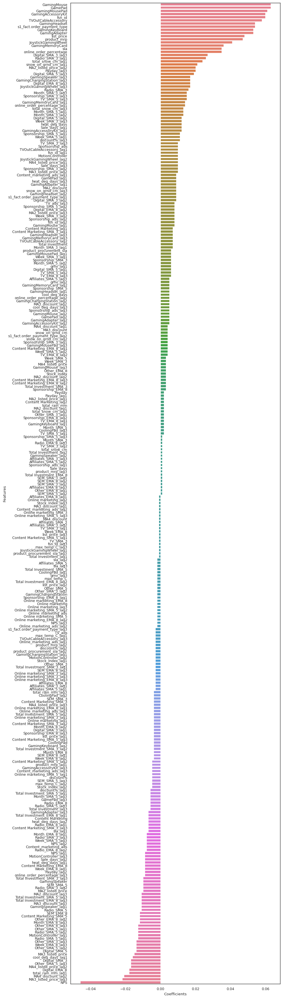

In [1215]:
# Slightly alter the figure size to make it more horizontal.
plt.figure(figsize=(10, 35), dpi=100, facecolor='w', edgecolor='k', frameon='True')
sns.barplot(y='Features', x='Coefficients', palette='husl', data=gamingaccessory_lr_coef_df, estimator=np.sum)
# Automatically adjust subplot params so that the subplotS fits in to the figure area.
plt.tight_layout()

# display the plot
plt.show()

##### The 5 most important features affecting GMV(Revenue) for gamingaccessory are:

|Features|Coefficients|
|--------|------------|
|GamePad |	0.052
24	fsn_id	|0.051
80	GamingMousePad	|0.051
60	GamingMouse	|0.051
44	GamingAccessoryKit	|0.051

## Building Linear Regression model for `homeaudio`

In [1216]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

homeaudio_dlmul_model = LinearRegression().fit(X_homeaudio_dlmul_train, y_homeaudio_dlmul_train)
y_homeaudio_dlmul_test_pred = homeaudio_dlmul_model.predict(X_homeaudio_dlmul_test)

print('R2 Score: {}'.format(r2_score(y_homeaudio_dlmul_test, y_homeaudio_dlmul_test_pred)))
print('Mean Squared Error: {}'.format(mean_squared_error(y_homeaudio_dlmul_test, y_homeaudio_dlmul_test_pred)))

R2 Score: 0.768139491237509
Mean Squared Error: 0.08652976435947263


In [1217]:
##### With Simple Linear Regression, we get a r2 score of 0.78 and mse of 0.79


In [1218]:
## Building Linear Regression model for `homeaudio` using K-fold Cross Validation

In [1219]:
y_homeaudio_dlmul = homeaudio_dlmul_df.pop('gmv')
X_homeaudio_dlmul = homeaudio_dlmul_df

In [1220]:
# Make cross validated predictions
from sklearn.model_selection import cross_val_score,cross_val_predict
from sklearn import metrics

homeaudio_model_dlmul_cv = LinearRegression().fit(X_homeaudio_dlmul, y_homeaudio_dlmul)
homeaudio_dlmul_predictions_cv = cross_val_predict(homeaudio_model_dlmul_cv, X_homeaudio_dlmul, y_homeaudio_dlmul, cv=5)
accuracy = metrics.r2_score(y_homeaudio_dlmul, homeaudio_dlmul_predictions_cv)
print("Cross-Predicted Accuracy:", accuracy)
print('Mean Squared Error: {}'.format(mean_squared_error(y_homeaudio_dlmul, homeaudio_dlmul_predictions_cv)))

Cross-Predicted Accuracy: 0.6965977365300181
Mean Squared Error: 0.30340226346998184


In [1221]:
##### With Simple Linear Regression, using cross validation, we get r2 score of 0.57 and mse score of 0.43

In [1222]:
## Determining Feature Importance for `homeaudio` with model with cv

In [1223]:
# linear regression model parameters
#Limiting floats output to 3 decimal points
pd.set_option('display.float_format', lambda x: '{:.3f}'.format(x)) 
pd.set_option('display.precision',1)


homeaudio_lr_model_parameters = list(homeaudio_model_dlmul_cv.coef_)
homeaudio_lr_model_parameters.insert(0, homeaudio_model_dlmul_cv.intercept_)
homeaudio_lr_model_parameters = [round(x, 3) for x in homeaudio_lr_model_parameters]
cols = X_homeaudio_dlmul_test.columns
cols = cols.insert(0, "constant")
homeaudio_lr_coef = list(zip(cols, homeaudio_lr_model_parameters))
homeaudio_lr_coef

[('constant', 0.0),
 ('gmv_lag1', -0.001),
 ('gmv_lag2', -0.003),
 ('gmv_lag3', 0.001),
 ('list_price', -0.005),
 ('list_price_lag1', 0.004),
 ('list_price_lag2', -0.005),
 ('list_price_lag3', -0.002),
 ('product_mrp', 0.027),
 ('product_mrp_lag1', 0.004),
 ('product_mrp_lag2', -0.005),
 ('product_mrp_lag3', -0.002),
 ('discount%', 0.049),
 ('discount%_lag1', -0.002),
 ('discount%_lag2', -0.0),
 ('discount%_lag3', 0.005),
 ('sla', 0.029),
 ('sla_lag1', 0.006),
 ('sla_lag2', 0.008),
 ('sla_lag3', 0.007),
 ('product_procurement_sla', -0.07),
 ('product_procurement_sla_lag1', 0.008),
 ('product_procurement_sla_lag2', -0.016),
 ('product_procurement_sla_lag3', 0.0),
 ('fsn_id', 0.096),
 ('fsn_id_lag1', -0.0),
 ('fsn_id_lag2', -0.001),
 ('fsn_id_lag3', 0.003),
 ('s1_fact.order_payment_type', 0.103),
 ('s1_fact.order_payment_type_lag1', -0.008),
 ('s1_fact.order_payment_type_lag2', -0.001),
 ('s1_fact.order_payment_type_lag3', 0.01),
 ('HomeAudioSpeaker', 0.134),
 ('HomeAudioSpeaker_lag1', -

In [1224]:
homeaudio_lr_coef_df = pd.DataFrame(homeaudio_lr_coef)
col_rename = {0:'Features',1: 'Coefficients'}
homeaudio_lr_coef_df = homeaudio_lr_coef_df.rename(columns=col_rename)
homeaudio_lr_coef_df = homeaudio_lr_coef_df.iloc[1:,:]
homeaudio_lr_coef_df = homeaudio_lr_coef_df.loc[homeaudio_lr_coef_df['Coefficients']!=0.0]
homeaudio_lr_coef_df = homeaudio_lr_coef_df.sort_values(by=['Coefficients'], ascending = False)
homeaudio_lr_coef_df

,Features,Coefficients
32,HomeAudioSpeaker,0.134
52,FMRadio,0.111
28,s1_fact.order_payment_type,0.103
40,BoomBox,0.101
24,fsn_id,0.096
60,VoiceRecorder,0.095
56,HiFiSystem,0.077
264,heat_deg_days,0.055
12,discount%,0.049
36,Dock,0.047


In [1225]:
## Plotting the Features in descending order of Importance for `homeaudio`

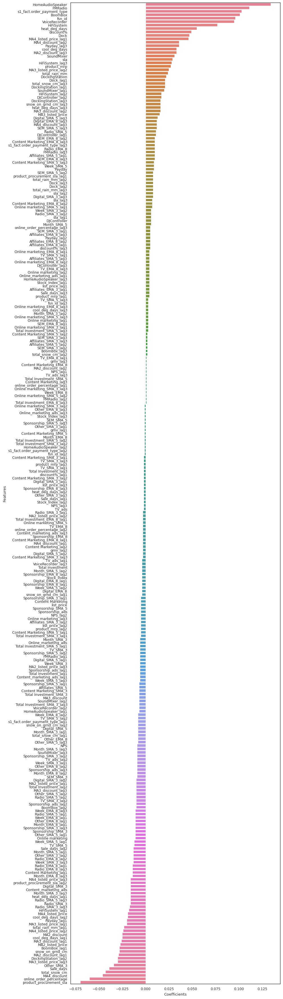

In [1226]:
# Slightly alter the figure size to make it more horizontal.
plt.figure(figsize=(10, 35), dpi=100, facecolor='w', edgecolor='k', frameon='True')
sns.barplot(y='Features', x='Coefficients', palette='husl', data=homeaudio_lr_coef_df, estimator=np.sum)
# Automatically adjust subplot params so that the subplotS fits in to the figure area.
plt.tight_layout()

# display the plot
plt.show()

##### The 5 most important features affecting GMV(Revenue) for homeaudio are:

|Features|Coefficients|
|--------|------------|
|HomeAudioSpeaker|	0.142
36	s1_fact.order_payment_type|	0.098
60	FMRadio	|0.081
48	BoomBox	|0.067
64	HiFiSystem	|0.062

Model Evaluation

ValueError: ignored

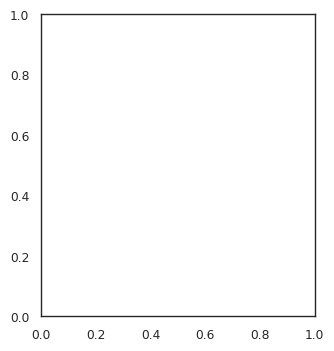

In [1227]:
# Slightly alter the figure size to make it more horizontal.
plt.figure(figsize=(12, 4), dpi=100, facecolor='w', edgecolor='k', frameon='True')
sns.set_style("white") # white/whitegrid/dark/ticks
sns.set_context("paper") # talk/poster

# subplot 1
plt.subplot(1, 3, 1)
c = [i for i in range(1,51,1)]
plt.plot(c,y_cameraaccessory_mul, color="blue", linewidth=2.5, linestyle="-")
plt.plot(c,cameraaccessory_mul_predictions_cv, color="red",  linewidth=2.5, linestyle="-")
plt.suptitle('Actual vs Predicted', fontsize=16, color = 'c')              # Plot heading 
plt.title('Camera Accessory', fontsize=12)              # Plot heading 
plt.xlabel('Index', fontsize=12)                               # X-label
plt.ylabel('Views', fontsize=12)                               # Y-label

# subplot 2
plt.subplot(1, 3, 2)
c = [i for i in range(1,52,1)]
plt.plot(c,y_gamingaccessory_mul, color="blue", linewidth=2.5, linestyle="-")
plt.plot(c,gamingaccessory_mul_predictions_cv, color="red",  linewidth=2.5, linestyle="-")
plt.title('Gaming Accessory', fontsize=12)
plt.xlabel('Index', fontsize=12)                               # X-label
plt.ylabel('Views', fontsize=12)                               # Y-label

# subplot 3
plt.subplot(1, 3, 3)
c = [i for i in range(1,49,1)]
plt.plot(c,y_homeaudio_mul, color="blue", linewidth=2.5, linestyle="-")
plt.plot(c,homeaudio_mul_predictions_cv, color="red",  linewidth=2.5, linestyle="-")
plt.title('Home Audio', fontsize=12)
plt.xlabel('Index', fontsize=12)                               # X-label
plt.ylabel('Views', fontsize=12)                               # Y-label

# display the plot
plt.show()